### Estimating Subjective Income Distribution

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import beta

In [4]:
from DensityEst import SynDensityStat, GeneralizedBetaEst

In [5]:
## figure plotting configurations


plt.style.use("seaborn")
plt.rcParams["font.family"] = "Times New Roman"  #'serif'
plt.rcParams["font.serif"] = "Ubuntu"
plt.rcParams["font.monospace"] = "Ubuntu Mono"
plt.rcParams["axes.labelweight"] = "bold"

## Set the
plt.rc("font", size=25)
# Set the axes title font size
plt.rc("axes", titlesize=20)
# Set the axes labels font size
plt.rc("axes", labelsize=20)
# Set the font size for x tick labels
plt.rc("xtick", labelsize=20)
# Set the font size for y tick labels
plt.rc("ytick", labelsize=20)
# Set the legend font size
plt.rc("legend", fontsize=20)
# Set the font size of the figure title
plt.rc("figure", titlesize=20)

In [6]:
### loading probabilistic data on monthly income growth
IndSCE = pd.read_stata("../SurveyData/SCE/IncExpSCEProbIndM.dta")

In [7]:
# IndSCE.tail()

In [8]:
## how many observations?
len(IndSCE)

130901

In [9]:
## how many observations have density forecasts
bin_name_list = ["Q24_bin" + str(n) for n in range(1, 11)]
IndSCE_sub = IndSCE.dropna(subset=bin_name_list)
len(IndSCE_sub)

94398

In [10]:
# IndSCE_sub[bin_name_list].head()

In [11]:
## survey-specific parameters
nobs = len(IndSCE)
SCE_bins = np.array(
    [-20, -12, -8, -4, -2, 0, 2, 4, 8, 12, 20]
)  ## -20 and +20 are a fake lower and upper bound
print("There are " + str(len(SCE_bins) - 1) + " bins in SCE")

There are 10 bins in SCE


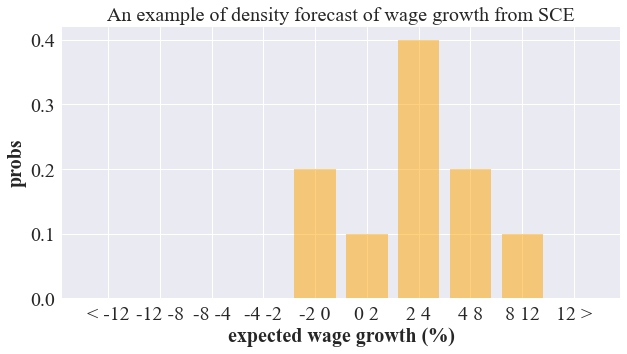

In [12]:
## make an illustration plot

SCE_bins_all = ["<"] + [str(bin) for bin in SCE_bins[1:-1]] + [">"]

SCE_bins_all_names = [
    str(SCE_bins_all[i] + " " + str(SCE_bins_all[i + 1]))
    for i in range(len(SCE_bins_all) - 1)
]
SCE_bins_id = np.arange(len(SCE_bins_all_names))
probs_example = np.flip(
    np.array([IndSCE.iloc[81, :]["Q24_bin" + str(n)] / 100 for n in range(1, 11)])
)


## plot
fig, ax = plt.subplots(figsize=(10, 5))

pl1 = ax.bar(SCE_bins_id, probs_example, color="orange", alpha=0.5)
ax.set_xlabel("expected wage growth (%)")

ax.set_ylabel("probs")
ax.set_title("An example of density forecast of wage growth from SCE")
ax.set_xticks(SCE_bins_id, labels=SCE_bins_all_names)

plt.savefig("../Graphs/sce/density_bin_example.pdf")

lower bound is -2
upper bound is 12
2-parameter beta
[ 1.64458279  2.79841045 -2.         12.        ]


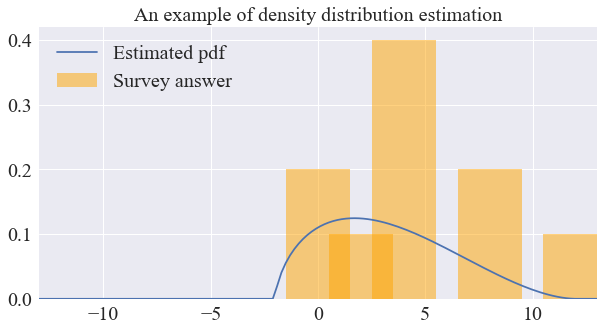

In [13]:
## example estimate

sim_est = GeneralizedBetaEst(SCE_bins, probs_example)
print(sim_est)

sim_x = np.linspace(SCE_bins[0], SCE_bins[-1], 200)
sim_pdf = beta.pdf(
    sim_x, sim_est[0], sim_est[1], loc=sim_est[2], scale=sim_est[3] - sim_est[2]
)

fig, ax = plt.subplots(figsize=(10, 5))

ax.set_title("An example of density distribution estimation")

ax.set_xlim(-13, 13)
ax.plot(sim_x, sim_pdf, label="Estimated pdf")

ax.bar(
    SCE_bins[1:],
    probs_example,
    color="orange",
    width=3,
    alpha=0.5,
    label="Survey answer",
)
ax.legend(loc=0)
plt.savefig("../Graphs/sce/density_bin_est_example.pdf")

In [14]:
##############################################
### attention: the estimation happens here!!!!!
###################################################


## creating positions
index = IndSCE.index
columns = ["IncMean", "IncVar", "IncSkew", "IncKurt"]
IndSCE_moment_est = pd.DataFrame(index=index, columns=columns)
ct = 0
## invoking the estimation
for i in range(nobs):
    print(i)
    ## take the probabilities (flip to the right order, normalized to 0-1)
    Inc = np.flip(
        np.array([IndSCE.iloc[i, :]["Q24_bin" + str(n)] / 100 for n in range(1, 11)])
    )
    print(Inc)
    try:
        # if not np.isnan(Inc).any():
        stats_est = SynDensityStat(SCE_bins, Inc)
        if not np.isnan(stats_est["mean"]).any():
            ct = ct + 1
            IndSCE_moment_est["IncMean"][i] = stats_est["mean"]
            print(stats_est["mean"])
            IndSCE_moment_est["IncVar"][i] = stats_est["variance"]
            print(stats_est["variance"])
            IndSCE_moment_est["IncSkew"][i] = stats_est["skewness"]
            print(stats_est["skewness"])
            IndSCE_moment_est["IncKurt"][i] = stats_est["kurtosis"]
            print(stats_est["kurtosis"])
    except:
        pass

0
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2
[0.   0.   0.   0.05 0.1  0.85 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
1.2163392592011792
1.7148088395942616
-2.000680673616066
3.265830567883051
3
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
4
[0.  0.  0.2 0.  0.  0.  0.  0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
5
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins 

2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
62
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
63
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
64
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
65
[0.  0.  0.  0.  0. 

1.288177194761122
0.3055914939835716
-0.06909385589273229
-0.18550393186646566
107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
109
[0.   0.   0.05 0.1  0.2  0.25 0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.1667243504324585
8.363665661528408
0.08952721080266511
-0.42132433996343305
110
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}

3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
161
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
162
[0.   0.   0.   0.1  0.05 0.4  0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.559065533877921
2.6322221849149323
-0.6244956560719177
-0.33533188047875084
163
[0.05 0.05 0.1  0.1  0.1  0.35 0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
217
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
218
[0.   0.   0.   0.   0.   0.8  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
219
[0.   0.   0.   0.   0.   0.4  0.3  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-param

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
268
[0.   0.   0.   0.   0.05 0.2  0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.714375906518777
1.6632864754982888
-1.144974901117438
0.5549458444800545
269
[0.   0.   0.   0.   0.05 0.7  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4019801311284645
0.6831240971774433
-0.13957491257268384
-0.3743886344554258
270
[0.   0.   0.   0. 

6.951129919130494e-05
8.891422215468555
-5.422728901188965e-06
-0.329753958000377
332
[0.   0.05 0.05 0.05 0.1  0.2  0.25 0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
2.1529836526620514
13.426628717120881
-0.20653117485156025
-0.42584924154620646
333
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
334
[0.03 0.42 0.3  0.16 0.03 0.03 0.03 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper b

1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
385
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
386
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
387
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
388
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bi

-0.8333333333333334
432
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
433
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
434
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
435
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
436
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
437
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
438
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
439
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
440
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
441
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
442
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
p

3.7376758054540167
1.9841967356670596
0.3878459045352747
-0.12881922093809245
492
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
493
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
494
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
495
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

0
-0.8333333333333334
545
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
546
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
547
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
548
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
549
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
550
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
551
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
552
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
553
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
554
[0.   0.   0.   0.   0.05 0.35 0.45 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.454785394900018
2.2334050433312416
0.33995684604475734
-0.12006789135773654
555
[0.   0.   0.   0.

2.1909830056250525
0.5454237476562283
0
-0.6
609
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
610
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
611
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
612
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable? 

-0.565685424949238
-0.6
663
[0.01 0.01 0.01 0.01 0.01 0.91 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
664
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
665
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
666
[0.  0.  0.  0.  0.  0.1 0.2 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56

-1.3443654742684812
1.6443068906292488
-1.2860130202922224
1.3410992061109046
703
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
704
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
705
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
706
[0. 0. 0. 0. 1. 0. 0. 

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
751
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
752
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
753
[0.   0.   0.   0.   0.   0.01 0.98 0.01 0.   

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
798
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
799
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
800
[0.   0.   0.   0.   0.   0.35 0.65 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
T

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
849
[0.   0.   0.   0.15 0.8  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.2212550931622737
0.5347558730654867
0.06822711252442748
-0.3135854826776365
850
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
851
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.28346590

-1.0
0.3333333333333333
0
-0.8333333333333334
901
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
902
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
903
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
904
[0.   0.01 0.01 0.02 0.03 0.1  0.5  0.15 0.08 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
905
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
906
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins 

[0.  0.  0.1 0.2 0.6 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-1.467141621957735
1.5653122123842624
-0.31678619409427905
-0.22290412886227784
942
[0.   0.   0.   0.05 0.5  0.4  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.13394322498936528
1.4200527987035954
0.03668859063784147
-0.4508078979534304
943
[0.   0.   0.15 0.25 0.4  0.15 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.6283187068093552
3.9761462536048486
-0.07441566220806034

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
989
[0.   0.   0.   0.   0.   0.1  0.5  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
990
[0.   0.   0.   0.   0.   0.05 0.3  0.4  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
991
[0.   0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.666

5.375087047473793
7.219454715818873
0.5904146829547731
-0.7568304501584018
1039
[0.   0.   0.   0.   0.   0.   0.   0.8  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1040
[0.   0.   0.   0.   0.   0.05 0.4  0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.85113233103132
5.455643116216374
0.26743708749843836
-0.6235374705607847
1041
[0.   0.   0.   0.   0.   0.05 0.4  0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-param

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1098
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1099
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1100
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1101
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1106
[0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0876041387963156
2.10236373299281
0.5702623051950467
0.05783139394734238
1107
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0

-0.8333333333333334
1162
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
1163
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
1164
[0.01 0.01 0.01 0.03 0.05 0.37 0.25 0.2  0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1165
[0.01 0.01 0.01 0.04 0.05 0.1  0.5  0.2  0.05 0.03]
probs sum up to 1
If all prisitive bins a

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1203
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1204
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1206
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1207
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1208
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1209
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
1210
[0.   0.   0.   0.   0.   0.7  0.18 0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least thre

-0.565685424949238
-0.6
1280
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.858030734615384
7.453116945228466
0.2958665455337557
-0.7899720100189297
1281
[0.   0.   0.   0.   0.   0.15 0.6  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.2351094500462905
1.4030447420231547
0.4402139024961075
0.007444531301121148
1282
[0.   0.   0.   0.   0.   0.1  0.55 0.25 0.09 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555555555

3.3065883915427703
6.331704728435616
0.0999170292014753
-0.4849428609119478
1327
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
1328
[0.   0.   0.   0.   0.05 0.5  0.25 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.119800841512804
2.8439411482250367
0.2193441080108375
-0.5051334733026254
1329
[0.   0.   0.   0.   0.03 0.5  0.2  0.15 0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20

[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
1373
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
1374
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
1375
[0.   0.   0.   0.   0.   0.1  0.15 0.2  0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  Tru

-3.5334553889182665
2.173566407113306
-0.45328300858115644
-0.09197605572008337
1422
[0.05 0.45 0.45 0.05 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1423
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
1424
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969

-0.8333333333333334
1456
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
1457
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
1458
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
1459
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

1.1221101092748675
0.45676456861896
-0.034962344592475346
-0.2751167128322178
1492
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
1493
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
1494
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.3

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1564
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
1565
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
1566
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
1567
[0.  0.  0.  0.  0.  0.8

[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
1608
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
1609
[0.  0.  0.  0.  0.  0.  0.5 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.022370704267976
8.764013386415519
0.7844557941652617
-0.6481103505976591
1610
[0. 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1657
[0.   0.   0.   0.   0.   0.15 0.4  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1658
[0.01 0.02 0.03 0.49 0.3  0.05 0.04 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1659
[0.01 0.02 0.03 0.2  0.55 0.15 0.03 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.66666666666

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1704
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1705
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1706
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1707
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1708
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1709
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1710
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1711
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1712
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1716
[ nan  nan  nan  nan  nan 0.75  nan 0.25  nan  nan]
probs sum up to 1
If all prisitive bins are equally

2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
1754
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
1755
[0.   0.   0.   0.   0.   0.   0.05 0.95 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.423985688947413
1.1059749551246232
0
-0.6
1756
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
1757
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1815
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1816
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1817
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
1818
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
1819
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two

1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
1852
[0.   0.   0.   0.   0.   0.78 0.2  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.306017466470017
1.045640505152544
1.1257647085844618
1.1384362224488256
1853
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
1854
[0.   0.   0.   0.   0.   0.4  0.55 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.323093443816557
0.8

-0.8333333333333334
1905
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
1906
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
1907
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
1908
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1980
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1981
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1982
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1983
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1984
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1985
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1986
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
1987
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three 

[0.   0.   0.   0.   0.   0.2  0.45 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.5541655757041415
3.2806893372646613
0.5321619774923991
-0.1514267160387998
2036
[0.   0.   0.   0.   0.   0.29 0.7  0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3853764496437497
0.4132191654169352
0.30070941691171904
-0.04266354843643933
2037
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6


0.05120729896501075
4.074874524739675
-0.00279238500783359
-0.1606833844428968
2086
[0.   0.01 0.03 0.05 0.1  0.55 0.1  0.1  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
2087
[0.   0.   0.05 0.1  0.15 0.5  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
0.5317152297268475
3.2117952775407077
-0.5532808325476873
-0.11686194637680097
2088
[0.   0.01 0.01 0.01 0.01 0.15 0.3  0.3  0.2  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is

0
-0.8333333333333334
2145
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
2146
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
2147
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
2148
[0.36 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins

0.3333333333333333
0
-0.8333333333333334
2186
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
2187
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
2188
[0.   0.   0.   0.   0.1  0.2  0.4  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
2189
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum

2219
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
2220
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
2221
[0.   0.   0.   0.   0.   0.25 0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.813729148437415
1.2034141776475589
0.32953341440445516
-0.273387254

-0.8333333333333334
2270
[0.  0.  0.1 0.6 0.3 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-2.613695507027276
1.0444596758196725
-0.3747463702639981
-0.19058136532813658
2271
[0.  0.  0.  0.  0.8 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.19098300562505266
0.5454237476562281
0
-0.6
2272
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
2273
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisiti

length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
2339
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
2340
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
2341
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
2342
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]

3.313488243717889
2.197420940205391
0.5141891330593568
-0.02707470115219478
2367
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2368
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2369
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2370
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2371
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2372
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2373
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2374
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2375
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2376
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2377
[0.01 0.01 0.01 0.01 0.01 0.9  0.02 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
up

[0.   0.   0.05 0.5  0.2  0.15 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.7569683494886483
4.037169111655821
-0.04885838385612531
-0.5470797400391053
2441
[0.  0.  0.  0.  0.1 0.2 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
2442
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
2501
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
2502
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
2503
[0.   0.   0.25 0.75 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not op

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
2558
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
2559
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
2560
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2,

[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
2608
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
2609
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
2610
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2656
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
2657
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
2658
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
2659
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally proba

3.9450616417709163
17.77396221864205
-0.2877504928490357
-0.7019034523733012
2726
[0.05 0.05 0.05 0.1  0.15 0.2  0.2  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
2727
[0.  0.  0.  0.1 0.2 0.2 0.2 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.313238312974967
12.216892610210488
0.3214144163892984
-0.7235963251376876
2728
[0.  0.  0.1 0.1 0.2 0.2 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.89

-1.7356266867968284
0.7781161053997399
4.206859584798746
18.30425332819711
2770
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
2771
[0.   0.   0.   0.   0.05 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
2772
[0.  0.  0.  0.  0.6 0.4 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
2847
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2848
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2849
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
2850
[0.   0.   0.   0.   0.   0.85 0.05 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.0587542725451538
6.4071

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2896
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2897
[0.   0.02 0.03 0.08 0.14 0.3  0.2  0.15 0.08 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
1.6034889080328334
9.39543728375719
-0.13035066329609402
-0.3278534102951333
2898
[0.   0.06 0.08 0.1  0.2  0.2  0.15 0.1  0.06 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
2899
[0.01 0.02 0.02 0.08 0.25 0.25 0.25 0.06 0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins

-0.4635329672620898
14.277894995295751
-0.8126907151233161
-0.25618988849651814
2949
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
2950
[0.  0.  0.  0.3 0.5 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.2037069789614874
1.6500772602533604
0.09866446233023521
-0.7949937852379878
2951
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2952
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2953
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2954
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
2955
[nan nan nan nan nan n

-0.6
3001
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
3002
[0.  0.  0.  0.  0.  0.2 0.1 0.1 0.1 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3003
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3004
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1

-0.8333333333333334
3046
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3047
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
3048
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3049
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

-0.565685424949238
-0.6
3094
[0.01 0.01 0.01 0.01 0.01 0.05 0.1  0.3  0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3095
[0.05 0.05 0.1  0.1  0.05 0.1  0.25 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3096
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
3097
[0.   0.   0.   0.   0.   0.   0.05 0.95 0.  

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3156
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3157
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
3158
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
3159
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is

3199
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
3200
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
3201
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3202
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3203
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3204
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3206
[nan nan na

-0.8333333333333334
3249
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
3250
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3251
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3252
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on ei

2.002050384135789
1.1570225221267083
0.652961106979353
0.10316220957736134
3288
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
3289
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3290
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
3291
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If al

0.9763466082066072
3.034989231413755
0.013696401482494631
-1.2081785687460151
3324
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3325
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3326
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3327
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins ar

1.600449378008964
5.108110057612113
-0.21742311622959037
-0.3618724005361981
3376
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3377
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3378
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3379
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3382
[0.   0.   0.   0.   0.   0.05 0.2  0.7  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.206485655099906
2.94238050307589
0.14210889289656536
-0.39979785002950446
3383
[0.   0.   0.   0.01 0.02 0.05 0.75 0.15 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side? 

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3441
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3442
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
3443
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins 

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
3505
[0.  0.1 0.5 0.3 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-4.812045723451792
5.044951362305623
-0.2692919774277515
-0.5810034839466318
3506
[0.  0.  0.1 0.5 0.3 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.313408519271478
2.026099773135825
-0.14721346962771792
-0.39513833557981837
3507
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally

-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.6539011261710829
3554
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
3555
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3556
[0.   0.   0.   0.   0.   0.5  0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
3557
[0.   0. 

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
3615
[0.   0.   0.   0.07 0.1  0.7  0.1  0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9172314115315592
0.9044305511721429
0.11527241898746893
-0.12868014436997063
3616
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3617
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3618
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3619
[0.01 0.01 0.01 0.01 0.01 0.65 0.18 0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3620
[0.01 0.01 0.01 0.01 0.01 0.18 0.

3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
3659
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
3660
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
3661
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3662
[0.   0.   0.   0.   0.   0.   0.   0.   0.95 0.05]
p

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3731
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3732
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
3733
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper 

0.1550720024432195
3.1088599967523844
-0.0573067879852649
-0.8362359185024195
3767
[0.01 0.01 0.01 0.01 0.15 0.65 0.13 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
3768
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
3769
[0.  0.  0.  0.  0.2 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4377723335400132
2.1983569153862996
-

-0.679780621574368
6.468609762667035
-0.3297947616421398
-0.6815958666059714
3825
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3826
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3827
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3828
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probab

6.200886000041703
0.29752657975844016
-0.9068649727368143
3880
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
3881
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3882
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
3883
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.333333333

0
-0.8333333333333334
3917
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
3918
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
3919
[0.  0.  0.  0.1 0.9 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.4624752955742644
0.35647233169417203
0
-0.6
3920
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  Fals

[0.  0.  0.  0.  0.4 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.5622393509454282
2.1985556300982445
0.23588459621101293
-0.9293621714139966
3985
[0.   0.   0.   0.   0.75 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
3986
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
3987
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
3988
[nan nan nan nan nan nan n

[0.02 0.03 0.05 0.1  0.15 0.25 0.1  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4046
[0.02 0.03 0.05 0.1  0.25 0.2  0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4047
[0.01 0.02 0.04 0.18 0.15 0.18 0.15 0.12 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4048
[0.02 0.02

-0.8333333333333334
4101
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
4102
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
4103
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
4104
[0.  

-0.565685424949238
-0.6
4154
[0.08 0.08 0.08 0.08 0.08 0.1  0.11 0.12 0.15 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4155
[0.08 0.08 0.08 0.08 0.08 0.13 0.2  0.15 0.08 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4156
[0.15 0.14 0.13 0.12 0.11 0.09 0.08 0.07 0.06 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4206
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4207
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4208
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with p

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
4283
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
4284
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
4285
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on ei

-0.565685424949238
-0.6
4336
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
4337
[0.   0.   0.   0.   0.   0.1  0.45 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.8253242013598534
1.9046150582788273
0.05394759260487652
-0.5738319552469217
4338
[0.   0.   0.   0.   0.   0.05 0.65 0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5056627458620584
0.8698187736468794
0.110923694450131
-0.2807657269105386

-1.3515652257189004
1.074688749091681
-0.02671379858594591
-0.06232631554192322
4384
[0.   0.   0.   0.02 0.1  0.66 0.2  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2057343353386987
1.0509491041997634
0.08942842741945836
-0.15662210456438289
4385
[0.   0.   0.   0.   0.   0.45 0.25 0.2  0.09 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4386
[0.   0.05 0.1  0.25 0.4  0.15 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
4426
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4427
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4428
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side

-0.565685424949238
-0.6
4482
[0.   0.   0.   0.   0.   0.37 0.57 0.04 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4483
[0.   0.   0.   0.   0.   0.05 0.75 0.15 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4484
[0.   0.   0.   0.   0.01 0.45 0.47 0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949

3.2163392592011792
1.7148088395942616
-2.000680673616066
3.265830567883051
4535
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
4536
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
4537
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334


2.1909830056250525
0.5454237476562283
0
-0.6
4573
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
4574
[0.   0.   0.   0.   0.   0.05 0.15 0.8  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.707500483103936
3.541103281652586
-0.7730618162028539
-0.3145226626057184
4575
[0.  0.  0.  0.  0.  0.  0.5 0.  0.  0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4576
[0.  0.  0.  0.  0.  0.5 0.5 0.  0. 

[0.  0.  0.  0.  0.  0.  0.  0.2 0.6 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4638
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4639
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4640
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4641
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4642
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4643
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
4644
[0.   0.   0.   0.   0.   0.   0.   0.1  0.15 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.666666

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
4717
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
4718
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
4719
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ende

3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
4775
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
4776
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
4777
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
4778
[0.  0.

2.521259113815354
2.24396748307429
0.10618604399860183
-0.44454741691551697
4814
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
4815
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
4816
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.28723171549764

-0.8333333333333334
4848
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
4849
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
4850
[0.97  nan  nan  nan  nan  nan 0.03  nan  nan  nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4851
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
4899
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
4900
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
4901
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
4902
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum

[0.2 0.6 0.1 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4936
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
4937
[0.   0.   0.2  0.15 0.2  0.15 0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
-0.188622750426358
15.64249861495406
0.3123480141762553
-0.6137213205059138
4938
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
4999
[0.   0.   0.   0.   0.   0.05 0.1  0.45 0.25 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5000
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5001
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.4  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555

0
-0.6
5044
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
5045
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
5046
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
5047
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive

[0.   0.   0.   0.   0.   0.88 0.1  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.7722068511140008
1.0812234156053206
2.015029042276259
4.402382062144739
5079
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
5080
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5081
[0.01 0.01 0.01 0.01 0.01 0.85 0.05 0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555555

-0.8333333333333334
5132
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
5133
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
5134
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5135
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5136
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5137
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5138
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5139
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5140
[0.05 0.0

-0.565685424949238
-0.6
5168
[0.05 0.05 0.05 0.05 0.05 0.05 0.1  0.15 0.2  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5169
[0.   0.   0.   0.   0.   0.1  0.15 0.2  0.2  0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5170
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
5171
[0.   0.   0. 

0.35647233169417203
0
-0.6
5204
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
5205
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
5206
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5207
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5208
[0.   0.   0.   0.   0.01 0.9  0.06 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6

[0.   0.   0.   0.   0.02 0.98 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8352843303700923
0.2260937651802407
0
-0.6
5265
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
5266
[0.   0.   0.   0.05 0.9  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9998051507030095
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
5267
[0.   0.   0.   0.03 0.02 0.95 0.   0.   0.   0.  ]
probs sum up

1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
5326
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
5327
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
5328
[0.   0.   0.   0.05 0.05 0.3  0.2  0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5329
[0.   0.   0.   0.   0.01 0.75 0.2

-0.565685424949238
-0.6
5381
[0.   0.   0.   0.   0.3  0.35 0.35 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1158020657364967
2.818630191277199
-0.06587509584446316
-1.151197339589273
5382
[0.   0.   0.   0.35 0.35 0.3  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.1157869428488212
2.8191391898958558
0.06586958038473817
-1.15132640573244
5383
[0.   0.   0.05 0.1  0.15 0.25 0.35 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.259548689088101
6.5430

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
5417
[0.   0.   0.   0.05 0.05 0.25 0.5  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.48358641515631
2.364855751700353
-0.07801142608145849
-0.34178927233742784
5418
[0.   0.   0.   0.   0.05 0.05 0.8  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.9999986732001487
0.5992436019991436
1.604870431020121e-07
-0.1372392834745585
5419
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
uppe

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
5457
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
5458
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
5459
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-paramet

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
5513
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
5514
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
5515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5516
[nan nan nan nan nan nan nan nan n

[0.   0.   0.   0.   0.02 0.48 0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.0419572870346654
1.2505216868338085
0.16916457077115846
-0.2413451413914198
5575
[0.01 0.01 0.01 0.02 0.05 0.35 0.41 0.1  0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5576
[0.   0.   0.   0.   0.03 0.55 0.4  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.8217685800259469
1.0491160283379388
0.19574634588292403
-0.1897

[0.  0.  0.  0.8 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.1909830056250525
0.545423747656228
0
-0.6
5609
[0.  0.  0.1 0.9 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-3.462475295574264
0.35647233169417153
0
-0.6
5610
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
5611
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is th

-0.6
5664
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
5665
[0.   0.   0.   0.   0.   0.17 0.1  0.6  0.1  0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5666
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
566

7.621157927935595
10.644842061326585
-0.22991197061102808
-1.3304634713248062
5714
[0.02 0.02 0.02 0.02 0.01 0.05 0.6  0.2  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5715
[0.01 0.01 0.01 0.01 0.01 0.02 0.3  0.6  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5716
[0.01 0.01 0.01 0.01 0.01 0.03 0.3  0.6  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter 

[0.  0.  0.  0.  0.  0.  0.1 0.2 0.7 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
9.214897020722814
9.346768051250704
-0.9200082397128824
-0.4821532003981816
5778
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
5779
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
5780
[0.   0.   0.   0.   0.05 0.9  0.05 

1.8031646858970856
3.8670302780825216
0.038874084703841266
-0.5289331016784506
5823
[0.   0.   0.   0.05 0.4  0.4  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.32199836464511833
2.5044917137163965
0.29763239432324134
-0.2692804978933334
5824
[0.  0.  0.  0.2 0.2 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.2531554227215569
3.951382115716081
-0.10121526978204283
-0.98171090287772
5825
[0.   0.   0.01 0.1  0.75 0.05 0.05 0.02 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound 

-1.00012195143281
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
5864
[0.   0.   0.   0.   0.   0.75 0.2  0.04 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.3867145104975336
1.6593860557140658
1.4514769430669343
2.3174212359782924
5865
[0.   0.   0.   0.   0.   0.85 0.05 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.0587542725451538
6.4071464598163566
2.7807871085996716
6.977530132824718
5866
[0.   0.   0.   0.   0.   0.15 0.25 0.15 0.2  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bo

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
5912
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
5913
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
5914
[0.   0.   0.   0.   0.   0.05 0.2  0.6  0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-paramet

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5981
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5982
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5983
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5984
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5985
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5986
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5987
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5991
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
5992
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have 

[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
6042
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6043
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6044
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6045
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6046
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6047
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6048
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6049
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the s

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
6094
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
6095
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
6096
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with p

[0.02 0.02 0.02 0.02 0.02 0.05 0.55 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6132
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
6133
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6134
[0.   0.   0.1  0.1  0.2  0.2  0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equa

[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.576251408454893
6.801914503019528
0.1037161615998052
-0.8118229060885881
6189
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
6190
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
6191
[0.  0. 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
6244
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
6245
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
6246
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

0.7884565374899477
4.185876298775704
-0.23669726642309563
-0.16912242362311408
6274
[0.   0.   0.03 0.1  0.15 0.5  0.18 0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.7764901998672098
3.0830649815745583
-0.08203429738056084
-0.2562750435521776
6275
[0.   0.01 0.04 0.08 0.1  0.6  0.1  0.06 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
0.8487011247294944
1.8179535133721854
-0.03154610522249982
-0.07277054123975392
6276
[0.   0.   0.02 0.1  0.2  0.5  0.15 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is

-7.099282306416901
5.0244702060471695
2.7801603617455313
6.74871615973939
6318
[0.  0.  0.  0.  0.7 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.21103222500738017
0.8147772500035144
0
-0.6
6319
[0.75 0.25 0.   0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is -8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6320
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
6321
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up t

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
6380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6384
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6386
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6388
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
6389
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6390
[nan nan nan nan

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
6445
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
6446
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
6447
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
6448
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6449
[nan nan nan nan na

-0.6
6478
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
6479
[0.   0.   0.   0.   0.95 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.7119928444737063
0.27649373878115563
0
-0.6
6480
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6481
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6482
[0.05 0.2  0.75 0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper b

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
6527
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
6528
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
6529
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
6556
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
6557
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
6558
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6609
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6610
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6611
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6612
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6613
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6614
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6615
[0.   0.   0.   0.   0.   0.03 0.3  0.6  0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6616
[0.   0.   0.   0.   0.02 0.03 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
6672
[0.05 0.1  0.5  0.25 0.1  0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6673
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
6674
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  Tru

[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
6737
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
6738
[0.  0.  0.1 0.1 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-1.0992866193763913
3.3059829728258734
-1.9369288560054831
2.9200520138111674
6739
[0.  0.  0.  0.5 0.5 0.  0.  0.  0. 

1.4839173965513552
1.6328254213437488
-2.844736840253176
7.280125795281708
6797
[0.02 0.02 0.02 0.02 0.02 0.05 0.05 0.7  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6798
[0.   0.   0.   0.05 0.1  0.65 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.092389334191572
1.0522007940956126
-0.2826272733211261
-0.26095521644684866
6799
[0.   0.   0.   0.   0.05 0.65 0.3  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-

[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6860
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
6861
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
6862
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins wit

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6899
[0.   0.01 0.02 0.07 0.15 0.2  0.2  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
2.478578290018312
13.11829677693835
-0.237846340843593
-0.4015924152904801
6900
[0.02 0.03 0.05 0.07 0.15 0.25 0.2  0.15 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
6901
[0.01 0.05 0.05 0.07 0.1  0.25 0.2  0.15 0.07 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter be

-0.8333333333333334
6939
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
6940
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
6941
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6942
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6943
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6944
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6945
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6946
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6991
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6992
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6993
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6994
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6995
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6996
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6997
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6998
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6999
[ nan  nan  nan  nan  nan  nan 0.03  nan  nan  nan]
probs do not sum to 1
7000
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inter

5.022370704267976
8.764013386415519
0.7844557941652617
-0.6481103505976591
7036
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
7037
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
7038
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
7039
[0.  0.  0.1 0.6 0.3 0.  0

3.010291810977206
1.3862417311786628
0.20183450163094052
-0.11462181440835398
7068
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
7069
[0.   0.01 0.01 0.01 0.01 0.1  0.75 0.1  0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
2.940070672708302
0.7670090888207505
-0.07566351714776735
-0.02507929600085786
7070
[0.   0.   0.   0.   0.   0.1  0.75 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0908993301948073
0.7323452906740

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7116
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7117
[0.   0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7118
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7119
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7120
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7121
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7122
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7123
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7124
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7125
[nan nan nan nan nan nan nan nan nan nan]
probs do 

-1.0
0.3333333333333333
0
-0.8333333333333334
7198
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7199
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
7200
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
7201
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there

[0.   0.05 0.05 0.05 0.05 0.   0.05 0.15 0.4  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7259
[0.   0.   0.   0.   0.   0.05 0.05 0.25 0.5  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7260
[0.   0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7261
[0.  0.  0.  0

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
7289
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
7290
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
7291
[0.   0.   0.   0.   0.   0.15 0.25 0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.7702038743821955
5.785584784890366
0.29379929691979506
-0.6404655414914532
7292
[0. 0. 0. 0

-0.6
7358
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7359
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7360
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
7361
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either s

1.0
0.3333333333333333
0
-0.8333333333333334
7422
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
7423
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
7424
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
7425
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bi

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
7483
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
7484
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
7485
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

4.594698977007452
4.985910993457176
0.8877250233946102
-0.0448334835325697
7530
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
7531
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
7532
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7588
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7589
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7590
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7591
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7592
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7593
[0.   0.   0.   0.   0.   0.1  0.15 0.25 0.4  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7594
[0.   0.   0.01 0.01 0.01 0.15 0.5  0.25 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter be

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
7628
[0.   0.   0.   0.   0.   0.05 0.35 0.6  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.356957283039243
1.947123479946533
-0.11180789625744901
-0.5741231859462188
7629
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.317703129275076
3.851282450462064
-1.256509796938625
0.6100713134181652
7630
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7631
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False

[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
7674
[0.   0.   0.   0.   0.15 0.25 0.25 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.1503832030213887
8.828991444671543
0.40405014169396253
-0.6270117554492713
7675
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
7676
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7677
[0.03 0.03 0.

4.047823504614478
3.2910706152521643
0.39926671893029486
-0.29048396142701227
7720
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
7721
[0.   0.   0.   0.   0.   0.2  0.65 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.904392638012791
1.03913397972872
0.28205189463803776
-0.2574230624913181
7722
[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-paramete

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7751
[0.75 0.1  0.15 0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7756
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
7757
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
7820
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7821
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7822
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
7823
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable

-0.565685424949238
-0.6
7872
[0.   0.   0.   0.   0.   0.05 0.1  0.7  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7873
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
7874
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
7922
[0.   0.   0.   0.   0.   0.1  0.25 0.4  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
7923
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
7924
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333

-11.047893001458418
5.720900648461555
2.7015281506017756
6.113290550944503
7996
[0.  0.8 0.1 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-10.119930956453747
9.68454395920535
1.5565533378281482
0.940383575894407
7997
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
7998
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.613

-5.677499082980881
1.4056385247142784
0.06432789013363222
-0.15819760778886036
8035
[0.25 0.25 0.25 0.   0.   0.   0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8036
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
8037
[0.02 0.03 0.04 0.05 0.05 0.57 0.1  0.07 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568

[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
8087
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
8088
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
8089
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
8145
[0.   0.   0.   0.   0.   0.   0.1  0.15 0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
9.658106948887372
9.658297044198864
-1.1975330469622454
0.03773821936712392
8146
[0.   0.   0.01 0.04 0.05 0.1  0.2  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
8184
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
8185
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
8186
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.83

[0.  0.  0.  0.  0.  0.2 0.2 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8238
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
8239
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
8240
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are eq

2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
8305
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
8306
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
8307
[0.   0.   0.   0.   0.   0.   0.05 0.2  0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper 

2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
8360
[0.   0.   0.   0.   0.05 0.05 0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.8756644110559444
0.46090285127787467
0.013269364363904086
-0.10648728963483409
8361
[0.   0.   0.   0.   0.01 0.15 0.8  0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.729453752376937
0.5283254904616195
0.030901315311128903
-0.12059568422174927
8362
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals

4.858030734615384
7.453116945228466
0.2958665455337557
-0.7899720100189297
8405
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
8406
[0.   0.1  0.1  0.05 0.   0.5  0.15 0.05 0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8407
[0.   0.   0.   0.   0.05 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-paramete

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
8447
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
8448
[0.01 0.01 0.01 0.01 0.01 0.3  0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8449
[0.   0.01 0.02 0.02 0.02 0.08 0.4  0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

4.982317051936093
7.217252178340192
0.00338013000601041
-0.6826373677775693
8499
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8500
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8501
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8503
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8504
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8505
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
8506
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is >

1.9543141706857288
1.0417994556243215
0.005035770890346526
-0.1641055598280198
8559
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
8560
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
8561
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
8562
[0.  0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8602
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8603
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8604
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8605
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8606
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8608
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8609
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8610
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8611
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
8612
[0.  0.  0.  0.  0.  0.5 0.5 

1.2792407799438734
1.233755122253404
0
-0.6
8641
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
8642
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
8643
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
8644
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive

-0.565685424949238
-0.6
8673
[0.   0.   0.15 0.15 0.15 0.5  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-0.5646451817932556
5.473415621045314
-0.34080588541123186
-0.5786542218216338
8674
[0.   0.   0.   0.   0.5  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.21578339075956832
1.8171014481547103
0.7874270636150434
0.32703456710977963
8675
[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.812144917091732
5.04589427717

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0000099385635028
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
8736
[0.  0.  0.7 0.3 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-3.5779355499852397
3.2591090000140572
0
-0.6
8737
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
8738
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive prob

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
8786
[0.   0.   0.   0.   0.   0.05 0.3  0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8787
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8789
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8790
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8791
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8792
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8793
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8


2.714375906518777
1.6632864754982888
-1.144974901117438
0.5549458444800545
8844
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
8845
[0.   0.   0.   0.   0.03 0.02 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.7389666175054597
1.0116699953071728
-4.390751321910447
18.886376380618344
8846
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
8847
[0. 

0.05555555555555555
-0.565685424949238
-0.6
8898
[0.01 0.01 0.01 0.02 0.05 0.1  0.15 0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8899
[0.25 0.1  0.2  0.15 0.15 0.1  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
8900
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
8901
[0.  0.  0.  0. 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
8937
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
8938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8939
[0.   0.   0.   0.   0.   0.3  0.25 0.25 0.2  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.387056340351462
11.152209269994547
0.4836218033

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9004
[0.25 0.   0.   0.   0.   0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9005
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
9006
[0.1  0.1  0.1  0.1  0.1  0.1  0.1  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9007
[nan na

0.25945054071983975
10.210560700464308
0.20756453717209436
-0.4628681475339944
9045
[0.   0.   0.01 0.07 0.1  0.45 0.25 0.12 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4729598772858346
3.5669473516997607
-0.17015283788543706
-0.2691481543986401
9046
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9047
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9048
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9049
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9050
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
9051
[0. 0. 0. 0. 0. 1. 

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
9082
[0.  0.  0.  0.  0.  0.2 0.2 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.620126443891079
6.018142660326628
-0.28128266645320577
-1.2129941161892026
9083
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9084
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9085
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9086
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9087
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9088
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
9152
[0.  0.  0.  0.  0.  0.  0.  0.2 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9153
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
9154
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisiti

1.1441716504494104
0.35261567853706444
0.2012035449187545
-0.03527739344100979
9195
[0.   0.   0.   0.   0.05 0.65 0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.5108098844088724
1.0005664330500266
0.2505351525455159
-0.15188355578280524
9196
[0.   0.   0.   0.   0.1  0.6  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.440367181134544
1.3711169131167187
0.3051544593896249
-0.19292844094555464
9197
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent 

[0.02 0.03 0.1  0.1  0.1  0.15 0.15 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9239
[0.02 0.02 0.03 0.03 0.2  0.2  0.15 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9240
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
9241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


-0.565685424949238
-0.6
9297
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
9298
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
9299
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9300
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9301
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9302
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9303
[0.   0.   0.   0.   0.   0.01 0.68 0.2  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bi

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
9356
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9357
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9358
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9359
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9360
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9361
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9362
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9363
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9364
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9365
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9366
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9367
[0.   0.   0.   0.   0.   0.55 0.4  0.03 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
9438
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
9439
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
9440
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all p

2.8872409734911457
1.6755021077908578
0.021896678750384046
-0.3540734811604964
9485
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9486
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9487
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9488
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9489
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9490
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9491
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9492
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9493
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9494
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9495
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9496
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9497
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9498
[0.   0.   0.   0. 

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
9541
[0.2  0.4  0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9542
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
9543
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0

[0.2  0.1  0.06 0.03 0.01 0.01 0.03 0.06 0.1  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9623
[0.3  0.1  0.06 0.03 0.01 0.01 0.03 0.06 0.1  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9624
[0.3  0.1  0.06 0.03 0.01 0.01 0.03 0.06 0.1  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9625
[0. 0. 0. 

Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9653
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9654
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9655
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9656
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9657
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9658
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9659
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
9660
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True

0
-0.8333333333333334
9685
[0.   0.   0.   0.   0.   0.05 0.05 0.7  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9686
[0.   0.   0.   0.   0.   0.25 0.4  0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9687
[0.05 0.05 0.05 0.05 0.05 0.05 0.   0.6  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249492

10.0
33.333333333333336
0
-0.8333333333333334
9736
[0.   0.   0.   0.   0.   0.   0.06 0.34 0.25 0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9737
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9738
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
9739
[nan nan nan nan nan nan na

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
9795
[0.  0.  0.  0.1 0.3 0.3 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.6065402731426905
3.8310131720442713
-0.24398546229095727
-0.9121674306296812
9796
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
9797
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.33333

[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
9844
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
9845
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
9846
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eit

11.047878445604399
5.720919683791178
-2.7014971364518554
6.113132386001734
9874
[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
9875
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
9876
[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9934
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9935
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9940
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9941
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
9942
[0.   0.   0.   0.   0.   0.01 0.9  0.05 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
9943
[0.   0.05 0.8  0.   0.02 0.08 0.05 0.   0.   0.  ]

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10020
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10021
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10022
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10023
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
10024
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
10025
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10068
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10069
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10070
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10071
[0.  0.  0.  0.  0.1 0.1 0.2 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10072
[0.   0.   0.   0.   0.   0.25 0.3  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on ei

-0.6
10107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10109
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10110
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10111
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10112
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10113
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10114
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10115
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10116
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10117
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10118
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10119
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
On

-0.565685424949238
-0.6
10175
[0.   0.   0.   0.   0.   0.05 0.4  0.4  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10176
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
10177
[0.   0.   0.   0.   0.   0.1  0.6  0.05 0.   0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555

[0.   0.   0.   0.   0.   0.1  0.45 0.4  0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10221
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10222
[0.   0.   0.   0.   0.03 0.16 0.55 0.25 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.171074927831355
1.7060862327185768
0.20175970597887716
-0.1496850122957526
10223
[0.   0.   0.   0.   0.05 0.05 0.65 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter 

[0.   0.   0.   0.   0.   0.05 0.05 0.05 0.1  0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10250
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.1  0.7 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10251
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
10252
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 

5.333333333333333
0
-0.8333333333333334
10316
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
10317
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
10318
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
10319
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10403
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
10404
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
10405
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive p

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
10458
[0.   0.   0.   0.   0.   0.1  0.25 0.3  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10459
[0.   0.   0.05 0.05 0.1  0.1  0.3  0.3  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
3.2912531294685365
12.54871201617997
-0.16501078966260208
-0.5733088420797537
10460
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs 

[0.12 0.08 0.04 0.02 0.   0.02 0.02 0.08 0.08 0.54]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10505
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10506
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10509
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10511
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10512
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10514
[nan nan nan nan nan nan nan nan nan na

10.0
33.333333333333336
0
-0.8333333333333334
10565
[0.  0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 8}
2.0
12.0
0
-0.8333333333333334
10566
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
10567
[0.  0.  0.  0.  0.1 0.2 0.2 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10568
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive

[0.   0.   0.   0.   0.   0.2  0.65 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.904392638012791
1.03913397972872
0.28205189463803776
-0.2574230624913181
10628
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
10629
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
10630
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  

1.0
0.3333333333333333
0
-0.8333333333333334
10684
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10685
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
10686
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
10687
[0.3  0.04 0.01 0.01 0.01 0.5  0.1  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10761
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10762
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10764
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10765
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10766
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10767
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10768
[0.   0.   0.   0.25 0.25 0.5  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.3633896584523493
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
10769
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally

1.9733804601001985
9.073455844421952
0.35406406380795213
-0.5314239259778138
10868
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
10869
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10870
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
10871
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10872
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10919
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
10920
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
10921
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
10922
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to

[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
10956
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
10957
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
10958
[0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10986
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10987
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10990
[0.05 0.5  0.05 0.05 0.1  0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
10991
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
10992
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum 

-0.8333333333333334
11028
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
11029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11033
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11034
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11035
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11036
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11037
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11038
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11091
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11092
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11093
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11094
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11095
[nan nan nan nan nan nan nan 

0.6500816503669915
1.7273401107930273
0.5825843731277363
0.01882404368930702
11150
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
11151
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
11152
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
11153
[0.  0.

[0.   0.   0.   0.   0.02 0.08 0.6  0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.4244154482392
1.2517147053026956
0.1476066683333564
-0.12135855331769868
11194
[0.   0.   0.   0.02 0.03 0.08 0.7  0.12 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
3.080447726124415
0.9227843748872688
0.05514205535965784
-0.08068388738738529
11195
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
11196
[0.  0.  0. 

-0.6
11220
[0.  0.  0.4 0.3 0.3 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.464283178161656
4.3978728346311105
-0.22345265913306353
-1.015188310887846
11221
[0.  0.  0.  0.4 0.6 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.7207592200561264
1.2337551222534033
0
-0.6
11222
[0.  0.  0.6 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-4.620177720843112
6.018583791420664
0.2813113256069651
-1.2130333793250805
11223
[0.   0.   0.   0.   

-0.6
11250
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
11251
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11252
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
11253
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fals

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
11300
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11301
[0.   0.   0.   0.   0.   0.15 0.2  0.25 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11302
[0.   0.   0.   0.   0.05 0.25 0.25 0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  F

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11331
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11332
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11333
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

2.0
1.3333333333333333
0
-0.8333333333333334
11381
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
11382
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11383
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
11384
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If 

1.291938502983033
7.675802375857615
0.07321525746393096
-0.3934954781055557
11428
[0.   0.   0.   0.1  0.15 0.25 0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.9754163351254874
7.297341588877808
0.006135271505730597
-0.8653503713970871
11429
[0.   0.   0.   0.1  0.15 0.25 0.25 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.2091965503868387
9.767629358038624
0.31727796549258463
-0.5969412077741297
11430
[0.05 0.05 0.1  0.1  0.15 0.15 0.15 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
u

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11457
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11458
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
11459
[0.   0.   0.   0.   0.   0.15 0.5  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.545324722787674
2.2669389661401405
0.45852033797942027
-0.09950920686954894
11460
[0.   0.   0.   0.   0.   0.25 0.45 0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bo

1.6061788529350487
2.8149749863606024
0.06836531099525488
-0.40069618650552163
11497
[0.   0.   0.   0.   0.   0.22 0.5  0.21 0.07 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.2264566069459684
2.1953793178721264
0.5389016528485976
0.0035306371655271554
11498
[0.   0.   0.   0.   0.   0.25 0.35 0.4  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5197076269594962
3.5148058041968495
0.1867739958147476
-0.880732462145994
11499
[0.   0.   0.   0.   0.   0.02 0.75 0.12 0.09 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
up

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
11526
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11527
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11528
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
11529
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equa

[0.   0.01 0.01 0.01 0.05 0.3  0.4  0.1  0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11582
[0.   0.   0.   0.   0.   0.25 0.5  0.13 0.08 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11583
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11584
[0.   0.   0.   0.   0.   0.5  0.25 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.66666666

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11630
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11631
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11632
[0.   0.   0.   0.   0.   0.3  0.28 0.27 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11633
[0.   0.   0.   0.   0.   0.   0.   0.1  0.35 0.55]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11634
[0.   0.   0.   0.   0.   0.   0.3  0.48 0.17 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there op

3.3042255090433374
0.6625592727905476
0.14002441255816608
-0.2077988060027836
11689
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
11690
[0.1 0.4 0.3 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11691
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
11692
[0.5

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11744
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11745
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11746
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11747
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11748
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11749
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11750
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11751
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11756
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11757
[nan nan nan nan nan

-0.8333333333333334
11791
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
11792
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11793
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
11794
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
11836
[0.  0.  0.  0.  0.2 0.4 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.625370130181044
3.0593413553711186
0.367502609396235
-0.44662355653438246
11837
[0.   0.   0.   0.   0.2  0.4  0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7102346579576895
3.6102212678724217
0.36377394305497607
-0.5338385649911451
11838
[0.   0.   0.   0.   0.25 0.55 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4

Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11878
[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
11879
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
11880
[0.  0.  0.  0.3 0.6 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive pro

[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
11929
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
11930
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
11931


[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
11967
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11968
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11969
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11970
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11971
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11972
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11973
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11974
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11975
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11976
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
11977
[nan nan nan nan nan n

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12043
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12044
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12045
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12046
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12047
[0.   0.   0.   0.   0.   0.1  0.3  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12048
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.60028

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12109
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12110
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12111
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12112
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12113
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12114
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12115
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12116
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12117
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probabl

[0.  0.  0.  0.  0.  0.  0.  0.2 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.381966011250105
2.181694990624912
0
-0.6
12162
[0.  0.  0.  0.  0.  0.  0.  0.2 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.381966011250105
2.181694990624912
0
-0.6
12163
[0.  0.  0.  0.  0.  0.  0.  0.1 0.7 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12164
[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are e

1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
12222
[0.   0.   0.   0.   0.   0.   0.5  0.08 0.4  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12223
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12224
[0.   0.   0.   0.05 0.05 0.5  0.2  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.9248159627209374
3.5281577530557384
0.24661754132266517
-0.23072990815316322
12225
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12226
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally proba

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
12252
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
12253
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12254
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12255
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
12256
[0.  0.  0.  0.  0.  0.  0.1 

3.127840927994829
3.7606413526304947
0.35606846384186
-0.8325997045623491
12313
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
12314
[0.  0.  0.  0.1 0.1 0.2 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.483395981415158
7.340498090727681
-0.12152894880237484
-0.8541186957472767
12315
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
12316
[0.1 0.1 0.1 0.1 0

3.0
0.3333333333333333
0
-0.8333333333333334
12358
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
12359
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
12360
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
12361
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally pro

[0.   0.   0.   0.   0.   0.   0.5  0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.278652771992548
11.035713769356295
0.6916069260978207
-0.9632020076253466
12438
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
12439
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12440
[0.  0.2 0.8 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins ar

1.0
0.3333333333333333
0
-0.8333333333333334
12471
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
12472
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
12473
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
12474
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-

[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.6539011261710829
12536
[0.  0.  0.  0.  0.4 0.6 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.7207592200561266
1.2337551222534036
0
-0.6
12537
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
12538
[0.  0.  0.  0.  0.7 0.3

[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
12585
[0.   0.   0.   0.15 0.35 0.35 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-1.0713291058728203e-06
3.0835011850745477
3.943182692404116e-07
-0.8346192598128618
12586
[0.   0.   0.   0.15 0.3  0.3  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.30524607628803846
4.030489356967996
-

[0.  0.  0.  0.  0.  0.1 0.3 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12631
[0.   0.   0.   0.   0.05 0.1  0.2  0.3  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12632
[0.   0.   0.   0.   0.   0.05 0.1  0.5  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12633
[0.   0.   0.   0.   0

[0.   0.6  0.3  0.05 0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-8.307820463868987
8.795854879826473
0.6936428241461268
-0.5032426107538366
12680
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
12681
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12682
[0.  0.  0.5 0.3 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.9999926071260683
4.0994054496481

-0.8333333333333334
12745
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12746
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
12747
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
12748
[0.  0.  0.  0.  0.  0.  0.4 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.945993720676325
4.315829234125261
0.680101952531

[0.01 0.01 0.03 0.1  0.16 0.25 0.16 0.14 0.1  0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12789
[0.   0.02 0.04 0.06 0.1  0.11 0.12 0.2  0.3  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12790
[0.   0.04 0.06 0.11 0.14 0.18 0.2  0.15 0.08 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12791
[0.   0

2.584093094193931
5.769444748827867
1.0903143950969574
0.5313234960780184
12846
[0.   0.   0.   0.   0.   0.15 0.3  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12847
[0.   0.   0.   0.   0.   0.5  0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.6783798051412786
5.868957860448673
1.043843231014988
0.4136979438369069
12848
[0.   0.   0.   0.   0.   0.3  0.25 0.25 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-param

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
12918
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
12919
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
12920
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, '

[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
12981
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
12982
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
12983
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is 

13034
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
13035
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
13036
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.16160

2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
13080
[0.   0.   0.   0.   0.   0.1  0.6  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13081
[0.   0.   0.   0.   0.   0.1  0.65 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13082
[0.   0.   0.   0.   0.   0.7  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13143
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13144
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13145
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

3.0
0.3333333333333333
0
-0.8333333333333334
13196
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13197
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13198
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
13199
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
13239
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
13240
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
13241
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13305
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13306
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13307
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13308
[0.  0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13309
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side? 

[0.1 0.1 0.1 0.1 0.5 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13350
[0.  0.7 0.2 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-9.214740478457664
9.34504513330414
0.9198905911553845
-0.482201042854015
13351
[0.  0.  0.  0.4 0.5 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.6002515320546569
1.3262984594286853
0.27745539141463765
-0.6027999433747134
13352
[0.   0.   

[0.   0.   0.   0.   0.   0.1  0.15 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13396
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
13397
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13398
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13399
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

-3.464283178161656
4.3978728346311105
-0.22345265913306353
-1.015188310887846
13470
[0.  0.  0.3 0.3 0.3 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.7230743144598897
4.44002356644582
-0.07948963040891627
-0.7798585444643601
13471
[0.   0.1  0.4  0.2  0.15 0.15 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-3.9788405002368457
10.112396826415724
-0.22368227205632726
-0.8259686708229158
13472
[0.  0.  0.  0.4 0.3 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
13524
[0.   0.   0.   0.   0.   0.26 0.6  0.08 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13525
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
13526
[0.  

-0.6
13565
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
13566
[0.  0.  0.  0.  0.  0.  0.1 0.7 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.3662028003345235
3.278958370631467
0.1646751930724536
-0.5950590795955102
13567
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13568
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up

[0.   0.   0.   0.   0.   0.   0.   0.1  0.15 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13637
[0.75 0.   0.   0.   0.05 0.05 0.08 0.05 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13638
[0.   0.   0.   0.05 0.05 0.15 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
2.6806805767638036
3.318748203244445
-1.6100329231227557
1.7644428503451335
136

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13704
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
13705
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
13706
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
3.1606096832312733
3.9721122490133522
2.1507585919341645
4.1153245414975785
13743
[0.   0.   0.   0.   0.   0.12 0.7  0.1  0.06 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
13744
[0.   0.   0.   0.   0.   0.02 0.68 0.28 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.581960835524102
0.7060057547154015
0.2633566531844641
-0.032491775230314865
13745
[0.   0.   0.   0.   0.   0.1  0.6 

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
13782
[0.  0.  0.  0.  0.1 0.5 0.2 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.9888077267793083
3.5055322887883853
0.5191622550807807
-0.07394719146099746
13783
[0.   0.   0.   0.   0.   0.01 0.   0.   0.   0.  ]
probs do not sum to 1
13784
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
13785
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13786
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only on

1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804
13834
[0.   0.   0.   0.   0.05 0.4  0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.2142939273245297
1.8392433513898665
0.16254566341094367
-0.356230657406355
13835
[0.   0.   0.   0.   0.05 0.4  0.35 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3869508847247687
2.8258363780438565
0.1501710803344134
-0.529348291511394
13836
[0.   0.   0.   0.   0.05 0.4  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upp

[0.   0.   0.   0.   0.   0.02 0.03 0.95 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.430343897942068
1.962752538445207
-3.1028053807793134
9.523276932996005
13893
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
13894
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
13895
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is the

-2.259121803562281
5.82469738859472
1.304284578455822
0.3423962645442243
13924
[0.  0.  0.  0.2 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.8090169943749475
0.5454237476562283
0
-0.6
13925
[0.   0.   0.   0.   0.55 0.4  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
-0.025332794381006885
1.2234456592875036
0.49459142923375
-0.38238658535369824
13926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
13929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1

0.8070179535964765
3.062722652986327
0.2218726132789933
-0.38319733149814217
13998
[0.   0.   0.   0.05 0.1  0.3  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.0117553989797
2.359589009069266
-0.0018829689840343352
-0.34768329765777367
13999
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
14000
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.

[0.12 0.08 0.1  0.1  0.1  0.5  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14051
[0.02 0.03 0.05 0.05 0.1  0.7  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14052
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14053
[0. 0. 0. 0. 0. 1. 0.

-10.0
1.3333333333333333
0
-0.8333333333333334
14114
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
14115
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14116
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
14117
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  Fals

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
14177
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
14178
[0.   0.   0.   0.   0.   0.15 0.6  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.2351094500462905
1.4030447420231547
0.4402139024961075
0.007444531301121148
14179
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upp

1.0
0.3333333333333333
0
-0.8333333333333334
14241
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14242
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14243
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14244
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14245
[nan nan nan nan nan nan nan nan nan nan]
probs 

[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
14275
[0.  0.  0.  0.  0.8 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.19098300562505266
0.5454237476562281
0
-0.6
14276
[0.   0.   0.   0.   0.85 0.1  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
-1.2166242559012819
1.7165325085345402
2.0017845352072174
3.2689886742383836
14277
[0.  0.  0.  0.1 0.3 0.3 0.3 0.  0.  0. ]
probs sum up t

5.022515492297686
3.7543745598811307
0.19526269368928925
-0.47722036886324876
14301
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14302
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
14303
[0.  0.  0.  0.  0.  0.1 0.1 0.6 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

-0.565685424949238
-0.6
14335
[0.   0.   0.   0.   0.   0.5  0.38 0.05 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14336
[0.   0.   0.   0.   0.   0.55 0.3  0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14337
[0.   0.   0.   0.   0.   0.55 0.3  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1256353270201487
2.684282679640031
0.8096789709166

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
14378
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
14379
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
14380
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14381
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up

[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
14445
[0.   0.   0.   0.   0.99 0.01 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.8888888888888888
0.20576131687242802
0
-0.6
14446
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14447
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
14490
[0.   0.   0.   0.05 0.9  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9998051507030095
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
14491
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
14492
[0.   0.   0.   0.   0.05 0.2  0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2


If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
14535
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14536
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14537
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14538
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisiti

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14614
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14615
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14616
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14617
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14618
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14619
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14620
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14621
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14622
[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
14623
[0.  0.  0.  0.  0.  0.  0.

-0.8333333333333334
14664
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14665
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
14666
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
14667
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended b

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
14696
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
14697
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
14698
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta

1.3230727702540586
2.9097965112268533
1.5553105122602509
1.7165442061169915
14735
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14736
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14737
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14738
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14739
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14740
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14741
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14742
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14743
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14744
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14745
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, '

at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14777
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
14778
[0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.03 0.4  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
14779
[0.  0.  0.  0.  0.  0.5 0.1 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bo

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14837
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14838
[0.  0.  0.  0.  0.8 0.1 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
-0.9868593533105547
2.750707757388952
1.6892047726569077
1.6007440444514838
14839
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
14840
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14892
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14893
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14894
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14895
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14896
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14897
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14898
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14899
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14900
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
14901
[0.1  0.2  0.2  0.2  0.2  0.02 0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555

3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
14930
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
14931
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
14932
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0466703623785

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
14974
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
14975
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
14976
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and

0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
15028
[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.6539011261710829
15029
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
15030
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3

0.8778879868233793
0.45677334768202255
0.03496319492068239
-0.27512147251938807
15076
[0.  0.  0.  0.  0.2 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
15077
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
15078
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-paramet

0
-0.8333333333333334
15135
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15136
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15137
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15138
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15185
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15186
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15188
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15189
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15190
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15191
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15192
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15193
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15194
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15195
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}

[0.04 0.12 0.08 0.04 0.23 0.02 0.04 0.08 0.12 0.23]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
15230
[0.   0.1  0.2  0.05 0.2  0.25 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-1.4532124957001447
15.31677004708919
-0.5474218788212624
-0.6711802605240775
15231
[0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 8}
3.0
8.333333333333334
0
-0.8333333333333334
15232
[0.  0.  0.  0.  0.  0.5 0.3 0.

1.0
0.3333333333333333
0
-0.8333333333333334
15275
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
15276
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15277
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15278
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15279
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15280
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15281
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15282
[nan nan nan nan nan nan nan nan nan nan]
p

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
15345
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
15346
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
15347
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
15383
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
15384
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
15385
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are e

-0.6
15452
[0.  0.  0.  0.  0.  0.7 0.  0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.458012223793464
13.105992655718179
1.402917322305926
0.5899331640633345
15453
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
15454
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
15455
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True

2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
15485
[0.   0.   0.   0.   0.03 0.9  0.07 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1194195553361022
0.35367729471092546
-0.03041720455466142
-0.2175881646832661
15486
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
15487
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
15541
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
15542
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
15543
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?

-2.36719084099804
5.1184286128327
-1.1774377845133241
0.8278718115240843
15609
[0.01 0.02 0.3  0.29 0.29 0.05 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
15610
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
15611
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15612
[0.  0.  0.  0.  0.  0.1 0.9 0.

-0.565685424949238
-0.6
15650
[0.   0.   0.   0.01 0.03 0.05 0.1  0.8  0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
5.262415173609401
2.320738605310726
-0.11884735473864459
-0.18722552942312473
15651
[0.   0.   0.   0.01 0.02 0.03 0.05 0.8  0.07 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
15652
[0.   0.   0.05 0.07 0.13 0.3  0.2  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555555

[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
15722
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
15723
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
15724
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all pr

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
15787
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15789
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15790
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15791
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15792
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15793
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15794
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15795
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15796
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
15797
[nan nan nan nan nan na

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
15868
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
15869
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
15870
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probabl

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
15915
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
15916
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
15917
[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.812144917091732
5.045894277174861
0.26928664636380967
-0.581103

-0.6
15997
[0.   0.   0.   0.   0.   0.35 0.35 0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.280934817998338
5.77811637754588
0.7603371984720372
-0.1207896674638617
15998
[0.   0.   0.   0.   0.   0.3  0.4  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
15999
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
16000
[0.  0.  0.  0.  0. 

6.0
1.3333333333333333
0
-0.8333333333333334
16044
[0.   0.   0.   0.   0.   0.   0.   0.85 0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.264231375578216
1.7758677455515415
0
-0.6
16045
[0.   0.   0.   0.   0.   0.   0.   0.   0.15 0.85]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16046
[0.  0.  0.  0.  0.  0.  0.  0.9 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.924950591148528
1.4258893267766861
0
-0.6
16047
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If a

-0.6
16078
[0.  0.  0.1 0.1 0.3 0.3 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-1.5204539849378307e-07
6.556528543136642
2.2071560630891708e-08
-0.5101492891768973
16079
[0.  0.  0.  0.  0.1 0.3 0.3 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16080
[0.   0.   0.   0.   0.   0.2  0.66 0.14 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8824856821712497
0.9925050981711402
0.2828613237727354
-0.2429194

0
-0.8333333333333334
16131
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
16132
[0.   0.   0.   0.   0.95 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.7119928444737063
0.27649373878115563
0
-0.6
16133
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16134
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is th

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16168
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16169
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16170
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16171
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16172
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16173
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16174
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16175
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3

1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
16206
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16207
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
16208
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16209
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are eq

1.195217197406543
1.1648089048634256
-0.08322187534778985
-0.6096306120040409
16268
[0.  0.  0.  0.  0.3 0.4 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0000099385635028
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
16269
[0.   0.   0.   0.   0.   0.   0.1  0.5  0.25 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16270
[0.   0.   0.   0.   0.   0.15 0.6  0.2  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-para

3.9344461261458408
1.7984545166724515
0.3304361435568626
-0.14997840179268143
16328
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16329
[0.   0.   0.   0.   0.   0.1  0.2  0.5  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16330
[0.   0.   0.   0.   0.   0.05 0.2  0.5  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
16373
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
16374
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
16375
[0.   0.   0.   0.   0.   0.05 0.6  0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6129744588836767
0.993085160846998
0.09159373

[0.05 0.05 0.05 0.05 0.1  0.3  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16428
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16429
[0.1  0.1  0.1  0.1  0.1  0.15 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16430
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16509
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16511
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16512
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16514
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16518
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16520
[nan nan nan nan nan

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16552
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
16553
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
16554
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
16606
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
16607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16608
[0.  0.  0.  0.  0.  0.  0.  0.  0.8 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16609
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
16610
[0.  0.

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
16661
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
16662
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16663
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval

-0.8333333333333334
16716
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
16717
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
16718
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16719
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all pris

0.20193806932604108
-0.1616090918807022
16752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16756
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16757
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16758
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16759
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16761
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16762
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16764
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
16765
[nan nan nan nan nan nan nan nan nan nan]
pr

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16811
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
16812
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16813
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

2.884033254068995
13.051184949536848
0.2127324605685857
-0.8233591129372771
16860
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
16861
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
16862
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
16863
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
p

[0.   0.   0.   0.   0.   0.01 0.75 0.2  0.04 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4919762701815635
0.5421051755808305
0.24416332771805663
-0.017776024761324175
16900
[0.   0.   0.   0.   0.   0.05 0.12 0.18 0.2  0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
16901
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.177

3.786478365001708
6.309502111779541
1.5387771210994363
1.3435531404525132
16934
[0.   0.   0.   0.   0.   0.05 0.65 0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.5165347428535423
0.9633176495614825
0.31660116246440667
-0.03619860676805297
16935
[0.   0.   0.   0.   0.   0.15 0.7  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
16936
[0.   0.   0.   0.   0.1  0.15 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
uppe

2.23044490217582
3.7843810130416435
0.8268516015479892
-0.2753845888133697
16964
[0.   0.   0.   0.15 0.2  0.1  0.4  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.6080559447319676
7.973907627042308
0.10102862698329224
-0.910769042392852
16965
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
16966
[0.   0.   0.   0.   0.   0.5  0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17025
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17026
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17027
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17028
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17033
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17034
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17035
[0.   0.   0.   0.   0.   0.6  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
17077
[0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7734568701575855
0.5444621190316328
0.026228375072300466
-0.12445333882392122
17078
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
17079
[0.   0.   0.   0.07 0.25 0.25 0.2  0.15 0.08 0.  ]
probs sum up to 1
If all prisitive bins are e

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
17128
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
17129
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
17130
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parame

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17221
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17222
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17223
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
17224
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
17225
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17226
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17227
[nan nan nan nan na

3.2351094500462905
1.4030447420231547
0.4402139024961075
0.007444531301121148
17286
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17287
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17288
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17289
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17290
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17291
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17292
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
17293
[0.  0.  0.  0.  0.  0.  0.  0.9 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
T

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17345
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17346
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17347
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17349
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17350
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17351
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17352
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17353
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17354
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17355
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17356
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one int

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
17392
[0.   0.   0.   0.   0.05 0.1  0.3  0.4  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17393
[0.   0.   0.   0.   0.05 0.4  0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17394
[0.   0.   0.   0.1  0.15 0.35 0.25 0.1  0.05 0.  ]
probs

Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17470
[0.   0.   0.01 0.03 0.06 0.1  0.2  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17471
[0.   0.   0.   0.07 0.08 0.1  0.1  0.15 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17472
[0.   0.   0.   0.01 0.01 0.08 0.2  0.25 0.35 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.5605693197514245
2.2954913895348423
0.06989336647046844
-0.3340211709027968
17522
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
17523
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
17524
[0.   0.   0.   0.   0.   0.15 0.2 

[0.   0.   0.   0.05 0.1  0.2  0.25 0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17597
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
17598
[0.  0.  0.  0.  0.  0.  0.  0.1 0.3 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
17599
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.3  0.5 ]
probs sum up to 1
If a

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
17629
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
17630
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
17631
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins o

[0.   0.   0.   0.   0.   0.1  0.7  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1973962436658305
0.9269959778607053
0.37126123813451783
0.014960735261693697
17673
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
17674
[0.   0.   0.   0.   0.   0.35 0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17708
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17709
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17710
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17711
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17712
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17717
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17718
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17719
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
T

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17766
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17767
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17768
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17769
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17770
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17771
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17772
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17773
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17774
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17775
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17776
[0.01 0.01 0.02 0.03 0.05 0.1  0.75 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upp

-0.8333333333333334
17804
[0.   0.   0.   0.   0.01 0.99 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8888888888888888
0.20576131687242802
0
-0.6
17805
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
17806
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
17807
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17860
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17861
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17862
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17863
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17864
[0.  0.  0.  0.1 0.9 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.4624752955742644
0.35647233169417203
0
-0.6
17865
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
17866
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisi

1.4624752955742644
0.35647233169417203
0
-0.6
17909
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
17910
[0.   0.   0.   0.   0.   0.98 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1647156696299077
0.2260937651802407
0
-0.6
17911
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
17912
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333

1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
17959
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
17960
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
17961
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.41

[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
17994
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
17995
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
17996
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on 

1.299367717961573
0.7104155091921877
0.2512719446793511
-0.08931472351169671
18039
[0.05 0.05 0.05 0.1  0.1  0.25 0.15 0.12 0.08 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18040
[0.   0.   0.05 0.35 0.3  0.25 0.03 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-1.2258091215160354
4.105316309072835
0.14916408306994888
-0.31692357708119034
18041
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-param

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
18103
[0.  0.  0.  0.  0.4 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.5622393509454282
2.1985556300982445
0.23588459621101293
-0.9293621714139966
18104
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
18105
[0.   0.   0.   0.   0.05 0.9

[0.  0.  0.  0.1 0.2 0.4 0.1 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.3092487988800787
6.712000343101854
0.4393172996490973
-0.31199379786513376
18161
[0.  0.  0.  0.  0.  0.2 0.2 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18162
[0.   0.   0.   0.   0.15 0.25 0.25 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.1503832030213887
8.828991444671543
0.40405014169396253
-0.6270117554492713
18163
[

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18204
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
18205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18206
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
18207
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
18208
[0. 0. 0. 0. 0. 0. 0. 

-0.6
18233
[0.   0.   0.   0.   0.   0.03 0.5  0.3  0.15 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18234
[0.   0.   0.   0.25 0.5  0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.0000218241368568
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
18235
[0.   0.   0.   0.25 0.5  0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.0000218241368568
1.6892502777206106
1.061443352

8.356617257293621
12.977869699926305
-0.5409553467122051
-1.2624310312290001
18290
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
7.165463889990887
14.427742467813339
-0.36086680506963376
-1.2123588185997078
18291
[0.   0.   0.   0.   0.   0.   0.05 0.22 0.73 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
9.383100742785729
6.76212460655643
-0.9503578761399952
-0.15942535190502696
18292
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-para

-0.565685424949238
-0.6
18319
[0.   0.1  0.25 0.25 0.15 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-3.0716481605403594
11.39408289504774
-0.4593992400986897
-0.7407509066553994
18320
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18321
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18322
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18323
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18324
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18325
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18326
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18327
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18328
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


1.5651458025311449
3.2210154583703368
0.030298999004019243
-0.1805523176650952
18368
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
18369
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
18370
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
18371
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all pris

1.238443588082006
0.5879379087395218
0.325548997498443
0.0584614656880927
18427
[0.   0.   0.   0.   0.34 0.33 0.33 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9763466082066072
3.034989231413755
0.013696401482494631
-1.2081785687460151
18428
[0.   0.   0.   0.   0.01 0.99 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8888888888888888
0.20576131687242802
0
-0.6
18429
[0.   0.   0.   0.   0.45 0.55 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.0378

1.0858549505733217
3.8891845442716293
0.5985892598837605
-0.3358288426576591
18511
[0.  0.  0.  0.  0.  0.  0.  0.4 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18512
[0.25 0.1  0.2  0.   0.   0.   0.05 0.05 0.1  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18513
[0.  0.  0.  0.  0.5 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.15209657878708

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
18552
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
18553
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
18554
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333

[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
18611
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
18612
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
18613
[0.   0.   0.   0.   0.02 0.25 0.45 0.25 0.03 0.  ]
prob

1.0
0.3333333333333333
0
-0.8333333333333334
18661
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
18662
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
18663
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
18664
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
18699
[0.   0.   0.   0.   0.   0.05 0.15 0.75 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.380775287331145
2.5720417331622545
0.10401920051376855
-0.3634007754992483
18700
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
18701
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3

0.5978801459216814
0.6830045452665636
0.1396146092451912
-0.37431638659208455
18760
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
18761
[0.   0.   0.   0.   0.   0.05 0.35 0.6  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.356957283039243
1.947123479946533
-0.11180789625744901
-0.5741231859462188
18762
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.585978637501457
0.6577850694

3.765124757565727
1.3197820506194358
0.3177051903905686
-0.08989512284610515
18799
[0.   0.   0.   0.   0.25 0.25 0.4  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.8030636310159944
3.9332091438254535
0.3452734274592357
-0.5943160584643904
18800
[0.   0.   0.   0.   0.   0.1  0.6  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4386237155398547
1.3394648156739692
0.38525396430148884
-0.0368784530826456
18801
[0.   0.   0.   0.   0.   0.05 0.6  0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
up

3.3285990616249492
2.830212096311564
-0.07976411754016689
-0.547147869966214
18842
[0.  0.  0.  0.  0.1 0.3 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.4737352803058803
3.137350630213642
0.13383154463119992
-0.58312617169139
18843
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18844
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18845
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18846
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18847
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18848
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18849
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18850
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
18851
[nan nan nan nan nan nan 

-0.565685424949238
-0.6
18943
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
18944
[0.   0.   0.   0.   0.   0.   0.   0.5  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18945
[0.  0.  0.  0.  0.  0.1 0.1 0.6 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18946
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
pro

[0.05 0.05 0.15 0.15 0.15 0.15 0.15 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18986
[0.   0.   0.   0.   0.   0.3  0.3  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
18987
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
18988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to

-0.6
19041
[0.   0.   0.   0.   0.   0.1  0.4  0.4  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19042
[0.  0.  0.  0.  0.  0.1 0.2 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19043
[0.  0.  0.  0.  0.  0.2 0.2 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19044
[0.  0.  0.  0.  0.  0

2.0
1.3333333333333333
0
-0.8333333333333334
19069
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
19070
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
19071
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
19072
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
19118
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19119
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
19120
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
19121
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
19166
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
19167
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
19168
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos

-0.565685424949238
-0.6
19199
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19200
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19201
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19202
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19203
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19204
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19206
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19207
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19208
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19209
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
19263
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
19264
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
19265
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
19343
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
19344
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
19345
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19346
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19347
[nan nan nan nan nan nan nan 

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
19378
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19379
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19384
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19386
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19388
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19389
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
O

-10.119930956453747
9.68454395920535
1.5565533378281482
0.940383575894407
19434
[0.   0.05 0.75 0.1  0.1  0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-5.384513286126121
2.8022171890244736
-0.10725902727453078
-0.3917526050973529
19435
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
19436
[nan nan nan nan nan 0.5 nan nan 0.5 nan]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
19437
[0.   0.   0.

-0.8333333333333334
19473
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
19474
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19475
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
19476
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19477
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19478
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19479
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19480
[nan nan nan nan nan nan nan nan nan nan]
probs do n

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19518
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19520
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19521
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19522
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19523
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19524
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19525
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19526
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19527
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19528
[nan nan nan nan nan

2.1841540049997086
1.0004893430432078
0.5301801618943832
-0.015313836374113191
19600
[0.   0.   0.   0.   0.   0.5  0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
19601
[0.   0.   0.   0.   0.   0.2  0.25 0.25 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19602
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-

19635
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19636
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19637
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19638
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19639
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19640
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19641
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19642
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19643
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19644
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19645
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19646
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19647
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eithe

-0.565685424949238
-0.6
19683
[0.3  0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19684
[0.2  0.08 0.08 0.08 0.08 0.09 0.08 0.08 0.08 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19685
[0.  0.  0.  0.  0.  0.1 0.5 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19718
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19719
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19720
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
19721
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19722
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
19723
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only o

[0.05 0.9  0.05 0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19775
[0.2 0.2 0.6 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19776
[0.   0.   0.   0.   0.   0.75 0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19777
[0.  0.  0.  0.  0.

[0.   0.   0.   0.   0.01 0.01 0.98 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.8954283363468702
0.3706505754812639
-7.1428915801670865
54.00197560345495
19826
[0.   0.   0.   0.   0.01 0.48 0.48 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.053975959541974
0.9751321752600918
0.14899216111951522
-0.1925010678758435
19827
[0.   0.   0.01 0.02 0.02 0.45 0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.9771515186018433
1.4862892306284508
-0.15657843456

-0.6
19872
[0.01 0.01 0.01 0.01 0.01 0.25 0.6  0.08 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19873
[0.01 0.01 0.01 0.01 0.01 0.33 0.5  0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19874
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19875
[0.   0.   0.   0.   0.   0.05 0.65 0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter b

1.7502482390524925
5.976877928535025
1.7376541516223827
2.4239626664404206
19938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
19939
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
19940
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
19941
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three

4.594698977007452
4.985910993457176
0.8877250233946102
-0.0448334835325697
19974
[0.  0.  0.  0.  0.  0.  0.  0.  0.8 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
19975
[0.  0.  0.  0.  0.  0.1 0.1 0.3 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
7.428614952350562
12.001080164896322
-0.4307289009616068
-1.0216517963753757
19976
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
19977
[0.  0.  0.  0.  0.  0.8 0.2 

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
20031
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
20032
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
20033
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 0}
-2.0
1.3333333333333333
0
-0.8333333333333334
20034
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs 

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
20060
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
20061
[0.   0.   0.   0.   0.   0.05 0.15 0.8  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.707500483103936
3.541103281652586
-0.7730618162028539
-0.3145226626057184
20062
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramet

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
20116
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
20117
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
20118
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333333333333

1.0847217818062296
2.0917493554825346
0.4730375967356934
-0.18375260544485514
20196
[0.   0.   0.   0.   0.08 0.8  0.1  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.061578966239447
0.608951114178968
0.27689719851915545
-0.05078311167278759
20197
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
20198
[0.36 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20245
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20246
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20247
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20248
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20249
[nan 0.  0.  0.  0.  0.5 0.  0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
20250
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
20251
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20252
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20253
[nan nan nan 

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
20315
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
20316
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
20317
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inter

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
20363
[0.  0.  0.  0.  0.  0.  0.  0.3 0.7 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.57793554998524
3.2591090000140586
0
-0.6
20364
[0.  0.  0.  0.  0.  0.  0.  0.6 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.441518440112253
4.935020489013615
0
-0.6
20365
[0.  0.  0.  0.  0.  0.  0.  0.6 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ende

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20403
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20404
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20405
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20406
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20410
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20413
[nan nan nan nan nan

-0.565685424949238
-0.6
20498
[0.   0.   0.05 0.05 0.1  0.1  0.1  0.1  0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20499
[0.   0.05 0.05 0.2  0.1  0.1  0.1  0.1  0.1  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20500
[0.05 0.1  0.05 0.05 0.1  0.1  0.1  0.1  0.15 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
20553
[0.  0.  0.  0.  0.  0.  0.7 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20554
[0.   0.   0.   0.   0.   0.02 0.45 0.44 0.04 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20555
[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If a

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
20599
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
20600
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 0}
-2.0
1.3333333333333333
0
-0.8333333333333334
20601
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20602
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20603
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20604
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
20605
[

3.605418510849123
10.153123763869026
0.7550970583693511
-0.5210371174508305
20674
[0.   0.   0.   0.   0.   0.01 0.14 0.45 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20675
[0.   0.   0.   0.   0.   0.65 0.2  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7910020171513745
3.5382370949567865
1.1338544763611726
0.3868111139897228
20676
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-pa

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
20709
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
20710
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
20711
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all pr

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
20783
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
20784
[0.  0.  0.  0.  0.  0.2 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.328282133195539
6.256957246329735
0.42385956920766216
-0.5885313339314245
20785
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
20848
[0.   0.   0.   0.   0.   0.35 0.45 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.731835744172897
2.061720629494384
0.44268279031664404
-0.4068975127918291
20849
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
20850
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0


2.47989022258591
1.4877979976711013
-0.023123132231578844
-0.08609228295654676
20883
[0.   0.   0.   0.   0.15 0.6  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.2409512314330238
1.4364707820942555
0.36128018716327204
-0.1633971470312662
20884
[0.02 0.02 0.02 0.02 0.15 0.6  0.05 0.05 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20885
[0.   0.   0.   0.05 0.1  0.3  0.3  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound i

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
20938
[0.   0.02 0.03 0.1  0.2  0.3  0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
0.7894772752637405
5.860199746717269
-0.27539936050810093
-0.2309332626792891
20939
[0.  0.  0.  0.1 0.3 0.5 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.2730245722328384
2.031372609074181
-0.08668158560394638
-0.59964632610439
20940
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
pr

-0.565685424949238
-0.6
20980
[0.  0.  0.  0.  0.  0.  0.  0.  0.9 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20981
[0.  0.  0.  0.  0.  0.3 0.2 0.  0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20982
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
20983
[0.   0.   0.   0.   0.   0.   0.   0.34 0.

6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
21030
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
21031
[0.  0.  0.  0.  0.  0.  0.1 0.5 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.238863510633005
5.483688446088819
-0.07353469528206637
-0.9093580458087089
21032
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta


length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
21106
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
21107
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
21108
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
21109
[0.  0.  0.  0.  0.  0.5 0.5 

[0.  0.  0.  0.  0.4 0.3 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7564867559593944
3.3130558670701067
0.14468639224695704
-1.2522506781043719
21161
[0.  0.  0.1 0.1 0.2 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
0.08137628085346549
5.172223433055446
-0.5139590000200873
-0.39122240001559194
21162
[0.   0.   0.   0.05 0.15 0.4  0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.3612409972932635
2.5553427351056155
-0.521124633829501
-0.44284823

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21206
[0.   0.   0.   0.   0.07 0.15 0.4  0.3  0.04 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21207
[0.   0.   0.   0.   0.05 0.05 0.3  0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.768884782078102
5.433468738913908
0.039626661222345747
-0.5428993886266613
21208
[0.   0.   0.   0.05 0.05 0.1  0.5  0.3  0.   0

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
21280
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
21281
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
21282
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


-0.6
21349
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
21350
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
21351
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
21352
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all pris

0
-0.6
21380
[0.  0.  0.  0.  0.  0.  0.  0.2 0.  0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21381
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
21382
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
21383
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pro

[0.  0.  0.  0.  0.  0.1 0.1 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21428
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
21429
[0.  0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21430
[0.  0.  0.  0.  0.  0.  0.5 0

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
21480
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
21481
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
21482
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally p

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
21526
[0.  0.1 0.  0.  0.  0.  0.  0.  0.  0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21527
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
21528
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inter

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21586
[0.   0.   0.   0.   0.05 0.8  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.2221870434630526
0.5327898101031303
-0.06840558582991488
-0.31251082531959984
21587
[0.   0.   0.   0.   0.1  0.5  0.35 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7064676483207535
1.7870446515128968
0.2754179450251391
-0.29236062252756245
21588
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3

3.008145774711072
9.080337209504965
0.9981451913173505
-0.010819776877287872
21641
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21642
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21643
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
21644
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
21645
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are

21705
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
21706
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
21707
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
21708
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21709
[nan nan nan nan nan nan nan nan nan

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
21758
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
21759
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
21760
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21832
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21833
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
21834
[0.1  0.5  0.01 0.06 0.12 0.11 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21835
[0.   0.   0.   0.   0.05 0.35 0.3  0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7608062697731937
3.8213331935091563
0.06502287249190823
-0.6980286085305177
21836
[0.05 0.1  0.15 0.2  0.5  0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  

1.3333333333333333
0
-0.8333333333333334
21901
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
21902
[0.   0.   0.   0.   0.   0.   0.   0.5  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21903
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 20}
11.0
27.0
0
-0.8333333333333334
21904
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21952
[0.   0.   0.   0.   0.   0.15 0.3  0.25 0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21953
[0.   0.   0.   0.   0.   0.2  0.25 0.15 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
21954
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.4 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05

-0.8333333333333334
22000
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
22001
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
22002
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
22003
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22004
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22005
[

[0.   0.   0.   0.   0.   0.15 0.45 0.35 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7325403260240098
2.814465096144678
0.4518710346615811
-0.18015339918517215
22040
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22041
[0.  0.  0.  0.  0.  0.  0.4 0.4 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.375087047473793
7.219454715818873
0.5904146829547731
-0.7568304501584018
22042
[0.   0.   0.   0.   0.   0.   0.2  0.55 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-paramete

-0.8333333333333334
22113
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
22114
[0.   0.   0.   0.   0.75 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
22115
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
22116
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22175
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22176
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22177
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
22178
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
22179
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333

2.0
1.3333333333333333
0
-0.8333333333333334
22232
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
22233
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22234
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22235
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22236
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22237
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22238
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22239
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22240
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22242
[nan nan nan nan nan nan nan nan nan 

lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
22280
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22281
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
22282
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.83333

[0.15 0.1  0.15 0.15 0.1  0.2  0.1  0.02 0.   0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22347
[0.02 0.12 0.15 0.15 0.1  0.25 0.02 0.09 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22348
[0.4 0.  0.  0.  0.  0.1 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22349
[0.   0.05 0.1  0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22377
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22378
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22379
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22384
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22386
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
22387
[nan nan nan nan

-0.6
22437
[nan nan nan nan 0.2 nan nan 0.8 nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
22438
[nan nan nan nan nan nan nan 0.5 nan 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22439
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22440
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22441
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
22442
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22443
[0.   0.   0.   0.1  0.1  0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22501
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22503
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22504
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22505
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22506
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22509
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22511
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0


[0.   0.   0.   0.   0.05 0.1  0.65 0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.1057489422303366
1.124294054960405
0.1726423892240153
-0.09788469427872472
22596
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
22597
[0.   0.   0.   0.   0.   0.1  0.75 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.084640143756477
0.7581901065414698
0.3593242035

1.3003637973428583
0.6985439450195597
0.24911032043948758
-0.0879705262396637
22632
[0.  0.  0.  0.  0.1 0.6 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
22633
[0.   0.   0.   0.   0.   0.65 0.2  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.9093581138650437
5.005091498409152
1.508191689796831
1.8029183547219774
22634
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not op

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22685
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22686
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22687
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22688
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22689
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22690
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22691
[0.   0.   0.   0.1  0.15 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
0.7549773668240976
2.603625744918007
-1.3289041066310658
0.6252454083841158
22692
[0.   0.   0.   0.   0.   0.95 0.03 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  Fals

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
22718
[0.   0.   0.   0.   0.   0.3  0.45 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0301220243062628
2.7042608951162457
0.6537066723586754
0.08991227351178907
22719
[0.   0.   0.   0.   0.   0.35 0.3  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22720
[0.   0.   0.   0.   0.   0.35 0.3  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22800
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22801
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22802
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22803
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22804
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22805
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22806
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22807
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22808
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22809
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22810
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22811
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22812
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22813
[0.   0.   0.   0.  

[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
22849
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
22850
[0.   0.   0.   0.   0.   0.   0.45 0.3  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.448926661086679
9.936609982181233
0.6011972007538524
-0.9885906323208328
22851
[0.   0.   0.   0.   0.   0

[0.3 0.4 0.3 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22885
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22886
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22887
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22888
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22889
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22890
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22891
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22892
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22893
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended

5.559373874676717
2.205336855486091
0.06885829868375513
-0.3222973371921191
22938
[0.   0.   0.   0.   0.   0.05 0.8  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
22939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22940
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22941
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22942
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22943
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22944
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
22945
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

1.0
0.3333333333333333
0
-0.8333333333333334
23015
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23016
[0.  0.  0.  0.  0.4 0.6 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.7207592200561266
1.2337551222534036
0
-0.6
23017
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23018
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  

0.9147810688172893
0.2488018874225201
-0.2445764030075261
0.05216964848911254
23050
[0.01 0.01 0.01 0.01 0.46 0.46 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23051
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
23052
[0.   0.   0.   0.   0.49 0.49 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.08705369100089833
0.7512653012929326
0.

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
23089
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23090
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23091
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

[0.   0.   0.   0.   0.   0.15 0.4  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.972455546056551
3.632216583773247
0.43513862669716025
-0.2989413990702908
23141
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23142
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23143
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23144
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23145
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23146
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23147
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23148
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23149
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23150
[nan nan nan nan nan nan na

-0.8333333333333334
23178
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
23179
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
23180
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23181
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

1.3867145104975336
1.6593860557140658
1.4514769430669343
2.3174212359782924
23220
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
23221
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
23222
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
23223
[0. 0. 0. 0. 0. 0. 0.

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23252
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
23253
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23254
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  F

-0.8333333333333334
23288
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
23289
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
23290
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23291
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23292
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23293
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23294
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23295
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
232

[0.01 0.01 0.01 0.01 0.01 0.02 0.6  0.05 0.2  0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23344
[0.1  0.1  0.05 0.04 0.12 0.19 0.1  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23345
[0.02 0.1  0.1  0.03 0.03 0.02 0.1  0.2  0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23346
[0.01 0

[0.   0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.559373874676717
2.205336855486091
0.06885829868375513
-0.3222973371921191
23400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23403
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23404
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23405
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23406
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23409
[nan nan nan nan nan nan na

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
23473
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
23474
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
23475
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There

[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
23502
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
23503
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
23504
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is t

-0.6
23553
[0.   0.   0.   0.   0.05 0.2  0.25 0.4  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.138179711638037
7.536173186744858
0.169616856062485
-0.6759757721613181
23554
[0.01 0.01 0.01 0.01 0.01 0.15 0.65 0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23555
[0.01 0.01 0.01 0.02 0.05 0.6  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
23625
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
23626
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
23627
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
23628
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
prob

[0.01 0.01 0.01 0.01 0.2  0.3  0.2  0.2  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23681
[0.   0.02 0.03 0.05 0.05 0.1  0.1  0.15 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23682
[0.01 0.01 0.01 0.02 0.1  0.45 0.32 0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23683
[0.   0

1.0
0.3333333333333333
0
-0.8333333333333334
23755
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23756
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23757
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
23758
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

1.0
0.3333333333333333
0
-0.8333333333333334
23802
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23803
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
23804
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23805
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23806
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23807
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23808
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23809
[nan nan nan nan nan nan nan nan nan nan]
pro

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
23865
[0.   0.   0.   0.05 0.05 0.9  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
1.4839173965513552
1.6328254213437488
-2.844736840253176
7.280125795281708
23866
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
23867
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.93696

1.1221101092748675
0.45676456861896
-0.034962344592475346
-0.2751167128322178
23914
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
23915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23918
[0.08 0.6  0.2  0.1  0.02 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
23919
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins ar

2.501709207261357
0.728618457222647
0.3532038033596288
-0.10921228159748438
23965
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
23966
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
23967
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23968
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23969
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23970
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
23971
[nan nan nan nan nan 

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
24025
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
24026
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
24027
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter bet

8.425459347245807
8.190735285882909
-0.5237156307611927
-0.9231404460155191
24073
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24074
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
24075
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
24076
[0.   0.   0.   0.   0.98 0.02 0.   0.   0.   0.  ]
probs sum up to 1
If all prisiti

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24108
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
24109
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24110
[0.   0.   0.   0.   0.   0.   0.45 0.25 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.

2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
24179
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24180
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24181
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24182
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24183
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24184
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24185
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24186
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24188
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24189
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24190
[0.   0.   0.   0.02 0.1  0.7  0.1  0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on 

5.593451904464492
3.391722350734711
0.07634896647420215
-0.4694558952390709
24228
[0.   0.   0.   0.15 0.15 0.3  0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.0152306410814846
4.898453686608266
-0.4523819796916013
-0.940468029347548
24229
[0.   0.   0.   0.   0.1  0.   0.35 0.45 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.571817658086707
5.759967075369655
0.0753168336591221
-0.5650868076930682
24230
[0.   0.   0.   0.   0.1  0.1  0.65 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper

1.9093581138650437
5.005091498409152
1.508191689796831
1.8029183547219774
24273
[0.  0.  0.  0.1 0.1 0.2 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.085225402836331
3.62299197822801
-0.0163792907587825
-0.5023740143928846
24274
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
24275
[0.  0.  0.5 0.5 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -8, 'ub': -2}
-5.0
3.0
0
-0.8333333333333334
24276
[nan nan nan nan na

3.153889479411152
0.3485994636111595
0.1278252199539637
-0.1069034778767691
24322
[0.   0.   0.   0.   0.   0.95 0.03 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.2879095786984208
0.8777328017541371
4.490159997192392
22.241234329020706
24323
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
24324
[0.   0.   0.   0.   0.   0.02 0.95 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bo

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
24367
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
24368
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
24369
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-param

[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
24429
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
24430
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
24431
[

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
24478
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
24479
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
24480
[0.   0.   0.   0.   0.05 0.15 0.8  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.952877608042378
1.7238342839172824
-1.4842198386458065
1.446672793568013
24481
[nan 0.  0.  0.  0.2 0.  0.  0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  Fals

[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.812144917091732
5.045894277174861
0.26928664636380967
-0.581103468527963
24538
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
24539
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
24540
[0.

-0.565685424949238
-0.6
24593
[0.  0.  0.  0.  0.  0.  0.  0.2 0.6 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24594
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24595
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24596
[0.   0.   0.   0.   0.   0.1  0.15 0.3  0.35 0.1 ]
probs sum up to 1
If all prisitive bins a

Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
24625
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
24626
[0.  0.  0.  0.  0.  0.1 0.1 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.344626087339937
7.456538180111528
-0.08685807356428357
-0.8711369131593819
24627
[0.   0.   0.   0.   0.   0.5  0.3  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound 

[0.05 0.05 0.1  0.15 0.15 0.1  0.1  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24676
[0.05 0.05 0.1  0.1  0.15 0.15 0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24677
[0.05 0.05 0.1  0.15 0.15 0.15 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
24678
[0.  0.

-0.8333333333333334
24707
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24708
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24709
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24710
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.742141493927851
2.3605162762270675
-0.058060044444233044
-0.4729490313341427
24743
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
24744
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
24745
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either 

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
24806
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
24807
[0.  0.6 0.2 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
24808
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
24809
[0.   0.   0.   0.   0.   0.75 

[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
24867
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
24868
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
24869
[0.   0.   0.   0.   0.   0.05 0.7  0.2

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24931
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
24932
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
24933
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'u

4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
25002
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
25003
[0.6 0.2 0.2 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25004
[0.25 0.25 0.   0.   0.   0.   0.   0.   0.   0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0

2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
25047
[0.   0.   0.   0.05 0.15 0.25 0.25 0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.62099171450802
9.120155625816036
0.23390269152533033
-0.6083789022583884
25048
[0.  0.  0.  0.  0.1 0.3 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7230520119405126
4.440433491794591
0.07949862545506896
-0.779910699569674
25049
[0.  0.  0.  0.  0.  0.  0.2 0.6 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-para

[0.  0.  0.  0.  0.8 0.1 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
-0.9868593533105547
2.750707757388952
1.6892047726569077
1.6007440444514838
25085
[0.  0.  0.  0.1 0.8 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.00012195143281
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
25086
[0.  0.  0.  0.  0.5 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.15209657878708205
1.6521007441755418
0.43887130706867317
-0.6079098831714234
2

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
25127
[0.   0.   0.   0.   0.   0.   0.85 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
25128
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
25129
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
25130
[nan nan nan nan nan nan nan nan n

3.1940034423307653
0.5920726570909635
0.3007277750021083
0.011715549444338915
25164
[0.   0.   0.   0.   0.5  0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.3634026160017725
3.6224125548495247
0.3966922036377883
-1.190098776064568
25165
[0.   0.   0.   0.   0.   0.39 0.3  0.2  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25166
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.

0.05555555555555555
-0.565685424949238
-0.6
25202
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
25203
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25204
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25206
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25207
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25208
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25209
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25210
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25211
[nan nan nan nan nan nan nan nan nan nan]
probs do not s

4.720759220056126
1.2337551222534038
0
-0.6
25243
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
25244
[0.   0.   0.   0.   0.   0.35 0.35 0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0071143445211814
3.381817076844284
0.3970187316964495
-0.7320033013174028
25245
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
25246
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.

2.6981249933901417
2.899288641210317
0.8032601921498654
0.31398066203569375
25302
[0.   0.   0.   0.   0.02 0.33 0.2  0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25303
[0.   0.   0.   0.   0.05 0.05 0.65 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25304
[0.   0.   0.   0.   0.   0.05 0.1  0.6  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter bet

[0.   0.   0.   0.   0.   0.25 0.5  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25353
[0.   0.   0.   0.   0.   0.15 0.3  0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.771334008908333
6.9651838981320235
0.31287963522173073
-0.737364650902233
25354
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.2229085646469638

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25410
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25413
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25414
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25415
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25416
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25417
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25419
[0.  0.  0.1 0.1 0.1 0.2 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equa

[0.   0.   0.   0.   0.   0.51 0.2  0.15 0.12 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25448
[0.   0.   0.   0.   0.   0.45 0.25 0.25 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25449
[0.   0.   0.   0.   0.   0.68 0.1  0.1  0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25450
[0.   0.   0.

[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
25507
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.317703129275076
3.851282450462064
-1.256509796938625
0.6100713134181652
25508
[0.   0.   0.   0.   0.   0.9  0.05 0.02 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249492

4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
25552
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
25553
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
25554
[0.   0.5  0.35 0.15 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-7.701449175447426
8.690430393460085
0.2491493147015703
-1.170989440489522
25555
[0. 0. 0. 0. 0. 1

0
-0.8333333333333334
25621
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
25622
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
25623
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
25624
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25671
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25672
[0.   0.   0.   0.   0.1  0.15 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.826890554962323
6.391964283026664
-0.27231439626532816
-0.9416673309841922
25673
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
25674
[0.   0.   0.   0.6  0.2  0.1  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least thre

[0.   0.   0.   0.   0.   0.   0.2  0.25 0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25713
[0.   0.   0.   0.   0.   0.1  0.2  0.25 0.35 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25714
[0.   0.   0.   0.   0.   0.05 0.1  0.2  0.4  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
25715
[0.   0.   0.

2.8956284329552684
0.7273545590726761
0.013845354287318024
-0.16475431814487604
25787
[0.   0.   0.   0.   0.01 0.19 0.8  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.76693200837075
0.8962915679242839
-0.9877424607828738
0.5913583971592287
25788
[0.   0.   0.   0.   0.   0.02 0.85 0.13 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.264384367276192
0.4130200380969647
0.11914281755561247
-0.13142030219874648
25789
[0.   0.   0.   0.   0.03 0.32 0.65 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
u

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
25826
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25827
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25828
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25829
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25830
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25831
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25832
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25833
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25834
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25835
[0.   0.   0.   0.   0.   0.   0.15 0.45 0.3  0.1 ]
probs sum up to 1
If all prisitive bins are equally

-0.6
25878
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
25879
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
25880
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25881
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25882
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25883
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25884
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25885
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
25886
[nan nan nan na

3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
25927
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
25928
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
25929
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
25986
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
25987
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
25988
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
25989
[0

[0.   0.   0.   0.   0.   0.25 0.4  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.595734513602589
4.768106228179301
0.6002069940870591
-0.24404759184797353
26019
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.200557874299861
10.757041571668664
0.542456472716775
-0.8352377409370554
26020
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
26021
[0.  0.  0.  0.  0.  0.4 0

[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
26059
[0.  0.  0.  0.  0.1 0.3 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.931704496893837
6.236983266338296
0.40545046617853137
-0.43457728504714255
26060
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
26061
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equ

-0.565685424949238
-0.6
26118
[0.   0.   0.   0.   0.   0.05 0.3  0.3  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
26119
[0.   0.   0.   0.   0.   0.   0.35 0.4  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
26120
[0.   0.   0.   0.   0.   0.   0.45 0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
26171
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26172
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26173
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': 

26220
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
26221
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
26222
[0.  0.  0.  0.  0.  0.2 0.2 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.620126443891079
6.018142660326628
-0.28128266645320577
-1.2129941161892026
26223
[0.  0.  0.  0.  0.  0.5 0.5 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
26281
[0.   0.   0.   0.   0.03 0.1  0.4  0.35 0.12 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.226957272286785
5.408568790401823
0.13363918496844793
-0.5236423873260716
26282
[0.   0.   0.   0.   0.05 0.25 0.55 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.697280225180595
1.5920715192153099
0.2566163554421694
-0.10833286605463185
26283
[0.   0.   0.   0.   0.   0.0

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26331
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26332
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26333
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
26384
[0.  0.  0.  0.3 0.4 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9999900614364972
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
26385
[0.  0.  0.1 0.2 0.3 0.2 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-0.4913259726709418
7.74002741103303
0.07647214394677156
-0.5781645400423272
26386
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2

1.0419684006903331
0.2635969564784615
-0.009305839082771722
-0.16591148321137394
26427
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
26428
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
26429
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb':

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
26494
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26495
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26496
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26497
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26498
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26499
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26500
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26501
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26503
[0.4 nan nan nan nan 0.6 nan nan nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
26504
[0. 

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
26544
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
26545
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
26546
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.31443670262397

3.3210796929754505
0.8437204946769289
-1.9137005933085331
3.66372569346159
26610
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
26611
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
26612
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
26613
[0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26644
[0.   0.   0.   0.   0.   0.15 0.2  0.5  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.137399010864868
6.8092662417223035
0.2140411568445885
-0.7767833383189697
26645
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
26646
[0.   0.   0.   0.   0.   0.1  0.15 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.583051979607715
4.9989139494542

-0.565685424949238
-0.6
26676
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
26677
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
26678
[0.   0.   0.   0.   0.05 0.2  0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.0308557269499126
2.2111783369127522
0.24

2.197900807034383
0.5185113374057477
0.3911252055176762
-0.004772089092113662
26719
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
26720
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
26721
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
26722
[nan nan nan n

3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
26768
[0.   0.   0.   0.   0.   0.2  0.5  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.313488243717889
2.197420940205391
0.5141891330593568
-0.02707470115219478
26769
[0.  0.  0.  0.  0.  0.2 0.6 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0284898186019964
1.3671233537161458
0.48699997182351773
0.06519064689328477
26770
[0.   0.   0.   0.   0.   0.2  0.5  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is

1.0
0.3333333333333333
0
-0.8333333333333334
26831
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
26832
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
26833
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
26834
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  

[0.   0.   0.   0.05 0.05 0.2  0.2  0.2  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
26868
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26869
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26870
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26871
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26872
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26873
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26874
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26875
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26876
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
26877
[nan nan nan nan nan nan nan nan nan nan

-0.8333333333333334
26948
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
26949
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
26950
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
26951
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there ope

[0.  0.  0.2 0.2 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27002
[0.  0.3 0.3 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-5.561451479114083
12.420329533378618
-0.1281872723345142
-1.209155303467935
27003
[0.  0.2 0.4 0.1 0.1 0.1 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-4.47109515461471
16.89640113289316
0.09601290517925197
-1.0275901136193304
27004
[0.   0.   

-0.8333333333333334
27057
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
27058
[0.   0.   0.   0.   0.   0.48 0.45 0.07 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1917653519850155
1.2322266557003319
0.5750378775500625
-0.030794422530007033
27059
[0.   0.   0.   0.   0.   0.7  0.14 0.09 0.07 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.8341140978028636
7.412389808571069
1.7410410064287642
2.2111066602797926
27060
[0.   0.  

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
27101
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
27102
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
27103
[0.  0.  0.  0.  0.2 0.2 0.5 0.1 0

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
27146
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
27147
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
27148
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
27149
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
pro

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27189
[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27190
[0.   0.   0.   0.   0.   0.   0.05 0.1  0.6  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27191
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6


[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
27216
[0.  0.  0.  0.  0.1 0.3 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.1527113619305718
2.030291622629961
-0.6772027820219627
-0.469491774414928
27217
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
27218
[0.  0.  0.  0.  0.  0.3 0.1 0.3 

2.782914250745199
0.32254402490527134
0.18629675770691215
-0.07667166019718924
27273
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
27274
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
27275
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
27276
[0.   0.  

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
27317
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
27318
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
27319
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins

[0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27348
[0.   0.01 0.02 0.05 0.1  0.15 0.2  0.3  0.12 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27349
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27350
[0.  0.  0.  0.  0.  0.1 0.3 0

-0.8333333333333334
27378
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27379
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27384
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27386
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27388
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27389
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27390
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27391
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


27432
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
27433
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
27434
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
27435
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equa

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
27501
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
27502
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
27503
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins ar

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
27557
[0.   0.   0.   0.   0.   0.85 0.05 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.0587542725451538
6.4071464598163566
2.7807871085996716
6.977530132824718
27558
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
27559
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
27560
[0.   0.   0.   0.   0.   0.6  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at lea

5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
27632
[0.  0.  0.  0.  0.3 0.2 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.9246591041439278
6.179862297467185
0.3561510036189957
-0.8664040266214181
27633
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27634
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.2365

1.3333333333333333
0
-0.8333333333333334
27662
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
27663
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
27664
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
27733
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
27734
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
27735
[0.  0.  0.1 0.1 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False


[0.   0.05 0.05 0.1  0.1  0.4  0.2  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
0.788893094879743
7.313778266437083
-0.05663181731340995
-0.2731412039510345
27773
[0.   0.   0.   0.   0.   0.3  0.3  0.15 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27774
[0.   0.   0.   0.   0.   0.05 0.5  0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
27

-0.6
27834
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
27835
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
27836
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
27837
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equall

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
27871
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
27872
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
27873
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open

[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
27928
[0.   0.   0.   0.   0.05 0.4  0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.323318146210779
2.432790374158877
0.37723985915785124
-0.1102128290496912
27929
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
27930
[0.  0.  0.  0.  0.  0

3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
27970
[0.  0.  0.1 0.8 0.  0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.9999323869993484
0.5993831334521336
-8.179240162114665e-06
-0.13726977683351754
27971
[0.   0.   0.   0.   0.25 0.3  0.3  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7636706657886982
4.420992190116049
0.37279225241185837
-0.6409541636174155
27972
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8

27998
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
27999
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
28000
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
28001
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  F

1.0631635416783833
6.4021144115939075
-0.15533357005491308
-0.4744772239864459
28063
[0.  0.  0.  0.1 0.2 0.4 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0489455577308533
4.252848254844918
0.1993787445685917
-0.5314266034881115
28064
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
28065
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter

5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
28100
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28101
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28109
[0.   0.   0.   0.   0.   0.32 0.3  0.2  0.08 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
28170
[0.   0.   0.   0.   0.   0.13 0.2  0.6  0.07 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.954244462688101
4.700126663286061
0.22896981744660927
-0.5661920613996594
28171
[0.   0.   0.   0.   0.   0.05 0.45 0.4  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.235194908226031
2.9020577857796055
0.336030079147714
-0.2933828721062301
28172
[0.   0.   0.   0.   0.02 0.2  0.25 0.5  0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
uppe

[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
28216
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
28217
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
28218
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.2]
probs sum up to 1
If all pr

28263
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
28264
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28265
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
28266
[0.   0.   0.   0.   0.   0.3  0.25 0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-

length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
28337
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28338
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28339
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28340
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are

5.0
3.0
0
-0.8333333333333334
28372
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28373
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28374
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28375
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on eithe

0.9411116192601252
0.36415068431475195
0.015185274200482076
-0.224339711744298
28431
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
28432
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
28433
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
28466
[0.05 0.05 0.1  0.1  0.1  0.1  0.1  0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
28467
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
28468
[0.05 0.05 0.05 0.05 0.05 0.1  0.1  0.1  0.1  0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949

-3.0090998404119773e-07
6.832785302849545
1.3779599122821272e-07
-1.3819626921054677
28517
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
28518
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
28519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28520
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28521
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28522
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28523
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28558
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28559
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
28560
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'u

[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
28599
[0.   0.   0.   0.   0.15 0.5  0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.5595191718525183
2.3389770559939587
0.34880160833500196
-0.34138861320677255
28600
[0.   0.   0.   0.   0.1  0.35 0.35 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3424457262131435
3.299618773439402
0.17144684726609827


2.701298908140796
5.116829553672339
0.17426701489888086
-0.38084666585177296
28655
[0.   0.   0.05 0.05 0.05 0.2  0.4  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
28656
[0.   0.   0.05 0.05 0.1  0.2  0.4  0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
2.1473941226541324
5.762848773734865
-0.3164941076997239
-0.34954667759205205
28657
[0.   0.   0.05 0.05 0.1  0.1  0.35 0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 2

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28735
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28736
[0.   0.   0.   0.05 0.1  0.45 0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.7597815771021859
3.4386585452798695
0.2662076683659489
-0.21252624281239021
28737
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.3  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
28738
[0.   0.   0.   0.   0.   0.1  0.15 0.2  0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bi

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
28801
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
28802
[0.  0.  0.  0.  0.1 0.5 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.93606022125828
3.1682634788980875
0.28018217159383957
-0.5239597737885769
28803
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive

-0.6
28882
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
28883
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
28884
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
28885
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on eithe

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28921
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28923
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28924
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28925
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28927
[0.15 0.1  0.1  0.1  0.1  0.1  0.05 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
28928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
28930
[nan nan nan nan nan nan nan nan nan na

3.730095986474045
7.090707991611995
-0.24642221216273327
-1.02642840170654
28993
[0.  0.  0.  0.  0.1 0.2 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7420798246372335
2.36097899175046
0.0580787047605782
-0.47302533261692603
28994
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
28995
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0

[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
29035
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
29036
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
29037
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisi

4.7174339457001224e-07
9.791643522254217
-8.001776773930846e-08
-0.702890053872136
29094
[0.01 0.02 0.04 0.1  0.16 0.5  0.1  0.04 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29095
[0.   0.   0.05 0.1  0.15 0.35 0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.0122604478052821
5.860123008079842
-0.14239457974651834
-0.44269227952755646
29096
[0.02 0.05 0.05 0.05 0.05 0.1  0.4  0.26 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper b

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29141
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29142
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29143
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29144
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29145
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29146
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29147
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29148
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29149
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29150
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
29151
[0. 0. 0. 0. 0. 1

2.4980115085105474
0.710976032279454
0.4831429853385325
0.17068317981710326
29202
[0.   0.   0.   0.   0.35 0.4  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7796465331582008
2.3352188781104273
0.11933782236566919
-1.0108885374144034
29203
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
29204
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260

0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
29254
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
29255
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
29256
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
29257
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
I

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.423985688947413
1.1059749551246232
0
-0.6
29287
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
29288
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
29289
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29290
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29291
[nan nan nan nan nan n

[0.05 0.05 0.05 0.05 0.05 0.3  0.25 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29325
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29326
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29327
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29328
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29329
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29330
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29331
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29332
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29333
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29334
[nan nan nan nan nan nan nan nan nan na

2.0186429597051054
2.316543466157459
0.22670925935637018
-0.413934844090114
29400
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
29401
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
29402
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
29403
[0. 

[0.   0.   0.   0.   0.05 0.05 0.3  0.3  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29447
[0.   0.   0.   0.   0.   0.04 0.25 0.6  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29448
[0.   0.   0.   0.   0.   0.05 0.45 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000049453308904
1.4718615224765956
-1.3735663533974686e-05
-0.466179172388598
2

3.4058367345303306
0.8265496587655397
0.3134515982107079
-0.016934941974148326
29495
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
29496
[0.   0.   0.   0.   0.   0.   0.94 0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
2.3571720226834616
1.191604961231232
4.373090007493897
21.593147594400648
29497
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound i

[0.  0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29546
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
29547
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
29548
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.2 0.5]
prob

2.9999986732001487
0.5992436019991436
1.604870431020121e-07
-0.1372392834745585
29587
[0.  0.  0.  0.  0.2 0.3 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.7198016069763655
2.874537728588837
-0.42984832114706994
-0.9907794643287632
29588
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
29589
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter b

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
29632
[0.   0.   0.1  0.05 0.1  0.1  0.05 0.3  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29633
[0.  0.  0.  0.  0.5 0.  0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
29634
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are tw

[0.   0.   0.   0.   0.05 0.4  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.161625148263356
1.3576259637093364
0.1523072069528565
-0.268509004172113
29670
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
29671
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.585978637501457
0.6577850694395071
0.31294896022036

-0.565685424949238
-0.6
29728
[0.   0.   0.   0.   0.   0.24 0.47 0.35 0.26 0.16]
probs do not sum to 1
29729
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
29730
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
29731
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.287

-0.6
29768
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
29769
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
29770
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
29771
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
29809
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
29810
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
29811
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2

2.1196280545830994
2.2496992452146602
1.0038056737294054
0.8472455358484988
29874
[0.  0.  0.  0.  0.  0.  0.  0.7 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.42206445001476
3.2591090000140586
0
-0.6
29875
[0.05 0.05 0.05 0.1  0.05 0.5  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29876
[0.25 0.05 0.05 0.15 0.15 0.15 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555

-0.8333333333333334
29930
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
29931
[0.   0.   0.   0.15 0.1  0.2  0.25 0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29932
[0.   0.   0.   0.   0.1  0.3  0.2  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
29933
[0.   0.   0.   0.   0.35 0.25 0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4


-0.6
29978
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
29979
[0.   0.   0.   0.   0.   0.6  0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.9663175996821416
3.075604213156313
0.9549162911216456
0.10995719056783403
29980
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
29981
[0.   0.   0.  

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30033
[0.   0.   0.1  0.1  0.15 0.25 0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.9355570860635947
9.429587983052098
-0.15838474902263747
-0.6568046290930514
30034
[0.   0.02 0.02 0.02 0.1  0.25 0.4  0.19 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
2.2023729752695296
4.459108169253062
-0.4089432272667306
-0.054580442913973265
30035
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs

2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
30077
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
30078
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
30079
[0.   0.   0.   0.   0.   0.35 0.35 0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is

2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
30130
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
30131
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
30132
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30133
[0.   0.01 0.01 0.01 0.07 0.2  0.2  0.35 0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
l

3.6349181592911917
1.1240947299739406
0.31810976621539006
-0.05997729587540327
30168
[0.   0.   0.   0.02 0.05 0.1  0.5  0.3  0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
3.3673270197262326
2.1764545572863367
0.05676039855144536
-0.18749613793924627
30169
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
30170
[0.   0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555555

2.9690571307933875
0.6050373538418441
0.3439429156538889
0.04407166212129879
30213
[0.   0.   0.   0.   0.   0.   0.1  0.65 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30214
[0.   0.   0.   0.   0.   0.2  0.2  0.35 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30215
[0.   0.   0.   0.   0.   0.05 0.45 0.35 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30293
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30294
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
30295
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
30296
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable? 

[0.   0.   0.   0.   0.   0.03 0.4  0.4  0.12 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30348
[0.02 0.08 0.1  0.1  0.12 0.18 0.2  0.1  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30349
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30350
[0.  0.  0.  0.  0.  

-0.6241910808683713
8.789575335261667
-0.652077891078995
-0.1934964077356125
30395
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
30396
[0.   0.   0.   0.   0.   0.25 0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.813729148437415
1.2034141776475589
0.32953341440445516
-0.27338725405023667
30397
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097


[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
30452
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
30453
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30454
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30455
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30456
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30457
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30458
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30459
[nan

5.440053664797431
8.19706304018498
-0.08840847318989176
-0.7440752902035787
30509
[0.   0.   0.   0.   0.   0.   0.1  0.4  0.35 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30510
[0.   0.   0.   0.   0.   0.1  0.3  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30511
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.66666666

1.0
0.3333333333333333
0
-0.8333333333333334
30547
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
30548
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
30549
[0.   0.   0.   0.   0.   0.25 0.45 0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.29046083496002
3.0384354327676544
0.596025113689899
-0.03858775302279093
30550
[0.   0.   0.   0.   0.   0.35 0.3  0.2  0.1  0.05]
p

-0.8333333333333334
30604
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
30605
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30606
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
30607
[0.  0.1 0.1 0.  0.  0.1 0.3 0.4 0.  0. ]
probs sum up to 1
If a

-0.8333333333333334
30656
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
30657
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.   0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30658
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
30659
[0.   0.   0.   0.   0. 

-0.8333333333333334
30736
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30737
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30738
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30739
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

-0.6
30793
[0.   0.   0.   0.   0.   0.   0.1  0.2  0.35 0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30794
[0.   0.   0.   0.   0.   0.   0.1  0.25 0.5  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30795
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.533077080805832
12.70616911010871
-0.20310955153705995
-1.4746466307

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30829
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30830
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
30831
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30857
[0.01 0.01 0.01 0.02 0.05 0.5  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30858
[0.01 0.01 0.01 0.1  0.15 0.2  0.4  0.09 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
30859
[0.01 0.01 0.02 0.05 0.2  0.2  0.4  0.08 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666

1.1001571553442488
0.740962540575403
0.08622883428130287
-0.11030232589717158
30912
[0.  0.  0.1 0.2 0.4 0.2 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.0489937327160224
4.255799191674716
-0.1994223813296256
-0.5317318714994507
30913
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30914
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30918
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
30919
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
30986
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
30987
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
30988
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.102073194

1.8090169943749475
0.5454237476562283
0
-0.6
31045
[0.05 0.05 0.05 0.05 0.05 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31046
[0.01 0.01 0.01 0.01 0.01 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31047
[0.01 0.01 0.01 0.02 0.1  0.85 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.0555555

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31080
[0.01 0.01 0.01 0.03 0.15 0.3  0.3  0.15 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31081
[0.01 0.03 0.05 0.05 0.1  0.3  0.3  0.1  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31082
[0.01 0.01 0.01 0.02 0.2  0.5  0.2  0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666

[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.812144917091732
5.045894277174861
0.26928664636380967
-0.581103468527963
31166
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
31167
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
31168


3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
31207
[0.   0.   0.   0.05 0.1  0.2  0.3  0.3  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
3.062965668111386
7.650214092975377
0.14648383826483966
-0.5562619193331899
31208
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
31209
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-pa

[0.   0.   0.05 0.05 0.2  0.4  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.9644109349232135
4.582179930123039
-0.12206101000175865
-0.3596792416353462
31285
[0.   0.   0.   0.05 0.1  0.4  0.3  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.8551201402463473
3.48608429960683
0.027417244672698127
-0.48594724014188284
31286
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31287
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31288
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins hav

5.375087047473793
7.219454715818873
0.5904146829547731
-0.7568304501584018
31329
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
31330
[0.   0.   0.   0.   0.   0.05 0.4  0.25 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31331
[0.   0.   0.   0.   0.   0.05 0.3  0.2  0.25 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555555

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1647156696299077
0.2260937651802407
0
-0.6
31386
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
31387
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31388
[0.   0.   0.   0.   0.   0.1  0.19 0.2  0.5  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins w

[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
31420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31421
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31422
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31423
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31424
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31425
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31426
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31427
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31428
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
31429
[nan nan nan nan nan nan nan nan nan 

-0.6
31463
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
31464
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31465
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31466
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  

[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
31512
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
31513
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
31514
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is t

1.197646768625579
0.5846995799799894
0.24680648471895858
-0.06401719944320429
31564
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31565
[0.05 0.05 0.05 0.05 0.1  0.5  0.1  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31566
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31567
[0.   0.   0.   0.   0.   0.4  0

2.9611521087534203
0.1863402616043386
0.11873621070600292
-0.05221602208676769
31605
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
31606
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
31607
[0.   0.   0.   0.   0.   0.1  0.4  0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31635
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31636
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
31637
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
31638
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up t

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31676
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31677
[0.  0.  0.  0.  0.  0.3 0.2 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31678
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5

1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
31708
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
31709
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
31710
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
31711
[0.  0.  0.  

[0.  0.  0.  0.  0.  0.  0.  0.1 0.2 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31766
[0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.1  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31767
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31768
[0.   0.   0.   0.   0.   0.   0.   0.25 0.75 0.  ]
probs sum up to 1
I

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31837
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31838
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31839
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
31885
[0.  0.  0.  0.  0.  0.  0.  0.1 0.9 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.075049408851472
1.4258893267766868
0
-0.6
31886
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
31887
[0.  0.  0.2 0.8 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31923
[0.   0.   0.   0.   0.   0.   0.05 0.15 0.25 0.55]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31924
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
31925
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
31926
[nan nan nan nan nan nan nan nan na

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
31985
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
31986
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
31987
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
32042
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
32043
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
32044
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper boun

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
32087
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
32088
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
32089
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
32142
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
32143
[0.05 0.05 0.05 0.05 0.1  0.1  0.1  0.2  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32144
[0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True

[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
32170
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
32171
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
32172
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are eq

-0.6
32200
[0.01 0.01 0.01 0.02 0.03 0.04 0.2  0.25 0.33 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32201
[0.05 0.05 0.05 0.05 0.05 0.05 0.1  0.2  0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32202
[0.05 0.05 0.05 0.05 0.05 0.1  0.15 0.15 0.15 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32

[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
32244
[0.   0.   0.   0.   0.   0.15 0.5  0.3  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.5334852346271433
2.1739173533828593
0.4533070782464099
-0.09200009440512594
32245
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32246
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32247
[0.1  0.15 0.15 0.25 0.25 0.05 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bou

5.0
3.0
0
-0.8333333333333334
32282
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
32283
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
32284
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
32285
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on ei

1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
32319
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32320
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32321
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32322
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32323
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32324
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32325
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32326
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
32327
[0.   0.   0.   0.   0.1  0.15 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins ar

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
32361
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
32362
[0.   0.   0.   0.   0.1  0.5  0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.8348507764103745
2.598492000806222
0.28630121304991923
-0.4287384106009303
32363
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not 

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
32430
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
32431
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
32432
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
32433
[0.1 0.1 0.1 0.1 0.

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.0587542725451538
6.4071464598163566
2.7807871085996716
6.977530132824718
32492
[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32493
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
32494
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bi

-0.8333333333333334
32534
[0.   0.   0.   0.   0.   0.15 0.25 0.35 0.1  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32535
[0.   0.   0.   0.   0.   0.1  0.15 0.6  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.558148669431333
5.245367699548645
0.0986074065068522
-0.6668786973786618
32536
[0.  0.  0.  0.  0.5 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

32565
[0.   0.   0.   0.   0.1  0.6  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.440367181134544
1.3711169131167187
0.3051544593896249
-0.19292844094555464
32566
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
32567
[0.06 0.05 0.1  0.03 0.04 0.02 0.05 0.1  0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424

7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
32598
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
32599
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
32600
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
32601
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up

3.0
0.3333333333333333
0
-0.8333333333333334
32649
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
32650
[0.05 0.05 0.05 0.1  0.25 0.25 0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32651
[0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -8, 'ub': 4}
-2.0
12.0
0
-0.8333333333333334
32652
[0.  0.  0.  0.1 0.1 0.1 0.3 0.2 0.1 0.1]
probs sum up to 1
If all pris

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
32720
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
32721
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32722
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
32723
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
32724
[0. 0.

-0.565685424949238
-0.6
32771
[0.  0.  0.  0.  0.  0.  0.  0.1 0.7 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32772
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
32773
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
32774
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are

2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
32811
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
32812
[0.   0.   0.   0.   0.   0.   0.29 0.6  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32813
[0.   0.   0.   0.   0.   0.04 0.15 0.75 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

-0.6
32856
[0.   0.   0.   0.03 0.1  0.35 0.25 0.22 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.432272275282374
5.586378550260215
0.22079445738571118
-0.3934467111894359
32857
[0.   0.   0.   0.02 0.08 0.25 0.45 0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.616750752109981
3.076822820023508
0.1489387300184171
-0.23875464539824154
32858
[0.01 0.01 0.01 0.02 0.1  0.35 0.25 0.2  0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555


[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
32914
[0.02 0.02 0.02 0.02 0.02 0.3  0.3  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32915
[0.   0.   0.   0.   0.   0.4  0.35 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
32916
[0.   0.   0.   0.   0.   0.25 0.35 0.2  0.1  0.1 ]
probs

5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
32983
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
32984
[0.   0.   0.   0.   0.   0.1  0.15 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.583051979607715
4.998913949454271
-0.7655770504689009
-0.5846836973393363
32985
[0.   0.   0.   0.   0.   0.02 0.18 0.8  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper boun

1.08812486893483
0.7576297008469358
0.3011683297117849
-0.0673085667931775
33037
[0.   0.   0.   0.   0.   0.3  0.65 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.501709207261357
0.728618457222647
0.3532038033596288
-0.10921228159748438
33038
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
33039
[0.05 0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20


33078
[0.01 0.03 0.03 0.03 0.4  0.4  0.03 0.03 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33079
[0.01 0.01 0.05 0.05 0.26 0.5  0.05 0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33080
[0.01 0.02 0.05 0.1  0.32 0.32 0.1  0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33081
[

[0.  0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 8}
2.0
12.0
0
-0.8333333333333334
33124
[0.  0.  0.  0.  0.3 0.1 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.5094271730134476
8.537663305227499
0.1721979056080437
-1.189085414461153
33125
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
33126
[0.  0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0. ]
probs sum up to 1
If 

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.8005414527428307
1.3435530599653727
0.22409653433077345
-0.0988998423961296
33174
[0.   0.   0.   0.   0.   0.25 0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.813729148437415
1.2034141776475589
0.32953341440445516
-0.27338725405023667
33175
[0.   0.   0.   0.   0.   0.15 0.7  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
33176
[0.   0.   0.   0. 

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
33227
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
33228
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
33229
[0

1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
33298
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
33299
[0.   0.   0.   0.   0.   0.   0.05 0.95 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.423985688947413
1.1059749551246232
0
-0.6
33300
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
33301
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. 

[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
33361
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
33362
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
33363
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all

[0.   0.   0.   0.   0.   0.45 0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33414
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33415
[0.   0.   0.   0.   0.   0.35 0.3  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33416
[0.   0.   0.   0.   0.

-0.8333333333333334
33493
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
33494
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
33495
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
33496
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on ei

[0.   0.   0.   0.   0.05 0.1  0.6  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.2188581886634955
1.371028032522889
0.17674734189421498
-0.12383201703834601
33544
[0.   0.   0.   0.   0.05 0.45 0.2  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.6142943028214116
4.868447942643811
0.43705255869325044
-0.2904486832204082
33545
[0.   0.   0.   0.   0.15 0.2  0.4  0.22 0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.7770407588222543
4.981524071615797
0.40468989

1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
33604
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
33605
[0.  0.  0.  0.  0.1 0.6 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
33606
[0.   0.   0.   0.   0.05 0.1  0.3  0.5  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.350412386491086
4.964243120463076
0.10

[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is -8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33665
[0.5 0.3 0.1 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33666
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
33667
[0.   0.   0.   0.   0.05 0.8  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
I

-0.6
33702
[0.15 0.09 0.09 0.14 0.22 0.1  0.05 0.04 0.07 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33703
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
33704
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
33705
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33706
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

[0.   0.   0.   0.05 0.1  0.55 0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.341684994547525
1.7253516946861693
0.09275070116666485
-0.2529874399160138
33760
[0.   0.   0.   0.05 0.15 0.6  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.9770308108883894
1.327585913264041
-0.27502450653446797
-0.34506619098771696
33761
[0.   0.   0.   0.   0.05 0.55 0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6818146795105804
0.9285518209557179
-0.27769581

-1.8947758672096817
0.36662473598518625
7.104177519965015
53.573072804287435
33820
[0.01 0.01 0.01 0.01 0.02 0.9  0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33821
[0.   0.01 0.04 0.02 0.05 0.8  0.05 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33822
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33876
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33877
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33878
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33879
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33880
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33881
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
33882
[0.05 0.1  0.25 0.6  0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
33883
[0.  0.  0.  0.2 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins w

-0.6
33942
[0.  0.  0.  0.  0.  0.1 0.3 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.450732122711348
3.095269758496271
-0.16789867979342438
-0.8083167050252112
33943
[0.   0.   0.   0.   0.   0.   0.04 0.16 0.8  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
9.985416392072718
6.258339774180976
-1.336909146164806
0.7816519716874487
33944
[0.   0.   0.   0.   0.   0.05 0.1  0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.784774989621235
2.884699806284091
0.0376480041045195

-0.8333333333333334
33994
[0.  0.  0.  0.  0.2 0.5 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.3512511098815443
2.4396829124639443
0.41668677703712115
-0.30189009994931537
33995
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
33996
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.2230288832530492

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34025
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34026
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34027
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

34051
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
34052
[0.   0.   0.   0.   0.   0.   0.85 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
34053
[0.   0.   0.   0.   0.   0.05 0.7  0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4055955738259636
0.8279022964741133
0.31373607967204586
-0.016935629633744533
34054
[nan nan nan nan nan nan nan nan nan nan]
probs

[0.   0.   0.05 0.05 0.05 0.15 0.15 0.3  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34103
[0.   0.   0.   0.05 0.1  0.15 0.2  0.25 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34104
[0.   0.   0.01 0.02 0.02 0.2  0.3  0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34105
[0.03 0.03

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
34137
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34138
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34139
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

0.7791554493398714
0.5613216539669748
-0.036510742923166306
-0.05022121987639597
34198
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
34199
[0.   0.   0.   0.05 0.4  0.4  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.32199836464511833
2.5044917137163965
0.29763239432324134
-0.2692804978933334
34200
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upp

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
34249
[0.  0.  0.  0.  0.  0.5 0.3 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.584093094193931
5.769444748827867
1.0903143950969574
0.5313234960780184
34250
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
34251
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283


[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34282
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
34283
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
34284
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  

1.048759510297744
0.36090814313375535
0.06447009535271632
-0.054286992864333396
34332
[0.   0.01 0.02 0.03 0.04 0.8  0.04 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34333
[0.01 0.01 0.02 0.03 0.05 0.1  0.7  0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34334
[0.   0.01 0.02 0.05 0.1  0.4  0.3  0.1  0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-para

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34374
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
34375
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
34376
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
34377
[0. 0. 0. 0. 0. 1. 0. 0.

[0.02 0.05 0.05 0.05 0.15 0.15 0.23 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34424
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34425
[0.05 0.05 0.05 0.05 0.1  0.2  0.2  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34426
[0.   0.   0.   0. 

[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
34466
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34467
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
34468
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34469
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34470
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34471
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
34472
[nan na

-0.8333333333333334
34524
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
34525
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34526
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34527
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

-1.0
0.3333333333333333
0
-0.8333333333333334
34584
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
34585
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34586
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1.3333333333333333
0
-0.8333333333333334
34587
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

0.700981788705354
8.329436313082844
-0.11264707825452087
-0.606346095627684
34668
[0.   0.   0.   0.   0.   0.   0.6  0.35 0.   0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34669
[0.   0.   0.   0.   0.03 0.07 0.15 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
5.434782443086388
5.192536993203546
-0.9146204482496832
-0.02404832974433543
34670
[0.   0.02 0.02 0.02 0.02 0.02 0.9  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4


-2.969551276612666
0.607684406933992
-0.34456737066529397
0.044158697554779
34734
[0.   0.05 0.05 0.1  0.8  0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-1.2299983949544888
5.596132489691553
-2.3953415994718044
5.261891415797644
34735
[0.  0.  0.2 0.6 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.015459202235018
1.2872348479860674
-0.273815454003531
-0.3344622641231539
34736
[0.  0.  0.  0.5 0.4 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-para

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34778
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34779
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
34780
[0.  0.  0.  0.  0.2 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least t

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34844
[0.   0.   0.   0.   0.05 0.05 0.1  0.5  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34845
[0.   0.   0.   0.   0.15 0.35 0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.050772700103595
3.3132697233495256
0.2521239632316297
-0.5619392603244087
34846
[0.   0.   0.   0.05 0.15 0.2  0.3  0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter b

[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34913
[0.  0.  0.  0.  0.  0.  0.  0.2 0.3 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34914
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34915
[0.  0.  0.  0.  0.  0.  0.3 0.2 0.3 0.2]
p

2.8113254644699173
7.785422002565529
1.0586253164246158
0.23669679028594923
34971
[0.01 0.01 0.01 0.01 0.01 0.01 0.68 0.2  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34972
[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
34973
[0.   0.   0.   0.   0.   0.05 0.4  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter bet

0.6179164770426431
2.8739829642801555
3.6838619421532752
14.429758696324262
35022
[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35023
[0.   0.   0.   0.   0.   0.45 0.55 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.9621447395455691
1.5380940972451096
0
-0.6
35024
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35025
[0.

35055
[0.   0.   0.   0.   0.   0.   0.75 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35056
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
35057
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
35058
[0. 0. 0. 0. 0. 0. 1. 0

1.0040518858994085
0.1875280944006791
-0.0007639280639141363
-0.12001661340423682
35114
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
35115
[0.   0.   0.   0.   0.01 0.93 0.03 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.18133851626951
0.26098496784591185
0.16928431536305927
-0.028009872534446957
35116
[0.   0.   0.   0.   0.   0.98 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals

-0.8333333333333334
35143
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
35144
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
35145
[0.   0.   0.   0.   0.06 0.92 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8618989615486647
0.3073213270123196
0.032970035586451306
-0.19058617707812803
35146
[0.   0.   0. 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
35196
[0.   0.   0.   0.   0.   0.   0.   0.   0.01 0.99]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35197
[0.   0.   0.   0.   0.   0.   0.   0.   0.05 0.95]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35198
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bin

1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
35272
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
35273
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
35274
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.35647233

1.0881357272272876
0.48073990529741534
0.24294481647977859
-0.04268556552213867
35303
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
35304
[0.   0.   0.   0.02 0.03 0.8  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2174850760777538
0.5611720402296422
0.06522524546942789
-0.08593874271475226
35305
[0.   0.   0.   0.   0.02 0.9  0.06 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2


[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
35349
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
35350
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35351
[0.  0.  0.  0.  0.1 0.4 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  

-0.6
35416
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
35417
[0.   0.   0.   0.   0.   0.1  0.15 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.583051979607715
4.998913949454271
-0.7655770504689009
-0.5846836973393363
35418
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
35419
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all pris

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
35482
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35483
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
35484
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
3

[0.  0.  0.  0.  0.1 0.1 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
35533
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
35534
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989

-0.6
35580
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
35581
[0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8209122038507566
1.2403244392286195
0.5219401920941622
0.12848963072981684
35582
[0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0286309915958416
1.369806770507517
0.4

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35620
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
35621
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35622
[0.2 0.2 0.2 0.1 0.  0.  0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35623
[0.1 0.  0.  0.  0.2 0.  0.  0.  

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
35655
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
35656
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
35657
[0.   0.   0.   0.   0.15 0.3  0.25 0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.8028247310699532
7.691380325330757
0.469961

-0.8333333333333334
35708
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
35709
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35710
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35711
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended b

2.537524704425736
0.35647233169417203
0
-0.6
35763
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35764
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35765
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35766
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
35812
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
35813
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
35814
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.59352119

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35866
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35867
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35868
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35869
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35870
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35871
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35872
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35873
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
35874
[0.   0.   0.   0.   0.   0.02 0.03 0.95 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.430343897942068
1.962752538445207
-3.1028053807793134
9.523276932996005
35875
[0.   0.   0.   0.   0.   0.01

2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
35900
[0.   0.   0.   0.   0.   0.1  0.21 0.34 0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
35901
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.858030734615384
7.453116945228466
0.2958665455337557
-0.7899720100189297
35902
[0.   0.   0.   0.   0.   0.1  0.35 0.2  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter be

-0.8333333333333334
35997
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
35998
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
35999
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
36000
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

[0.   0.   0.   0.   0.   0.91 0.03 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36025
[0.   0.   0.   0.   0.5  0.48 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.06707391900914361
0.7661896053445219
0.36718798519007173
-0.28959122655704495
36026
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36027
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0

2.866981120686143
7.180934189336728
1.0065160293675712
0.1878464737297368
36066
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
36067
[0.02 0.02 0.04 0.1  0.12 0.18 0.3  0.12 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36068
[0.01 0.02 0.03 0.04 0.05 0.4  0.2  0.07 0.08 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36107
[0.   0.   0.   0.   0.   0.05 0.05 0.2  0.3  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36108
[0.   0.02 0.02 0.02 0.02 0.02 0.1  0.1  0.5  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36109
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bin

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36180
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
36181
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
36182
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are

1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
36228
[0.05 0.05 0.05 0.05 0.05 0.5  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36229
[0.08 0.09 0.05 0.03 0.02 0.02 0.04 0.07 0.1  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36230
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36231
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36232
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36233
[nan nan nan nan nan nan nan nan nan nan]
probs d

3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
36271
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
36272
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
36273
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
36341
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
36342
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36343
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
36344
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36386
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36387
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
36388
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
36435
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
36436
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
36437
[0.   0.   0.   0.   0.   0.3  0.3  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-par

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36493
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36494
[0.   0.   0.   0.05 0.05 0.3  0.25 0.2  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
3.1860708636408415
9.416252377454265
0.13731883760277339
-0.6625250098877231
36495
[0.05 0.1  0.1  0.1  0.1  0.05 0.2  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36496
[0.   0.   0.   0.   0.01 0.01 0.01 0.01 0.01 0.95]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three b

4.414250004733763
4.620350104926146
0.3578011008338635
-0.47756669428941456
36563
[0.   0.   0.   0.   0.   0.05 0.1  0.6  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36564
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
36565
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592

[0.  0.  0.  0.  0.  0.  0.1 0.2 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36616
[0.  0.  0.  0.  0.  0.4 0.3 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36617
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.4  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36618
[0.  0.  0.  0.  0.  0.1 0.1 0.1 

1.871558458717196
3.1294404325760365
-0.31081628697209157
-0.06578502150683643
36669
[0.   0.   0.   0.05 0.1  0.25 0.5  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.2041804660756847
2.681727367730649
-0.034613375410775374
-0.3877114895728315
36670
[0.   0.   0.   0.02 0.03 0.5  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.8660806919641022
1.4176066820154234
0.017053489843886695
-0.21869964537522757
36671
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36672
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36673
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36674
[nan nan nan

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
36710
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
36711
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36712
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36717
[nan nan nan nan nan nan n

[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
36772
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
36773
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
36774
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable? 

5.788539930731069
7.210526230238317
0.05261770944499567
-0.8552406755695803
36808
[0.  0.  0.  0.  0.  0.  0.  0.1 0.6 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36809
[0.  0.  0.  0.  0.  0.  0.  0.4 0.6 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.558481559887747
4.935020489013614
0
-0.6
36810
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
36854
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
36855
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36856
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36857
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
36858
[nan nan nan nan nan nan nan nan n

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
36907
[0.  0.  0.  0.  0.3 0.5 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7962930210385126
1.6500772602533604
0.09866446233023521
-0.7949937852379878
36908
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
36909
[0.   0.   0.05 0.1  0.1  0.2  0.25 0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
2.3311456145176717
13.3628843529024

36934
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
36935
[0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -8, 'ub': 2}
-3.0
8.333333333333334
0
-0.8333333333333334
36936
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
36937
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

10.994577322665167
4.617413511985732
-2.5133627321349796
5.566087469734027
36964
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
36965
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
36966
[0.   0.   0.   0.   0.   0.27 0.6  0.08 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.7394371648653517
1.1752498225047034
0.5326618

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36995
[0.   0.   0.   0.   0.   0.2  0.4  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36996
[0.   0.   0.   0.   0.   0.15 0.5  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
36997
[0.  0.  0.  0.  0.  0.  0.3 0.4 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.186420180582944
8.40

4.945993720676325
4.315829234125261
0.6801019525311339
-0.28839750677772136
37050
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37051
[0.  0.  0.  0.  0.  0.  0.5 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.594698977007452
4.985910993457176
0.8877250233946102
-0.0448334835325697
37052
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.833333

0.0
1.3333333333333333
0
-0.8333333333333334
37099
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
37100
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37101
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
371

2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
37154
[0.   0.   0.   0.   0.   0.7  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
37155
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37156
[0.   0.   0.   0.02 0.48 0.48 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-3.4929245780190854e-05
0.9914207554519667
8.187447127068163e-06
-0.33078890940566696
37157
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  F

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37200
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
37201
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
37202
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bin

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
37258
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
37259
[0.   0.   0.   0.1  0.1  0.3  0.4  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.8588653960337922
4.031407793692823
0.2710326271791672
-0.2548573039852791
37260
[0.  0.  0.  0.  0.1 0.2 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-para

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37321
[0.   0.   0.   0.   0.05 0.1  0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.2163392592011792
1.7148088395942616
-2.000680673616066
3.265830567883051
37322
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
37323
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equ

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37361
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37362
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37363
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

-0.8333333333333334
37409
[0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 8}
3.0
8.333333333333334
0
-0.8333333333333334
37410
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
37411
[0.  0.  0.  0.  0.  0.3 0.2 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.568476718243099
11.395750640129672
0.42627138743950965
-0.9871802544297239
37412
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up t

-0.8333333333333334
37447
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37448
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37449
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37450
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

[0.   0.05 0.05 0.05 0.05 0.27 0.09 0.14 0.13 0.17]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37477
[0.01 0.01 0.01 0.02 0.19 0.19 0.17 0.09 0.13 0.18]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37478
[0.05 0.05 0.1  0.04 0.19 0.08 0.15 0.11 0.09 0.14]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37479
[0.04 0

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
37517
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
37518
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
37519
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equal

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37571
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37572
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37573
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37574
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37575
[0.01 0.01 0.01 0.01 0.01 0.01 0.39 0.4  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37576
[0.02 0.02 0.02 0.02 0.02 0.05 0.4  0.2  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37638
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37639
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
37640
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
37641
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
376

7.000009875410212
8.33340481556178
-3.420949782542695e-06
-1.2000061760321121
37671
[0.  0.  0.  0.  0.  0.  0.3 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.2729711223293085
3.658536572685179
0.5146209749509466
-0.4006010958230137
37672
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
37673
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37674
[0. 0. 0. 0. 0. 0. 0. 0.

0.0
133.33333333333334
0
-0.8333333333333334
37703
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
37704
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
37705
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
37706
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally pro

2.377150195487337
3.0404611408992763
-0.06762609985406837
-0.428624067885272
37732
[0.   0.   0.   0.05 0.05 0.7  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.205542209433192
0.8160174015011167
-0.28354695362040677
-0.1881109084633598
37733
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
37734
[0.  0.  0.  0.  0.2 0.4 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.814721838

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37769
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37770
[0.   0.   0.   0.   0.01 0.69 0.3  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6164590223673923
0.4561906737166656
-0.18349947848880604
-0.23905141998288093
37771
[0.   0.   0.   0.   0.   0.15 0.4  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.972455546056551
3.632216583773247
0.4351386

2.0
0.6666666666666666
0
-0.6
37798
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
37799
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37800
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37801
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37802
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.333333333333333

3.0
0.3333333333333333
0
-0.8333333333333334
37862
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37863
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
37864
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
37865
[0.  0.  0.  0.  0.  0.  0.  0.7 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is ther

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
37893
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
37894
[0.   0.   0.   0.   0.   0.02 0.04 0.08 0.12 0.74]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37895
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37930
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37931
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37932
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37933
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37934
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
37935
[0.   0.   0.   0.   0.   0.3  0.35 0.25 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
37936
[0.   0.   0.   0.   0.   0.2  0.25 0.35 

-0.6
37998
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
37999
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
38000
[0.   0.   0.   0.02 0.15 0.78 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.7563560629657484
0.608115203769117
-0.14712350560496396
-0.18793582851913945
38001
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38047
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
38048
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38049
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eit

1.475299275480913
0.7857948752731791
0.8598122598912152
0.6100399089126329
38093
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
38094
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
38095
[0.   0.   0.   0.   0.   0.   0.   0.   0.05 0.95]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
38096
[0. 0. 0. 0. 0. 0. 0

16.0
5.333333333333333
0
-0.8333333333333334
38155
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
38156
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
38157
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
38158
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
38217
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
38218
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
38219
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
38220
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs 

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
38249
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
38250
[0.  0.  0.1 0.7 0.1 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.7963400812433044
0.8692237151301219
-0.02940660095170205
-0.1940984513474874
38251
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
I

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
38312
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
38313
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38314
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38315
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive b

2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
38364
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
38365
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
38366
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562

3.160886419999335
1.7265237966075193
0.5030031061427386
0.028657427726552047
38415
[0.   0.   0.   0.   0.   0.25 0.5  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
38416
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
38417
[0.   0.   0.   0.   0.   0.3  0.3  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter

1.3333333333333333
0
-0.8333333333333334
38494
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
38495
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
38496
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
38497
[0.01 0.02 0.02 0.02 0.02 0.04 0.4  0.4  0.03 0.04]
probs sum up to 1
If all prisitive bins are equally prob

6.0
1.3333333333333333
0
-0.8333333333333334
38579
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
38580
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
38581
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
38582
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is the

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38626
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38627
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38628
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38629
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38630
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38631
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38632
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38633
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38634
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38635
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38636
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0


0
-0.8333333333333334
38678
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
38679
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
38680
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
38681
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38719
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38720
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38721
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38722
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38723
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38724
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38725
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38726
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
38727
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38728
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38729
[nan nan nan nan 

1.0
0.3333333333333333
0
-0.8333333333333334
38765
[0.   0.   0.   0.   0.   0.8  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
38766
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
38767
[0.   0.   0.   0.   0.   0.15 0.4  0.35 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.133241425687482
4.7460485546898274
0.4365728124847555
-0.42429

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38811
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38812
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
38813
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

38855
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
38856
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
38857
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
38858
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are e

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
38921
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
38922
[0.   0.   0.   0.   0.   0.   0.   0.05 0.2  0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
38923
[0.   0.   0.   0.   0.01 0.02 0.02 0.05 0.4  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38957
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38958
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38960
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38961
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38962
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38963
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38964
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38965
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38966
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38967
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38968
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38969
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
38970
[0. 0. 0. 0. 0. 1. 0

0.7490673040005706
0.519191654944454
0.3172050450503071
-0.0013486992208410686
39028
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
39029
[0.   0.   0.   0.   0.01 0.09 0.9  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.3210796929754505
0.8437204946769289
-1.9137005933085331
3.66372569346159
39030
[0.   0.   0.   0.   0.01 0.9  0.09 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound

0.9018925520194445
0.47198890948177374
-0.15828084073022525
-0.1390835132435292
39064
[0.   0.   0.   0.   0.15 0.4  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7724769510715248
2.3293756219780364
0.2902084594743887
-0.3805795687829456
39065
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
39066
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333

1.7198016069763655
2.874537728588837
-0.42984832114706994
-0.9907794643287632
39113
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
39114
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
39115
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.233755122253403

[0.  0.  0.1 0.1 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-1.0992866193763913
3.3059829728258734
-1.9369288560054831
2.9200520138111674
39165
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
39166
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
39167
[0. 0. 0. 0. 0. 0. 0. 0. 0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39239
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39240
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39242
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39243
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39244
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39245
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39246
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39247
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39248
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39249
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39250
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39251
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39252
[0.  0.  0.  0.  0. 

1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
39323
[0.  0.  0.  0.  0.  0.  0.  0.  0.8 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39324
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
39325
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
39326
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
39364
[0.  0.  0.  0.  0.  0.1 0.3 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.450732122711348
3.095269758496271
-0.16789867979342438
-0.8083167050252112
39365
[0.   0.   0.25 0.5  0.25 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.0467307677825586
1.8824249475113173
-0.308217867000898
-0.4707139064191681
39366
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound 

2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
39421
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
39422
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
39423
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.46

[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
39452
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
39453
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
39454
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally p

-0.565685424949238
-0.6
39511
[0.   0.   0.01 0.01 0.03 0.25 0.35 0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39512
[0.   0.   0.   0.01 0.02 0.4  0.25 0.2  0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39513
[0.   0.   0.01 0.03 0.05 0.42 0.25 0.2  0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854

7.1925789018987745
11.25611946590203
-0.07135529322959437
-1.4167431909130992
39546
[0.   0.   0.   0.   0.   0.05 0.2  0.45 0.3  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.243425510738278
7.5256053401904754
-0.06145307718118743
-0.8806763255205011
39547
[0.   0.   0.   0.   0.   0.05 0.1  0.1  0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
9.438731718715118
12.576527490882906
-1.327277696595931
0.4390399728152327
39548
[0.   0.   0.   0.   0.   0.   0.15 0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are

[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
39601
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
39602
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.470696021676057

[0.  0.  0.  0.  0.2 0.2 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.1629229640624636
3.2406529381378917
0.21886607738448496
-0.5674051152389985
39681
[0.05 0.05 0.05 0.05 0.1  0.15 0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39682
[0.05 0.05 0.05 0.05 0.1  0.2  0.3  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39683
[0.

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
39740
[0.   0.   0.   0.   0.   0.35 0.2  0.2  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39741
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
39742
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39793
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39794
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.551637517375404
11.697005247885077
-0.15923541555044385
-1.1572151453156774
39795
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
3

-0.565685424949238
-0.6
39834
[0.   0.   0.   0.   0.   0.   0.   0.1  0.75 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39835
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39836
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39870
[0.28 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39871
[0.36 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
39872
[0.28 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower b

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39898
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39899
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39900
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39901
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39902
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39903
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39904
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39905
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39906
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39907
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39908
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39909
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39910
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
39911
[nan nan nan nan nan

0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
39949
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
39950
[0.   0.   0.   0.02 0.05 0.83 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.092426408153906
0.5110626419421793
-0.2039372788645944
-0.13335079326180135
39951
[0.   0.   0.   0.   0.01 0.04 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
6.149720948692

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
39988
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
39989
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
39990
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interv

[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
40040
[0.   0.   0.   0.   0.05 0.75 0.1  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.299367717961573
0.7104155091921877
0.2512719446793511
-0.08931472351169671
40041
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.43887153422555

1.4192571363263078
4.849513725672228
1.6021141793652935
1.3411480800333175
40085
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
40086
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
40087
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
40088
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equall

-1.041637965734223
0.2667269749004651
0.009284058258039475
-0.16777286096132377
40141
[0.   0.   0.   0.05 0.95 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.2880071555262937
0.2764937387811558
0
-0.6
40142
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
40143
[0.   0.   0.   0.   0.   0.   0.   0.95 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.576014311052587
1.1059749551246216
0
-0.6
40144
[0.   0.   0.   0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40181
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40182
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40183
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40184
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
40185
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
40186
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True

-0.565685424949238
-0.6
40250
[0.2  0.2  0.2  0.2  0.11 0.05 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40251
[0.05 0.05 0.05 0.05 0.05 0.5  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40252
[0.1 0.1 0.1 0.1 0.1 0.  0.  0.  0.  0. ]
probs do not sum to 1
40253
[0.   0.   0.   0.   0.   0.01 0.99 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent

[0.15 0.15 0.15 0.1  0.1  0.1  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40305
[0.05 0.05 0.05 0.1  0.1  0.35 0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40306
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40307
[0.1  0.08 0.07 0.0

0.05555555555555555
-0.565685424949238
-0.6
40330
[0.  0.  0.  0.  0.  0.  0.6 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40331
[0.   0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40332
[0.   0.   0.   0.   0.   0.6  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.

[0.  0.  0.  0.  0.  0.  0.1 0.6 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.781083941785136
4.3149202730098475
0.06215067505478508
-0.7658868149257997
40375
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
40376
[0.  0.  0.  0.  0.2 0.3 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.7198016069763655
2.874537728588837
-0.42984832114706994
-0.9907794643287632
40377
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If a

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40446
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40447
[0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
40448
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
40449
[0.   0.   0.   0.   0.   0.   0.   0.   0.35 0.65]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper b

-2.3256754203444086
0.43368736349495357
-0.32358011937230696
-0.032806998000801425
40490
[0.   0.   0.02 0.13 0.85 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-0.9539847693809671
1.1082833890436403
-1.63814210822506
2.7822134498447153
40491
[0.   0.   0.   0.05 0.45 0.45 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-2.1283643287794973e-06
1.470698879553526
5.909592914869775e-07
-0.46586811541251905
40492
[0.  0.  0.  0.  0.1 0.6 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2

[0.   0.   0.   0.   0.   0.1  0.45 0.25 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40562
[0.   0.   0.06 0.08 0.1  0.45 0.2  0.04 0.04 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40563
[0.   0.   0.   0.   0.1  0.1  0.4  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40564
[0.02 0.02 

1.1001571553442488
0.740962540575403
0.08622883428130287
-0.11030232589717158
40604
[0.  0.  0.  0.  0.1 0.7 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.203687218626702
0.9555664722853863
0.3090262577109652
-0.10460850140119837
40605
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40606
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40607
[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.6539011261710829
40608
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40609
[nan nan nan nan nan nan nan nan

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
40662
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
40663
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
40664
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
40665
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If

40715
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
40716
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
40717
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
40718
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40719
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
40720
[nan nan nan nan na

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
40803
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
40804
[0.   0.   0.   0.   0.   0.5  0.2  0.1  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40805
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
40806
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
p

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
40848
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
40849
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
40850
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either si

[0.   0.   0.   0.   0.   0.1  0.65 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3137662975934203
1.1164347621268604
0.379700177530967
-0.007491311870142919
40898
[0.   0.   0.   0.   0.   0.05 0.3  0.4  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40899
[0.   0.   0.   0.   0.   0.47 0.47 0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.2115317237402383
1.0757506972392559
0.6916857830690262
0.413996

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
40945
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
40946
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
40947
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0


3.0
0.3333333333333333
0
-0.8333333333333334
40991
[0.   0.   0.   0.   0.   0.05 0.4  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40992
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
40993
[0.   0.   0.   0.   0.   0.   0.46 0.3  0.2  0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555555

3.0
0.3333333333333333
0
-0.8333333333333334
41022
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
41023
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
41024
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
41025
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

2.21103222500738
0.8147772500035143
0
-0.6
41073
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41074
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41075
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41077
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1


0.32199836464511833
2.5044917137163965
0.29763239432324134
-0.2692804978933334
41105
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41106
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.734437518273474
9.248705477977015
0.35271919208266167
-0.8950997353699519
41107
[0.   0.   0.   0.   0.   0.2  0.2  0.5  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
41150
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
41151
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
41152
[0.   0.   0.   0.   0.   0.2  0.5  0.26 0.04 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3122219775458293
2.188399164

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
41227
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
41228
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
41229
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
41230
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all pr

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41263
[0.   0.   0.   0.   0.   0.85 0.05 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.0587542725451538
6.4071464598163566
2.7807871085996716
6.977530132824718
41264
[0.   0.   0.   0.   0.   0.4  0.35 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.867518177900617
3.987660383309886
0.8291960336636442
0.21061519934574338
41265
[0.  0.  0.  0.  0.  0.2 0.1 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter be

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
41335
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41336
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41337
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

[0.48 0.08 0.04 0.02 0.   0.02 0.04 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41386
[0.12 0.08 0.04 0.02 0.   0.02 0.04 0.08 0.12 0.48]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41387
[0.12 0.08 0.04 0.02 0.   0.02 0.04 0.08 0.12 0.48]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41388
[0.12 0

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
41426
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41427
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
41428
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41497
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41498
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41499
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41500
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41501
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41503
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41504
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41505
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41506
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41507
[0.15 0.1  0.1  0.05 0.05 0.05 0.1  0.1  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upp

[0.   0.   0.   0.   0.   0.75 0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3230727702540586
2.9097965112268533
1.5553105122602509
1.7165442061169915
41542
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
41543
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
41544
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs 

2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
41593
[0.  0.  0.  0.  0.1 0.5 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804
41594
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
41595
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41659
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
41660
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41661
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interv

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
41724
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
41725
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
41726
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probab

2.397652679879711
2.0570519561427476
0.5934729094388341
-0.2370236364175904
41760
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
41761
[0.   0.   0.   0.   0.   0.45 0.4  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.397652679879711
2.0570519561427476
0.5934729094388341
-0.2370236364175904
41762
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8

0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
41795
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
41796
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41797
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41798
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41799
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41800
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41801
[nan nan nan nan nan

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.4486276589384026
0.999296235353027
0
-0.6
41865
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
41866
[0.   0.   0.   0.15 0.8  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.2212550931622737
0.5347558730654867
0.06822711252442748
-0.3135854826776365
41867
[0.   0.   0.   0.1  0.6  0.25 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  Fa

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
41894
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
41895
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
41896
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
41959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
41960
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
41961
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
41962
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally pro

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
42014
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
42015
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
42016
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on eith

16.0
5.333333333333333
0
-0.8333333333333334
42077
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
42078
[0.   0.   0.   0.11 0.05 0.02 0.3  0.5  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42079
[0.07 0.05 0.05 0.05 0.2  0.5  0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42080
[0.  0.  0.

-0.565685424949238
-0.6
42105
[0.   0.   0.   0.   0.   0.1  0.25 0.25 0.35 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42106
[0.   0.   0.   0.   0.   0.1  0.25 0.35 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42107
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42108
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
pro

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42161
[0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0286309915958416
1.369806770507517
0.4873943648835177
0.0652307707785612
42162
[0.   0.   0.   0.   0.   0.15 0.5  0.25 0.07 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42163
[0.   0.   0.   0.   0.13 0.2  0.25 0.25 0.15 0.02]


all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
42212
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
42213
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42214
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42215
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42216
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
42217
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on

2.056294930096796
3.9725852710844043
1.287535954186157
1.2991970022727848
42267
[0.   0.   0.   0.   0.   0.7  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.7502482390524925
5.976877928535025
1.7376541516223827
2.4239626664404206
42268
[0.   0.   0.   0.   0.   0.5  0.4  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.213462944239567
1.671609793687142
0.8392380633860277
0.5847545706895239
42269
[0.   0.   0.   0.   0.   0.1  0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound 

2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
42308
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
42309
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
42310
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42311
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42312
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42313
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42314
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42315
[nan nan nan

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
42359
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
42360
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
42361
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
42362
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally pr

-4.813518347286818
15.78813807601256
-0.045771930764679135
-1.1736227084740256
42404
[0.  0.  0.  0.  0.1 0.7 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.203687218626702
0.9555664722853863
0.3090262577109652
-0.10460850140119837
42405
[0.  0.  0.  0.1 0.5 0.2 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.025853226287702036
3.82102802244232
0.42968243770202724
-0.3265187035803327
42406
[0.   0.35 0.25 0.25 0.1  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2

-0.8333333333333334
42440
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
42441
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42442
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42443
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
42482
[0.   0.1  0.12 0.13 0.15 0.15 0.13 0.12 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-1.151085422890219e-05
25.91370338247488
1.3794433866302433e-06
-0.793975791555539
42483
[0.   0.04 0.08 0.12 0.26 0.26 0.12 0.08 0.04 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-9.350228954119189e-05
9.329135068068059
7.450376863932105e-06
-0.3441252040354452
42484
[0.   0.04 0.1  0.08 0.14 0.3  0.2  0.1  0.04 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive pro

There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
42532
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
42533
[0.   0.   0.   0.   0.05 0.6  0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.6535703690487695
1.4479811722584521
0.2630695799810569
-0.2350394755970622
42534
[0.   0.   0.   0.   0.05 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bou

5.927401338532813
8.78492026544983
0.019221037454250686
-0.9835737686306372
42590
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42591
[0.  0.  0.  0.  0.  0.1 0.2 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42592
[0.   0.   0.   0.   0.   0.05 0.15 0.3  0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.66666666

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42619
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42620
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42621
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

-0.8333333333333334
42670
[0.02 0.03 0.05 0.05 0.05 0.1  0.1  0.1  0.1  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42671
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
42672
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42673
[0.  0.  0.  0.  0

-0.6
42712
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42713
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
42714
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42715
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fal

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42756
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42757
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42758
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42759
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42761
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42762
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42764
[0.05 0.05 0.05 0.05 0.

-0.565685424949238
-0.6
42825
[0.   0.   0.   0.   0.   0.01 0.99 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.888888888888889
0.20576131687242782
0
-0.6
42826
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
42827
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482


0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
42885
[0.  0.  0.  0.  0.2 0.2 0.2 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.9999987614478965
8.333335623331982
4.290470634941234e-07
-1.2000001978556845
42886
[0.  0.  0.6 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-4.620177720843112
6.018583791420664
0.2813113256069651
-1.2130333793250805
42887
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.83333333

0.17828952919731383
0.49555745939072215
5.693549408803227
37.27783966249126
42923
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
42924
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42925
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42930
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42931
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
42932
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

1.0
0.3333333333333333
0
-0.8333333333333334
42967
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42968
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42969
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
42970
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43012
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
43013
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
43014
[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43059
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43060
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43061
[0.  0.  0.  0.  0.1 0.1 0.1 0.2 0.2 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43133
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43134
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43135
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
43136
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43137
[0. 0. 0. 0. 0. 1. 0. 0. 0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43189
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43190
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
43191
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43192
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43193
[nan nan nan nan nan nan

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43255
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43256
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43257
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

0.1674243505856987
1.524020015217682
-0.04725365979131923
-0.47768219377262094
43299
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43300
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43301
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
43302
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]


2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
43327
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
43328
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
43329
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43330
[0.  0.  0.  0.1 0.3 0.3 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with po

-0.565685424949238
-0.6
43396
[0.05 0.05 0.05 0.05 0.05 0.4  0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43397
[0.05 0.05 0.05 0.05 0.05 0.5  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43398
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
43399
[0.  0.  0.  0

[0.  0.  0.  0.  0.  0.1 0.6 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43449
[0.05 0.05 0.05 0.05 0.05 0.15 0.15 0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43450
[0.05 0.05 0.05 0.05 0.05 0.2  0.2  0.15 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43451
[0. 0. 0. 0. 0. 1. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43514
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43518
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43520
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43521
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43522
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43523
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43524
[0.  0.  0.  0.  0.  0.  0.  0.1 0.9 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
T

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
43569
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
43570
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43571
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43572
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43573
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43574
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43575
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43576
[nan nan nan nan nan

1.4899707179157318
6.059531241431464
2.0446345747639456
3.5940947828325713
43627
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
43628
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
43629
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.3

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43705
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43706
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43707
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43708
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43709
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43710
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43711
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43712
[0.   0.   0.   0.   0.   

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43767
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43768
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43769
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
43770
[0.   0.   0.   0.   0.1  0.1  0.3  0.25 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
43771
[0.  0.  0.  0.1 0.4 0.1 0.2 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.2160786813812212
10.294321899482277
0.5369158670683623
-0.42935633424425995
43772
[nan nan nan nan nan nan nan nan nan nan]
probs do not

4.448627658938403
0.9992962353530268
0
-0.6
43805
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
43806
[0.   0.   0.   0.   0.   0.   0.85 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.632115687789108
0.44396693638788537
0
-0.6
43807
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
43808
[0.   0.   0.   0. 

5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
43840
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
43841
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
43842
[0.  0.  0.  0.  0.1 0.3 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter bet

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
43876
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
43877
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
43878
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one i

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
43937
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
43938
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
43939
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
43940
[0.   0.   0.   0.   0.   0.55 0.4  0.05 0.   0.  ]
probs su

43970
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
43971
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
43972
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
43973
[0.  0.  0.2 0.3

[0.   0.   0.   0.   0.05 0.7  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4019801311284645
0.6831240971774433
-0.13957491257268384
-0.3743886344554258
44017
[0.  0.  0.  0.  0.4 0.5 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.39974846794534313
1.3262984594286853
0.27745539141463765
-0.6027999433747134
44018
[0.   0.   0.   0.   0.1  0.85 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8778879868233793
0.45677334768202255
0.0349631949206823

-0.565685424949238
-0.6
44042
[0.05 0.05 0.1  0.15 0.15 0.15 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44043
[0.   0.   0.   0.   0.15 0.5  0.2  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.6372183248709704
2.8178064514238743
0.352473593100089
-0.41937324544477844
44044
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
44045
[0.05 0.05 0.

[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
44084
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
44085
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
44086
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  Fal

[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
44143
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
44144
[0.   0.   0.   0.   0.95 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.7119928444737063
0.27649373878115563
0
-0.6
44145
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum u

0
-0.8333333333333334
44201
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
44202
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44203
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44204
[0.05 0.05 0.05 0.05 0.2  0.2 

2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
44266
[0.  0.  0.  0.  0.  0.4 0.2 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.347147890881626
6.782432352342214
0.304207020138967
-1.290082592333555
44267
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
44268
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
44269
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
44334
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44335
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44336
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are

3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
44370
[0.   0.   0.   0.   0.15 0.1  0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.013119569715462
3.1690346445068744
0.2933971799616198
-0.248835125733339
44371
[0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.9144126939038073
1.585226302808444
0.31603203393146784
-0.13015776192897346
44372
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44435
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44436
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
44437
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
44438
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
44439
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
44440
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either

-0.8333333333333334
44482
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
44483
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
44484
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
44485
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1

[0.   0.   0.   0.   0.   0.8  0.15 0.04 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.1519774419759459
1.8261230727895783
1.8296234038541224
3.7749941329434766
44521
[0.   0.01 0.01 0.01 0.05 0.9  0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
0.8698513815874129
0.3584258767918077
-0.2869392138452041
0.06997076935405563
44522
[0.03 0.   0.   0.   0.02 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
44549
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
44550
[0.   0.   0.   0.   0.   0.   0.3  0.4  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44551
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
44596
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
44597
[0.   0.   0.   0.   0.   0.05 0.1  0.2  0.65 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
8.612637632627235
11.579641673628801
-0.8726075762894449
-0.4381576858618499
44598
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is

[0.   0.   0.   0.   0.01 0.9  0.05 0.03 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.21387476218786
0.3269378979628522
0.24746650886677407
0.035469115435149356
44644
[0.   0.   0.   0.   0.   0.9  0.05 0.03 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
0.6179164770426431
2.8739829642801555
3.6838619421532752
14.429758696324262
44645
[0.01 0.02 0.03 0.04 0.1  0.7  0.04 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
44672
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44673
[0.   0.   0.   0.   0.   0.05 0.05 0.6  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44674
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666666666666

[0.   0.01 0.01 0.03 0.1  0.35 0.3  0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
1.997646124348453
4.5734675276348415
-0.3860034587044595
-0.08201086282723213
44703
[0.05 0.1  0.1  0.1  0.2  0.2  0.1  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44704
[0.05 0.05 0.05 0.05 0.2  0.2  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.

2.85754465432442
0.2894037845645792
0.16406569400342907
-0.0740765440793498
44765
[0.   0.   0.   0.   0.   0.01 0.95 0.03 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0631870394126466
0.26858665838339346
0.22023283544338654
0.01431856588790261
44766
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
44767
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound 

-1.2166242559012819
1.7165325085345402
2.0017845352072174
3.2689886742383836
44815
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
44816
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
44817
[0.4 nan nan nan 0.6 nan nan nan nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44818
[0. 0. 0. 0. 0. 1. 

0.05555555555555555
-0.565685424949238
-0.6
44880
[0.   0.   0.   0.   0.   0.75 0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44881
[0.1 0.1 0.1 0.1 0.6 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44882
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
44883
[0. 0. 0. 0. 0. 0. 1. 0.

4.735768624421784
1.7758677455515413
0
-0.6
44911
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
44912
[0.   0.   0.   0.   0.   0.   0.05 0.25 0.65 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
44913
[0.   0.   0.   0.   0.   0.05 0.5  0.2  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6

4.597380981180286
4.074562844118197
0.29718913412026554
-0.45988696229696113
44944
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
44945
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
44946
[0.  0.  0.1 0.1 0.1 1.  0.8 0.5 0.2 0.2]
probs do not sum to 1
44947
[0.  0.  0.  0.  0.  1.  0.5 0.1 0.1 0.1]
probs do not sum to 1
44948
[0.1 0.1 0.1 0.1 0.1 0.9 0.5 0.2 0.1 0.1]
probs do not sum to 1
44949
[0.1 0.1 0.1 0.1 0.1 1.  1.  0.8 0.1 0.1]
probs do not sum to 1
44950
[0.   0.   0.   0.   0.   1.   0.8  0.05 0.05 0.1 ]
probs do not sum to 1
44951
[0.05 0.05 0.05 0.05 0.05 1.   0.9  0.05 0.05 0.05]
probs do not sum to 1
44952
[0.05 0.05 0.05 0.05 0.05 1.   0.5  0.05 0.05 0.05]
probs do not sum to 1
44953
[0.05 0.05 0.05 0.05 0.05 1.   0.8  0.1  0.1  0.1 

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
44999
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
45000
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
45001
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
45042
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
45043
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
45044
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.33444632

There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
45085
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
45086
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
45087
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.809016994374

1.0419684006903331
0.2635969564784615
-0.009305839082771722
-0.16591148321137394
45117
[0.  0.  0.  0.  0.3 0.6 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.6105082153286236
1.0508796194470698
0.16133765571778358
-0.540523913088415
45118
[0.   0.   0.   0.   0.15 0.8  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7787449068377263
0.5347558730654867
0.06822711252442748
-0.3135854826776365
45119
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.33

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45188
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
45189
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
45190
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.46

2.6323152170018638
10.10149314715382
-0.0732779262186698
-0.4985291448824273
45230
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45231
[0.   0.   0.   0.   0.05 0.85 0.05 0.03 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.0797229996630069
0.48804911945297785
0.32107474232614686
0.06783839299861624
45232
[0.   0.   0.   0.   0.15 0.5  0.25 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-para

There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.632115687789108
0.44396693638788537
0
-0.6
45265
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
45266
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45267
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
45268
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45269
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45270
[nan nan nan nan nan nan nan nan n

2.681545609503771
0.6357916946526556
0.039777672313171655
-0.14345137914224323
45308
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45309
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45310
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45311
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45312
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45313
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45314
[0.1  0.05 0.2  0.05 0.1  0.05 0.15 0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45315
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45316
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45317
[0.1 0.1 0.1 0.1 0.1 0.1

[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
45348
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
45349
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
45350
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  

length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
45406
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
45407
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
45408
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
45409
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1


[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45438
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45439
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45440
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There a

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
45467
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45468
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
45469
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
45470
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equall

-0.8333333333333334
45505
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
45506
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
45507
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
45508
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

-0.8333333333333334
45564
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
45565
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
45566
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
45567
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45625
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45626
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45627
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45628
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45629
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
45630
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
45631
[0.05 0.1  0.15 0.15 0.1  0.25 0.1  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-pa

6.186420180582944
8.403010562929573
0.2881272724339975
-1.1263081612202925
45690
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45691
[0.   0.   0.   0.   0.   0.   0.1  0.45 0.45 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.495147618673281
6.130087542249939
-0.15877480738504782
-0.9621135846901768
45692
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45693
[0. 0. 0. 0. 0. 1.

6.0
1.3333333333333333
0
-0.8333333333333334
45721
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
45722
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
45723
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
45724
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

2.277594831134631
2.126628119994873
-0.04255664654026674
-0.315022426451382
45777
[0.  0.  0.  0.  0.1 0.3 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.1527113619305718
2.030291622629961
-0.6772027820219627
-0.469491774414928
45778
[0.  0.5 0.2 0.1 0.1 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-6.842782068052157
19.771776108646524
0.5013475864185786
-1.1037567423760493
45779
[0.5  0.2  0.2  0.05 0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-para

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
45813
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
45814
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
45815
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

-3.4168404040377656
1.2031808357995015
-0.15173134510350014
-0.3673550299634629
45849
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
45850
[0.  0.  0.6 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-4.620177720843112
6.018583791420664
0.2813113256069651
-1.2130333793250805
45851
[0.  0.  0.  0.1 0.7 0.1 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.8013230917996568
0.8962069594815935
0.1866849000

[0.   0.   0.   0.05 0.15 0.5  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.290641007190911
2.63252248830145
0.12074048464781122
-0.3670428090116093
45913
[0.   0.   0.   0.05 0.05 0.5  0.3  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.7197248769476143
2.1569700439275774
0.04324020328856028
-0.3189984704828417
45914
[0.   0.   0.   0.   0.15 0.5  0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.5058300367635002
1.999225126296851
0.3412110042692

-0.565685424949238
-0.6
45963
[0.16 0.15 0.15 0.2  0.3  0.01 0.01 0.01 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45964
[0.01 0.01 0.02 0.1  0.85 0.01 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
45965
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
45966
[0.   0.   0.   0.   0.25 0

0.0
133.33333333333334
0
-0.8333333333333334
46008
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
46009
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
46010
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.6 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
8.124284369147848
14.286473581781113
-0.7016448617720367
-0.8644092653161239
46011
[0.   0.   0.   0.   0.   0.25 0.25 0.4  0.05 0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46065
[0.   0.   0.   0.   0.07 0.09 0.09 0.35 0.3  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46066
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46067
[0.1  0.12 0.1  0.14 0.1  0.07 0.03 0.14 0.16 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
46126
[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.6539011261710829
46127
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
46128
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432

3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
46179
[0.  0.  0.  0.  0.1 0.3 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7230520119405126
4.440433491794591
0.07949862545506896
-0.779910699569674
46180
[0.  0.  0.  0.  0.  0.2 0.2 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46181
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46230
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46231
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46232
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46233
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46234
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46235
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
46236
[0.  0.  0.  0.  0.  0.  0.2 0.3 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.621157927935595
10.644842061326585
-0.2299119

-0.565685424949238
-0.6
46286
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
46287
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
46288
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
46289
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
46318
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
46319
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
46320
[0.  0.  0.  0.  0.  0.1 0.8 0.1 

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
46352
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
46353
[0.   0.   0.   0.   0.   0.   0.34 0.33 0.33 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.231935441072953
10.326058342450832
0.2842127181707784
-1.2815074273183205
46354
[0.   0.   0.   0.   0.   0.25 0.3  0.35 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.0670555931549055
6.691168509689237
0.5134147

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
46400
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
46401
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
46402
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
lengt

-0.565685424949238
-0.6
46428
[0.   0.   0.   0.   0.   0.   0.   0.05 0.2  0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46429
[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46430
[0.  0.  0.  0.  0.  0.  0.  0.2 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46431
[0.  0.  0.  0.  0.  0.  0.  0.1 0.3 0.6]
p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46464
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46465
[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46466
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
46467
[0.  0.  0.  0.  0.3 0.7 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.211

[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46506
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
46507
[0.   0.   0.   0.   0.   0.92 0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46508
[0.  0.

2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
46571
[0.  0.  0.  0.  0.1 0.2 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.5874151809545918
1.2714552127208556
0.07129561378319102
-0.27142825587232355
46572
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
46573
[0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-pa

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46636
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46637
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46638
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46639
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46640
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
46641
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
466

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46672
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46673
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46674
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46675
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46676
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46677
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46678
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46679
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46680
[0.02 0.02 0.02 0.02 0.02 0.36 0.25 0.25 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46681
[0.2  0.01 0.01 0.01 0.03 0.01 0.7  0.0

1.9435896098049434
2.188887946235364
1.104499525512316
1.1134759774961296
46738
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
46739
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
46740
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
46741
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46810
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
46811
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
46812
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
46813
[0.  0.  0.  0.  0.  0.9 0

-1.1455757537347253
0.2412709858649393
0.03102179765130447
-0.15159744901051242
46860
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
46861
[0.   0.   0.   0.02 0.9  0.08 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.8148083623347104
0.3345558402473492
-0.04607025182773416
-0.20526866707353097
46862
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46863
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46864
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46865
[nan nan nan nan nan nan nan nan nan nan]
probs do not 

46926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46930
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46931
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46932
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46933
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46934
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46935
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
46940
[nan nan nan n

2.320128472496209
2.597452418184309
0.9467923569159205
0.6547527592743718
46998
[0.02 0.02 0.02 0.02 0.02 0.1  0.5  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
46999
[0.05 0.05 0.05 0.05 0.05 0.35 0.25 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47000
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
47045
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
47046
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
47047
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there 

4.80059139940635
13.410472245715223
0.3662371075073228
-1.153607521728485
47083
[0.   0.   0.   0.   0.   0.05 0.15 0.5  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47084
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
47085
[0.   0.   0.   0.   0.   0.3  0.15 0.4  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-pa

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -8, 'ub': 4}
-2.0
12.0
0
-0.8333333333333334
47113
[0.  0.  0.  0.  0.3 0.5 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7962930210385126
1.6500772602533604
0.09866446233023521
-0.7949937852379878
47114
[0.  0.1 0.2 0.2 0.2 0.2 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-2.313044479213726
12.213850258475517
-0.3214275166581508
-0.7234358698600628
47115
[0.  0.  0.  0.4 0.3 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probabl

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
47172
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
47173
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
47174
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
47175
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If 

-0.565685424949238
-0.6
47207
[0.   0.02 0.06 0.05 0.15 0.2  0.2  0.15 0.15 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47208
[0.   0.2  0.1  0.05 0.   0.   0.05 0.2  0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47209
[0.   0.   0.   0.1  0.1  0.2  0.33 0.1  0.15 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568

-0.8333333333333334
47303
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
47304
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
47305
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47306
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47307
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up t

-1.00012195143281
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
47355
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
47356
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
47357
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
47358
[0. 0. 0.

[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
47396
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
47397
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
47398
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisit

7.5110349057166275
22.91775561602097
-0.7328455696058532
-0.9561654619805134
47443
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47444
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47445
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.20288217

[0.   0.   0.01 0.05 0.26 0.6  0.05 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.4977166076743309
1.2573377332737008
-0.03433922569344471
-0.11210775049356765
47487
[0.   0.   0.   0.05 0.1  0.7  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9995313300826334
0.9189094436535179
0.10680412727862382
-0.1329883387456362
47488
[0.   0.   0.01 0.1  0.1  0.6  0.15 0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.9368861332079756
1.5834699742962437
-0.072880

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
47538
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
47539
[0.   0.   0.   0.   0.   0.1  0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47540
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bin

-0.8333333333333334
47583
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47584
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
47585
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47586
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
47612
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
47613
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
47614
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 

[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47691
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47692
[0.   0.   0.   0.   0.   0.   0.   0.05 0.9  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47693
[0.15 0.15 0.15 0.15 0.15 0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable? 

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.333333333333333
1.8518518518518516
0
-0.6
47735
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
47736
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
47737
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
47738
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
47739
[nan nan nan nan nan n

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47820
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
47821
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47822
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

1.0
0.3333333333333333
0
-0.8333333333333334
47882
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
47883
[0.01 0.01 0.01 0.01 0.01 0.75 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47884
[0.01 0.01 0.01 0.01 0.01 0.3  0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47885
[0.  0.  0

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
47921
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
47922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
47923
[0.01 0.01 0.01 0.01 0.01 0.05 0.87 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47924
[0.05 0.05 0.05 0.05 0.1  0.15 0.1  0.1  0.15 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-param

[0.   0.   0.   0.03 0.07 0.6  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.4346581972494725
1.4292872943062653
0.07285237181053278
-0.2148549270704406
47974
[0.01 0.01 0.03 0.03 0.06 0.33 0.48 0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
47975
[0.  0.  0.  0.1 0.1 0.2 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.085225402836331
3.62299197822801
-0.0163792907587825
-0.502374014392884

[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
48020
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
48021
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
48022
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

3.0
0.3333333333333333
0
-0.8333333333333334
48048
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
48049
[0.  0.  0.  0.  0.  0.1 0.3 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48050
[0.   0.   0.   0.02 0.03 0.1  0.39 0.38 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48051
[0.01 0.01 0.01 0.01 

[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
48102
[0.   0.   0.   0.   0.   0.2  0.65 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.904392638012791
1.03913397972872
0.28205189463803776
-0.2574230624913181
48103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48104
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175

2.6806900140734418
3.998298215017436
3.34051421802217
10.398628477233695
48166
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
48167
[0.   0.   0.   0.   0.   0.   0.55 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48168
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0

-0.6216767353506487
1.0708956025407752
-0.4822433500711021
0.032392746531885036
48213
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48214
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48215
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48216
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48217
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48218
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48219
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48220
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48221
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48222
[0.   0.   0.   0.   0.   0.02 0.05 0.1  0.13 0.7 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.055

[0.15 0.   0.   0.   0.   0.5  0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48261
[0.2 0.  0.  0.  0.  0.4 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48262
[0.   0.   0.   0.   0.   0.52 0.45 0.02 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.0637553674604407
0.8182627175919786
0.6679052764604408
0.4226919574186057
48263
[0.  0.

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
48327
[0.   0.   0.   0.   0.   0.   0.45 0.5  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.57199010169728
3.166872529778262
0.7760210977190604
0.0439109695866097
48328
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
48329
[0.   0.   0.   0.   0.   0.   0.

2.501709207261357
0.728618457222647
0.3532038033596288
-0.10921228159748438
48358
[0.   0.   0.   0.   0.01 0.4  0.55 0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.2489281709146507
0.9631217909081917
0.11608209304371182
-0.1997315947953699
48359
[0.   0.   0.   0.   0.   0.8  0.18 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.2172256131378483
1.067606412848306
1.2335361411598789
1.431484707778531
48360
[0.   0.   0.   0.   0.   0.98 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adj

48396
[0.   0.   0.   0.   0.   0.1  0.59 0.2  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48397
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
48398
[0.   0.   0.   0.   0.   0.1  0.7  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1973962436658305
0.9269959778607053
0.37126123813451783
0.01496073526

10.0
1.3333333333333333
0
-0.8333333333333334
48462
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
48463
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
48464
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
48465
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-

3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
48504
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
48505
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
48506
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
48553
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
48554
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
48555
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48556
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48557
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48558
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48559
[nan na

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
48622
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
48623
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
48624
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
48661
[0.   0.   0.   0.   0.05 0.85 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1221101092748675
0.45676456861896
-0.034962344592475346
-0.2751167128322178
48662
[0.05 0.05 0.05 0.05 0.05 0.2  0.25 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48663
[0.   0.   0.   0.05 0.05 0.2  0.3  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 2

[0.  0.  0.  0.  0.  0.  0.3 0.3 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.757295738896853
11.476833843402849
0.09030945073194412
-1.428454258721318
48722
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.2 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48723
[0.  0.  0.  0.  0.  0.  0.  0.2 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
48724
[0.  0.  0.  0.  0.  0.  0.1 

[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
48792
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
48793
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
48794
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up t

{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
48826
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
48827
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
48828
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
48829
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
48874
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
48875
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
48876
[nan nan nan nan nan nan nan nan nan nan]
probs

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48940
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48941
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48942
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48943
[0.  0.  0.  0.  0.1 0.2 0.2 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.730095986474045
7.090707991611995
-0.24642221216273327
-1.02642840170654
48944
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
48945
[nan nan nan nan nan nan nan nan nan n

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
48989
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
48990
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
48991
[0.   0.   0.   0.   0.   0.05 0.05 0.65 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555

-3.0
0.3333333333333333
0
-0.8333333333333334
49030
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
49031
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49032
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
49033
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there op

[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
49103
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
49104
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
49105
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is 

[0.   0.   0.   0.   0.05 0.3  0.5  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.552580328435565
1.905637997335619
0.09251141172665152
-0.38764671216621777
49136
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
49137
[0.   0.   0.   0.   0.   0.3  0.65 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.501709207261357
0.728618457222647
0.3532038033596288


[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
49169
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49170
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
49171
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either 

2.8874502274473404
0.7275083807095014
0.15923071792991403
-0.05747854921015364
49217
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49218
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49219
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49220
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
49221
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49222
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49223
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49224
[0.   0.   0.01 0.01 0.01 0.5  0.3  0.15 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lowe

-0.6
49280
[0.   0.   0.   0.   0.   0.65 0.2  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7910020171513745
3.5382370949567865
1.1338544763611726
0.3868111139897228
49281
[0.   0.   0.   0.   0.   0.17 0.5  0.3  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
49282
[0.   0.   0.   0.   0.   0.4  0.55 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.323093443816557
0.879772883142577
0.44722829576435974
-0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49342
[0.  0.  0.  0.  0.6 0.4 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7207592200561266
1.2337551222534038
0
-0.6
49343
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49344
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49345
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49346
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49347
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49349
[0.   0.   0.   0.   0.   0.05 0.4  0.3  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
low

-0.6
49406
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
49407
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
49408
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.1

2.7119928444737065
0.2764937387811558
0
-0.6
49455
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
49456
[0.   0.   0.   0.   0.   0.05 0.05 0.85 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.75459861639041
1.8497056448269578
0.035327861548014504
-0.27819662388885197
49457
[0.1  0.4  0.02 0.02 0.1  0.1  0.2  0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685

6.0
1.3333333333333333
0
-0.8333333333333334
49503
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
49504
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
49505
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
49506
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is ther

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
49567
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
49568
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
49569
[

-0.6
49613
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
49614
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
49615
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49616
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fals

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
49651
[0.  0.  0.  0.  0.  0.  0.  0.7 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.42206445001476
3.2591090000140586
0
-0.6
49652
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
49653
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


3.3042255090433374
0.6625592727905476
0.14002441255816608
-0.2077988060027836
49725
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49726
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49727
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
49728
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49729
[0. 0. 0. 

[0.  0.  0.  0.  0.  0.1 0.2 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.123472031431799
4.32148129822521
-0.49015316825328625
-0.815216487854533
49799
[0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9688591237418285
0.6044073731316031
0.34380921640101736
0.04406388293732063
49800
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.775299334152619
6.802311107252973
-0.25923046772024183
-0.9911910802625

-0.6
49857
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
49858
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49859
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
49860
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one i

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49924
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49925
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49928
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
49929
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False

Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
49969
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
49970
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
49971
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49972
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49973
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49974
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
49975
[nan nan nan nan nan nan nan nan na

-0.702668809067823
0.7385991267888898
0.31564961794138724
-0.0010803439531820447
50010
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50011
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
50012
[0.   0.   0.   0.   0.   0.   0.   0.15 0.25 0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50013
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive p

1.4913108693829416
0.7240351580808673
0.21899579226983396
-0.10993741546229695
50052
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
50053
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
50054
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.970024474

4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
50093
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50094
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50095
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50096
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50097
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50098
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50099
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50100
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50101
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50106
[0.   0.

2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
50154
[0.  0.  0.  0.  0.1 0.3 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.1527113619305718
2.030291622629961
-0.6772027820219627
-0.469491774414928
50155
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
50156
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
50157
[0. 0. 0. 0. 0. 1

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
50203
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50204
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50205
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50206
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pro

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
50272
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
50273
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
50274
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta


0.8012373492344533
0.8960202776011209
-0.18664604802487525
-0.2639503936228472
50320
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
50321
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50322
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
50323
[0. 

-0.565685424949238
-0.6
50380
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
50381
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
50382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50383
[0.   0.   0.   0.   0.05 0.2  0.1  0.2  0.2  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565

3.081886504852866
0.4881566668204076
0.2915454740117421
0.022400406237231534
50442
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
50443
[0.   0.   0.   0.   0.   0.03 0.9  0.05 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.072008818249729
0.3685655455168315
0.2558077370583024
0.018353441941142683
50444
[0.   0.   0.   0.   0.   0.02 0.9  0.06 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.13716088322

[0.05 0.05 0.55 0.05 0.05 0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50478
[0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50479
[0.05 0.05 0.05 0.05 0.3  0.3  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50480
[0.  0.

probs do not sum to 1
50527
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50528
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50529
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50530
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50531
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50532
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50533
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
50534
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
50535
[0.

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
50572
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50573
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50574
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins 

3.1606096832312733
3.9721122490133522
2.1507585919341645
4.1153245414975785
50610
[0.  0.  0.  0.  0.  0.  0.  0.8 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50611
[0.   0.   0.   0.   0.   0.   0.25 0.7  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.190255111935178
2.414760919517034
0.4659986206076914
-0.24950826789823163
50612
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.211032

2.5984875438249047
6.742423586562218
-0.14666239143959944
-0.7956377119301757
50656
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
50657
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50658
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
50659
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.

2.0
1.3333333333333333
0
-0.8333333333333334
50688
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50689
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
50690
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
50691
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.83333333333

4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
50734
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
50735
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
50736
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
50737
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If a

0
-0.8333333333333334
50801
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
50802
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
50803
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
50804
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on ei

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50858
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50859
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50860
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50861
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50862
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50863
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50864
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50865
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50866
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50867
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50868
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50869
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50870
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
50871
[nan nan nan nan nan

2.0
1.3333333333333333
0
-0.8333333333333334
50901
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
50902
[0.01 0.01 0.01 0.01 0.01 0.45 0.45 0.02 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50903
[0.01 0.04 0.05 0.05 0.05 0.4  0.36 0.02 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50904
[0.  

[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.5  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50966
[0.01 0.02 0.02 0.25 0.2  0.2  0.25 0.02 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50967
[0.01 0.02 0.02 0.25 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
50968
[0.05 0.0

1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
51022
[0.  0.  0.  0.2 0.6 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.00002783832125
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
51023
[0.  0.  0.  0.  0.3 0.7 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.21103222500738017
0.8147772500035144
0
-0.6
51024
[0.  0.  0.  0.3 0.6 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.3894917846713764
1.0508

[0.  0.  0.  0.  0.  0.1 0.4 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51069
[0.05 0.05 0.05 0.05 0.4  0.4  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51070
[0.  0.  0.  0.  0.6 0.4 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7207592200561266
1.2337551222534038
0
-0.6
51071
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum 

1.0
0.3333333333333333
0
-0.8333333333333334
51101
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
51102
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
51103
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51104
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  T

1.5821809734013783
6.794347091059465
1.9788397515054583
3.190973257957414
51133
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51134
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51135
[0.  0.  0.  0.  0.1 0.3 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.931704496893837
6.236983266338296
0.40545046617853137
-0.43457728504714255
51136
[nan nan nan nan nan nan nan na

[0.02 0.02 0.03 0.1  0.1  0.35 0.3  0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51185
[0.05 0.05 0.1  0.1  0.2  0.2  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51186
[0.05 0.05 0.12 0.2  0.15 0.15 0.15 0.05 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51187
[0.03 0

-0.6
51241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51242
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51243
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51244
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
51245
[0.   0.   0.   0.   0.   0.2  0.55 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.1329294269959127
1.570844258558556
0.25845205130490495
-0.4208762466297186
51246
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on 

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51285
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51286
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51287
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333333333333

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51345
[0.   0.01 0.01 0.01 0.47 0.47 0.01 0.01 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-5.292141260326844e-06
1.1343102715701654
1.5534141554428425e-07
-0.046529881830735705
51346
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51347
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51349
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51350
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51351
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51352
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51353
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
51354
[nan nan nan n

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
51414
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
51415
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
51416
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable

[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
51479
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
51480
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
51481
[0.   0.   0.   0.   0.   0.9  0.07 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally proba

-0.2304785092935724
17.220185048920165
0.023737394000367795
-0.5784319939206888
51513
[0.02 0.02 0.12 0.16 0.16 0.16 0.14 0.12 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51514
[0.01 0.01 0.03 0.15 0.3  0.3  0.15 0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51515
[0.   0.   0.   0.08 0.16 0.24 0.24 0.16 0.08 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parame

[0.  0.  0.  0.  0.  0.  0.1 0.2 0.4 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51542
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
51543
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
51544
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on

[0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
51614
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
51615
[0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
51

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51669
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51670
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
51671
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least t

[0.   0.   0.   0.   0.   0.2  0.4  0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51705
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
51706
[0.   0.   0.   0.   0.   0.05 0.65 0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5056627458620584
0.8698187736468794
0.110923694450131
-0.2807657269105386
51707
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
pro

-0.565685424949238
-0.6
51756
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
51757
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
51758
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
51759
[0.   

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
51795
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
51796
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
51797
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
51798
[0. 0. 0. 0. 0. 0. 1

[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
51835
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
51836
[0.   0.   0.   0.   0.   0.01 0.99 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.888888888888889
0.20576131687242782
0
-0.6
51837
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum u

-0.9452046096103803
4.851390207716787
0.12254016886824957
-0.37876507883374977
51889
[0.   0.   0.1  0.1  0.4  0.2  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
-0.2185035890843361
6.560932273299431
0.22363603148880218
-0.29335148838999753
51890
[0.   0.   0.05 0.3  0.3  0.2  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-0.8267728261568372
5.664025922450315
0.11409920960857603
-0.4372339467233515
51891
[0.  0.  0.  0.2 0.5 0.2 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper 

[0.  0.  0.  0.  0.1 0.3 0.2 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.7305166313801923
11.978473184806523
0.2960352834814727
-0.8979805680436945
51930
[0.01 0.01 0.04 0.05 0.1  0.1  0.25 0.2  0.14 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51931
[0.6 0.1 0.1 0.1 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
51932
[nan nan nan n

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
51971
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
51972
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
51973
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fa

-0.8333333333333334
52022
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
52023
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
52024
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
52025
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
52060
[0.  0.  0.  0.  0.1 0.1 0.2 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.606855347871738
7.788150807096372
0.0774917488449267
-0.7174407434689868
52061
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.0164318189

52099
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
52100
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
52101
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
52102
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probabl

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
52158
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
52159
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
52160
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52209
[0.   0.   0.   0.   0.   0.   0.   0.1  0.25 0.65]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52210
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52211
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52212
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
pr

-0.8333333333333334
52256
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
52257
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
52258
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
52259
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is ther

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
52300
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
52301
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
52302
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
52351
[0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 8}
3.0
8.333333333333334
0
-0.8333333333333334
52352
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52353
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52354
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52355
[0.   0.   0.   0.   0.   0.7  0.15 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.6042137183261647
4.102015528281712
1.3514034731089952
0.7978836169609359
52356
[0.   0.   0.   0.   0.   0.65 0.25 0.1  0.   0.  ]
probs sum up to 1
If

-0.8333333333333334
52396
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
52397
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52398
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52399
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
52400
[0.1 0.1 0.2 0.2 0.4 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper b

[0.  0.  0.  0.  0.  0.  0.5 0.  0.  0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52427
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
52428
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
52429
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interv

-0.8333333333333334
52490
[0.   0.   0.   0.05 0.15 0.7  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8025100385062265
0.8845161053660984
-0.1858934591516243
-0.2607459912006262
52491
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
52492
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
52493
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum u

2.7230520119405126
4.440433491794591
0.07949862545506896
-0.779910699569674
52539
[0.   0.   0.05 0.05 0.25 0.25 0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
0.84662475390971
5.383320426042611
-0.7938370877220331
-0.021762856491146558
52540
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
52541
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52588
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52589
[0.   0.   0.   0.05 0.05 0.75 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.1001571553442488
0.740962540575403
0.08622883428130287
-0.11030232589717158
52590
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
52591
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.333333

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
52642
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
52643
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
52644
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4

2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
52694
[0.   0.   0.   0.   0.   0.5  0.3  0.14 0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52695
[0.   0.   0.   0.   0.   0.35 0.35 0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52696
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.211032225

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52727
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52728
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52729
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52730
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52731
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52732
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52733
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
52734
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positiv

6.382090397092376
2.2202914171485375
0.1372246159629719
-0.4323538627529035
52761
[0.   0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52762
[0.   0.   0.   0.   0.   0.   0.05 0.15 0.2  0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52763
[0.   0.   0.   0.   0.   0.6  0.2  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta

0.8145518100039553
0.2834659082338208
-0.18770187036371092
52835
[0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0286309915958416
1.369806770507517
0.4873943648835177
0.0652307707785612
52836
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
52837
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653

3.3042255090433374
0.6625592727905476
0.14002441255816608
-0.2077988060027836
52866
[0.   0.   0.   0.   0.   0.05 0.5  0.3  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.9344461261458408
1.7984545166724515
0.3304361435568626
-0.14997840179268143
52867
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
52868
[0.   0.   0.   0.   0.   0.05 0.75 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound 

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
52923
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
52924
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
52925
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.83

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52993
[0.12 0.08 0.04 0.02 0.   0.02 0.04 0.08 0.08 0.52]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52994
[0.12 0.08 0.04 0.04 0.   0.02 0.04 0.08 0.12 0.46]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
52995
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52996
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52997
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
52998
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

1.6333789866790394
4.177956223288499
0.028810058828839875
-0.23043664838653372
53051
[0.   0.   0.02 0.03 0.15 0.25 0.4  0.13 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
2.0378920658202997
4.576322860950056
-0.003100553278033872
-0.2515448908206231
53052
[0.   0.   0.   0.02 0.02 0.3  0.6  0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53053
[0.   0.   0.01 0.02 0.1  0.2  0.45 0.2  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound 

[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
53091
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
53092
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
53093
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all 

[0.   0.   0.   0.   0.   0.05 0.4  0.5  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.362966281675448
2.7389317731997775
0.3005342090122498
-0.2976511955778556
53147
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
53148
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
53149
[0.  0.  0.  0.  0.  0.

3.9208560586248207
1.6613254388944725
0.3215333562525873
-0.13708555705486225
53206
[0.   0.   0.   0.   0.   0.1  0.3  0.25 0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53207
[0.   0.   0.   0.   0.   0.1  0.35 0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.82053415323874
6.1763159727911
0.2874800886927172
-0.6814492066579568
53208
[0.   0.   0.   0.   0.   0.3  0.5  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-pa

2.0
0.6666666666666666
0
-0.6
53238
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
53239
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
53240
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
53241
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   

[0.   0.   0.   0.   0.   0.14 0.8  0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53276
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
53277
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
53278
[nan nan nan nan nan nan na

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
53359
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
53360
[0.   0.   0.   0.   0.   0.5  0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
53361
[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53362
[0.

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53424
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
53425
[0.   0.   0.05 0.05 0.3  0.3  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.7052031551053854
5.4614067424101975
-0.09558801786278402
-0.4275852367775209
53426
[0.02 0.02 0.02 0.02 0.02 0.1  0.1  0.4  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-par

-0.6
53475
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
53476
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
53477
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
53478
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally p

0.5155439463185849
3.146961981560534
0.28857971851418046
-1.1550210276218293
53529
[0.   0.   0.   0.   0.05 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
53530
[0.   0.   0.   0.   0.1  0.65 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.2925996999436973
0.9260797299334165
-0.11445701871139877
-0.49812704655482104
53531
[0.   0.   0.   0.   0.   0.6  0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 

-0.6
53587
[0.   0.   0.   0.   0.01 0.99 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8888888888888888
0.20576131687242802
0
-0.6
53588
[0.  0.  0.  0.1 0.1 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
0.9868006939173828
2.7500790238880697
-1.6890474836167948
1.6005071099478472
53589
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
53590
[0.  0.  0.  0.  0.  0.9 0.1 0.  0. 

0.9130090307045009
1.443081069441371
-0.030337767458913586
-0.05791642332013764
53619
[0.01 0.01 0.02 0.02 0.05 0.43 0.3  0.09 0.04 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53620
[0.05 0.06 0.08 0.09 0.1  0.33 0.17 0.06 0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53621
[0.06 0.07 0.07 0.1  0.1  0.33 0.17 0.07 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-param

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
53662
[0.   0.   0.   0.   0.   0.1  0.6  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4386237155398547
1.3394648156739692
0.38525396430148884
-0.0368784530826456
53663
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
53664
[0.   0.   0.   0.   0.1  0.75 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equall

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
53721
[0.  0.  0.  0.  0.  0.2 0.2 0.3 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.561401400049668
12.41980054923622
0.12820070321556673
-1.209121063990846
53722
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
53723
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
53724
[nan

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
53797
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
53798
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
53799
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bin

2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
53852
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
53853
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
53854
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
53855
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisit

2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
53912
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
53913
[0.  0.  0.  0.  0.1 0.3 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.1527113619305718
2.030291622629961
-0.6772027820219627
-0.469491774414928
53914
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.551637517375404
11.697005247885077
-0.1592354155504

-0.8333333333333334
53966
[0.   0.   0.   0.   0.   0.62 0.38 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.607163548865964
1.1328836284225612
0
-0.6
53967
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
53968
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
53969
[0.   0.   0.   0.   0.   0.

-0.565685424949238
-0.6
54019
[0.   0.   0.   0.   0.   0.   0.5  0.25 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54020
[0.   0.   0.   0.   0.   0.1  0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54021
[0.01 0.01 0.01 0.01 0.03 0.1  0.7  0.1  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

-0.6
54065
[0.01 0.02 0.05 0.1  0.3  0.35 0.1  0.05 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54066
[0.01 0.01 0.01 0.05 0.4  0.45 0.04 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54067
[0.05 0.05 0.05 0.05 0.1  0.3  0.28 0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54

-0.6
54096
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54097
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
54098
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
54099
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
54146
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
54147
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54148
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555555555

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54201
[0.  0.  0.  0.  0.  0.  0.  0.7 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54202
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
54203
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins 

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
54256
[0.01 0.01 0.01 0.05 0.05 0.8  0.03 0.02 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54257
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54258
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54259
[0.  0.  0.  0.  0.5 0.5 0.  0.  

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
54304
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54305
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54306
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54307
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pro

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
54349
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
54350
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
54351
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.3

1.0
0.3333333333333333
0
-0.8333333333333334
54413
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54414
[0.01 0.03 0.03 0.04 0.1  0.5  0.15 0.1  0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54415
[0.   0.05 0.05 0.05 0.05 0.2  0.15 0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54416
[0.   0.  

[0.   0.   0.   0.   0.   0.05 0.1  0.6  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54481
[0.   0.   0.   0.   0.   0.05 0.25 0.55 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54482
[0.   0.   0.   0.   0.   0.05 0.25 0.55 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54483
[0.   0.   0.

[0.  0.  0.  0.1 0.1 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
0.9868006939173828
2.7500790238880697
-1.6890474836167948
1.6005071099478472
54515
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
54516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54518
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54520
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable? 

[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
54586
[0.   0.   0.   0.   0.25 0.65 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7075910153808991
0.9270872429627333
0.1144316059313528
-0.49859596611502016
54587
[0.   0.   0.   0.   0.   0.05 0.25 0.7  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.873627023448024
2.6361039593086906
-0.31744813736864
-0.

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
54619
[0.  0.  0.  0.  0.  0.  0.  0.4 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54620
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54621
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
54622
[0.

1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
54659
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
54660
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
54661
[0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.89

1.3200015028282825
3.0204719792873957
-0.5311004181765429
-0.532671596626588
54694
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54695
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54696
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54697
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54698
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54699
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54700
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54701
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54702
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54703
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equa

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54747
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54748
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
54749
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

133.33333333333334
0
-0.8333333333333334
54782
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
54783
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
54784
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54785
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54786
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54787
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
54789
[nan nan nan nan nan nan nan nan na

at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54848
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
54849
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
54850
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two int

[0.   0.   0.   0.   0.05 0.05 0.9  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.4839173965513552
1.6328254213437488
-2.844736840253176
7.280125795281708
54893
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
54894
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54895
[0.   0.   0.   0.   0.   0.   0.95

3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
54936
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
54937
[0.  0.  0.  0.  0.  0.1 0.4 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54938
[0.   0.   0.   0.   0.   0.05 0.25 0.7  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.873627023448024
2.6361039593086906
-0.31744813736864
-0.63

[0.   0.   0.   0.   0.   0.37 0.15 0.08 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54992
[0.   0.   0.   0.   0.   0.3  0.3  0.12 0.2  0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54993
[0.25 0.15 0.15 0.15 0.3  0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
54994
[0.  0.  0. 

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
55041
[0.  0.  0.  0.  0.1 0.1 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.9927847148436406
1.3852400371705231
0.0012874068512443919
-0.2992886757801436
55042
[0.   0.   0.   0.05 0.1  0.1  0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.9544297778947017
3.414201169575106
0.11652169379075851
-0.27438826746427686
55043
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2

[0.   0.   0.   0.   0.   0.   0.   0.25 0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.0
2.6666666666666665
0
-0.6
55075
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55076
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55078
[0. 0. 0. 0. 0. 0.

2.4734614892513562
0.8384359946621496
0.0754473458924463
-0.1822890347167267
55118
[0.   0.   0.   0.   0.04 0.1  0.65 0.2  0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.1467778539363147
1.119206656615619
0.16798378059189284
-0.09913766270858354
55119
[0.   0.   0.   0.   0.09 0.2  0.4  0.25 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55120
[0.   0.01 0.01 0.03 0.05 0.25 0.49 0.15 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound i

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
55164
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
55165
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
55166
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
55197
[0.01 0.01 0.01 0.01 0.01 0.05 0.15 0.2  0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55198
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
55199
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
55200
[0. 0. 

[nan nan nan nan nan nan 0.9 nan nan 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55277
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
55278
[0.02 0.03 0.05 0.05 0.1  0.1  0.25 0.4  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55279
[0.   0.   0.05 0.1  0.2  0.4  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins 

-0.6
55329
[0.  0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55330
[0.  0.  0.  0.  0.  0.  0.  0.1 0.7 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55331
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
55332
[0.  0.  0.  0.  0.

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.809116937781674
5.280543370689113
-0.25103798016671613
-0.8274330714408364
55386
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
55387
[0.01 0.01 0.01 0.01 0.3  0.6  0.03 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55388
[0.  0.  0.  0.1 0.2 0.5 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is th

[0.   0.   0.   0.   0.   0.65 0.1  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55439
[0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.55]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55440
[0.05 0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55441
[0. 0. 0.

-0.8333333333333334
55467
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
55468
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
55469
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
55470
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are eq

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55529
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55530
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55531
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55532
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55533
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55534
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55535
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55536
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55537
[0.   0.   0.   0.   0.   0.05 0.9  0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55538
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum

0.13394819239157485
1.4226956000630233
-0.03671850295967765
-0.4515202598769387
55575
[0.15 0.05 0.08 0.1  0.02 0.1  0.15 0.2  0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55576
[0.05 0.1  0.1  0.1  0.2  0.2  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55577
[0.05 0.05 0.1  0.1  0.1  0.1  0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-param

[0.05 0.05 0.05 0.05 0.05 0.61 0.05 0.04 0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55607
[0.   0.   0.   0.   0.   0.72 0.1  0.08 0.06 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55608
[0.   0.   0.   0.08 0.1  0.12 0.48 0.12 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55609
[0.   0.  

[0.   0.   0.   0.   0.   0.35 0.55 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.5185054204524784
1.1716089435905737
0.42828500287702265
-0.18013624971843523
55671
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
55672
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
55673
[0.  0.  0.  0.  0.  0.1

-0.6
55708
[0.02 0.02 0.02 0.05 0.4  0.4  0.05 0.02 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55709
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
55710
[0.01 0.02 0.02 0.05 0.4  0.4  0.05 0.02 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55711
[0.01 0.01 0.02 0.03 0.04 0.79 0.04 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
55776
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
55777
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
55778
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
55858
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
55859
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
55860
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804
55890
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
55891
[0.  0.  0.  0.  0.  0.  0.3 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.2729711223293085
3.658536572685179
0.5146209749509466
-0.4006010958230137
55892
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3

1.1221101092748675
0.45676456861896
-0.034962344592475346
-0.2751167128322178
55943
[0.01 0.01 0.01 0.01 0.01 0.9  0.02 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
55944
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
55945
[0.01 0.01 0.01 0.01 0.01 0.9  0.02 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666666666

The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
55974
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
55975
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
55976
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
55977
[0.  0.  0.  0.  0.  0.  0.  0.  0

3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
56001
[0.  0.  0.  0.  0.  0.  0.  0.  0.9 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56002
[0.  0.  0.  0.  0.  0.  0.  0.9 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.924950591148528
1.4258893267766861
0
-0.6
56003
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
56004
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
pro

3.046904715984827
0.5243258774808393
0.17677830211701412
-0.14956046698885725
56031
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
56032
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
56033
[0.   0.   0.   0.   0.   0.   0.75 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
3.

[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
56067
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
56068
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
56069
[0.   0.   0.   0.   0. 

6.161103860392736
2.7926971732209402
0.20700838219211953
-0.5024803373422887
56116
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
56117
[0.   0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56118
[0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0876041387963156
2.102363732992

4.450732122711348
3.095269758496271
-0.16789867979342438
-0.8083167050252112
56153
[0.   0.   0.   0.   0.1  0.75 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.101817547955251
0.697394615237814
-0.035110044010373515
-0.4012217054038106
56154
[0.   0.   0.   0.   0.   0.   0.05 0.4  0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56155
[0.05 0.05 0.05 0.05 0.1  0.5  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56225
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56226
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56227
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56228
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56229
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56230
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56231
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56232
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56233
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56234
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56235
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56236
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56237
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56238
[nan nan nan nan nan

5.355316146654898
45.632149057514326
-0.6747045604145435
-1.0112823030497662
56275
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
56276
[0.   0.   0.   0.   0.05 0.1  0.5  0.3  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.4813403501624984
2.05174267623447
0.1785040665436904
-0.19648032156785178
56277
[0.   0.   0.   0.   0.05 0.1  0.5  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound

2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
56307
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
56308
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
56309
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56357
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56358
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56359
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56360
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56361
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56362
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56363
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56364
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56365
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56366
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56367
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56368
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56369
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56370
[nan nan nan nan nan

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56411
[0.   0.   0.   0.   0.   0.02 0.03 0.75 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56412
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56413
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

-0.6
56465
[0.05 0.05 0.05 0.05 0.05 0.5  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56466
[0.05 0.05 0.05 0.05 0.2  0.4  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56467
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
56468
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs 

1.5955784466463494
3.3418503898453755
1.6149296177949326
2.4894182638495357
56501
[0.   0.   0.   0.   0.   0.75 0.1  0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56502
[0.   0.   0.   0.   0.   0.4  0.4  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.681176726075874
2.7139132158364356
0.7895377610585377
0.31620796210929797
56503
[0.   0.   0.   0.   0.   0.45 0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-

[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
56569
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56570
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
56571
[0.  0.  0.  0.  0.  0.  0.  0.3 0.5 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is

8.0
2.6666666666666665
0
-0.6
56607
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
56608
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
56609
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56610
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56611
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56612
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56613
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
56614
[nan nan nan nan nan nan nan nan nan nan]
probs do not su

2.7420798246372335
2.36097899175046
0.0580787047605782
-0.47302533261692603
56670
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
56671
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56672
[0.   0.   0.   0.   0.   0.05 0.6  0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6129744588836767
0.993085160846998
0.0915937358665038
-0.3221815426851946


5.558148669431333
5.245367699548645
0.0986074065068522
-0.6668786973786618
56713
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56714
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56715
[0.  0.  0.  0.  0.  0.  0.  0.1 0.9 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.075049408851472
1.4258893267766868
0
-0.6
56716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
567

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56786
[0.01 0.01 0.01 0.01 0.01 0.1  0.8  0.02 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56787
[0.01 0.01 0.01 0.01 0.06 0.25 0.55 0.05 0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
56788
[0.01 0.01 0.01 0.02 0.02 0.75 0.15 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666

0
-0.8333333333333334
56815
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56816
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56817
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
56818
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended

[0.  0.  0.  0.  0.  0.3 0.4 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.2973025271966403
4.357177340716168
0.6827384604295532
-0.08106861895177096
56856
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
56857
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.15830320449

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
56905
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
56906
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
56907
[0.  0.  0.  0.  0.  0.5 0.4 0.  0.  0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56965
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56966
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
56967
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

-0.6
57020
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
57021
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
57022
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57023
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57024
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57025
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57026
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57027
[nan nan nan nan nan nan n

-0.6
57076
[0.05 0.05 0.05 0.05 0.05 0.15 0.2  0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57077
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
57078
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
57079
[0.   0.   0.   0.   0.   0.05 0.1  0.7  0.1  0.05]
probs sum 

6.118145834964081
16.062161546536903
-0.036389380431196466
-1.413435200878342
57112
[nan nan nan nan nan 0.4 nan nan 0.6 nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
57113
[nan nan nan nan nan 0.7 nan nan 0.3 nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
57114
[0.  0.  0.  0.  0.  0.7 0.  0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.458012223793464
13.105992655718179
1.402917322305926
0.5899331640633345
57115
[0.   0.25 0.   0.   0.   0.35 0.   0.   0.   0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-paramete

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
57171
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
57172
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
57173
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bi

0
-0.8333333333333334
57225
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
57226
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
57227
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
57228
[0.  0

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
57277
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
57278
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
57279
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
57280
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs su

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57327
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57328
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57329
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
57401
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
57402
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
57403
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins ha

2.8751427131701304
0.9107674541157548
0.06746735975330394
-0.07791731727544349
57445
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
57446
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
57447
[0.   0.   0.   0.05 0.05 0.05 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-p

[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
57505
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
57506
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
57507
[0.   0.   0.   0.   0.   0.75 0.25 0.   0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57552
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57553
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57554
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57555
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57556
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57557
[0.   0.   0.   0.   0.   0.1  0.25 0.4  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57558
[0.  0.  0.  0.  0.  0.2 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta


probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
57601
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
57602
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
57603
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57659
[0.48 0.12 0.08 0.04 0.02 0.02 0.03 0.04 0.12 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57660
[0.2  0.18 0.09 0.07 0.03 0.07 0.07 0.08 0.09 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57661
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.66666

1.0
0.3333333333333333
0
-0.8333333333333334
57705
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57706
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57707
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57708
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.4319113202575675
8.137888612787679
0.06012459303929077
-0.41605381063431895
57732
[0.   0.   0.02 0.08 0.2  0.2  0.2  0.2  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57733
[0.   0.   0.05 0.05 0.15 0.2  0.25 0.2  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57734
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57791
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57792
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57793
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57794
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57795
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57796
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57797
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57798
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57799
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
57800
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are eq

1.7305217877533057
2.311241409122094
1.0486470581301908
0.5067895973965381
57830
[ nan  nan  nan  nan  nan 0.85  nan 0.15  nan  nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
57831
[0.   0.   0.   0.   0.   0.45 0.15 0.15 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57832
[0.  0.  0.  0.  0.  0.1 0.2 0.4 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.025576755624668
9.120821229005116
-0.006847810256201952
-1.0088635071947807
57833
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.2 0. ]
probs sum up to 1
If all prisitive bin

8.124284369147848
14.286473581781113
-0.7016448617720367
-0.8644092653161239
57864
[0.   0.   0.   0.   0.   0.   0.01 0.5  0.3  0.19]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57865
[0.   0.   0.   0.   0.   0.18 0.6  0.2  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57866
[0.   0.   0.   0.   0.   0.24 0.7  0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
57890
[0.   0.   0.05 0.05 0.05 0.8  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
0.8075240041726737
0.6045035254986536
-0.30399293160646185
0.012084351092920954
57891
[0.05 0.2  0.2  0.1  0.15 0.15 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57892
[0.05 0.05 0.1  0.25 0.25 0.15 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper b

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57940
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
57941
[0.05 0.05 0.05 0.05 0.25 0.35 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
57942
[nan nan nan nan nan nan 0.2 nan 0.8 nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
57943
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally 

1.0
0.3333333333333333
0
-0.8333333333333334
57983
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57984
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
57985
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
57986
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
58014
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
58015
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
58016
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable? 

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
58090
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58091
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58092
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58093
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58094
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58095
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58096
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58097
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58098
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58099
[nan nan nan nan nan nan nan nan nan

-0.8333333333333334
58153
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
58154
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
58155
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
58156
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins o

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
58223
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
58224
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
58225
[0.   0.   0.   0.   0.1  0.48 0.3  0.1  0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-param

[0.   0.   0.   0.   0.   0.55 0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.002050384135789
1.1570225221267083
0.652961106979353
0.10316220957736134
58258
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58259
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58260
[0.2  0.2  0.15 0.15 0.1  0.1  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58307
[0.1  0.1  0.1  0.1  0.1  0.1  0.15 0.05 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58308
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58309
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
58353
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58354
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
58355
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
58410
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58411
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58412
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.83333

0.6713304819122585
1.0793851991858818
2.5498455080922175
8.011171292432131
58454
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58455
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58456
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
58457
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up 

[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
58487
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
58488
[0.  0.  0.  0.  0.  0.1 0.5 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.418966502613838
6.573321113623205
0.40460807017442985
-0.634540148053365

[0.   0.   0.   0.05 0.05 0.2  0.3  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58525
[0.   0.   0.   0.   0.05 0.1  0.3  0.3  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58526
[0.   0.   0.   0.   0.   0.1  0.15 0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58527
[0.   0.   

[0.   0.   0.   0.   0.05 0.4  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.161625148263356
1.3576259637093364
0.1523072069528565
-0.268509004172113
58554
[0.  0.  0.  0.  0.2 0.2 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.350700752527888
4.504521937761211
0.18953571146824053
-0.7580204737748992
58555
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947

16.0
5.333333333333333
0
-0.8333333333333334
58592
[0.   0.   0.   0.   0.2  0.3  0.4  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.939527119935227
3.701450716810729
0.543495744263696
-0.06394598861441601
58593
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
58594
[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-6.0370890561323165e-05
2.22974788994677
1.978038735505739e-05
-0.653901

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
58639
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
58640
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
58641
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.1182824940771

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
58693
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
58694
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
58695
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
58696
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0

-0.8333333333333334
58748
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
58749
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
58750
[0.   0.   0.   0.   0.   0.   0.04 0.9  0.03 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
58751
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probabl

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58780
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58781
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
58782
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
58783
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58784
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
58785
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
58786
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True


-0.8333333333333334
58853
[0.   0.   0.   0.   0.05 0.95 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.7119928444737063
0.27649373878115563
0
-0.6
58854
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
58855
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
58856
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pr

0.6843085365428969
8.534399308895134
0.1439513132161272
-0.4151860805923165
58905
[0.   0.05 0.1  0.15 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
58906
[0.   0.05 0.1  0.15 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
58907
[0.   0.   0.   0.   0.15 0.4  0.25 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lowe

5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
58960
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
58961
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
58962
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.9

1.3157102184994232
1.9098641775978278
-0.16144198723550326
-0.8676501265969997
59000
[0.  0.  0.  0.  0.2 0.2 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.6266176701292636
6.169583783031287
0.11955219082143204
-0.9772173466248257
59001
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59002
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59003
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59004
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59005
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59006
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59007
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59008
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59009
[nan nan nan nan nan 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59042
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
59043
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59044
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59045
[0.   0.05 0

-0.8333333333333334
59096
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
59097
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
59098
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
59099
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
59164
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59165
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59166
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59167
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59168
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59169
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59170
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59171
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59172
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59173
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59174
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59175
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59176
[0.   0.   0.   0.   0.   0.14 0.35 0.3  0.15 0.06]
probs sum up to 1
If all

[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
59207
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
59208
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
59209
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Tru

[0.   0.   0.   0.   0.01 0.33 0.33 0.33 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.009634456698528
3.4380297043807855
-0.0025127191339699233
-0.6471304594097309
59250
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
59251
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219

-0.565685424949238
-0.6
59295
[0.   0.   0.   0.   0.   0.   0.05 0.7  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59296
[0.   0.   0.   0.   0.   0.   0.1  0.6  0.28 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59297
[0.   0.   0.   0.   0.   0.55 0.35 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.0528361508406494
1.8431667891105337
0.752515289747

1.9163858730667673
1.3042170337542285
0.1561304215278709
-0.08987418625665082
59333
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
59334
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
59335
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
59336
[0.  0.  0.  0.  0.  0.5 0.5 0.  0. 

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
59397
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
59398
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
59399
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
59400
[0.  0.  0.  0.  0.  0.9 0

[0.   0.   0.   0.   0.   0.   0.05 0.8  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.382090397092376
2.2202914171485375
0.1372246159629719
-0.4323538627529035
59463
[0.   0.   0.   0.   0.   0.   0.   0.74 0.26 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.080816084754806
2.7755099862655905
0
-0.6
59464
[nan nan nan nan  0. nan nan nan nan nan]
probs do not sum to 1
59465
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
59

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59504
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59505
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59506
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59509
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59511
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59512
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59514
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
59517
[nan nan nan nan nan

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
59571
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
59572
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
59573
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
59574
[0.  0. 

[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59632
[0.  0.  0.  0.  0.1 0.2 0.2 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.730095986474045
7.090707991611995
-0.24642221216273327
-1.02642840170654
59633
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
59634
[0.  0.  0.  0.

1.0
0.3333333333333333
0
-0.8333333333333334
59700
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
59701
[0.   0.   0.   0.   0.   0.35 0.5  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.620975490311425
1.5805308338502342
0.44230314411639654
-0.2828764368725844
59702
[0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.2  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
5970

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
59767
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
59768
[0.  0.  0.  0.  0.  0.2 0.2 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59769
[0.   0.   0.   0.   0.   0.25 0.25 0.2  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there op

10.0
1.3333333333333333
0
-0.8333333333333334
59804
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59805
[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
59806
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
59807
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
59861
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
59862
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
59863
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
59903
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
59904
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
59905
[0.  0.  0.  0.  0.2 0.5 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.3512511098815443
2.439682912463

0.05555555555555555
-0.565685424949238
-0.6
59935
[0.  0.  0.  0.  0.  0.  0.  0.  0.9 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59936
[0.   0.   0.   0.   0.   0.   0.   0.   0.95 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59937
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
59938
[0.   0.   0.   0.   0.05 0.05 0.1  0.6  0.15 0.05]
probs sum up to 1
If all prisitive bins a

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
59983
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
59984
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
59985
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.

1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
60044
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
60045
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
60046
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.76092757769455

1.0
0.3333333333333333
0
-0.8333333333333334
60093
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
60094
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
60095
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
60096
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally prob

-0.8333333333333334
60148
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
60149
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
60150
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
60151
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is th

10.0
1.3333333333333333
0
-0.8333333333333334
60204
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60205
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60206
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
60207
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60208
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60209
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60210
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60211
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60212
[0.   0.   0.   0.   0.   0.   0.   0.75 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least th

1.0
0.3333333333333333
0
-0.8333333333333334
60252
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
60253
[0.   0.   0.   0.   0.15 0.85 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.36788431221089213
0.4439669363878854
0
-0.6
60254
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
60255
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally p

2.997942682233563
10.447048527320646
1.0368153437870877
-0.04844475739251613
60312
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.000009875410212
8.33340481556178
-3.420949782542695e-06
-1.2000061760321121
60313
[0.5 nan nan nan nan nan nan nan nan 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60314
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.201938069326

-0.6
60384
[0.   0.   0.   0.   0.   0.   0.02 0.02 0.36 0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60385
[0.   0.   0.   0.01 0.01 0.01 0.65 0.3  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60386
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60387
[0.   0.   

0.2937451271673268
6.989954202110473
-0.23845084961632884
-0.30595918856947896
60416
[0.05 0.05 0.1  0.1  0.05 0.4  0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60417
[0.   0.   0.   0.   0.1  0.65 0.22 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.3129005268817648
1.1078548627427565
0.30535389283919984
-0.13926207309368188
60418
[0.   0.   0.02 0.02 0.02 0.33 0.55 0.06 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound 

-0.6
60450
[0.01 0.05 0.15 0.1  0.08 0.1  0.25 0.2  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60451
[0.01 0.02 0.04 0.06 0.07 0.2  0.4  0.11 0.04 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60452
[0.02 0.05 0.06 0.04 0.02 0.1  0.2  0.45 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
60479
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
60480
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
60481
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
60527
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
60528
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
60529
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
60580
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
60581
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
60582
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.10741421495048

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
60633
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
60634
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
60635
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
60636
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1

-0.6
60662
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
60663
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
60664
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
60665
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally proba

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60696
[0.   0.   0.   0.   0.   0.55 0.35 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.0528361508406494
1.8431667891105337
0.7525152897476551
0.05516210954413032
60697
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
60698
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
6

[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.65 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60741
[0.   0.   0.01 0.01 0.03 0.05 0.1  0.2  0.5  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60742
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
60743
[0.  

1.0
0.3333333333333333
0
-0.8333333333333334
60812
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.75 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60813
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
60814
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
60815
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all

2.704382313861927
0.9247225592933203
0.3268766484570026
-0.1920004675268513
60860
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
60861
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
60862
[0.   0.   0.   0.   0.01 0.09 0.9  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
3.3210796929754505
0.8437204946769289
-1.9137005933085331
3.66372569346159
60863
[0.   0.   0.   0.  

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60900
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
60901
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.1 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60902
[0.   0.   0.   0.   0.   0.05 0.15 0.2  0.3  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
60903
[0.05 0.05 0.05 0.05 0.05 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower

-0.6
60958
[0.   0.   0.   0.   0.   0.65 0.2  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7910020171513745
3.5382370949567865
1.1338544763611726
0.3868111139897228
60959
[0.   0.   0.   0.02 0.04 0.92 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8928521207923872
0.3147544750980681
-0.12912245706172729
-0.09477125996564582
60960
[0.  0.  0.  0.  0.3 0.7 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.21103222500738017
0.8147772500035144
0
-0.6
60961

[0.07 0.01 0.01 0.34 0.02 0.02 0.02 0.08 0.12 0.31]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61010
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
61011
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61012
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61013
[0.1  0.03 0.01 0.01 0.01 0.01 0.8  0.

2.782914250745199
0.32254402490527134
0.18629675770691215
-0.07667166019718924
61086
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
61087
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
61088
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
61127
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61128
[0.  0.  0.  0.1 0.1 0.1 0.1 0.2 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61129
[0.   0.   0.   0.   0.   0.1  0.25 0.25 0.25 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666666666

10.423527982253237
10.39486662145081
-2.126482447096475
3.2130677770102944
61181
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
61182
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
61183
[0.   0.05 0.   0.   0.   0.35 0.   0.   0.   0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61184
[0.   0.   0.   0.01 0.04 0.05 0. 

[0.   0.   0.01 0.01 0.01 0.02 0.2  0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61244
[0.   0.   0.01 0.02 0.03 0.05 0.7  0.15 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61245
[0.   0.   0.   0.   0.   0.05 0.25 0.6  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61246
[0.  0.  0.

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61283
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
61284
[0.   0.   0.   0.   0.02 0.98 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8352843303700923
0.2260937651802407
0
-0.6
61285
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
61344
[0.  0.  0.2 0.8 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-3.8090169943749475
0.5454237476562285
0
-0.6
61345
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
61346
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins

2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
61381
[0.   0.   0.   0.   0.   0.14 0.85 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.5908365734501726
0.2977946632391098
0.2149205140638067
-0.05442490786187014
61382
[0.   0.   0.   0.   0.   0.09 0.9  0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6862719188446795
0.26970154411128044
0.18764141436355528
-0.05738626453063407
61383
[0.   0.   0.   0.   0.   0.05 0.75 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0


[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61415
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61416
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61417
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

2.9030472701935963
1.4670702658757624
-0.043468570070117625
-0.08340442889510423
61452
[0.01 0.02 0.03 0.04 0.05 0.3  0.27 0.25 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61453
[0.01 0.01 0.04 0.04 0.05 0.3  0.29 0.15 0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61454
[0.   0.   0.   0.   0.01 0.45 0.35 0.08 0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-param

3.462475295574264
0.35647233169417153
0
-0.6
61510
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61511
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61512
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61514
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61517
[0.

1.0
0.3333333333333333
0
-0.8333333333333334
61565
[0.   0.   0.   0.   0.06 0.06 0.7  0.15 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61566
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
61567
[0.   0.   0.   0.05 0.1  0.15 0.4  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61568
[0.   0

-0.24716924602461532
8.891791543511017
0.04047944811697799
-0.6506377859134806
61635
[0.   0.   0.03 0.07 0.25 0.35 0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
0.9600283019626588
5.9324943526599485
0.09663351909350465
-0.30804523365881176
61636
[0.   0.02 0.03 0.05 0.25 0.4  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
0.6531290912340424
4.006792461298298
-0.21907343057573686
-0.16895429770316367
61637
[0.   0.   0.05 0.05 0.1  0.3  0.4  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound 

probs do not sum to 1
61678
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61679
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61680
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61681
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
61682
[0.   0.   0.05 0.05 0.05 0.59 0.2  0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.2363917982804864
1.606748090936951
0.03832493384097761
-0.09176533731057854
61683
[0.01 0.01 0.01 0.01 0.03 0.7  0.2  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  F

3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
61717
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
61718
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
61719
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61720
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61721
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61722
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
6

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61763
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
61764
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61765
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61766
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61767
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61768
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61769
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61770
[nan nan nan nan nan nan n

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61799
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
61800
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61801
[0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is

0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
61851
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61852
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
61853
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61854
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61855
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61856
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61857
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
61858
[nan nan nan

[0.   0.   0.   0.   0.   0.74 0.25 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5129997845015313
0.7572323257230722
0.8188242104636277
0.5374589596907592
61913
[0.   0.   0.   0.01 0.03 0.85 0.11 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.1971269664301003
0.43544131384826823
-0.21062327182172264
-0.10457108278814763
61914
[0.   0.   0.   0.   0.02 0.55 0.4  0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.8549331793732353
1.0370569774783076
0.188642868

1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
61952
[0.05 0.05 0.05 0.1  0.25 0.25 0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
61953
[0.   0.   0.   0.05 0.15 0.5  0.3  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.1531320209999185
1.8754586885767948
-0.38177408215871017
-0.41448987979344576
61954
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are a

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
62005
[0.  0.  0.  0.  0.1 0.2 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
62006
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
62007
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.3939745941547

5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
62061
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
62062
[0.  0.  0.  0.  0.  0.  0.  0.7 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62063
[0.   0.   0.   0.   0.   0.   0.   0.95 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.576014311052587
1.1059749551246216
0
-0.6
62064
[0. 0. 0. 0. 0.

[0.   0.   0.   0.   0.   0.75 0.23 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.4255306358307407
1.010030831255379
0.9968463524690281
0.8264407277353799
62103
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
62104
[0.   0.   0.   0.   0.   0.65 0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7209249316641355
1.3845127365613215
0.8799371472055031
0.43103172697439435
62105
[0.   0.   0.   

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62169
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
62170
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62171
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins 

2.7734568701575855
0.5444621190316328
0.026228375072300466
-0.12445333882392122
62221
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
62222
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
62223
[0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7734568701575855
0.544462

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62270
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62271
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
62272
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62330
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
62331
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62332
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval w

[0.  0.  0.  0.  0.1 0.1 0.4 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.7989576175616415
6.286530317637828
0.22371046167770675
-0.5600668924791429
62375
[0.  0.  0.  0.  0.1 0.3 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7230520119405126
4.440433491794591
0.07949862545506896
-0.779910699569674
62376
[0.  0.  0.  0.  0.2 0.4 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.625370130181044
3.0593413553711186
0.367502609396235
-0.44662355653438246
62377

0
-0.8333333333333334
62432
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
62433
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62434
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
62435
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended

-0.565685424949238
-0.6
62488
[0.03 0.24 0.01 0.01 0.01 0.17 0.25 0.01 0.15 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62489
[0.1  0.05 0.05 0.15 0.05 0.17 0.05 0.11 0.12 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62490
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
62491
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
62492
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
62493
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
62494
[nan nan nan nan nan nan nan

2.4978332597058746
0.8603160748675488
0.07275432922962576
-0.18733893319098785
62547
[0.  0.  0.  0.  0.1 0.2 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
62548
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
62549
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.333333333333

2.0
0.6666666666666666
0
-0.6
62602
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
62603
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
62604
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
62605
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False


[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62659
[0.   0.   0.   0.   0.   0.   0.15 0.15 0.4  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62660
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62661
[0.   0.   0.   0.   0.   0.   0.

0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
62713
[0.  0.  0.  0.2 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.8090169943749475
0.5454237476562283
0
-0.6
62714
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
62715
[0.  0.  0.  0.2 0.2 0.6 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
0.060296800712793974
3.679451205776193
-0.7040454181101476
-0.885163036127642
627

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
62781
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62782
[0.  0.  0.  0.  0.1 0.1 0.1 0.2 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
6.842772400779808
19.771225782231603
-0.5013419260949621
-1.103740584176429
62783
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all pri

[0.  0.  0.  0.  0.  0.  0.4 0.3 0.1 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62834
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
62835
[0.   0.   0.   0.   0.   0.2  0.4  0.15 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.602152580203183
10.654067625873122
0.40829032174419083
-0.9529018972578881
62836
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.20055787429986

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62903
[0.   0.   0.   0.   0.05 0.2  0.4  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62904
[0.   0.   0.   0.   0.1  0.15 0.2  0.2  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62905
[0.   0.   0.   0.   0.1  0.15 0.25 0.2  0.15 0.15]
probs sum 

-0.565685424949238
-0.6
62961
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.1 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62962
[0.01 0.01 0.01 0.01 0.01 0.01 0.04 0.1  0.2  0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62963
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092

2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
62996
[0.2  0.1  0.1  0.05 0.05 0.05 0.05 0.1  0.1  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
62997
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
62998
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
62999
[0. 0. 0. 0. 0. 0. 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
63041
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
63042
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
63043
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63090
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63091
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63092
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63093
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63094
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63095
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63096
[0.   0.   0.   0.05 0.1  0.75 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.9087476577507507
0.7342745557828435
-0.1957963568458569
-0.20975184210890868
63097
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63171
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63172
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63173
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63174
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63175
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63176
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63177
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63178
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63179
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63180
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63181
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63182
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63183
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63184
[nan nan nan nan nan

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
63239
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
63240
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
63241
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
63242
[0. 0. 0. 0. 0. 0. 1. 0. 0.

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
63280
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
63281
[0.   0.   0.   0.   0.05 0.15 0.4  0.4  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.491161078764538
3.025161855025182
-0.12298855032378742
-0.568682073577142
63282
[0.   0.   0.   0.05 0.1  0.1  0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 

[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
63310
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
63311
[0.  0.  0.  0.  0.1 0.5 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804


2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
63386
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
63387
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
63388
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.15830

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
63428
[0.  0.  0.  0.  0.  0.1 0.3 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.450732122711348
3.095269758496271
-0.16789867979342438
-0.8083167050252112
63429
[0.  0.  0.  0.  0.  0.  0.7 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63430
[0.01 0.01 0.01 0.01 0.01 0.04 0.2  0.45 0.25 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
63465
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
63466
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
63467
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open

[0.   0.   0.   0.   0.05 0.1  0.7  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.997559823963871
0.9205645314165093
0.16739089063064316
-0.07673866661736442
63529
[0.   0.   0.   0.   0.   0.05 0.15 0.6  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63530
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.4557334189338562

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
63561
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
63562
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
63563
[0.   0.   0.   0.   0.   0.   0.   0.5  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bi

3.127840927994829
3.7606413526304947
0.35606846384186
-0.8325997045623491
63594
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
63595
[0.   0.   0.   0.   0.   0.1  0.42 0.3  0.1  0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63596
[0.   0.   0.   0.   0.   0.35 0.42 0.2  0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-par

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63664
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63665
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63666
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63667
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63668
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
63669
[0.01 0.01 0.01 0.01 0.01 0.4  0.2  0.15 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63670
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter bet

5.123472031431799
4.32148129822521
-0.49015316825328625
-0.815216487854533
63700
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
63701
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
63702
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
63703
[0.   0.   0.  

[0.   0.   0.   0.   0.   0.35 0.5  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.620975490311425
1.5805308338502342
0.44230314411639654
-0.2828764368725844
63751
[0.   0.   0.   0.   0.   0.   0.15 0.35 0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.701367245379495
8.690538601283146
-0.2491200902730759
-1.1710124918834919
63752
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
63753
[0.  0.  0.  0.  0.  0.9 0.1 0. 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
63794
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
63795
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
63796
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
63837
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
63838
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
63839
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equ

[0.02 0.02 0.02 0.02 0.02 0.13 0.6  0.15 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63913
[0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1940034423307653
0.5920726570909635
0.3007277750021083
0.011715549444338915
63914
[0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.0370835441576

0.8916036145219398
1.7390241426989181
2.3143066658922478
6.210312469357265
63940
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
63941
[0.   0.   0.   0.   0.   0.1  0.25 0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.751251607300751
3.6653669267281628
-0.3011953781565789
-0.8518262031203628
63942
[0.   0.   0.   0.   0.   0.1  0.25 0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.751251607300751
3.6653669267281628
-0.301195378

[0.   0.   0.   0.   0.   0.6  0.35 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.8706416801853796
1.26697439191092
0.7529540682946749
0.23045053531690513
63992
[0.01 0.02 0.05 0.1  0.25 0.5  0.04 0.02 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
63993
[0.05 0.05 0.05 0.05 0.05 0.3  0.2  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
639

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64078
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64079
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64080
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64081
[0.12 0.08 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.5 ]
probs do not sum to 1
64082
[0.4  0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.08 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64083
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64084
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64085
[nan nan nan nan nan nan nan 

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
64155
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
64156
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
64157
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

3.0
0.3333333333333333
0
-0.8333333333333334
64202
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
64203
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
64204
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
64205
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are

[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
64242
[0.   0.   0.   0.   0.   0.6  0.35 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.8706416801853796
1.26697439191092
0.7529540682946749
0.23045053531690513
64243
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592

2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
64312
[0.  0.  0.  0.  0.  0.2 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.328282133195539
6.256957246329735
0.42385956920766216
-0.5885313339314245
64313
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
64314
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

upper bound is 12
2-parameter beta
1.6137896348349
10.782267377707086
-0.1392868866611044
-0.369814398395852
64364
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
64365
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
64366
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.4706960216760

[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
64425
[0.   0.   0.   0.   0.   0.03 0.6  0.35 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64426
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
64427
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64510
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
64511
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
64512
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
64513
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  Tru

2.4737352803058803
3.137350630213642
0.13383154463119992
-0.58312617169139
64580
[0.  0.  0.  0.1 0.1 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.123761399960494
2.094890489484392
-0.3865251265263847
-0.4647997773796926
64581
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
64582
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.0

3.153889479411152
0.3485994636111595
0.1278252199539637
-0.1069034778767691
64636
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
64637
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
64638
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
64639
[0.   0.   0.05 0.05 0.05 0.15 0.2  0.2  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  Fa

-0.565685424949238
-0.6
64674
[0.  0.  0.  0.  0.  0.  0.  0.2 0.3 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64675
[0.02 0.04 0.06 0.08 0.1  0.1  0.2  0.25 0.13 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64676
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64677
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64678
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64679
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64680
[nan nan nan nan nan nan nan nan nan nan

-0.6
64774
[0.05 0.1  0.1  0.05 0.1  0.05 0.25 0.1  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64775
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64776
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64777
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64778
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64779
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64780
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64781
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64782
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64783
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64784
[0.1 0.1 0.1 0.1 0.1 0.1 0.1

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64810
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64811
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64812
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64813
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64814
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64815
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64816
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64817
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64818
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64819
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64820
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64821
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64822
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equal

64865
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
64866
[0.   0.   0.   0.   0.   0.9  0.05 0.03 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
0.6179164770426431
2.8739829642801555
3.6838619421532752
14.429758696324262
64867
[0.   0.   0.   0.   0.   0.7  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
64868
[0.   0.   0.   0.   0.   0.2  0.35 0.25 0.2  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 1

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
64913
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
64914
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
64915
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive pr

1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
64952
[0.  0.  0.  0.  0.  0.  0.  0.2 0.4 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
64953
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
64954
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65001
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65002
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65003
[0.   0.   0.05 0.05 0.05 0.15 0.15 0.15 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65004
[0.   0.   0.   0.   0.   0.3  0.25 0.15 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65005
[0.1  0.1  0.1  0.1  0.15 0.15 0.05 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

3.8253242013598534
1.9046150582788273
0.05394759260487652
-0.5738319552469217
65028
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
65029
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
65030
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 20}
11.0
27.0
0
-0.8333333333333334
65031
[0.  0.  0.  0.  0.  0.  0.1 0.6 0.3 0. ]
probs sum up to 1
If all prisit

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
65091
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65092
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65093
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
65094
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65095
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
65096
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
On

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65156
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65157
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65158
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65159
[nan nan nan nan nan nan nan nan nan nan]
prob

[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is -8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65231
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65232
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65233
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
65284
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
65285
[0.  0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65286
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
65321
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
65322
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
65323
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bin

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
65357
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
65358
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
65359
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins o

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65418
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
65419
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65421
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
65422
[0. 0. 0. 0. 0. 0.

[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
65490
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
65491
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
65492
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins

-0.6
65527
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
65528
[0.   0.   0.   0.   0.01 0.98 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0040518858994085
0.1875280944006791
-0.0007639280639141363
-0.12001661340423682
65529
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.3  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65530
[

-0.565685424949238
-0.6
65602
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65603
[0.   0.   0.   0.   0.   0.   0.   0.05 0.1  0.85]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65604
[0.   0.   0.   0.09 0.9  0.01 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.2671892172680241
0.29708497891624586
0.06314226807860614
-0.18138992751459795
65605
[0.  0.  0.  0

2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
65670
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
65671
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
65672
[0.   0.   0.   0.   0.   0.05 0.5  0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.856582292931

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65728
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65729
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65730
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65731
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65732
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65733
[0.25 0.02 0.15 0.1  0.08 0.02 0.04 0.08 0.13 0.13]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65734
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65735
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the sam

1.8115181771486544
8.888729402241147
0.020649431071963865
-0.4523686041639275
65773
[0.   0.   0.   0.   0.1  0.2  0.35 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.3931482594839384
6.792757313383786
0.31481773058528123
-0.5474001227444549
65774
[0.   0.   0.05 0.05 0.15 0.15 0.15 0.3  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
3.205701875775249
17.292447828958533
-0.1731308153823006
-0.7402203922586578
65775
[0.   0.05 0.05 0.05 0.05 0.15 0.15 0.3  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65841
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
65842
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
65843
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65885
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65886
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
65887
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with

-0.8333333333333334
65962
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
65963
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65964
[0.   0.   0.   0.   0.   0.28 0.7  0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4430609731900566
0.49282468645688143
0.3107576517056992
-0.06311195114125505
65965
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65966
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65967
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65968
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
65969


[0.   0.   0.   0.   0.   0.7  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.7502482390524925
5.976877928535025
1.7376541516223827
2.4239626664404206
66009
[0.  0.1 0.1 0.1 0.5 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-1.595815877184796
4.091388068145427
-0.6636356875059463
0.0629303769384853
66010
[0.   0.   0.4  0.5  0.05 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-3.6413826166877366
1.5638421692322015
0.12267636960703777
-0.3

-0.8333333333333334
66070
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66071
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66072
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66073
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66074
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66075
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66076
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
66077
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
66078


Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66107
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
66108
[0.05 0.05 0.1  0.1  0.1  0.05 0.05 0.1  0.1  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66109
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.83333

2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
66155
[0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7734568701575855
0.5444621190316328
0.026228375072300466
-0.12445333882392122
66156
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
66157
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.279240779

[0.01 0.01 0.01 0.01 0.01 0.1  0.1  0.5  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66205
[0.01 0.01 0.01 0.05 0.05 0.05 0.5  0.2  0.07 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66206
[0.01 0.02 0.03 0.04 0.05 0.05 0.15 0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66207
[0.05 0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66238
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66239
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66240
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66242
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66243
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66244
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66245
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66246
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66247
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66248
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66249
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66250
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66251
[nan nan nan nan nan

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
66293
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
66294
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
66295
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.306314293599873

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
66334
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66335
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66336
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66337
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66338
[nan nan nan nan nan nan na

-4.280261147868324
14.66663935317981
-0.17459685339449232
-1.0937739274069727
66373
[0.2 0.2 0.3 0.2 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66374
[0.05 0.   0.   0.1  0.7  0.1  0.   0.   0.   0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66375
[0.05 0.1  0.1  0.3  0.4  0.   0.   0.   0.   0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6

-0.565685424949238
-0.6
66429
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66430
[0.   0.   0.   0.   0.   0.   0.05 0.1  0.1  0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66431
[0.  0.  0.  0.  0.1 0.1 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66432
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta


1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
66494
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
66495
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
66496
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66497
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66565
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66566
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66567
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66568
[0.   0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.03 0.9 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66569
[0.   0.   0.   0.   0.   0.   0.   0.05 0.05 0.9 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66570
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs su

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66626
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66627
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66628
[0.1  0.1  0.1  0.1  0.1  0.4  0.07 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66629
[0.05 0.1  0.1  0.1  0.05 0.1  0.4  0.05 0.   0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
66630
[0.05 0.15 0.1  0.1  0.1  0.3  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is ther

1.0
0.3333333333333333
0
-0.8333333333333334
66655
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
66656
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66657
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66658
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66659
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66660
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66661
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66662
[nan nan nan nan nan nan nan nan nan nan

2.9688591237418285
0.6044073731316031
0.34380921640101736
0.04406388293732063
66690
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
66691
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
66692
[0.   0.   0.   0.   0.05 0.85 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.122110109274

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
66757
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
66758
[0.   0.   0.   0.55 0.45 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.9621447395455691
1.5380940972451096
0
-0.6
66759
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.83333333

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66806
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66807
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66808
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66809
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66810
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66811
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66812
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
66813
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
66814
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on ei

[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
66854
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66855
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
66856
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  T

2.965847566444225
3.6854804283269935
0.00914290553116452
-0.6830221270650209
66896
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
66897
[0.   0.   0.   0.05 0.2  0.5  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0275671539175892
2.294344732302968
0.15775140480012906
-0.31208248194175253
66898
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-pa

[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
66948
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
66949
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
66950
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisiti

-0.565685424949238
-0.6
66985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
66986
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
66987
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
66988
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bi

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67057
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67058
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67059
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67060
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
67061
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67062
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
67110
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
67111
[0.   0.   0.   0.   0.   0.45 0.55 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.9621447395455691
1.5380940972451096
0
-0.6
67112
[0.2 0.3 0.2 0.2 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
67113
[0.1 0.4 0

2.9999986732001487
0.5992436019991436
1.604870431020121e-07
-0.1372392834745585
67170
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67171
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
67172
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
67173
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have 

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67227
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67228
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67229
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, '

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
67292
[0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1940034423307653
0.5920726570909635
0.3007277750021083
0.011715549444338915
67293
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
67294
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
67295
[0.  0.  0.  0.  0.  0

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67351
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67352
[0.   0.   0.   0.   0.   0.77 0.13 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.2336075233829784
3.053422818504578
1.6960690636567712
2.1359136006162434
67353
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  

1.0
0.3333333333333333
0
-0.8333333333333334
67399
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67403
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67404
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67405
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67406
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67410
[0.   0.   0.   0.   0.05 0.05 0.1  0.3  0.4  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least th

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
67471
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
67472
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
67473
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67474


2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
67541
[0.   0.   0.   0.02 0.03 0.05 0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
67542
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
67543
[0.05 0.05 0.05 0.05 0.05 0.4  0.2  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66

7.621157927935595
10.644842061326585
-0.22991197061102808
-1.3304634713248062
67577
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.7 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
9.214897020722814
9.346768051250704
-0.9200082397128824
-0.4821532003981816
67578
[0.   0.   0.   0.   0.   0.1  0.15 0.3  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
67579
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67580
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67581
[0.  0.  0.1 0.1 0.2 0.3 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is 

1.0
0.3333333333333333
0
-0.8333333333333334
67620
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67621
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67622
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67623
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
67624
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67625
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67626
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-e

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67688
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67689
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
67690
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

0
-0.8333333333333334
67724
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67725
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
67726
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
67727
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67728
[nan nan nan nan nan nan nan nan nan na

2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
67786
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
67787
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
67788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67789
[0.2  0.2  0.05 0.1  0.   0.   0.05 0.1  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
67845
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
67846
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
67847
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67949
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67950
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67951
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67952
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67953
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67954
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67955
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67956
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67957
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67958
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67960
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
67961
[0.55 0.03 0.01 0.02 0.02 0.02 0.04 0.06 0.1  0.15]
probs sum up to 1
If all prisitive bin

[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
68006
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
68007
[0.   0.   0.   0.   0.   0.15 0.7  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
68008
[0.   0.   0.   0.   0. 

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
68042
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
68043
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
68044
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive

[0.1  0.1  0.1  0.05 0.05 0.05 0.1  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68120
[0.05 0.05 0.2  0.2  0.1  0.1  0.2  0.06 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68121
[0.05 0.05 0.02 0.2  0.05 0.3  0.2  0.05 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68122
[0.1  0

[0.05 0.05 0.05 0.05 0.1  0.1  0.1  0.1  0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68147
[0.  0.  0.  0.  0.  0.2 0.4 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68148
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68149
[0.  0.  0.  0.  0.  0.5 0.5 0.

-0.565685424949238
-0.6
68198
[0.   0.   0.   0.   0.   0.1  0.1  0.1  0.45 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68199
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
68200
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
68201
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pro

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
68250
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
68251
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
68252
[0.01 0.01 0.01 0.01 0.01 0.14 0.6  0.14 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended b

-0.6
68299
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
68300
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68301
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68302
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68303
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68304
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68305
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68306
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68307
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68308
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68309
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum t

2.904392638012791
1.03913397972872
0.28205189463803776
-0.2574230624913181
68357
[0.   0.   0.   0.   0.   0.15 0.65 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68358
[0.   0.   0.   0.   0.   0.1  0.15 0.45 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68359
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68360
[0.   0.   0.   0.   0.   0.25 0.5  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins wit

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68403
[0.28 0.1  0.05 0.04 0.02 0.02 0.04 0.08 0.12 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68404
[0.44 0.1  0.05 0.03 0.01 0.01 0.04 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68405
[0.38 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.1  0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
68441
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
68442
[0.   0.   0.   0.   0.1  0.75 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.101817547955251
0.697394615237814
-0.035110044010373515
-0.4012217054038106
68443
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
68444
[0.   0.   0.   0.   0.05 0.7  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False

1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
68481
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
68482
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68483
[0.   0.   0.   0.05 0.05 0.1  0.6  0.1  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta


[0.   0.   0.   0.   0.   0.4  0.25 0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68521
[0.   0.   0.   0.   0.   0.6  0.37 0.02 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.887528348225627
0.9201638082271271
0.7886738326636028
0.6281771655386327
68522
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.6945085538

Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.423985688947413
1.1059749551246232
0
-0.6
68586
[0.   0.   0.   0.   0.   0.2  0.   0.15 0.4  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68587
[0.   0.   0.05 0.15 0.15 0.1  0.1  0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68588
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  T

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
68628
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
68629
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
68630
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.33333333

[0.05 0.05 0.05 0.05 0.05 0.25 0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68674
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
68675
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
68676


-0.6
68735
[0.   0.   0.   0.   0.   0.1  0.15 0.25 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68736
[0.02 0.02 0.03 0.04 0.05 0.1  0.15 0.2  0.25 0.14]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68737
[0.   0.   0.   0.   0.05 0.1  0.23 0.35 0.12 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68738

-0.6
68792
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
68793
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
68794
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
68795
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equ

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
68850
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
68851
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
68852
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If a

6.0
1.3333333333333333
0
-0.8333333333333334
68916
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
68917
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
68918
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
68919
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
68969
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68970
[0.   0.   0.   0.   0.   0.05 0.3  0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
68971
[0.   0.   0.   0.   0.   0.15 0.1  0.3  0.25 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
69017
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
69018
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
69019
[0.   0.   0.   0.   0.   0.1  0.45 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
69065
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69066
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
69067
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69068
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69069
[0.   0.   0.   0.   0.   0.   0.45 0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2


[0.  0.  0.  0.  0.  0.  0.  0.4 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69103
[0.   0.   0.   0.   0.   0.05 0.05 0.4  0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
7.680351303990153
7.19722097121685
-0.4466266007789277
-0.6538247906021056
69104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

-0.6
69169
[0.05 0.05 0.05 0.05 0.1  0.1  0.1  0.2  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69170
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
69171
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
69172
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equa

6.0
1.3333333333333333
0
-0.8333333333333334
69197
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69198
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
69199
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69200
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
69201
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69238
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69239
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
69240
[0.   0.   0.   0.   0.   0.25 0.3  0.35 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.0670555931549055

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
69309
[0.05 0.05 0.05 0.1  0.1  0.3  0.2  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69310
[0.05 0.05 0.05 0.05 0.05 0.3  0.3  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69311
[0.1  0.1  0.1  0.1  0.1  0.3  0.1  0.

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
69339
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
69340
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
69341
[0.   0.   0.   0.   0.   0.45 0.55 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.9621447395455691
1.5380940972451096
0
-0.6
69342
[0.  0.  0.  0.  0.

0.5375247044257356
0.356472331694172
0
-0.6
69404
[0.   0.   0.   0.   0.14 0.79 0.07 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8495679216300349
0.5844661105820027
0.04811038252416373
-0.3423511990479047
69405
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69406
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69410
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69413
[nan nan nan nan nan nan nan nan nan nan]
pro

-0.8333333333333334
69504
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69505
[0.6 0.1 0.1 0.1 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69506
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
69507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69509
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69511
[0. 0. 0. 0. 0. 0. 0. 0. 0

[0.   0.   0.   0.   0.   0.   0.05 0.05 0.9  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
11.047878445604399
5.720919683791178
-2.7014971364518554
6.113132386001734
69580
[0.   0.   0.   0.   0.   0.   0.05 0.95 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.423985688947413
1.1059749551246232
0
-0.6
69581
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
69582
[0.  

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69628
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69629
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69630
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69631
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69632
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69633
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69634
[0.  0.5 0.  0.  0.  0.2 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
-3.4399560640822724
54.03632476996595
0.27862154771229647
-1.4879799414679364
69635
[0.   0.   0.   0.   0.   0.   0.5  0.35 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at lea

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69672
[0.   0.   0.   0.   0.   0.   0.   0.25 0.25 0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69673
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.5 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69674
[0.   0.   0.   0.   0.   0.   0.5  0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins a

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
69702
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
69703
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69704
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-e

Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69740
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69741
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69742
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
69743
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
69778
[0.   0.   0.   0.   0.   0.   0.55 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.037855260454431
1.53809409724511
0
-0.6
69779
[0.   0.   0.   0.   0.   0.   0.1  0.7  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
69780
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69781
[0.01

1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
69814
[0.   0.   0.   0.   0.   0.6  0.1  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.592841244972887
8.810707292621037
1.2184109961815628
0.5015037916383605
69815
[0.   0.   0.   0.   0.05 0.5  0.35 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.941157539278128
1.8570070002703245
0.2242639313370451
-0.33343730215163137
69816
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8


[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
69843
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
69844
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
69845
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69871
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69872
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69873
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69874
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69875
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69876
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69877
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69878
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69879
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69880
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69881
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
69882
[0.   0.   0.   0.   0.   0.02 0.98 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side

-0.8333333333333334
69933
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
69934
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
69935
[0.  0.  0.  0.  0.2 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4377723335400132
2.1983569153862996
-0.2358847094860592
-0.92930182578909
69936
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive 

0
-0.8333333333333334
69992
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69993
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69994
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
69995
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

-0.6
70036
[0.   0.   0.   0.   0.   0.   0.   0.02 0.95 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70037
[0.   0.   0.   0.   0.   0.   0.   0.05 0.9  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70038
[0.   0.   0.   0.   0.   0.   0.   0.05 0.9  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70039
[0

[0.   0.   0.   0.   0.   0.55 0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.037855260454431
1.5380940972451098
0
-0.6
70080
[0.   0.   0.   0.   0.   0.23 0.55 0.22 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0085520288457377
1.5481867267277507
0.2978821249430856
-0.3911070020062131
70081
[0.   0.   0.   0.23 0.44 0.22 0.11 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.6329353811674077
2.886780882525642
0.23269081780670653
-0.7401542903400605
70082
[nan

[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
70131
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
70132
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
70133
[0. 0. 0. 0. 0. 0. 1. 0

-0.8333333333333334
70187
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
70188
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
70189
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
70190
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either si

[0.   0.   0.   0.   0.05 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
70227
[0.   0.   0.   0.   0.05 0.65 0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.5108098844088724
1.0005664330500266
0.2505351525455159
-0.15188355578280524
70228
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
70229
[0.   0.  

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
70260
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
70261
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
70262
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
70263
[0.   0.   0.   0.

[0.05 0.1  0.1  0.15 0.1  0.3  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70337
[0.   0.   0.05 0.15 0.15 0.3  0.2  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
0.9524309773168564
8.892520129935539
0.115919358742906
-0.43862750479976637
70338
[0.   0.   0.   0.15 0.2  0.3  0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9969106909386971
5.830472981153036
0.2373192140268791
-0.67590

0
-0.8333333333333334
70380
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
70381
[0.18 0.2  0.1  0.04 0.   0.1  0.04 0.1  0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70382
[0.08 0.09 0.15 0.08 0.1  0.1  0.05 0.08 0.12 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70383
[0.15 0.19 0.08 0.05 0.1  0.05 0.04 0.12 0.

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
70443
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
70444
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
70445
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-e

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
70484
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
70485
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
70486
[0.  0.  0.  0.  0.  0.1 0.9 0.  

2.290005161145021
0.590437634853441
0.38458212955088134
-0.03581975966006463
70523
[0.   0.   0.   0.   0.   0.4  0.55 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.323093443816557
0.879772883142577
0.44722829576435974
-0.07078310904362878
70524
[0.   0.   0.   0.   0.05 0.05 0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.8756644110559444
0.46090285127787467
0.013269364363904086
-0.10648728963483409
70525
[0.   0.   0.   0.   0.   0.   0.1  0.75 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
u

2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
70573
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
70574
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
70575
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter bet

7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
70638
[0.   0.   0.   0.   0.   0.   0.5  0.25 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70639
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
70640
[0.01 0.03 0.05 0.1  0.4  0.25 0.1  0.04 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565

4.584306692354423
9.199489700499923
0.08691347294046468
-0.8112827952877021
70701
[0.   0.   0.   0.   0.   0.   0.   0.55 0.3  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70702
[0.   0.   0.   0.   0.   0.   0.15 0.6  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70703
[0.   0.   0.   0.   0.   0.05 0.5  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta


[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
70754
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
70755
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
70756
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

-0.6
70791
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70792
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70793
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70794
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.2 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is 

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
70836
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70837
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
70838
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
70839
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three 

2.0637553674604407
0.8182627175919786
0.6679052764604408
0.4226919574186057
70871
[0.   0.   0.   0.   0.   0.04 0.8  0.05 0.03 0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70872
[0.   0.   0.   0.   0.   0.05 0.94 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.798279317296861
0.25015032509803875
0.1623774803222868
-0.060794276780924285
70873
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333

5.576251408454893
6.801914503019528
0.1037161615998052
-0.8118229060885881
70927
[0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.17 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
70928
[0.   0.   0.   0.   0.   0.   0.15 0.7  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.979468383679409
3.287088348987541
0.27164124383819044
-0.5471804710848562
70929
[0.   0.   0.   0.   0.   0.1  0.1  0.5  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-

0
-0.8333333333333334
70975
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
70976
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
70977
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70978
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70979
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70980
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70981
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
70982
[0.   0.   0.   0.   0.   0.1  0.1  0.15 0.15 0.5 ]
probs sum up t

2.321011714608243
1.7494527867705303
-0.04511370384966669
-0.26352484604356397
71040
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71041
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71042
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71043
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71044
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71045
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71046
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71047
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71048
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71049
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71050
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0

2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
71087
[0.  0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71088
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
71089
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.94432771780686

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
71177
[0.   0.   0.   0.   0.85 0.15 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.36788431221089213
0.4439669363878854
0
-0.6
71178
[0.   0.   0.   0.   0.05 0.05 0.65 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.310390725461332
1.0593317305718863
0.1473595831247425
-0.09983512644376745
71179
[0.   0.   0.   0.   0.   0.   0.7  0.2  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
71238
[0.  0.  0.  0.2 0.2 0.2 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 8}
2.0
12.0
0
-0.8333333333333334
71239
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
71240
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
71241
[0.  0.  0.  0.  0.  0.  0.6 0.3 0.1 0. ]
probs 

0.0
133.33333333333334
0
-0.8333333333333334
71276
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
71277
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71278
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
71279
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
71280
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs s

1.2718121398841733
1.4281546771486548
-0.3845217370520087
-0.29366054001130726
71316
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
71317
[0.   0.   0.   0.05 0.15 0.6  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.9770308108883894
1.327585913264041
-0.27502450653446797
-0.34506619098771696
71318
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub'

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
71351
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
71352
[0.  0.  0.  0.  0.  0.1 0.5 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71353
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.98

9.558900631521627
6.8384290110760855
-1.0583636479049274
0.045518591006445175
71392
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
71393
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
71394
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
71395
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is 

[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
71430
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
71431
[0.   0.01 0.01 0.01 0.05 0.1  0.5  0.3  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71432
[0.01 0.01 0.01 0.01 0.01 0.5  0.4  0.02 0.02 0.0

0.11526164779922937
0.44149244381244535
7.646329563160398
64.61224614102578
71471
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
71472
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
71473
[0.01 0.01 0.02 0.05 0.15 0.17 0.17 0.22 0.12 0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66666666666666

4.102449552944441
2.020591616372827
0.31346067740866546
-0.19348056246042905
71507
[0.   0.   0.   0.   0.   0.   0.4  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71508
[0.  0.  0.  0.  0.  0.  0.4 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71509
[0.   0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
71563
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
71564
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
71565
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  

-0.8333333333333334
71623
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
71624
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
71625
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
71626
[0.  0.  0.  0.  0.  0.  0.  

1.2221870434630526
0.5327898101031303
-0.06840558582991488
-0.31251082531959984
71697
[0.  0.  0.  0.  0.  0.2 0.3 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71698
[0.   0.   0.   0.   0.01 0.6  0.29 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7878283161593727
1.3044753913411031
0.22298512481454358
-0.2285636915317963
71699
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71700
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are t

1.08812486893483
0.7576297008469358
0.3011683297117849
-0.0673085667931775
71760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71761
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71762
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71764
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71765
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71766
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71767
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71768
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71769
[0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 0}
-10.0
33.333333333333336
0
-0.8333333333333334
71770
[0. 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
71809
[0.   0.   0.   0.05 0.95 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.2880071555262937
0.2764937387811558
0
-0.6
71810
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
71811
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either s

71861
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
71862
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
71863
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71864
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71865
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71866
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71867
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71868
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71869
[nan nan nan na

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71902
[0.   0.   0.   0.   0.   0.   0.29 0.5  0.2  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71903
[0.   0.   0.   0.   0.   0.05 0.7  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
71904
[0.   0.   0.   0.   0.   0.   0.59 0.3  0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.66666666666

3.0
0.3333333333333333
0
-0.8333333333333334
71940
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
71941
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71942
[0.   0.   0.2  0.3  0.25 0.2  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.893767840104223
5.703615522641709
-0.024340805992059063
-0.7212566411146397
71943
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.83

[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
71987
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
71988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71991
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71992
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
71993
[nan nan nan nan nan nan nan nan nan nan]
probs do n

{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
72065
[0.5  0.25 0.25 0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72066
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
72067
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72068
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0

-1.1221120131766207
0.45677334768202255
0.03496319492068239
-0.27512147251938807
72128
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
72129
[0.   0.   0.85 0.1  0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-6.315092602607719
3.8455261014651776
1.2536075142967298
0.6041195917996998
72130
[0.   0.   0.   0.05 0.95 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.2880071555262937
0.276493738

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
72194
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
72195
[0.15 0.05 0.05 0.   0.   0.05 0.1  0.25 0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72196
[0.   0.   0.   0.   0.   0.15 0.4  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally 

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
72235
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
72236
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
72237
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on 

2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
72321
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
72322
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
72323
[0.  0.  0.  0.2 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.8090169943749475
0.5454237476562283
0
-0.6
72324
[0. 0. 0. 0. 1. 0. 

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
72409
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
72410
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
72411
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interv

2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
72468
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
72469
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
72470
[0.  0.  0.  0.  0.  0.2 0.4 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.8737504890451113
4.869326420152983
0.5163253998763654
-0.35617398734150335
72471
[0

6.0
1.3333333333333333
0
-0.8333333333333334
72521
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
72522
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
72523
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
72524
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
72560
[0.   0.   0.   0.   0.   0.   0.15 0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.506586363934847
2.0006808696689933
0.3411112585151862
-0.28690573777640793
72561
[0.04 0.04 0.02 0.1  0.   0.1  0.3  0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72562
[0.03 0.02 0.05 0.05 0.05 0.1  0.4  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is

1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
72593
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72594
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
72595
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
72596
[0.  0.  0.  0.  0.  0.1 

0.7787449068377263
0.5347558730654867
0.06822711252442748
-0.3135854826776365
72633
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
72634
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
72635
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
72636
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
pro

6.026784160606823
4.546638246305246
0.2902392106382177
-0.7139913881636755
72667
[0.  0.  0.  0.  0.  0.  0.  0.2 0.6 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72668
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
72669
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72670
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72671
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72672
[nan nan nan nan nan nan nan nan nan nan]
probs 

[0.   0.   0.   0.   0.1  0.55 0.2  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.718435204014872
2.489886486397192
0.5086393779257493
0.019981119816737114
72712
[0.   0.   0.02 0.04 0.09 0.15 0.45 0.2  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
72717
[nan nan nan nan nan nan nan nan nan nan]
prob

0.0
133.33333333333334
0
-0.8333333333333334
72764
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
72765
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
72766
[0.05 0.05 0.05 0.05 0.05 0.1  0.25 0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72767
[0.05 0.05 0.05 0.05 0.05 0.05 0.1  0.3  0.2  0.1 

5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
72815
[0.   0.   0.   0.   0.   0.   0.15 0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.506586363934847
2.0006808696689933
0.3411112585151862
-0.28690573777640793
72816
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
72817
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-

2.714375906518777
1.6632864754982888
-1.144974901117438
0.5549458444800545
72850
[0.3 0.4 0.2 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72851
[0.9 0.1 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is -8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72852
[0.  0.  0.6 0.4 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.558481559887747
4.935020489013614
0
-0.6
72853
[0.   0.   0.05 0.3

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
72894
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
72895
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
72896
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.545423747656

-0.8333333333333334
72922
[0.   0.   0.   0.   0.   0.   0.   0.   0.01 0.99]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72923
[0.   0.   0.   0.   0.   0.2  0.15 0.3  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72924
[0.   0.   0.   0.   0.   0.   0.05 0.15 0.55 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
72925
[0.   0.   0.   0.   0.   0

2.4430609731900566
0.49282468645688143
0.3107576517056992
-0.06311195114125505
72953
[0.   0.   0.   0.   0.04 0.5  0.45 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.9136983485244508
1.0810581283766614
0.18143373732180645
-0.20232434374301994
72954
[0.   0.   0.   0.   0.03 0.2  0.7  0.06 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.6670813406722473
0.7710754659783601
0.18485208276808973
-0.05220380074274977
72955
[0.   0.   0.   0.   0.05 0.3  0.6  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound i

73006
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73007
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
73008
[0.  0.  0.  0.  0.  0.2 0.2 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.620126443891079
6.018142660326628
-0.28128266645320577
-1.2129941161892026
73009
[0.5 0.3 0.2 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555555555555555
-

3.180913629448655
3.7895687694992715
0.33360073154871217
-0.8532239100816928
73038
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
73039
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
73040
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
73041
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
73076
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
73077
[0.  0.  0.  0.  0.  1.  0.5 0.  0.  0. ]
probs do not sum to 1
73078
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73079
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73080
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73081
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False

1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
73119
[0.   0.   0.   0.   0.1  0.75 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.101817547955251
0.697394615237814
-0.035110044010373515
-0.4012217054038106
73120
[0.   0.   0.   0.   0.05 0.8  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.2221870434630526
0.5327898101031303
-0.06840558582991488
-0.31251082531959984
73121
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are

-0.6
73173
[0.01 0.01 0.01 0.03 0.03 0.05 0.1  0.5  0.2  0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73174
[0.01 0.01 0.01 0.02 0.04 0.06 0.08 0.1  0.27 0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73175
[0.01 0.01 0.01 0.01 0.01 0.05 0.1  0.25 0.4  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73

2.4391308363372506
60.17274601418232
-0.9805821139987596
-0.7896718127886074
73235
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73236
[0.   0.   0.   0.   0.1  0.15 0.25 0.19 0.17 0.14]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73237
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
73238
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73239
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either sid

[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
73278
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
73279
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385

-0.6
73334
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
73335
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
73336
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
73337
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73338
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73

3.241759510290995
2.849480724642038
0.28015803579407894
-0.7075055471268699
73379
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
73380
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
73381
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73382
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.

[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
73438
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
73439
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
73440
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is th

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73470
[0.  0.  0.  0.  0.  0.1 0.3 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73471
[0.  0.  0.  0.  0.  0.  0.1 0.5 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.238863510633005
5.483688446088819
-0.07353469528206637
-0.9093580458087089
73472
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
73473
[0.   0.   

3.19420336526224
0.5915717097664974
0.30057260995189644
0.011683794692057641
73505
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
73506
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
73507
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-pa

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
73555
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
73556
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
73557
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73558
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pr

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73603
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73604
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73605
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73606
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73608
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
73609
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73672
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73673
[nan nan nan nan nan 0.5 nan nan nan 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73674
[0.  0.  0.  0.1 0.3 0.3 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least 

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
73707
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
73708
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
73709
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

1.243501064080732
3.312936988442106
-0.14467789321406657
-1.2522266382626934
73749
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
73750
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73751
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
73756
[0. 0. 0. 0

-0.565685424949238
-0.6
73802
[0.2  0.1  0.1  0.1  0.1  0.1  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73803
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
73804
[0.5  0.1  0.1  0.1  0.05 0.05 0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238

-0.565685424949238
-0.6
73874
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
73875
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
73876
[0.   0.   0.   0.   0.   0.15 0.3  0.3  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.218176500901053
9.884

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
73933
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
73934
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
73935
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
73978
[0.   0.   0.   0.   0.   0.2  0.3  0.45 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.171704316190336
5.114990982783265
0.4378800244799643
-0.4622883903934672
73979
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807

[0.01 0.01 0.02 0.02 0.02 0.02 0.1  0.2  0.5  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74008
[0.01 0.01 0.01 0.01 0.01 0.01 0.04 0.2  0.5  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74009
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74010
[0.01 0.01 0.01 0.01 0.01 0.01 0.04 0.1  0.35 0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74074
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74075
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74078
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74079
[0.01 0.01 0.01 0.01 0.03 0.2  0.3  0.4  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74080
[0.   0.05 0.05 0.05 0.05 0.15 0.35 0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-pa

[0.   0.   0.   0.   0.   0.1  0.75 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
74113
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
74114
[0.   0.   0.   0.   0.05 0.45 0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.1562755489777974
2.3663687413902452
0.1947741564448553
-0.43

[0.   0.   0.   0.   0.   0.04 0.05 0.1  0.2  0.61]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74153
[0.   0.   0.   0.   0.   0.   0.   0.1  0.15 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74154
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.4 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74155
[0.   0.   0.   0.   0.

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
74210
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74211
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
74212
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with po

3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
74255
[0.   0.   0.   0.   0.   0.15 0.5  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74256
[0.   0.   0.   0.   0.   0.05 0.45 0.3  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74257
[0.   0.   0.   0.   0.   0.25 0.45 0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74292
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
74293
[0.  0.  0.2 0.3 0.  0.  0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
8.261498384953825e-06
22.97081688281991
-1.8210986995761563e-06
-1.2536188209679575
74294
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0. 

[0.   0.   0.   0.01 0.02 0.02 0.05 0.2  0.3  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74328
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
74329
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74330
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74331
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74332
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74333
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74334
[nan nan nan nan nan 

[0.   0.   0.   0.   0.   0.   0.85 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.632115687789108
0.44396693638788537
0
-0.6
74392
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
74393
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
74394
[0.  0.  0. 

2.501709207261357
0.728618457222647
0.3532038033596288
-0.10921228159748438
74440
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
74441
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
74442
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
74443
[0.

[0.   0.   0.   0.   0.05 0.4  0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.323318146210779
2.432790374158877
0.37723985915785124
-0.1102128290496912
74482
[0.   0.   0.   0.   0.   0.33 0.33 0.25 0.09 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.461830283405411
6.101335051302266
0.7032723891649371
-0.24312530420928083
74483
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.061443352446

[0.05 0.05 0.05 0.05 0.1  0.35 0.2  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74531
[0.   0.   0.   0.05 0.05 0.5  0.1  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74532
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74533
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74574
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74575
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74576
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74620
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74621
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74622
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74623
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74624
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74648
[0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
74649
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
74650
[0.   0.   0.   0.   0.   0.55 0.3  0.1  0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666666666666

2.4635930636898467
2.816141264695719
0.13079781365116233
-0.5335525055202167
74690
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8113254644699173
7.785422002565529
1.0586253164246158
0.23669679028594923
74691
[0.   0.   0.   0.   0.   0.5  0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2688979918049625
2.3491684450696777
0.6912926160266342
-0.17455677481074922
74692
[0.   0.   0.   0.   0.12 0.5  0.25 0.1  0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upp

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
74720
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
74721
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
74722
[0.   0.   0.01 0.02 0.03 0.59 0.23 0.12 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three 

4.000049453308904
1.4718615224765956
-1.3735663533974686e-05
-0.466179172388598
74778
[0.   0.   0.   0.   0.   0.   0.5  0.45 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.404274820105945
3.342550049646472
0.8786343899755353
0.19893769880998077
74779
[0.  0.  0.  0.  0.1 0.4 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.8479038818489721
1.6521002277081829
-0.4388715342255533
-0.6079094868146422
74780
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333

[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
74810
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
74811
[0.   0.   0.   0.   0.   0.   0.   0.25 0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.0
2.6666666666666665
0
-0.6
74812
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  F

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74860
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74861
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74862
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74863
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True

[0.   0.   0.   0.   0.   0.   0.57 0.43 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.9048137761933335
1.4063238457270955
0
-0.6
74922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
74923
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74924
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
74925
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive 

74955
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74956
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
74957
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
74958
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins 

[0.   0.   0.   0.   0.05 0.65 0.3  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4917912244456923
0.7602328678293481
-0.18019855748264618
-0.3986710489432136
75002
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
75003
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75004
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive b

There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
75050
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75051
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75052
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75053
[nan nan nan nan nan nan

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
75130
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
75131
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
75132
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
75133
[0.  0.  0.  0.  0. 

3.8090169943749475
0.5454237476562285
0
-0.6
75172
[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
75173
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
75174
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
75175
[0.  0.  0.  0.  0.  0.5 0.3 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally prob

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75210
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
75211
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
75212
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there 

2.1882718534664694
2.5004429364884713
0.40795176817944445
-0.08937673531411905
75241
[0.   0.   0.   0.   0.05 0.15 0.45 0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.3418232252526465
2.4750253085459666
-0.07862563096488599
-0.48926887411211295
75242
[0.   0.   0.   0.05 0.05 0.45 0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.6854794764463188
1.5374358608920464
-0.568807406952825
-0.12887554848427768
75243
[0.   0.   0.   0.   0.05 0.55 0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is

2.9688591237418285
0.6044073731316031
0.34380921640101736
0.04406388293732063
75288
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
75289
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75290
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
75291
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If a

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.990141058096268
0.577387809586057
0.48723237426428917
0.07627129090453896
75342
[0.01 0.01 0.01 0.01 0.01 0.15 0.6  0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75343
[0.   0.   0.   0.   0.01 0.4  0.58 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.192861877787875
0.6042953481509622
0.10058026696649594
-0.1270535766335344
75344
[0.   0.   0.   0.   0.02 0.55 0.4  0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally p

-0.565685424949238
-0.6
75393
[0.   0.   0.   0.   0.   0.   0.7  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75394
[0.   0.   0.05 0.05 0.15 0.15 0.15 0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75395
[0.   0.   0.   0.   0.05 0.05 0.75 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
75453
[0.   0.   0.   0.   0.   0.17 0.3  0.4  0.08 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75454
[0.   0.   0.   0.   0.   0.45 0.4  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75455
[0.   0.   0.   0.   0.   0.25 0.3  0.25 0.1  0.1 ]
probs sum up to

[0.  0.  0.  0.  0.2 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
75503
[0.   0.   0.   0.   0.1  0.5  0.25 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.8348507764103745
2.598492000806222
0.28630121304991923
-0.4287384106009303
75504
[0.  0.  0.  0.  0.1 0.3 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.4737352803058803
3.137350630213642
0.13383154463119992
-0.5831261716

[0.   0.   0.   0.   0.   0.4  0.3  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75545
[0.   0.   0.   0.05 0.1  0.6  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2199360858534591
1.4056429511291186
0.10053414420234986
-0.20616266772917333
75546
[0.   0.   0.   0.   0.   0.65 0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7209249316641355
1.3845127365613215
0.8799371472055031
0.431031

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75596
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75597
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
75598
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333333

-0.8333333333333334
75646
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
75647
[0.   0.   0.   0.25 0.75 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.0
0.6666666666666666
0
-0.6
75648
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
75649
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended b

0
-0.8333333333333334
75720
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75721
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
75722
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
75723
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

2.0
1.3333333333333333
0
-0.8333333333333334
75780
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
75781
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75782
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75783
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75784
[nan nan nan nan

0.8547570383588008
6.736454838490375
0.536676818870446
-0.20911631345507067
75831
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75832
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75833
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75834
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75835
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75836
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75837
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75838
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
75839
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
75840
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 

all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75877
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75878
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
75879
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75880
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs su

[0.  0.  0.  0.  0.  0.4 0.2 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.00747774088744
13.163474443508054
0.6398440009497179
-0.8778342222787725
75920
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
75921
[0.   0.   0.   0.   0.   0.1  0.15 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
75922
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisi

0.5851174256732616
1.2922782873368548
2.75765176669843
8.157765308951687
75968
[0.   0.   0.   0.   0.   0.95 0.04 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.3488346920702877
0.6124543330352229
3.4830768074420773
14.391781583731317
75969
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
75970
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.3

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76033
[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76034
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
76035
[0.05 0.05 0.05 0.05 0.1  0.05 0.05 0.

3.0
0.3333333333333333
0
-0.8333333333333334
76087
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
76088
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
76089
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76090
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  T

[0.   0.   0.05 0.05 0.05 0.15 0.25 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76145
[0.   0.   0.   0.   0.   0.   0.01 0.03 0.95 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76146
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
76147
[0.   0.   0.   0.   0.   0.45 0.25 0.15 0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76190
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76191
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76192
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76193
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76194
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76195
[0.2 0.  0.  0.  0.  0.  0.  0.  0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76196
[0.  0.  0.  0.  0.  0.1 0.  0.  0.  0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854

-0.8333333333333334
76232
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
76233
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76234
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76235
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76236
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76237
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
76238
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?

-0.6
76289
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76290
[0.   0.   0.   0.   0.   0.   0.   0.2  0.75 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76291
[0.   0.   0.   0.   0.   0.   0.1  0.35 0.55 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
8.084033330798864
7.4986098189094585
-0.3790731096009125
-0.9850074842000168
762

-0.565685424949238
-0.6
76349
[0.05 0.05 0.05 0.05 0.05 0.2  0.15 0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76350
[0.   0.   0.   0.   0.   0.3  0.25 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.7064123005303
5.4961311395537065
0.12859112415115648
-1.2058894842222196
76351
[0.   0.   0.   0.05 0.05 0.35 0.15 0.15 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555555555555

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
76390
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
76391
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
76392
[0.   0.   0.   0.   0.08 0.1  0.2  0.4  0.2  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound 

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
76442
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
76443
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
76444
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins wi

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
76477
[0.   0.   0.   0.   0.   0.5  0.3  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76478
[0.   0.   0.   0.   0.   0.2  0.4  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76479
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If a

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
76539
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
76540
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
76541
[0.   0.   0.   0.   0.   0.97 0.01 0.01 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parame

0
-0.8333333333333334
76586
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
76587
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76588
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
76589
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fal

[0.   0.   0.   0.   0.   0.06 0.8  0.1  0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76656
[0.01 0.01 0.01 0.01 0.01 0.15 0.75 0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76657
[0.   0.   0.   0.   0.   0.05 0.1  0.75 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76658
[0.   0.   

[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
76708
[0.   0.   0.   0.05 0.05 0.05 0.05 0.7  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76709
[0.   0.   0.   0.   0.   0.02 0.03 0.75 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76710
[0. 0.

2.6415335425385496
1.6464934233446482
0.6537580525672142
0.25077142575485045
76761
[0.   0.   0.   0.   0.05 0.1  0.5  0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76762
[0.   0.   0.   0.05 0.1  0.2  0.3  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76763
[0.   0.   0.   0.   0.05 0.15 0.4  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter b

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76823
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76824
[0.   0.   0.   0.   0.   0.   0.   0.4  0.35 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76825
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

[0.1  0.1  0.2  0.05 0.05 0.1  0.1  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76897
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
76898
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
76899
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probabl

[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
76940
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
76941
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
76942
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is the

2.056294930096796
3.9725852710844043
1.287535954186157
1.2991970022727848
76992
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76993
[0.   0.   0.   0.   0.02 0.05 0.1  0.7  0.1  0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
76994
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641

0
-0.8333333333333334
77049
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
77050
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
77051
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
77052
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If 

0.6713304819122585
1.0793851991858818
2.5498455080922175
8.011171292432131
77085
[0.01 0.01 0.01 0.01 0.01 0.4  0.48 0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77086
[0.01 0.01 0.01 0.01 0.01 0.7  0.2  0.03 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77087
[0.01 0.01 0.01 0.01 0.2  0.5  0.1  0.08 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77153
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77154
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77155
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77156
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77157
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77158
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77159
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77160
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77161
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77162
[0.  0.  0.  0.1 0.1 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8012373492344533
0.8960202776011209
-0.18664604

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
77226
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
77227
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
77228
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub'

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
77281
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
77282
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
77283
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.1907072438486

0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
77324
[0.   0.   0.   0.   0.   0.5  0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.119376242243251
1.0582845246564627
0.5723174837167733
0.0201448386028163
77325
[0.   0.   0.   0.   0.   0.8  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77326
[0.  0.  0.  0.  0.  0.4 0.3 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

1.506196234791136
2.8223725170117255
0.08601533327308072
-0.39868918574657547
77365
[0.   0.   0.   0.   0.05 0.2  0.2  0.15 0.4  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
5.6648237947269875
17.361559943196205
-0.1680918114395745
-1.2172690093297782
77366
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
77367
[0.   0.   0.   0.   0.05 0.3  0.25 0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666

[0.   0.   0.   0.   0.   0.05 0.5  0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.856582292931952
1.2874190722646224
0.03769724466770829
-0.4143363342346899
77425
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
77426
[0.   0.   0.   0.05 0.05 0.5  0.3  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.7470839434813028
2.218853718335386
0.2195437155865964
-0.1403

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77479
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77480
[0.25 0.11 0.08 0.04 0.02 0.02 0.04 0.08 0.11 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77481
[0.25 0.12 0.07 0.04 0.02 0.02 0.04 0.07 0.12 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77482
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
77483
[0.   0.   0.   0.   0.   0.98 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is ther

[0.   0.   0.   0.   0.   0.7  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
77589
[0.01 0.01 0.01 0.01 0.01 0.15 0.65 0.1  0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77590
[0.02 0.02 0.02 0.02 0.02 0.02 0.72 0.1  0.03 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77591

3.2188581886634955
1.371028032522889
0.17674734189421498
-0.12383201703834601
77616
[0.   0.   0.01 0.02 0.1  0.2  0.42 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
2.710016073516776
4.254850505088533
-0.05646497929656293
-0.23177433735213482
77617
[0.01 0.01 0.01 0.02 0.03 0.2  0.4  0.3  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77618
[0.   0.   0.   0.   0.05 0.25 0.5  0.1  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound 

3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
77675
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
77676
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
77677
[0.   0.   0.   0.   0.   0.05 0.2  0.7  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.206485655099906
2.94238050307589
0.14210889289656536
-0.3997

2.0
1.3333333333333333
0
-0.8333333333333334
77714
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
77715
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
77716
[0.  0.  0.  0.  0.3 0.3 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4469524680637416
4.121713328306484
0.4721866437754994
-0.5123810137642989
77717
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1


0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
77783
[0.   0.   0.   0.1  0.15 0.5  0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0449559024587378
3.099803712632675
0.17612746073748162
-0.4074332192387687
77784
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
77785
[0.   0.   0.   0.   0.15 0.7  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bo

-0.8333333333333334
77814
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
77815
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
77816
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
77817
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

[0.01 0.02 0.02 0.03 0.75 0.07 0.04 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77857
[0.01 0.01 0.01 0.05 0.5  0.22 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77858
[0.01 0.01 0.01 0.01 0.01 0.91 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77859
[0.01 0

There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
77914
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
77915
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
77916
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.33333333333333

[0.47 0.06 0.1  0.14 0.02 0.08 0.02 0.05 0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77974
[0.09 0.07 0.06 0.1  0.04 0.2  0.06 0.08 0.1  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77975
[0.04 0.1  0.05 0.09 0.05 0.2  0.3  0.1  0.02 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
77976
[0.3  0

-0.8333333333333334
78002
[0.  0.1 0.3 0.2 0.4 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-3.6131264820890685
8.905760798891038
-0.7266806962841822
-0.46509078883328825
78003
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
78004
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
78005
[0.   0.   0.   0.   0.05 0.9  0.05 0

0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
78061
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
78062
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
78063
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper b

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
78131
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78132
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78133
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

1.2880071555262937
0.2764937387811558
0
-0.6
78171
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
78172
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
78173
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
78174
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probabl

-1.0
0.3333333333333333
0
-0.8333333333333334
78219
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78220
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78221
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
78222
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there op

-0.565685424949238
-0.6
78279
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78280
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.3 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78281
[0.  0.  0.1 0.1 0.1 0.1 0.2 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
2.891687199821714
24.13661079171639
-0.14206968745015236
-0.9566532266840947
782

[0.   0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78323
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
78324
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.464098795457699
4.395732990619933
0.22350115658788083
-1.0148303107952819
78325
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]


2.8430459223995133
2.5790037996827024
0.11391609308372933
-0.20943982293586147
78374
[0.05 0.05 0.05 0.1  0.2  0.25 0.2  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78375
[0.   0.   0.   0.05 0.05 0.1  0.3  0.25 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78376
[0.05 0.05 0.05 0.1  0.1  0.1  0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-paramet

78441
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
78442
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
78443
[nan nan nan nan nan nan 0.2 nan 0.8 nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
78444
[nan nan nan nan nan nan 0.2 nan 0.8 nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
78445
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True

0
-0.8333333333333334
78489
[0.   0.   0.   0.   0.   0.01 0.99 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.888888888888889
0.20576131687242782
0
-0.6
78490
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78491
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
78492
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78493
[nan nan nan nan nan nan nan nan nan na

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
78549
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
78550
[0.  0.  0.  0.  0.3 0.4 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0000099385635028
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
78551
[0.  0.  0.  0.  0.2 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4377723335400132
2.1983569153862996
-0.

[0.   0.   0.   0.   0.   0.3  0.3  0.3  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78582
[0.   0.   0.   0.   0.   0.31 0.33 0.33 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78583
[0.   0.   0.   0.   0.   0.05 0.05 0.2  0.5  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78584
[0.   0.   0.

[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
78635
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78636
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78637
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

[0.2 0.  0.  0.  0.  0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78696
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78697
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
78698
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bin

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
78726
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
78727
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
78728
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
787

0.39974846794534313
1.3262984594286853
0.27745539141463765
-0.6027999433747134
78769
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
78770
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
78771
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
78772
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78773
[nan nan n

[0.  0.  0.  0.  0.1 0.2 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.5874151809545918
1.2714552127208556
0.07129561378319102
-0.27142825587232355
78802
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
78803
[0.   0.   0.   0.   0.05 0.45 0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.027812581417491
1.471312937149159
0.18478935514104644
-0.27

3.398317405619908
1.3581296005686236
0.3964736000161246
-0.02930434992514187
78829
[0.   0.   0.   0.   0.   0.05 0.45 0.45 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.102449552944441
2.020591616372827
0.31346067740866546
-0.19348056246042905
78830
[0.   0.   0.   0.   0.   0.03 0.6  0.3  0.06 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78831
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
78874
[0.01 0.01 0.01 0.01 0.42 0.5  0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78875
[0.   0.   0.   0.   0.01 0.99 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8888888888888888
0.20576131687242802
0
-0.6
78876
[0.06 0.1  0.2  0.2  0.2  0.2  0.01 0.01 0.01 0.01]
probs sum up to 1
If all

[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
78921
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
78922
[0.   0.   0.   0.   0.   0.1  0.87 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7874483226561897
0.3865888774381939
0.20217320843242206
-0.09181264719216731
78923
[0.   0.   0.   0

2.056294930096796
3.9725852710844043
1.287535954186157
1.2991970022727848
78953
[0.   0.   0.   0.   0.   0.75 0.05 0.05 0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
78954
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78955
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78956
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78957
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78958
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78960
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78961
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78962
[nan nan nan nan nan nan nan na

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
78990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78991
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78992
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78993
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78994
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78995
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78996
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78997
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78998
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
78999
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79000
[nan nan nan nan nan na

4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79035
[0.   0.   0.   0.   0.   0.05 0.05 0.3  0.5  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79036
[0.  0.  0.  0.  0.  0.1 0.1 0.4 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79037
[0.   0.   0.   0.   0.   0.05 0.3  0.4  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
79081
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
79082
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79083
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e

3.767145514055987
3.265781076369335
0.47083781476039877
-0.21827748283549514
79133
[0.   0.   0.   0.   0.   0.17 0.5  0.3  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79134
[0.   0.   0.   0.   0.   0.1  0.44 0.38 0.06 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79135
[0.   0.   0.   0.   0.   0.07 0.65 0.25 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta

3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
79187
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
79188
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79189
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
79190
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1


0
-0.8333333333333334
79219
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
79220
[0.   0.   0.   0.01 0.01 0.01 0.01 0.01 0.15 0.8 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79221
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79222
[0.  0.  0.  0.  0.  0.  0.  0.2 0.3 0.5]
prob

5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
79249
[0.   0.   0.   0.   0.   0.   0.3  0.5  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79250
[0.  0.  0.  0.  0.  0.  0.4 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.945993720676325
4.315829234125261
0.6801019525311339
-0.28839750677772136
79251
[0.  0.  0.  0.  0.  0.  0.2 0.6 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.02

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
79321
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
79322
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
79323
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
79324
[0. 0. 0. 0. 0. 

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
79386
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
79387
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
79388
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79423
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
79424
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79425
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is 

1.4025304763925535
0.8338293075876388
0.2506180520457067
-0.1165002298085772
79472
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79473
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
79474
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
79475
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79524
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.1 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79525
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.1 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
79526
[0.   0.   0.   0.   0.05 0.1  0.1  0.1  0.2  0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
79570
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79571
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79572
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79573
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79574
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79575
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79576
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79577
[nan nan nan nan nan 

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
79615
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
79616
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79617
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79618
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79619
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79620
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79621
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
79622
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79688
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79689
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79690
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are 

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
79735
[0.   0.   0.   0.   0.   0.55 0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.002050384135789
1.1570225221267083
0.652961106979353
0.10316220957736134
79736
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
79737
[0.   0.   0.   0.   0.   0.65 0.35 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.4486276589384026
0.999296235353027


[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79791
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
79792
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
79793
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
79845
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
79846
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
79847
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equa

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
79894
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
79895
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
79896
[0.   0.   0.   0.   0.   0.   0.85 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eit

3.1973004518511154
0.927135098962955
0.37130686743558505
0.014979551055203997
79933
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
79934
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
79935
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.161609091

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80001
[0.   0.   0.   0.   0.   0.1  0.2  0.35 0.35 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.278151375892316
10.380052233305122
-0.07741672704781372
-1.0914090462119006
80002
[0.   0.   0.   0.05 0.05 0.8  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9925111416278263
0.6029605594315267
0.08793099911972085
-0.08855881302037255
80003
[0.  0.  0.  0.1 0.8 0.1 0.  0.

[0.  0.  0.  0.  0.  0.5 0.3 0.  0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0254331523187483
12.47421575039793
1.0604941466071258
-0.15349347134531577
80053
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
80054
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
80055
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equ

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80117
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
80118
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80119
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80120
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80121
[0. 0. 0. 0. 0. 1. 0. 

-0.8333333333333334
80178
[0.   0.   0.   0.   0.   0.3  0.4  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80179
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
80180
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
80181
[0.   0

3.414384831031282
5.524807209056509
0.2866316991102838
-0.46474365204216916
80220
[0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
80221
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80222
[0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0876041387963156
2.10236373299281
0.5702623051950467
0.05783139394734238
80223
[0.   0.   0.   0.   0.   0.15 0.25 0.6  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80295
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
80296
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
80297
[0.   0.   0.   0.   0.99 0.01 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended b

[0.  0.  0.  0.  0.  0.  0.  0.2 0.7 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80339
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
80340
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
80341
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended b

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80395
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80396
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80397
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
80398
[0.   0.   0.   0.   0.   0.04 0.84 0.12 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.1705235998198065
0.47813871065760266
0.14529674621618682
-0.1456095114771488
80399
[0.   0.   0.   0.   0.   0.01 0.8  0.18 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins 

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
80431
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
80432
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
80433
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
prob

[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
80472
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
80473
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80474
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins 

[0.03 0.03 0.05 0.1  0.5  0.05 0.2  0.01 0.01 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80514
[0.08 0.1  0.45 0.2  0.1  0.05 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80515
[0.02 0.02 0.08 0.15 0.1  0.5  0.1  0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80516
[0.09 0.1

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
80578
[0.  0.  0.  0.  0.1 0.  0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
6.233621123459455
8.496022315661083
-1.636363603614391
1.317982466431187
80579
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
80580
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80581
[0. 

Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
80633
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80634
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80635
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
80636
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
80682
[0.  0.  0.  0.  0.3 0.3 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4469524680637416
4.121713328306484
0.4721866437754994
-0.5123810137642989
80683
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
80684
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
80685
[0. 0. 

-0.6
80756
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
80757
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80758
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
80759
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

2.3967915858615934
0.9763562829085537
0.09308498714279229
-0.20780311837795212
80790
[0.   0.   0.   0.   0.   0.04 0.1  0.75 0.1  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80791
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
80792
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramet

0.9922959919893675
0.6015435804882765
0.08785094165424215
-0.08835322179106721
80842
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80843
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80844
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80845
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80846
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80847
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80848
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80849
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80850
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80851
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80852
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80853
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80854
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
80855
[nan 

[0.   0.   0.   0.   0.   0.65 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
80918
[0.   0.   0.   0.   0.   0.6  0.35 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.8706416801853796
1.26697439191092
0.7529540682946749
0.23045053531690513
80919
[0.   0.   0.   0.   0.   0.6  0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.056294930096796
3.9725852710844043
1.287535954186157
1.299197002272

80974
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
80975
[0.   0.   0.   0.   0.   0.25 0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.813729148437415
1.2034141776475589
0.32953341440445516
-0.27338725405023667
80976
[0.   0.   0.   0.   0.   0.67 0.2  0.08 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.779537384829176
4.420674646983295
1.5699834491977258
2.

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
81030
[0.   0.   0.   0.   0.   0.   0.65 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.001382578694283
5.983359794134947
1.334122563455293
0.8155026240109564
81031
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
81032
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
81

-0.6
81091
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
81092
[0.01 0.01 0.01 0.01 0.01 0.46 0.25 0.2  0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81093
[0.   0.02 0.05 0.1  0.15 0.2  0.25 0.15 0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81094
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs su

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
81137
[0.   0.   0.   0.   0.   0.3  0.55 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.72010341991369
1.3827582802226455
0.38236289145706787
-0.282805710720375
81138
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
81139
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is

1.0
0.3333333333333333
0
-0.8333333333333334
81189
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
81190
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
81191
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
81192
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is 

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
81267
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
81268
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
81269
[0.  0.  0.  0.  0.1 0.7 0.1 0.1 0.  0. ]
probs sum up to 1


-1.3600169618859135
5.165157497382379
0.6400883020777703
-0.7810333915927751
81320
[0.   0.   0.   0.   0.   0.05 0.3  0.2  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81321
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
81322
[0.   0.   0.   0.05 0.05 0.1  0.8  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
2.8990103100008024
3.53649020624481

1.3358398544384253
0.3691607129609012
0.1789614799752535
-0.0491645256990525
81371
[0.   0.   0.   0.   0.05 0.7  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4025304763925535
0.8338293075876388
0.2506180520457067
-0.1165002298085772
81372
[0.   0.   0.   0.05 0.05 0.8  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9925111416278263
0.6029605594315267
0.08793099911972085
-0.08855881302037255
81373
[0.   0.   0.   0.   0.05 0.65 0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2


[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
81404
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
81405
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
81406
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
I

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
81448
[0.  0.  0.  0.  0.  0.  0.  0.1 0.9 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.075049408851472
1.4258893267766868
0
-0.6
81449
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81450
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81481
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81482
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81483
[0.   0.   0.   0.   0.05 0.6  0.25 0.08 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
a

[0.  0.  0.  0.  0.  0.  0.  0.2 0.4 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81522
[0.   0.   0.   0.   0.   0.15 0.3  0.45 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.577122928161055
5.695992746958124
0.34240051615553146
-0.5995373363801025
81523
[0.  0.  0.  0.  0.  0.  0.5 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.022370704267976
8.764013386415519
0.7844557941652617
-0.6481103505976591
81524
[nan n

1.1557581137348443
12.075010136544751
-0.10381742518347473
-0.41931897885852293
81566
[0.   0.   0.05 0.05 0.05 0.05 0.25 0.25 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81567
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
81568
[0.   0.   0.   0.   0.1  0.25 0.25 0.2  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-

-1.0
0.3333333333333333
0
-0.8333333333333334
81633
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81634
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81635
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
81636
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable? 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
81674
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
81675
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
81676
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
81677
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
816

[0.   0.   0.   0.   0.   0.05 0.8  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81715
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
81716
[0.05 0.05 0.1  0.1  0.1  0.2  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81717
[0.   0.   0.   0.   0.   0.5  0.2  0.15 0.1  0.05]
prob

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
81760
[0.   0.   0.   0.   0.   0.7  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5476099525645504
1.512139535672188
1.049122231380922
0.761723813334289
81761
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81762
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81763
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs

-0.6
81793
[0.04 0.04 0.05 0.05 0.07 0.1  0.1  0.15 0.25 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81794
[0.05 0.05 0.05 0.05 0.05 0.2  0.3  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81795
[0.02 0.03 0.05 0.05 0.05 0.1  0.25 0.35 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81

length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81847
[0.  0.  0.  0.  0.7 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.21103222500738017
0.8147772500035144
0
-0.6
81848
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
81849
[0.  0.  0.  0.  0.4 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.5622393509454282
2.1985556300982445
0.23588459621101293
-0.9293621714139966
818

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
81920
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
81921
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
81922
[0.   0.   0.   0.   0.   0.98 0.02 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
81986
[0.   0.   0.1  0.05 0.05 0.05 0.25 0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81987
[0.05 0.05 0.05 0.05 0.05 0.05 0.2  0.3  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
81988
[0.   0.05 0.05 0.1  0.1  0.25 0.2  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.66666

-0.8333333333333334
82015
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
82016
[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82017
[0.   0.   0.   0.   0.1  0.1  0.15 0.1  0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82018
[0.   0.   0.   0.   0.04 0.1  0.1  0.75 0.01 0.  ]
probs sum up to 1
If all prisitive 

0.9935632387550388
1.9682617424705255
-0.5791478138463328
0.08988837349243971
82061
[0.   0.   0.   0.   0.   0.35 0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82062
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82063
[0.05 0.05 0.05 0.1  0.05 0.25 0.2  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685

[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
82114
[0.   0.   0.   0.   0.   0.   0.05 0.15 0.75 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82115
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
82116
[0.  0.  0.  0.  0.  0.  0.  0.1 0.5 0.4]
probs sum up to 1
If all prisitive 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82143
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82144
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82145
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0.1 0.5 0.3 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82205
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
82206
[0.   0.1  0.6  0.15 0.15 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-5.1424490999944155
5.4033834092666915
-0.19606500475723124
-0.6527978518847071
82207
[0.  0.  0.4 0.4 0.2 0.  0.  0. 

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
82265
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
82266
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
82267
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82326
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82327
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82328
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82329
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82330
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82331
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
82332
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
82333
[0.  0.  0.  0. 

[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
82359
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
82360
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
82361

1.9093581138650437
5.005091498409152
1.508191689796831
1.8029183547219774
82386
[0.   0.   0.   0.   0.1  0.55 0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.571973119941274
1.6025575432293646
0.29438558112587304
-0.24544417603997612
82387
[0.04 0.04 0.05 0.05 0.08 0.12 0.15 0.19 0.16 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82388
[0.07 0.07 0.07 0.09 0.1  0.11 0.15 0.12 0.12 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20

3.0
0.3333333333333333
0
-0.8333333333333334
82419
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
82420
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.2 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82421
[0.   0.   0.   0.   0.2  0.4  0.2  0.05 0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
82468
[0.   0.   0.   0.05 0.05 0.2  0.5  0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.703256657516876
2.4996420674806314
-0.11702299118189018
-0.35100034172315253
82469
[0.   0.   0.02 0.03 0.05 0.1  0.1  0.4  0.3  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
5.556712567281664
14.555646460313474
-0.5326318496838263
-0.37753832403503
82470
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum 

[0.   0.   0.   0.   0.   0.67 0.33 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.349934723363885
0.9203655340118831
0
-0.6
82514
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82515
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
82516
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-end

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
82564
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
82565
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
82566
[0.1 0.1 0.2 0.2 0.3 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.666

[0.   0.   0.   0.   0.   0.   0.55 0.25 0.2  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.838796023662125
9.612102513541926
0.8951468652205237
-0.5482515115952308
82615
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
82616
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
82617
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally 

The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
82674
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
82675
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
82676
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
82677
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82736
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82737
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82738
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82739
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
82740
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333

0
-0.8333333333333334
82766
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
82767
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
82768
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
82769
[0.   0.   0.   0.   0.75 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False

[0.  0.  0.1 0.1 0.3 0.2 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.220905182130398
8.165676663863636
-0.03501265705975152
-0.6086185203041536
82814
[0.   0.   0.   0.4  0.4  0.1  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
-1.2425232721641635
3.4703810892587095
0.8344239312393062
0.2904898044591699
82815
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
82816
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.3333333333333

-5.755306093458863
1.8545300631178467
-0.03526709599801894
-0.2788624456360928
82881
[0.   0.05 0.9  0.05 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-5.915988849026341
1.4747875704134557
-0.20813397425997593
-0.26909041180993726
82882
[0.   0.15 0.8  0.05 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-6.382341246636036
2.2192498541538264
-0.1371404685795953
-0.4321978706948418
82883
[0.   0.05 0.8  0.15 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower boun

2.7959017254484335
0.8667180894875404
0.02943044863078598
-0.19357105093649185
82930
[0.  0.  0.  0.4 0.3 0.2 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-1.0820904647964378
4.163416817907986
0.4650144409700465
-0.8127573542154007
82931
[0.  0.  0.  0.  0.  0.2 0.2 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.620126443891079
6.018142660326628
-0.28128266645320577
-1.2129941161892026
82932
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended


4.858030734615384
7.453116945228466
0.2958665455337557
-0.7899720100189297
82982
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
82983
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
82984
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
82985
[0.   0.  

83042
[0.   0.   0.   0.   0.   0.6  0.2  0.1  0.09 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83043
[0.   0.   0.   0.   0.   0.03 0.1  0.75 0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83044
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
83045
[0

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
83100
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
83101
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
83102
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-

[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
83156
[0.  0.  0.  0.  0.1 0.5 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.93606022125828
3.1682634788980875
0.28018217159383957
-0.5239597737885769
83157
[0.  0.  0.  0.  0.1 0.5 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804
83158

0.3333333333333333
0
-0.8333333333333334
83205
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
83206
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
83207
[0.   0.01 0.01 0.01 0.02 0.05 0.05 0.7  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83208
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8320

5.382996004171367
1.114484840284816
0.29056568009674855
-0.15075950910604635
83277
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
83278
[0.   0.   0.   0.   0.   0.   0.3  0.69 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.7571722327969805
1.510200802802363
0.5132636585113267
-0.02493293589258882
83279
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and 

-0.21071995219814266
2.224837800833983
-0.4441785904656695
-0.79611103964118
83319
[0.  0.1 0.3 0.3 0.3 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-3.7945999092617058
6.975273243363819
-0.6113249706706041
-0.45439519505830395
83320
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83321
[0.   0.   0.3  0.2  0.2  0.2  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-1.8550035459018863
9.890150954939335
0.33123076484440267
-0.5943176676183797
83322
[0.05 0.1  0.3  0.3  0.2  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  Tr

-0.565685424949238
-0.6
83399
[0.  0.  0.  0.  0.  0.4 0.4 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.6981249933901417
2.899288641210317
0.8032601921498654
0.31398066203569375
83400
[0.  0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83401
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
83442
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
83443
[0.  0.  0.  0.  0.3 0.3 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.243501064080732
3.312936988442106
-0.14467789321406657
-1.2522266382626934
83444
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

-0.8333333333333334
83483
[0.   0.05 0.05 0.05 0.05 0.15 0.25 0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83484
[0.   0.   0.   0.   0.   0.   0.4  0.4  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83485
[0.   0.   0.05 0.05 0.1  0.1  0.2  0.35 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542494

2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
83534
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
83535
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
83536
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4

-1.3200721693979043
3.0189045855176087
0.5310449335387019
-0.532407206328645
83593
[0.  0.  0.1 0.1 0.3 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83594
[0.   0.   0.   0.   0.   0.02 0.98 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.8352843303700923
0.2260937651802406
0
-0.6
83595
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
83596
[0.05 0.05 

1.9093581138650437
5.005091498409152
1.508191689796831
1.8029183547219774
83621
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
83622
[0.   0.   0.   0.   0.   0.43 0.35 0.2  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83623
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
83710
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
83711
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
83712
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals 

2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
83741
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
83742
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
83743
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
83744
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally

-0.565685424949238
-0.6
83793
[0.  0.  0.  0.  0.  0.  0.  0.2 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.381966011250105
2.181694990624912
0
-0.6
83794
[0.   0.   0.   0.   0.   0.   0.   0.15 0.8  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83795
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
83796
[0.  0.  0.  0.  0.  0.  

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83839
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83840
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83841
[0.  0.  0.  0.  0.2 0.2 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.350700752527888
4.504521937761211
0.18953571146824053
-0.7580204737748992
83842
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83843
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83844
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83845
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83846
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83847
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
83848
[nan nan nan nan nan nan nan nan nan 

-0.5774834779485793
6.816263318808097
-0.14176186509327016
-0.33813268138315256
83902
[0.  0.1 0.1 0.1 0.2 0.2 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
-0.3321200593362672
14.03405909354751
-0.22465065049632554
-0.6048734399285423
83903
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
83904
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.999978175863143

[0.   0.   0.   0.   0.15 0.8  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.7787449068377263
0.5347558730654867
0.06822711252442748
-0.3135854826776365
83982
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
83983
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
83984
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probabl

3.0908993301948073
0.7323452906740728
0.1956465434735741
-0.20920583142175617
84013
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
84014
[0.   0.   0.   0.   0.   0.05 0.75 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.3042255090433374
0.6625592727905476
0.14002441255816608
-0.2077988060027836
84015
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are

-0.8333333333333334
84088
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84089
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
84090
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
84091
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eith

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
84120
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84121
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
84122
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

[0.02 0.08 0.1  0.1  0.1  0.1  0.2  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84214
[0.05 0.05 0.05 0.15 0.15 0.2  0.1  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84215
[0.15 0.15 0.1  0.1  0.1  0.08 0.07 0.12 0.08 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84216
[0.05 0

-0.8333333333333334
84285
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84286
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84287
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84288
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84289
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84290
[na

-0.6
84357
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84358
[0.   0.   0.   0.   0.   0.   0.15 0.5  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84359
[0.   0.   0.   0.   0.   0.1  0.15 0.2  0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84360
[0.   0.   0.   0.   0.   0.   0.2  0.25 0.3  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84430
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84431
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84432
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84433
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84434
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84435
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84436
[0.04 0.02 0.02 0.02 0.02 0.8  0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84437
[0.1  0.05 0.05 0.05 0.05 0.5  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least th

-0.565685424949238
-0.6
84482
[0.01 0.01 0.01 0.1  0.3  0.3  0.17 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84483
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
84484
[0.01 0.05 0.1  0.1  0.1  0.41 0.2  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84485
[0.   0.   0.   0.   0.05 0.85 0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound 

1.8090169943749475
0.5454237476562283
0
-0.6
84533
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
84534
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
84535
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
84536
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up t

3.0
0.3333333333333333
0
-0.8333333333333334
84582
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
84583
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
84584
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
84585
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is the

2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
84629
[0.   0.   0.   0.   0.25 0.25 0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6366103415476507
3.6223446200834086
-0.39669929976368684
-1.1900792349498341
84630
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
84631
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
84632

84671
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84672
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
84673
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
84674
[0.   0.   0.   0.   0.95 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there o

-0.8333333333333334
84707
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
84708
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
84709
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
84710
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


0.9953136269685796
0.9590481278261118
-0.4192411522656276
0.05611701638880636
84765
[0.   0.   0.   0.   0.1  0.8  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.9738110553210761
0.6034053246282013
0.292851313938109
-0.03867963497171127
84766
[0.   0.   0.   0.05 0.3  0.6  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.38833158580135674
1.0869128549468583
-0.095619477816343
-0.348953903674845
84767
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent

2.4303358509556405
1.315824952558116
0.6665343286159106
0.32757981240832046
84809
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
84810
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
84811
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
84812
[0. 0. 0.

0.8778879868233793
0.45677334768202255
0.03496319492068239
-0.27512147251938807
84871
[0.   0.   0.   0.05 0.05 0.9  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
1.4839173965513552
1.6328254213437488
-2.844736840253176
7.280125795281708
84872
[0.   0.   0.   0.   0.   0.03 0.8  0.15 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84873
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84929
[0.   0.   0.   0.   0.   0.   0.05 0.3  0.3  0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84930
[0.  0.  0.  0.  0.  0.  0.  0.3 0.4 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
84931
[0.  0.  0.  0.  0.  0.  0.  0.1 0.3 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555555

-0.8333333333333334
85004
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
85005
[0.  0.  0.  0.8 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.1909830056250525
0.545423747656228
0
-0.6
85006
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
85007
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is t

[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
85058
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
85059
[0.   0.   0.   0.   0.   0.79 0.18 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.2154111888865413
1.283080875124769
1.3240186379548393
1.605475614185087
85060
[0.   

-0.565685424949238
-0.6
85105
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
85106
[0.1  0.1  0.1  0.1  0.05 0.05 0.2  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85107
[0.08 0.1  0.01 0.01 0.01 0.01 0.01 0.75 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85108
[0.1 0.1 0.1 0.1 0.1 0.1

[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
85146
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85147
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.317703129275076
3.851282450462064
-1.256509796938625
0.6100713134181652
85148
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85224
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85225
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85226
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85227
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85228
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85229
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85230
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85231
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85232
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85233
[0.   0.   0.   0.   0.1  0.1  0.15 0.15 0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555


2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
85290
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85291
[0.   0.   0.   0.   0.   0.55 0.35 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.0528361508406494
1.8431667891105337
0.7525152897476551
0.05516210954413032
85292
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85293
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
85294
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85295
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
8

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
85351
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
85352
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85353
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85354
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85355
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85356
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85357
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85358
[nan nan nan nan na

-0.8333333333333334
85409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85410
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85413
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85414
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85415
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85416
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85417
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85419
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85421
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either

[0.   0.   0.75 0.2  0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-5.23618951106598
3.078343659107727
0.49433577620433206
-0.5835130557640723
85451
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
85452
[0.   0.   0.   0.   0.05 0.45 0.45 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.027812581417491
1.471312937149159
0.18478935514104644
-0.27855975291615637
85453
[0.   0.   0.   0.   0.   0.25 0.75

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85497
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85498
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85499
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85548
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
85549
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
85550
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
85598
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
85599
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
85600
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
85601
[0.  0.  0

-0.8333333333333334
85628
[0.   0.   0.   0.   0.   0.35 0.5  0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85629
[0.01 0.01 0.01 0.01 0.05 0.05 0.79 0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85630
[0.01 0.02 0.03 0.1  0.2  0.2  0.2  0.1  0.08 0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
85699
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
85700
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
85701
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent 

6.382090397092376
2.2202914171485375
0.1372246159629719
-0.4323538627529035
85727
[0.   0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85728
[0.   0.   0.   0.   0.   0.   0.   0.9  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85729
[0.  0.  0.  0.  0.  0.  0.  0.9 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.9249505911

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
85788
[0.   0.   0.05 0.05 0.1  0.05 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
2.592845440810981
0.971650260311092
-0.1755111059325927
-0.052995954294668315
85789
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
85790
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bi

0
-0.8333333333333334
85845
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85846
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85847
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85848
[ nan  nan  nan  nan  nan 0.05 0.15 0.1  0.15 0.2 ]
probs do not sum to 1
85849
[0.  0.  0.  0.  0.  0.  0.  0.2 0.7 0.1]
probs sum up to 1
I

3.3038538670673883
1.02979385168659
0.17079069425124807
-0.31037565998248706
85888
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
85889
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
85890
[0.   0.   0.   0.2  0.5  0.1  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
-0.32428047313945463
4.773676408758301
0.7547196642946155
0.2578315998466448
85891
[0.1  0.1  0.1  0.1  0.2  0.15 0.15 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2

[0.   0.   0.   0.05 0.05 0.3  0.3  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
85981
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
85982
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
85983
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisi

-0.565685424949238
-0.6
86017
[0.15 0.1  0.05 0.05 0.1  0.15 0.2  0.05 0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86018
[0.03 0.1  0.07 0.05 0.1  0.15 0.05 0.1  0.15 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86019
[0.05 0.05 0.05 0.1  0.15 0.2  0.15 0.1  0.05 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
86056
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
86057
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
86058
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
86059
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisiti

2.0
1.3333333333333333
0
-0.8333333333333334
86109
[0.   0.   0.   0.   0.1  0.25 0.3  0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86110
[0.   0.   0.   0.   0.11 0.24 0.3  0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86111
[0.   0.   0.03 0.1  0.1  0.2  0.2  0.2  0.15 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555555

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
86174
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
86175
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
86176
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interva

1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
86229
[0.  0.  0.  0.  0.3 0.6 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.6105082153286236
1.0508796194470698
0.16133765571778358
-0.540523913088415
86230
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
86231
[0.   0.   0.   0.   0.   0.   0.   0.6  0.35 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
86276
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
86277
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
86278
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one i

[0.   0.   0.   0.   0.   0.05 0.75 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86323
[0.  0.  0.  0.  0.  0.1 0.5 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86324
[0.   0.   0.   0.   0.   0.2  0.5  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86325
[0.   0.   0.   0.   0.

-0.565685424949238
-0.6
86390
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86391
[0.  0.  0.  0.  0.  0.1 0.2 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86392
[0.  0.  0.  0.  0.  0.  0.  0.1 0.6 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86393
[0.  0.  0.  

0.2531554227215569
3.951382115716081
-0.10121526978204283
-0.98171090287772
86458
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86459
[0.02 0.02 0.05 0.05 0.1  0.12 0.12 0.12 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86460
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86461
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86462
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
86463
[0.1  0.25 0.25 0.2  0.1  0.05 0.05 0.   0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86516
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86518
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86519
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86520
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86521
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86522
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86523
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86524
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
86525
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
86526
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive 

[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
86570
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
86571
[0.   0.   0.   0.   0.   0.1  0.5  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86572
[0.05 

0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
86620
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
86621
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
86622
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
86623
[0.   0.   0.   0.   0.   0.75 

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
86658
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86659
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86660
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
86661
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86662
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
86663
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are tw

0.7393293765306395
0.8226980467460079
1.9109337615834507
4.131152334324714
86716
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
86717
[0.   0.   0.   0.   0.   0.35 0.6  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4144725785823655
0.8013288769198563
0.39736076127747855
-0.09438084105330961
86718
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 

2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
86752
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
86753
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
86754
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
86755
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.1 0.6]
probs sum up to 1
If all pr

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
86801
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
86802
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
86803
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
86846
[0.   0.   0.   0.   0.   0.02 0.88 0.07 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86847
[0.   0.   0.   0.   0.   0.05 0.83 0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
86848
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter be

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
86890
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
86891
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
86892
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86940
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
86941
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
86942
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
86943
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are

7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
86981
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
86982
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.734437518273474
9.248705477977015
0.35271919208266167
-0.8950997353699519
86983
[0.   0.   0.   0.   0.   0.   0.1  0.4  0.35 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.

3.786478365001708
6.309502111779541
1.5387771210994363
1.3435531404525132
87050
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87051
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87052
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87053
[0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.9144126939038073
1.585226302808444
0.31603203393146784
-0.13015776192897346
87054
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
87055
[0.  0.  0.  0.  0.  0.  

[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
87103
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
87104
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
87105
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87142
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87143
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87144
[0.  0.  0.  0.  0.  0.  0.  0.3 0.3 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87145
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
87146
[0.   0.   0.   0.   0.15 0.7  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with

0
-0.8333333333333334
87184
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
87185
[0.  0.  0.  0.  0.  0.4 0.2 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87186
[0.  0.  0.  0.  0.1 0.6 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
87187
[0.  0.  0.  0.  0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87265
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
87266
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.2 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87267
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
87268
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all 

3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
87318
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
87319
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
87320
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87321
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87322
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87323
[nan nan nan nan nan nan nan 

2.0
1.3333333333333333
0
-0.8333333333333334
87371
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
87372
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87373
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.15342386

1.5115850652910439
2.4382981361202845
0.07986046246178648
-0.3510097160689393
87401
[0.  0.  0.  0.  0.1 0.5 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7576525302014678
2.137441220202321
0.2838649413674721
-0.35090569403007804
87402
[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
87403
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-par

1.440367181134544
1.3711169131167187
0.3051544593896249
-0.19292844094555464
87432
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
87433
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
87434
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
87435
[0.  0.  0.  0.  0.  0.4 0

0
-0.8333333333333334
87509
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
87510
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
87511
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
87512
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

0.6234497163274266
2.3595737981659792
0.3774985318548239
-0.042039866411607854
87584
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
87585
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
87586
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
87587
[0.  0

[0.05 0.05 0.15 0.15 0.1  0.2  0.15 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87645
[0.05 0.1  0.1  0.15 0.1  0.2  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87646
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
87647
[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.6]
probs sum up to 1
I

2.541383447562806
1.564263026790093
-0.2151078225867278
-0.08708156897991609
87680
[0.   0.   0.   0.03 0.1  0.27 0.55 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.1981753412500105
1.8975280793077962
-0.028843178915866824
-0.28518933950632824
87681
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
87682
[0.   0.   0.   0.   0.1  0.25 0.55 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bou

[0.01 0.01 0.01 0.02 0.1  0.3  0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87712
[0.01 0.01 0.01 0.01 0.05 0.3  0.3  0.15 0.1  0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87713
[0.01 0.01 0.01 0.02 0.1  0.35 0.15 0.15 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
87714
[0.01 0

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
87782
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
87783
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
87784
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'u

3.0
0.3333333333333333
0
-0.8333333333333334
87833
[0.   0.   0.   0.   0.   0.   0.15 0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.506586363934847
2.0006808696689933
0.3411112585151862
-0.28690573777640793
87834
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
87835
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
87836
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
I

[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
87866
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
87867
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87868
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87869
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87870
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87871
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87872
[nan nan nan nan nan nan nan nan nan nan]
probs do not

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87918
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87919
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87920
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87921
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87923
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87924
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87925
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
87928
[nan nan nan nan nan

1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
87974
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
87975
[0.   0.   0.   0.   0.05 0.5  0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.7865501650153108
1.0190140980945177
-0.337856559055379
-0.4323247924284214
87976
[0.   0.   0.   0.   0.03 0.45 0.45 0.07 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.109193660

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88024
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88025
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88026
[0.   0.   0.   0.   0.   0.   0.   0.   0.01 0.99]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88027
[0.   0.   0.   0.   0.   0.   0.   0.   0.05 0.95]
probs sum up to 1
If all prisitive

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
88056
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88057
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88058
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
88059
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisiti

0
-0.8333333333333334
88117
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
88118
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88119
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88120
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88121
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88122
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88123
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88124
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88125
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88126
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88127
[nan nan nan nan nan nan nan nan nan nan]


[0.   0.   0.   0.   0.   0.35 0.6  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4144725785823655
0.8013288769198563
0.39736076127747855
-0.09438084105330961
88173
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88174
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
88175
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bi

6.0
12.0
0
-0.8333333333333334
88228
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
88229
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88230
[0.   0.   0.   0.   0.   0.3  0.25 0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88231
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88260
[0.   0.   0.   0.12 0.22 0.31 0.15 0.1  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
1.3854871490601495
8.508257753283083
0.4645013825632348
-0.40165522872167325
88261
[0.   0.   0.   0.   0.1  0.45 0.25 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.0753188856399367
3.308616015926773
0.2450621075067551
-0.5649333497192062
88262
[0.   0.05 0.05 0.15 0.15 0.2  0.15

88305
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88306
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88307
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88308
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88309
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88310
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88311
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88312
[0.47 0.12 0.08 0.04 0.02 0.02 0.04 0.04 0.05 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88313
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have t

[0.5 0.1 0.1 0.1 0.1 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88375
[0.1 0.5 0.2 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88376
[0.  0.4 0.4 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-6.999959385221507
8.333444609860917
-1.4069418945855428e-05
-1.2000096140506007
88377
[0.  0.2 0.8 0.  0.

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
88440
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88441
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88442
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88443
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88444
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88445
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88446
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88447
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88448
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88449
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88450
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb

0
-0.8333333333333334
88516
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88517
[0.   0.   0.   0.   0.   0.   0.85 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.632115687789108
0.44396693638788537
0
-0.6
88518
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
88519
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
88567
[0.   0.   0.   0.   0.   0.05 0.1  0.1  0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88568
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
88569
[0.   0.   0.   0.   0.   0.   0.5  0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
88596
[0.   0.   0.   0.   0.   0.3  0.2  0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88597
[0.   0.   0.   0.   0.   0.   0.05 0.1  0.8  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88598
[0.   0.   0.   0.   0.   0.15 0.3  0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter bet

-0.6
88631
[0.03 0.05 0.05 0.05 0.1  0.35 0.2  0.1  0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88632
[0.01 0.02 0.03 0.05 0.05 0.55 0.2  0.05 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88633
[0.01 0.01 0.03 0.05 0.1  0.5  0.15 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
88

0.32199836464511833
2.5044917137163965
0.29763239432324134
-0.2692804978933334
88712
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
88713
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88714
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
88715
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisi

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
88764
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88765
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88766
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
88767
[nan nan nan nan nan nan nan 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88850
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88851
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
88852
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval w

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
88899
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
88900
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
88901
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

3.5983691152700876
0.5199236309526308
0.07081256188788985
-0.17753303141757193
88948
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
88949
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
88950
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.83333333333333

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89014
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89015
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
89016
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with

0.05555555555555555
-0.565685424949238
-0.6
89045
[0.   0.   0.05 0.05 0.1  0.39 0.25 0.1  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89046
[0.01 0.01 0.01 0.05 0.08 0.57 0.2  0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89047
[0.01 0.01 0.01 0.01 0.01 0.45 0.35 0.12 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555

-0.6
89075
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
89076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
89077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
89078
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
89079
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1.3333333333333333
0
-0.8333333333333334
89080
[1. 0. 0. 0

[0.   0.05 0.05 0.05 0.1  0.15 0.2  0.15 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89145
[0.   0.05 0.05 0.1  0.1  0.15 0.2  0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89146
[0.   0.05 0.05 0.05 0.1  0.2  0.2  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89147
[0.   0

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
89186
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
89187
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
89188
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89189
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]


[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89239
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
89240
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89241
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
89289
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89290
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
89291
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

[0.  0.  0.  0.8 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.1909830056250525
0.545423747656228
0
-0.6
89334
[0.  0.  0.  0.  0.8 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.19098300562505266
0.5454237476562281
0
-0.6
89335
[0.  0.  0.  0.1 0.1 0.6 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0204936364769353
1.5596111843295222
0.1336879366859396
-0.21951022532779196
89336
[0.  0.  0.  0.1 0.1 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If al

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
89364
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
89365
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
89366
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
89367
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins w

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89405
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89406
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
89407
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
89449
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89450
[0.6 0.1 0.1 0.1 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89451
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-

[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
89480
[0.  0.  0.2 0.2 0.  0.  0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
89481
[0.   0.   0.   0.   0.   0.   0.05 0.1  0.65 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89482
[0.   0.   0.   0.   0.   0.   0.05 0.3  0.5  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  F

-0.8333333333333334
89539
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89540
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89541
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89542
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

0.3333333333333333
0
-0.8333333333333334
89591
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
89592
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
89593
[0.   0.   0.   0.   0.   0.   0.75 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
3.399339957452497
3.9661900747542234
1.7925442169

5.559373874676717
2.205336855486091
0.06885829868375513
-0.3222973371921191
89641
[0.   0.   0.   0.   0.   0.   0.15 0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.735768624421784
1.7758677455515413
0
-0.6
89642
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.317703129275076
3.851282450462064
-1.256509796938625
0.6100713134181652
89643
[0.   0.   0.   0.   0.   0.   0.1  0.85 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.6881863

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
89697
[0.   0.   0.   0.   0.   0.25 0.25 0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89698
[0.  0.  0.  0.  0.  0.1 0.1 0.6 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
89699
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
89740
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
89741
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89742
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
89743
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If

3.2864853370368037
4.4050162190439845
0.6894479853815597
-0.07666856520220812
89793
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
89794
[0.  0.  0.  0.  0.  0.6 0.2 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.367088156987513
8.442301153882095
1.351372662556226
0.8802465684952759
89795
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
89796
[0.   0.   0.   0.05

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
89839
[0.  0.  0.  0.  0.2 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
89840
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
89841
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If

[0.   0.   0.   0.   0.   0.9  0.08 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.6355365512395533
1.0485744720497305
2.4054683270720236
6.40831639633195
89897
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
89898
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
89899
[0.   0.   0.   0.   0.05 0.05 0.8  0.1  0

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89929
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89930
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
89931
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins ha

3.8737504890451113
4.869326420152983
0.5163253998763654
-0.35617398734150335
89960
[0.  0.  0.  0.  0.  0.2 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.328282133195539
6.256957246329735
0.42385956920766216
-0.5885313339314245
89961
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
89962
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-para

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
90019
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
90020
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
90021
[0.   0.   0.   0.   0.   0.75 0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3230727702540586
2.9097965112268533
1.5553105122602509
1.7165442061169915
90022
[0.  0.  0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90069
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90070
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90071
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90072
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90073
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90074
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90075
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90078
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90079
[0.  0.  0.  0.  0.  0.  0.  0.8 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 

length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
90137
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
90138
[0.   0.   0.   0.   0.   0.1  0.5  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90139
[0.02 0.02 0.05 0.06 0.07 0.08 0.2  0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555555555

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90177
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90178
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90179
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90180
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90181
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90182
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90183
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90184
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90185
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90186
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90188
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90189
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bin

[0.1  0.12 0.1  0.08 0.08 0.08 0.08 0.12 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90237
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
90238
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
90239
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probab

[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
90294
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
90295
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
90296
[0.   0.   0.   0.   0.   0.17 0.5  0.33 0.   0. 

-9.423985688947413
1.1059749551246227
0
-0.6
90332
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
90333
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
90334
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
90335
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90372
[0.01 0.01 0.02 0.05 0.08 0.35 0.27 0.09 0.08 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90373
[0.01 0.02 0.04 0.05 0.08 0.28 0.25 0.15 0.07 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90374
[0.01 0.02 0.04 0.06 0.08 0.2  0.21 0.23 0.1  0.05]
probs sum up to 1
If all 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
90403
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
90404
[0.  0.  0.  0.  0.  0.  0.  0.1 0.7 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90405
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  Fa

-0.8333333333333334
90468
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
90469
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
90470
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
90471
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90536
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
90537
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
90538
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90539
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90540
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90541
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90542
[0. 0. 0. 0. 0. 0. 1.

[0.   0.   0.   0.   0.   0.1  0.6  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
90584
[0.   0.   0.   0.   0.   0.45 0.3  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.782381551021768
4.920307204471785
0.9339732454921947
0.2951496413187735
90585
[0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
9

5.980127242662724
3.5336652212533566
0.0037797935543235793
-0.4922835550119921
90623
[0.   0.   0.   0.   0.   0.   0.15 0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.760261239435933
2.66313038672295
0.30974941968435554
-0.4244207420347468
90624
[0.  0.  0.  0.  0.  0.  0.2 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
90625
[0.   0.   0.   0.   0.   0.15 0.25 0.6  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound i

1.1851916376652896
0.3345558402473492
-0.04607025182773416
-0.20526866707353097
90667
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
90668
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90669
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
90670
[ nan 0.25  nan  nan  nan 0.75  nan  nan  nan  nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
90671
[0.25 0.75 0.   0.   0.   0.   

5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
90715
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
90716
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
90717
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

90747
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90748
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90749
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90750
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90751
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90756
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90757
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90758
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90759
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90761
[nan nan nan n

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90833
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90834
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90835
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90836
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90837
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90838
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90839
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90840
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
90841
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90842
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90843
[nan nan nan nan nan na

length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
90922
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
90923
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
90924
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
90925
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins a

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
90949
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
90950
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
90951
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not op

3.154064064829338
4.463632757110101
0.7431275634423271
0.0007442847279740568
90986
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8113254644699173
7.785422002565529
1.0586253164246158
0.23669679028594923
90987
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
90988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
90990
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one i

lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91030
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
91031
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
91032
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
91033
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up

0.05555555555555555
-0.565685424949238
-0.6
91067
[0.25 0.2  0.15 0.1  0.05 0.1  0.05 0.05 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91068
[0.05 0.05 0.05 0.1  0.1  0.2  0.25 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91069
[0.   0.05 0.1  0.1  0.1  0.2  0.25 0.1  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
1.1060486751973322
17.842

[0.   0.   0.   0.   0.   0.5  0.15 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91120
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
91121
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
91

91171
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
91172
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
91173
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
91174
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91175
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91176
[nan nan nan nan nan na

[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91239
[0.  0.  0.  0.1 0.1 0.2 0.2 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91240
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91241
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]


3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
91281
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
91282
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
91283
[0.  0.  0.  0.  0.  0.2 0.4 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.8737504890451113
4.869326420152983
0.5163253998763654
-0.35617398734150335
91284
[0.

2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
91313
[0.  0.  0.  0.  0.  0.4 0.2 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.00747774088744
13.163474443508054
0.6398440009497179
-0.8778342222787725
91314
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
91315
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91316
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
91381
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
91382
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.1 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91383
[0.  0.  0.  0.  0.  0.1 0.3 0.4 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.22740427

91436
[0.  0.  0.  0.  0.  0.  0.  0.  0.8 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91437
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.1 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91438
[0.  0.  0.  0.  0.  0.  0.  0.  0.9 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91439
[0.   0.   0.   0.   0.   0.   0.05 0.1  0.65 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  Fa

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
91497
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
91498
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
91499
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91538
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91539
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91540
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91541
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91542
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91543
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91544
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91545
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91546
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91547
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91647
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
91648
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
91649
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
91650
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91651
[nan nan nan nan nan nan n

-0.6
91708
[0.   0.   0.   0.   0.   0.1  0.3  0.5  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91709
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
91710
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
91711
[0.  0.  0.  0.  0.  0.  0.2 

length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
91769
[0.   0.   0.   0.02 0.02 0.2  0.4  0.2  0.1  0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91770
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
91771
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
91772
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
uppe

[0.   0.   0.05 0.05 0.05 0.05 0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
2.6913591889815507
0.7020199039962104
-0.15698251559219237
-0.03590310118777142
91805
[0.   0.   0.05 0.1  0.15 0.55 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
0.5762480747343321
2.724792020921674
-0.057308049884623104
-0.23180345383221765
91806
[0.1 0.1 0.1 0.1 0.2 0.2 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249492

[0.   0.   0.   0.   0.   0.   0.   0.25 0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.0
2.6666666666666665
0
-0.6
91838
[0.   0.   0.   0.   0.75 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
91839
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
91840
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins

-0.6
91865
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
91866
[0.  0.  0.  0.  0.  0.  0.5 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.594698977007452
4.985910993457176
0.8877250233946102
-0.0448334835325697
91867
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
91868
[nan nan nan nan nan nan nan nan nan nan]
probs

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
91929
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
91930
[0.   0.   0.   0.   0.   0.05 0.85 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
91931
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. 

-0.565685424949238
-0.6
91995
[0.01 0.01 0.01 0.01 0.   0.2  0.6  0.03 0.08 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91996
[0.05 0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
91997
[0.   0.   0.   0.   0.   0.75 0.18 0.06 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.3696935080191446
2.2200342429757898
1.6445608

1.5129997845015313
0.7572323257230722
0.8188242104636277
0.5374589596907592
92056
[0.01 0.01 0.01 0.   0.   0.41 0.55 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
92057
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
92058
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
920

-0.8333333333333334
92097
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
92098
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92099
[0.   0.   0.   0.05 0.   0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.0296880603343226
0.36983368218670265
-0.16360845023892812
-0.1023187938702304
92100
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins a

6.0
12.0
0
-0.8333333333333334
92158
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
92159
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
92160
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
92161
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally p

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
92194
[0.   0.   0.   0.   0.   0.   0.35 0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.102744682123195
3.9971849414121072
0
-0.6
92195
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
92196
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either s

0.8907684434526697
0.7281668714297511
0.10665876912779272
-0.10388308442829204
92235
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92236
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92237
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.107414214950488
1.7575087917464036
1.6334592236850474
2.4253947498513546
92238
[0.   0.   0.   0.  

[0.   0.   0.33 0.33 0.34 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.1278246171929895
3.760610965075792
-0.3560747869746729
-0.8325898111320701
92295
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
92296
[0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.15 0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
92297
[0.   0.   0.   0.05 0.05 0.25 0.35 0.25 0.05

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
92324
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92325
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92326
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92327
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally prob

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92374
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
92375
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
92376
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wi

[0.   0.   0.   0.15 0.1  0.25 0.4  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.6329847252586642
5.342677588221972
0.08234596356057022
-0.6796236789036332
92406
[0.   0.   0.   0.   0.13 0.4  0.2  0.25 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
92407
[0.  0.  0.  0.  0.1 0.4 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.2100709148550113
3.3509519159527934
0.2086074797670411
-0.588707968138128

92446
[0.   0.   0.06 0.23 0.05 0.1  0.2  0.36 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.7906130637204907
17.772922940383577
-0.3843289115588247
-0.9262039716009217
92447
[0.   0.   0.   0.   0.98 0.02 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.8352843303700923
0.2260937651802407
0
-0.6
92448
[0.   0.   0.   0.   0.   0.85 0.1  0.03 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
0.868834630111263
2.2327963724491937
2.576379850448159
7.4363686356567005
9244

1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
92505
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.8371534962321744
1.8516316092111538
2.1935853960662843
4.694508553893767
92506
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
92507
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.54542374765622

3.0
0.3333333333333333
0
-0.8333333333333334
92563
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
92564
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
92565
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
92566
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
92608
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
92609
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
92610
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  

2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
92643
[0.   0.   0.25 0.2  0.2  0.2  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.5785444092515704
9.407635202789226
-0.11432082697113614
-1.016865332426211
92644
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
92645
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92646
[0. 0. 0. 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92688
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92689
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92690
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are 

[0.1  0.1  0.1  0.2  0.1  0.1  0.1  0.1  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
92724
[0.  0.  0.1 0.1 0.3 0.3 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-1.5204539849378307e-07
6.556528543136642
2.2071560630891708e-08
-0.5101492891768973
92725
[0.   0.   0.   0.05 0.1  0.7  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.9995313300826334
0.9189094436535179
0.10680412727862382
-0.13298

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92784
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92785
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92786
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92787
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92789
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92790
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
92791
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
92792
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interv

[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
92836
[0.  0.  0.  0.  0.  0.1 0.2 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.123472031431799
4.32148129822521
-0.49015316825328625
-0.815216487854533
92837
[0.  0.  0.  0.  0.  0.  0.2 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
92838
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 

[0.   0.   0.   0.   0.05 0.6  0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.6301058196545095
1.1936087530964148
0.24618865640489784
-0.19407277445258356
92872
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
92873
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.190707

[0.   0.   0.   0.   0.15 0.7  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999938777258355
0.8493902375563582
2.2914851819840595e-06
-0.47634788255852445
92931
[0.  0.  0.  0.  0.1 0.3 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.931704496893837
6.236983266338296
0.40545046617853137
-0.43457728504714255
92932
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
92933
[0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.8

0.1517111448889109
-0.36727674794705717
92991
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
92992
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000026263508339
4.099407638669148
-1.0582542608638984e-05
-1.016431818973124
92993
[0.   0.   0.   0.   0.   0.45 0.3  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.782381551021768
4.920307

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
93036
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
93037
[0.   0.   0.   0.   0.   0.   0.   0.25 0.25 0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93038
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins 

-0.8333333333333334
93086
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93087
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93088
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
93089
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

-0.6
93156
[0.   0.   0.   0.   0.   0.2  0.25 0.5  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.36798878405938
5.418641971578805
0.3921015735176396
-0.5336714335066415
93157
[0.   0.01 0.01 0.01 0.15 0.2  0.3  0.3  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93158
[0.01 0.01 0.01 0.01 0.05 0.2  0.36 0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249492

-0.8333333333333334
93199
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93200
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
93201
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
93202
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is the

7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
93250
[0.   0.   0.   0.   0.   0.04 0.95 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8293705645670353
0.24007686109474957
0.15429514905873332
-0.0601899395867022
93251
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
93252
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-para

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93336
[0.04 0.08 0.1  0.13 0.15 0.11 0.09 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93337
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93338
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
93339
[nan nan nan 

-0.565685424949238
-0.6
93381
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93382
[0.   0.   0.   0.05 0.1  0.3  0.1  0.1  0.1  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93383
[0.  0.  0.  0.  0.  0.4 0.1 0.1 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
93384
[0

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
93420
[0.   0.   0.   0.05 0.9  0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9998051507030095
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
93421
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
93422
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93423
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93424
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93425
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93426
[n

-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
93501
[0.   0.05 0.1  0.15 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
93502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93503
[0.   0.05 0.1  0.15 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 12
2-parameter beta
-2.9091915449086514e-05
13.987010374007408
2.75469407938174e-06
-0.4879926739959524
93504
[0.   0.05 0.1  0.15 0.2  0.2  0.15 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open

1.5955784466463494
3.3418503898453755
1.6149296177949326
2.4894182638495357
93533
[0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7734568701575855
0.5444621190316328
0.026228375072300466
-0.12445333882392122
93534
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
93535
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent 

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
93567
[0.  0.  0.  0.2 0.3 0.3 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-2.579414881820341e-05
4.0996112823667685
1.0393573076413833e-05
-1.0164652036163802
93568
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93569
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93570
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93643
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93644
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93645
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93646
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93647
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93648
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93649
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
93650
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There a

1.3333333333333333
0
-0.8333333333333334
93679
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
93680
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
93681
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666

2.213462944239567
1.671609793687142
0.8392380633860277
0.5847545706895239
93752
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
93753
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
93754
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
93755
[

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93808
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93809
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93810
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93811
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93812
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93813
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93814
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
93815
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93816
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93817
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
93818
[nan nan nan nan nan na

0.9868006939173828
2.7500790238880697
-1.6890474836167948
1.6005071099478472
93898
[0.  0.  0.5 0.3 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.9999926071260683
4.099405449648111
-2.9788629150369783e-06
-1.0164314602083206
93899
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
93900
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93901
[0.  0.  0.  0.  0

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
93932
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
93933
[0.  0.5 0.5 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -12, 'ub': -4}
-8.0
5.333333333333333
0
-0.8333333333333334
93934
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
93935
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up

[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
93963
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
93964
[0.   0.   0.   0.   0.45 0.45 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.2817471451022544
1.4827926543505376
0.35100816988820455
-0.6161534571839845
93965
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If 

1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
94011
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
94012
[0.   0.   0.   0.   0.02 0.02 0.9  0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94013
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94014
[0.   0.   0

3.0
0.3333333333333333
0
-0.8333333333333334
94042
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94043
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94044
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94045
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ende

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94084
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94085
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94086
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wit

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
94127
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
94128
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94129
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
94130
[0.  0.  0.  0.  0.  0

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
94167
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
94168
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
94169
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

0
-0.8333333333333334
94223
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
94224
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94225
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94226
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94227
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94228
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94229
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
94230
[0.   0.   0.   0.   0.   0.05 0.6  0.24 0.1 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
94266
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
94267
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.7570934155320437
0.5222675194859933
0.2398872074459313
-0.11876147581042547
94268
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
up

9.861438295630318
15.11347373254313
-1.658629788849657
1.1441357320747285
94333
[0.   0.   0.   0.   0.   0.   0.7  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94334
[0.   0.   0.   0.   0.   0.18 0.4  0.2  0.2  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94335
[0.   0.   0.   0.   0.   0.1  0.15 0.35 0.25 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94382
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94383
[0.05 0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94384
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
94385
[0.  0.  0.  0.  0.3 0.5 0.2 0.  0.  0

[0.  0.  0.  0.  0.  0.  0.1 0.7 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94447
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
94448
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
94449
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0


0
-0.6
94489
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
94490
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
94491
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
94492
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
94544
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
94545
[0.   0.   0.   0.05 0.15 0.5  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2518342318866722
2.217048128210629
0.11833037800898269
-0.3137698786355132
94546
[0.  0.  0.  0.  0.4 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.5622393509454282
2

-0.6
94613
[0.18 0.16 0.1  0.06 0.04 0.04 0.06 0.1  0.14 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94614
[0.15 0.15 0.1  0.06 0.04 0.02 0.08 0.1  0.16 0.14]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94615
[0.14 0.12 0.18 0.06 0.06 0.06 0.06 0.08 0.12 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94655
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
94656
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94657
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either sid

at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94692
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94693
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94694
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94695
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94696
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94697
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94698
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94699
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94700
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94701
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94702
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94703
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
947

[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
94744
[0.  0.  0.  0.  0.  0.  0.  0.2 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94745
[0.  0.  0.  0.1 0.9 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.4624752955742644
0.35647233169417203
0
-0.6
94746
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94747
[nan nan nan nan nan nan na

3.6349181592911917
1.1240947299739406
0.31810976621539006
-0.05997729587540327
94784
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94785
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94786
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94787
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
94789
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94790
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
94791
[0. 0. 0. 0

-0.565685424949238
-0.6
94859
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94860
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
94861
[0.   0.   0.   0.   0.05 0.1  0.5  0.25 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
94862
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum

[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
94910
[0.   0.   0.   0.   0.1  0.45 0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.7182551562158732
1.4833166205014225
-0.35105296752961035
-0.616322328315613
94911
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
94912
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
prob

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
94968
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
94969
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
94970
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
94971
[0.  0.  0

-0.6
95006
[0.   0.   0.   0.   0.   0.35 0.6  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4144725785823655
0.8013288769198563
0.39736076127747855
-0.09438084105330961
95007
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
95008
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
95009
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
pr

2.9991518381231064
0.901863801051256
0.00012438792230532768
-0.20188170954133314
95075
[0.   0.   0.   0.   0.   0.1  0.7  0.19 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1974499042663083
0.9264648707803433
0.37115070300647396
0.014946461447273228
95076
[nan nan nan 0.3 0.  0.  0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
95077
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
95078
[0.   0.   0.   0.04 0.1  0.1  0.7  0.06 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is t

[0.   0.   0.   0.05 0.1  0.1  0.15 0.15 0.2  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95113
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.551637517375404
11.697005247885077
-0.15923541555044385
-1.1572151453156774
95114
[0.  0.  0.  0.  0.  0.  0.  0.2 0.2 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95115
[0.  0.  0.  0. 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
95158
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
95159
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
95160
[0.   0.   0.   0.   0.05 0.8  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.2221870434630526
0.532

0.05555555555555555
-0.565685424949238
-0.6
95234
[0.   0.   0.   0.   0.   0.05 0.4  0.4  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95235
[0.   0.05 0.15 0.5  0.25 0.05 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-2.802486663668267
2.109296284139452
-0.2758447880462643
-0.1523792387750097
95236
[0.   0.   0.   0.   0.   0.25 0.3  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.66666666666666

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
95273
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
95274
[0.   0.   0.   0.   0.   0.05 0.5  0.3  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.9344461261458408
1.7984545166724515
0.3304361435568626
-0.14997840179268143
95275
[0.   0.   0.   0.   0.   0.2  0.45 0.15 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555

-0.565685424949238
-0.6
95332
[0.   0.   0.   0.   0.   0.   0.01 0.04 0.25 0.7 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95333
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
95334
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
95335
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent an

1.6047398282154077
4.396235921132563
0.08238070650695407
-0.5817644303052554
95374
[0.   0.   0.05 0.05 0.25 0.45 0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
0.6420351056679383
3.7797304749294947
0.10359834162056734
-0.19899967129768087
95375
[0.   0.   0.   0.25 0.3  0.3  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
-0.18860941927539443
4.787853926454481
0.5321354917742738
-0.3294527041125741
95376
[0.   0.   0.   0.   0.03 0.1  0.7  0.15 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -

2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
95409
[0.   0.   0.   0.   0.   0.15 0.25 0.6  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.537637082365882
4.428300387231716
-0.22471109721196886
-1.019409994361145
95410
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
95411
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent an

-1.2037069789614874
1.6500772602533604
0.09866446233023521
-0.7949937852379878
95448
[0.  0.  0.  0.3 0.5 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.2037069789614874
1.6500772602533604
0.09866446233023521
-0.7949937852379878
95449
[0.   0.   0.   0.   0.55 0.45 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.0378552604544309
1.5380940972451098
0
-0.6
95450
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334

0.8949570757299092
3.4712823544820863
-0.10004019639190856
-0.28266863465698333
95512
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
95513
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
95514
[0.   0.   0.   0.   0.   0.33 0.33 0.34 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.180913629448655
3.7895687694992715
0.33360073154871217
-0.8532239100816928
95515
[0.  0.  0.  0.  0. 

1.0587542725451538
6.4071464598163566
2.7807871085996716
6.977530132824718
95561
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
95562
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
95563
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.4048918401

[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
95622
[0.   0.   0.   0.   0.05 0.25 0.7  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.5055876349787685
1.565063986886488
-0.9079136086332029
0.08821565767347017
95623
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
95624
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
95625
[nan nan n

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
95707
[0.   0.   0.   0.   0.   0.35 0.2  0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95708
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
95709
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
95758
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
95759
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
95760
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
95761
[0.  0.  0.  0.  

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
95794
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
95795
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
95796
[0.   0.   0.   0.   0.08 0.2  0.5  0.2  0.02 0.  ]

-0.565685424949238
-0.6
95823
[0.01 0.01 0.01 0.01 0.   0.05 0.36 0.25 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95824
[0.1  0.08 0.1  0.1  0.1  0.16 0.1  0.1  0.06 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95825
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
95826
[0.1 0.1 0.1 0.1 0.1 0.1

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
95905
[0.   0.   0.   0.   0.   0.05 0.3  0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.588649505643087
2.2616753135574523
-0.1976564728316157
-0.6205225196862282
95906
[0.  0.  0.  0.  0.  0.  0.4 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.945993720676325
4.315829234125261
0.6801019525311339
-0.28839750677772136
95907
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-param

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
95960
[0.  0.  0.1 0.1 0.1 0.2 0.2 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.977582718873963
16.903784546495316
0.0031536115666838524
-0.7579641788447261
95961
[0.   0.   0.   0.05 0.05 0.25 0.25 0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
95962
[0.  0.  0.  0.1 0.1 0.1 0.1 0.3 0.2 0.1]
probs s

-1.00012195143281
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
95987
[0.  0.  0.  0.1 0.9 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-1.4624752955742644
0.35647233169417203
0
-0.6
95988
[0.  0.  0.  0.9 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.537524704425736
0.35647233169417203
0
-0.6
95989
[0.  0.  0.5 0.3 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.9999926071260683
4.099405449648111
-2.9788629150369783e-06
-

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96024
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
96025
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
96026
[0.   0.   0.   0.05 0.05 0.05 0.05 0.2  0.3  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96027
[0.   0.   0.   0.   0.1  0.15 0.2  0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96073
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96074
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96075
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96076
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96077
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96078
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96079
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96080
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96081
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96082
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96083
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96084
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96085
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96086
[nan nan nan nan nan

0.06356684838328608
1.7163110337634404
0.2987508967601794
-0.16115554862633752
96126
[0.   0.   0.   0.   0.2  0.3  0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.9784655343587492
3.904704701869111
0.28980623911793846
-0.6270324778310367
96127
[0.   0.   0.   0.15 0.35 0.45 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.12254261883833673
2.2732704627716664
0.040477479751031845
-0.66214034653994
96128
[0.   0.   0.   0.   0.   0.8  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96153
[0.   0.   0.   0.   0.   0.   0.35 0.35 0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96154
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96155
[0.  0.  0.  0.1 0.1 0.1 0.2 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555

[0.   0.   0.   0.   0.   0.05 0.1  0.25 0.3  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96212
[0.   0.   0.   0.   0.   0.05 0.2  0.3  0.3  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96213
[0.   0.   0.   0.   0.   0.05 0.15 0.2  0.3  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96214
[0.  0.  0.  

[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
96263
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
96264
[0.   0.   0.   0.   0.   0.   0.05 0.9  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.91623268124003
1.4747148917770594
0.208078280675686
-0.26910202285425

1.5108098844088724
1.0005664330500266
0.2505351525455159
-0.15188355578280524
96296
[0.   0.   0.   0.   0.   0.55 0.45 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.037855260454431
1.5380940972451098
0
-0.6
96297
[0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.893039718989821
1.4688028165198976
0.21258137434154248
-0.2658577922045349
96298
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.5 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666666666666

1.5955784466463494
3.3418503898453755
1.6149296177949326
2.4894182638495357
96341
[0.  0.  0.  0.  0.  0.  0.  0.  0.7 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96342
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96343
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96344
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96345
[nan nan nan na

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.171704316190336
5.114990982783265
0.4378800244799643
-0.4622883903934672
96397
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
96398
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
96399
[0.   0.   0.1  0.03 0.02 0.1  0.2  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8

-0.8333333333333334
96434
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
96435
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
96436
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
96437
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins o

[0.05 0.1  0.1  0.2  0.1  0.3  0.05 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96466
[0.   0.01 0.02 0.02 0.05 0.15 0.65 0.06 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96467
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
96468
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs su

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96545
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96546
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96547
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96548
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96549
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96550
[0.   0.   0.   0.01 0.01 0.98 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
1.8954283363468702
0.3706505754812639
-7.1428915801670865
54.00197560345495
96551
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.

1.7960802434707928
6.103815955616165
0.33380966534053685
-0.36043778095631274
96581
[0.   0.   0.   0.   0.   0.   0.2  0.6  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96582
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
96583
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
96638
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
96639
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
96640
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta

2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
96710
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
96711
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
96712
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
96716
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisit

1.1682662976186085
0.2586830699368348
-0.03708702916712627
-0.16156034212661113
96771
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96772
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96773
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96774
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally

-0.6
96821
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
96822
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
96823
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
96824
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False


-0.565685424949238
-0.6
96875
[0.   0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96876
[0.   0.   0.   0.   0.   0.05 0.05 0.8  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96877
[0.   0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656854249

-0.565685424949238
-0.6
96940
[0.   0.   0.   0.   0.   0.   0.   0.   0.05 0.95]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96941
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
96942
[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96943
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.3 0.3]
probs sum up to 1
If all prisitive bi

[0.05 0.06 0.07 0.09 0.11 0.25 0.14 0.13 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96973
[0.   0.02 0.03 0.05 0.15 0.25 0.25 0.15 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96974
[0.05 0.05 0.05 0.05 0.1  0.2  0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
96975
[0.04 0

-0.8950997353699519
97017
[0.  0.  0.  0.  0.  0.  0.6 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
97018
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
97019
[0.   0.   0.   0.   0.   0.05 0.4  0.4  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.85113233103132
5.455643116216374
0.26743708749843836
-0.6235374705607847
97020
[nan nan nan nan nan nan nan nan nan nan]


2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
97058
[0.  0.  0.  0.  0.2 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4377723335400132
2.1983569153862996
-0.2358847094860592
-0.92930182578909
97059
[0.   0.   0.   0.05 0.15 0.5  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2518342318866722
2.217048128210629
0.11833037800898269
-0.3137698786355132
97060
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open

3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
97102
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
97103
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
97104
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
97105
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
97149
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
97150
[0.  0.  0.  0.  0.  0.  0.6 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.208588245080506
5.657122410992262
1.1614693774868037
0.4321277834290497
97151
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
97152
[0.  0.  0.  0.  0.  0.5 0.5 0. 

-0.7207592200561266
1.2337551222534036
0
-0.6
97192
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
97193
[ nan  nan  nan  nan  nan  nan  nan 0.05  nan  nan]
probs do not sum to 1
97194
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97195
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97196
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97197
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97198
[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
97252
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
97253
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
97254
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033

0
-0.6
97319
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
97320
[0.  0.  0.  0.  0.1 0.6 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
97321
[0.  0.  0.  0.1 0.1 0.7 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8012373492344533
0.8960202776011209
-0.18664604802487525
-0.2639503936228472
97322
[0.  0.  0.  0. 

-0.8333333333333334
97349
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
97350
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
97351
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97352
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  F

6.837808883167249
9.648075655228382
-0.2315969239365866
-0.994102894962038
97386
[0.  0.  0.  0.  0.  0.4 0.2 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
97387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97388
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
97389
[0.   0.   0.   0.   0.   0.3  0.55 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with posi

16.0
5.333333333333333
0
-0.8333333333333334
97441
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
97442
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97443
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
97444
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97487
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97488
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97489
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97490
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97491
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97492
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97493
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97494
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
97495
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97496
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97497
[nan nan nan nan

[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
97558
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
97559
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
97560
[0.   0.   0.   0.   0.   0.25 0.5

-0.8333333333333334
97609
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97610
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97611
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
97612
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6


-0.565685424949238
-0.6
97659
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
97660
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
97661
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
97662
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

97733
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
97734
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97735
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97736
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fals

0
-0.6
97781
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
97782
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
97783
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
97784
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins

3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
97817
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
97818
[0.   0.   0.   0.   0.   0.   0.   0.5  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
97819
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
97820
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]

97847
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
97848
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97849
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
97850
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97911
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97912
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97913
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97914
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97918
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97919
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97920
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97921
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97923
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
97924
[nan nan nan nan nan

Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
97979
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
97980
[0.   0.   0.   0.   0.   0.   0.05 0.05 0.75 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
97981
[0.  0.  0.  0.  0.  0.  0.7 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eithe

0.5556658991419905
5.5666562845589
-0.07571844263753733
-0.4384166159446147
98024
[0.  0.  0.  0.  0.2 0.6 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.99997216167875
1.2014905888592553
1.1964638655825916e-05
-0.6321981435469903
98025
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
98026
[0.   0.   0.12 0.12 0.12 0.13 0.13 0.13 0.13 0.12]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound 

3.4061362351740585
2.3021452208626076
0.20079898880953653
-0.6284575437486783
98082
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
98083
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
98084
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98085
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If a

-0.6
98122
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
98123
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
98124
[0.01 0.01 0.01 0.01 0.01 0.62 0.3  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98125
[0.  0.  0.  0.  0.5 0.3 0.2 0.  0.  0. 

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
98189
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
98190
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
98191
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
98192
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If a

[0.   0.   0.   0.   0.   0.05 0.2  0.35 0.3  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98241
[0.   0.   0.   0.   0.05 0.2  0.2  0.2  0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98242
[0.   0.   0.   0.   0.05 0.05 0.05 0.25 0.5  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98243
[0.   0.   

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
98281
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
98282
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98283
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98284
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98285
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98286
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98287
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98288
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98289
[nan

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
98360
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
98361
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
98362
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three b

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98393
[0.   0.   0.   0.   0.   0.55 0.25 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.23044490217582
3.7843810130416435
0.8268516015479892
-0.2753845888133697
98394
[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
98395
[0.   0.   0.   0.   0.   0.4  0.3  0.15 0.15 0.  ]


0.6224937845597509
2.60628230116573
-0.5337420517060599
-0.06055937931446631
98445
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
98446
[0.02 0.02 0.02 0.02 0.02 0.7  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98447
[0.02 0.02 0.02 0.02 0.6  0.1  0.1  0.08 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.0555

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98507
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98508
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98509
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'u

[0.05 0.05 0.05 0.1  0.1  0.15 0.15 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98544
[0.05 0.05 0.05 0.05 0.05 0.25 0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98545
[0.05 0.05 0.05 0.1  0.1  0.3  0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98546
[0.01 0

16.0
5.333333333333333
0
-0.8333333333333334
98638
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
98639
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
98640
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
98641
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

[0.  0.  0.2 0.4 0.2 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.350678436731645
4.503964795502994
-0.18953432326705313
-0.7579483701007018
98677
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
98678
[0.   0.   0.   0.   0.65 0.35 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.4486276589384024
0.999296235353027
0
-0.6
98679
[0.   0.   0.   0.5  0.25 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If a

0
-0.8333333333333334
98726
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98727
[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
98728
[0.  0.  0.  0.  0.  0.  0.7 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
3.786478365001708
6.309502111779541
1.5387771210994363
1.3435531404525

probs do not sum to 1
98811
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98812
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98813
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98814
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98815
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98816
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
98817
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6


[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98861
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98862
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
98863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only o

2.085232127799123
4.580471903100688
0.2724480872879159
-0.7286745482288725
98922
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
98923
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
98924
[0.  0.  0.  0.1 0.4 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bo

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
98970
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
98971
[0.   0.   0.   0.   0.   0.1  0.65 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.3038538670673883
1.02979385168659
0.17079069425124807
-0.31037565998248706
98972
[0.  0.  0.  0.  0.  0.2 

[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
99003
[0.   0.   0.   0.   0.   0.99 0.01 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.1111111111111112
0.20576131687242802
0
-0.6
99004
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
99005
[nan nan nan nan nan nan nan nan nan nan]
probs do not 

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
99067
[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.812144917091732
5.045894277174861
0.26928664636380967
-0.581103468527963
99068
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
99069
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
99070
[0.  0.  0.  0

3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
99109
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
99110
[0.  0.  0.  0.  0.  0.2 0.2 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.620126443891079
6.018142660326628
-0.28128266645320577
-1.2129941161892026
99111
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333


[0.   0.   0.2  0.25 0.2  0.   0.1  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
-0.5698743682011171
19.70873465256461
0.12136288081674314
-1.1291794304921028
99142
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
99143
[0.  0.  0.  0.9 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.537524704425736
0.35647233169417203
0
-0.6
99144
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitiv

-0.8333333333333334
99224
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
99225
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
99226
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99227
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99228
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not

3.6087533887516514
6.767941253367904
0.2689359543719584
-0.573716203552109
99290
[0.   0.   0.   0.   0.   0.15 0.2  0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99291
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
99292
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.83333

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
99328
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
99329
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
99330
[0.  0.  0.  0.  0.1 0.1 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is th

-0.8333333333333334
99384
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
99385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99386
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99388
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99389
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99390
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99391
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99392
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99393
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99394
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
993

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
99420
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
99421
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
99422
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
99423
[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bin

[0.   0.   0.   0.   0.   0.   0.3  0.25 0.35 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99494
[0.   0.   0.   0.   0.   0.   0.3  0.25 0.25 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99495
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99496
[0.   0.   0.   0.   0.   0.05 0.4  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99538
[0.   0.   0.   0.   0.   0.   0.1  0.4  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99539
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
99540
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
99541
[0.   0.   0.   0.   0.  

0
-0.8333333333333334
99584
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99585
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
99586
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
99587
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  Tr

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
99640
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
99641
[0.   0.   0.   0.05 0.05 0.2  0.4  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99642
[0.   0.   0.   0.   0.   0.65 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56

-0.413934844090114
99686
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
99687
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
99688
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
99689
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all pr

1.4701734316583526
2.0377806422785154
0.08012613946538363
-0.298105748846534
99750
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
99751
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
99752
[0.   0.   0.   0.   0.05 0.7  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2


[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
99788
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99789
[0.   0.   0.   0.   0.15 0.65 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.097273444942326
1.0030311961487262
-0.038993380692964034
-0.5452043760099983
99790
[0

2.60111840119937
0.4144592942147881
0.2491644041874232
-0.07668090242092904
99836
[0.   0.02 0.03 0.05 0.07 0.3  0.5  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99837
[0.  0.  0.  0.  0.2 0.2 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.1629229640624636
3.2406529381378917
0.21886607738448496
-0.5674051152389985
99838
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1

There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.503750023555573
0.37312733200165793
0
-0.6
99880
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
99881
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
99882
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.71

0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
99923
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
99924
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99925
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
99926
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound 

3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
99958
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
99959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
99960
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
99961
[0.   0.   0.   0.   0.   0.85 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-param

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
99985
[0.   0.02 0.04 0.06 0.4  0.3  0.06 0.04 0.06 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
99986
[0.   0.   0.   0.   0.05 0.35 0.3  0.2  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.913128473696135
5.030082889074696
0.37688162319076784
-0.3582250534184957
99987
[0.   0.   0.   0.   0.   0.05 0.6  0.2  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 

1.4836559250389367
7.566323442748582
-0.23533942763851295
-0.5152030660091567
100026
[0.04 0.11 0.41 0.1  0.1  0.12 0.12 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100027
[0.   0.   0.05 0.3  0.45 0.1  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-1.365160395972838
2.7503349707819558
-0.10982010466010537
-0.3846517077686202
100028
[0.   0.02 0.05 0.4  0.22 0.15 0.11 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bou

3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
100110
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
100111
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
100112
[0.02 0.02 0.02 0.02 0.02 0.04 0.8  0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100113
[0. 0. 0

1.5382551763080405
3.6366860562609222
0.08934289055474282
-0.4957735443893911
100157
[0.01 0.01 0.01 0.01 0.01 0.2  0.2  0.5  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100158
[0.01 0.01 0.05 0.2  0.4  0.2  0.1  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100159
[0.02 0.02 0.05 0.1  0.2  0.3  0.2  0.05 0.03 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-para

[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
100210
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
100211
[0.  0.  0.  0.  0.2 0.2 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.350700752527888
4.504521937761211
0.18953571146824053
-0.7580204737748992
100212


-0.565685424949238
-0.6
100247
[0.   0.   0.05 0.05 0.05 0.3  0.4  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100248
[0.05 0.05 0.05 0.05 0.05 0.25 0.25 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100249
[0.   0.   0.   0.05 0.1  0.4  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.7342095005280829
2.407947520535707
0.043032

[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
100292
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
100293
[0.   0.   0.   0.   0.   0.35 0.5  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.620975490311425
1.5805308338502342
0.44230314411639654
-0.2828764368725

There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
100337
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
100338
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
100339
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.333333333333333

-0.565685424949238
-0.6
100386
[0.05 0.05 0.1  0.1  0.1  0.3  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100387
[0.   0.1  0.05 0.1  0.1  0.15 0.15 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100388
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100389
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100390
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100391
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100392
[nan nan nan nan nan n

3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
100459
[0.   0.   0.   0.05 0.05 0.2  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100460
[0.   0.   0.   0.   0.01 0.04 0.6  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.6234056259101317
1.0138600585953597
0.11522315623288815
-0.10430718551469718
100461
[0.   0.   0.   0.   0.05 0.4  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper boun

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100510
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100511
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100512
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100513
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100514
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100515
[0.   0.   0.   0.   0.   0.02 0.02 0.02 0.04 0.9 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100516
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.3333333333

-0.6
100549
[0.  0.  0.  0.  0.2 0.1 0.1 0.3 0.1 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100550
[0.2 0.2 0.2 0.2 0.1 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100551
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
100552
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
100601
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
100602
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
100603
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
100604
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equal

[0.   0.   0.   0.1  0.1  0.77 0.03 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.6411049103505082
0.566855284229222
-0.11950763632477539
-0.1826872592897414
100644
[0.  0.  0.  0.  0.1 0.  0.3 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.7725139862656505
5.782620831826867
0.03998017501087945
-0.5711866900748636
100645
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
100646
[0.  0.  0.  0.  0.  0.

4.751251607300751
3.6653669267281628
-0.3011953781565789
-0.8518262031203628
100686
[0.   0.   0.   0.   0.24 0.5  0.25 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.0990248517123558
1.9260769523404226
0.4526753148870087
-0.1739759239966099
100687
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
100688
[0.   0.   0.   0.   0.   0.   0.   0.   0.65 0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542494923

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.771867493095291
1.0915722469836275
-0.08838655004764415
-0.16286764966916228
100726
[0.   0.   0.   0.01 0.05 0.7  0.2  0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.3672034197418172
0.8042977161184139
0.062356972713225926
-0.12399046485909054
100727
[0.   0.   0.   0.   0.05 0.68 0.25 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4456205937367335
0.8693276793782692
0.24717587088584686
-0.126081348956976
100728
[0.  0.  0.  0.  0.4 0.4 0.2 0

[0.   0.   0.   0.   0.   0.   0.   0.25 0.75 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.0
2.6666666666666665
0
-0.6
100754
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
100755
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
100756
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bi

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
100788
[0.   0.   0.02 0.02 0.02 0.4  0.25 0.25 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100789
[0.03 0.05 0.1  0.1  0.2  0.15 0.15 0.1  0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100790
[0.05 0.05 0.05 0.1  0.1  0.2  0.1  0

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100816
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100817
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
100818
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542494923

0.0
133.33333333333334
0
-0.8333333333333334
100863
[0.   0.   0.05 0.05 0.05 0.05 0.2  0.4  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
100864
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100865
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100866
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100867
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
100868
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
100869
[0.   0.   0.   0.   0.   0.37 0.6  0.

5.558148669431333
5.245367699548645
0.0986074065068522
-0.6668786973786618
100904
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
100905
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
100906
[0.  0.  0.  0.  0.  0.  0.3 0.4 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-para

-1.0
0.3333333333333333
0
-0.8333333333333334
100958
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
100959
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
100960
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
100961
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?

-1.6365973839982275
3.6224125548495247
0.3966922036377883
-1.190098776064568
101010
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
101011
[0.05 0.05 0.03 0.03 0.23 0.04 0.04 0.02 0.5  0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101012
[0.05 0.05 0.1  0.05 0.05 0.05 0.05 0.05 0.05 0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555

1.049706718369075
0.364742530439396
-0.27221921766927853
0.02988999733591169
101047
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
101048
[0.   0.   0.   0.   0.02 0.15 0.78 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7369787234309433
0.5815833226585507
0.03144890119180271
-0.1322776423767307
101049
[0.   0.01 0.02 0.06 0.08 0.15 0.5  0.15 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.66666666666

-0.8333333333333334
101119
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
101120
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
101121
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101122
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on e

-0.8333333333333334
101192
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101193
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101194
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
101195
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

[0.   0.   0.   0.01 0.04 0.15 0.7  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.7961356426621666
0.8914775304999709
-0.08292828046056346
-0.1339155167800828
101229
[0.   0.   0.   0.   0.05 0.25 0.65 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.4951542321030233
0.8350787273928467
0.07214036328213952
-0.18212121364307582
101230
[0.   0.   0.   0.   0.01 0.17 0.78 0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.6891139149714665
0.5519119886996513
0.03629

5.278652771992548
11.035713769356295
0.6916069260978207
-0.9632020076253466
101283
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101284
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
101285
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
101286
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.356472331694172

all bins have the same prob
{'lb': nan, 'ub': nan}
101356
[0.   0.   0.   0.   0.   0.25 0.   0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
{'lb': nan, 'ub': nan}
101357
[0.   0.   0.   0.   0.   0.25 0.   0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
{'lb': nan, 'ub': nan}
101358
[0.   0.   0.   0.   0.   0.65 0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7305217877533057
2.311241409122094
1.0486470581301908
0.5067895973965381
101359
[0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side

3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
101402
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
101403
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
101404
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.2134225226

[0.  0.  0.  0.  0.1 0.1 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.225533268667702
7.553279539918769
0.1521610259990312
-0.68302086959872
101448
[0.  0.  0.1 0.1 0.1 0.4 0.1 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.038159363838929
10.404597275343281
0.11335563236479253
-0.5031315315096874
101449
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
101450
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
pr

2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
101502
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
101503
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
101504
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-en

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101549
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101550
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101551
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
101606
[0.  0.  0.  0.1 0.2 0.6 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.5636167610296656
1.3960016467305418
-0.15597006645925882
-0.4196535139138354
101607
[0.01 0.01 0.01 0.02 0.05 0.05 0.05 0.7  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101608
[0.   0.   0.   0.01 0.01 0.05 0.05 0.8  0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 

-0.565685424949238
-0.6
101645
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 20}
11.0
27.0
0
-0.8333333333333334
101646
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
101647
[0.   0.   0.   0.   0.   0.05 0.15 0.25 0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101648
[0.   0.   0.   0.   0.   0.   0.1  0.15 0.25 0.5 ]
probs sum up to 1
If all pri

0.11347940166234238
11.795956253400059
-0.02057175581967914
-0.8075863224823581
101689
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
101690
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
101691
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101692
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins ar

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
101734
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.858030734615384
7.453116945228466
0.2958665455337557
-0.7899720100189297
101735
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
101736
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter bet

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
101800
[0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 8}
3.0
8.333333333333334
0
-0.8333333333333334
101801
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
101802
[0.   0.   0.   0.   0.01 0.89 0.07 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are

3.2912448881961263
5.23118112691864
-0.08838597070846743
-0.8772184075583278
101872
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
101873
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
101874
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
101875
[ nan  nan  nan  nan  nan 0.25  nan  nan  nan 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101876
[0.8 0.1 0.1 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with po

[0.05 0.   0.   0.   0.   0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101947
[0.05 0.   0.   0.   0.   0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101948
[0.05 0.   0.   0.   0.   0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101949
[0.05 0

3.4058367345303306
0.8265496587655397
0.3134515982107079
-0.016934941974148326
101989
[0.   0.   0.   0.   0.   0.05 0.4  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
101990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
101991
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
101992
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins w

1.4100501419909994
0.7667599184056103
0.05673879743105376
-0.11898988368639209
102078
[0.   0.   0.   0.   0.05 0.25 0.3  0.4  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.3069854672363936
4.410051683876018
-0.0879625326426389
-0.774481807113239
102079
[0.   0.   0.   0.02 0.08 0.55 0.33 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.5380597768607815
1.4234426314862563
0.05924551196791084
-0.21599761605652534
102080
[0.   0.01 0.02 0.03 0.03 0.06 0.15 0.4  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 

102118
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
102119
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102120
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
102121
[0.1  0.3  0.15 0.2  0.25 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on eith

3.19420336526224
0.5915717097664974
0.30057260995189644
0.011683794692057641
102151
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
102152
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
102153
[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.0198790773612885
3.62088

-2.9808323906089234
0.594838406542489
-0.20211724940919631
-0.16195902036845325
102193
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102194
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
102195
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
102196
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all pr

{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
102239
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
102240
[0.   0.   0.   0.75 0.25 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.0
0.6666666666666666
0
-0.6
102241
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
102242
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. 

-0.8333333333333334
102293
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
102294
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102295
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102296
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-en

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
102359
[0.  0.  0.  0.1 0.2 0.5 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
0.8070179535964765
3.062722652986327
0.2218726132789933
-0.38319733149814217
102360
[0.  0.  0.  0.  0.5 0.4 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.15209657878708205
1.6521007441755418
0.43887130706867317
-0.6079098831714234
102361
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102413
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102414
[0.   0.   0.   0.   0.   0.05 0.1  0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.317703129275076
3.851282450462064
-1.256509796938625
0.6100713134181652
102415
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102416
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval wi

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
102476
[0.05 0.05 0.05 0.1  0.1  0.1  0.1  0.1  0.15 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
102477
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102478
[0.   0.   0.   0.   0.   0.65 0.35 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.4486276589384026
0.999296235353027
0
-0.6
102479
[0.   0.   0.   0.   0.78 0.1  0.1  0.   0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bou

2.8620830139117417
1.913498894172381
0.6186142611733947
0.1544393109512098
102503
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
102504
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
102505
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
102506
[0.   0.   0.   0.   0.   0.2  0.4

[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
102537
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
102538
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
102539
[0.   0. 

2.614386915589317
0.44058884940957066
0.040480623732093574
-0.10031544035516354
102579
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102580
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
102581
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
102582
[0.   0.   0.   0.   0.05 0.15 0.7  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower 

0
-0.8333333333333334
102631
[0.  0.  0.  0.1 0.1 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.3200015028282825
3.0204719792873957
-0.5311004181765429
-0.532671596626588
102632
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102633
[0.1  0.1  0.15 0.15 0.2  0.2  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
102634
[0.1 0.3 0.4 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2

1.7303791112963793
11.857596704823772
0.03322222515134937
-0.5739168422486626
102679
[0.   0.   0.   0.1  0.2  0.45 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.7600071636581047
2.749809195940738
-0.27740960228589945
-0.6883260724703033
102680
[0.   0.   0.   0.1  0.15 0.3  0.2  0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.0507398142041193
9.377430650676914
0.3431633869861826
-0.5569515002789418
102681
[0.   0.   0.   0.05 0.1  0.4  0.25 0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
102725
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
102726
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
102727
[0.  0.  0.  0.  0.  0.  0.5 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter b

-0.8715319026442501
4.131685198809219
-0.23611833256784134
-0.501058772650007
102776
[0.  0.  0.  0.3 0.4 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9999900614364972
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
102777
[0.   0.   0.   0.21 0.35 0.3  0.14 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.2698558005946823
3.4905362234391064
0.10385794425215154
-0.900507202226049
102778
[0.01 0.01 0.01 0.14 0.4  0.3  0.1  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
up

-0.8333333333333334
102825
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
6.118145834964081
16.062161546536903
-0.036389380431196466
-1.413435200878342
102826
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
102827
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
102828
[nan nan nan nan nan nan 

{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102879
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102880
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102881
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
102882
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102883
[nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102934
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102935
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102938
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102939
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
102940
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
102941
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bin

2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
103003
[0.  0.  0.  0.1 0.1 0.4 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.3200015028282825
3.0204719792873957
-0.5311004181765429
-0.532671596626588
103004
[0.05 0.05 0.05 0.1  0.1  0.1  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103005
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2

0.0
133.33333333333334
0
-0.8333333333333334
103039
[0.   0.   0.   0.   0.   0.49 0.45 0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103040
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103041
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
103042
[0.   0.   0. 

0
-0.8333333333333334
103071
[0.11 0.2  0.15 0.1  0.17 0.05 0.1  0.05 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103072
[0.05 0.05 0.05 0.1  0.25 0.05 0.05 0.05 0.1  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103073
[0.05 0.05 0.1  0.1  0.1  0.05 0.2  0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
103143
[0.   0.   0.   0.   0.   0.   0.1  0.6  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103144
[0.   0.   0.   0.   0.   0.05 0.05 0.15 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103145
[0.   0.   0.   0.   0.   0.05 0.25 0.4  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter be

-2.1283643287794973e-06
1.470698879553526
5.909592914869775e-07
-0.46586811541251905
103211
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
103212
[0.   0.   0.   0.05 0.1  0.3  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.0117553989797
2.359589009069266
-0.0018829689840343352
-0.34768329765777367
103213
[0.   0.   0.   0.05 0.1  0.25 0.5  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 

1.7798110917507888
8.990834756848349
-0.3057276629779072
-0.560250142384639
103253
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
103254
[0.   0.   0.   0.   0.   0.15 0.25 0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.7702038743821955
5.785584784890366
0.29379929691979506
-0.6404655414914532
103255
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
103333
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103334
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
103335
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103395
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103396
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103397
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103398
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103399
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103403
[0.   0.   0.   0.   0.   0.8  0.1  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
103404
[nan nan nan nan n

-0.6
103456
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103457
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
103458
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
103459
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1

3.2163392592011792
1.7148088395942616
-2.000680673616066
3.265830567883051
103515
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103516
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103517
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
103518
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103577
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103578
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103579
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103580
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103581
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103582
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
103583
[0.   0.   0.   0.   0.   0.01 0.2  0.7  0.05 0.04]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103584
[0.   0.   0.   0.   0.   0.42 0.25 0.2  0.1  0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at le

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103613
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103614
[0.15 0.15 0.2  0.2  0.1  0.1  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103615
[0.   0.   0.   0.05 0.1  0.75 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?

-0.565685424949238
-0.6
103668
[0.05 0.05 0.05 0.05 0.05 0.1  0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103669
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103670
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103671
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equal

-0.565685424949238
-0.6
103739
[0.   0.   0.   0.   0.   0.45 0.35 0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.5846580957124465
3.3284811640892116
0.900955823191296
0.4424377191443292
103740
[0.   0.   0.   0.   0.1  0.25 0.35 0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.9826775405618022
5.167287763507182
0.3661414269427638
-0.3787138368134526
103741
[0.05 0.05 0.05 0.1  0.1  0.2  0.25 0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666


[0.   0.   0.   0.   0.   0.75 0.1  0.13 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.524728007971787
5.448706655064569
1.9507137755340918
3.333732448033783
103782
[0.   0.   0.   0.   0.   0.75 0.1  0.13 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.524728007971787
5.448706655064569
1.9507137755340918
3.333732448033783
103783
[0.   0.   0.   0.   0.   0.75 0.1  0.13 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
1.524728007971787
5.448706655064569
1.9507137755340918
3.

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
103828
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
103829
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-0.5375247044257356
0.35647233169417203
0
-0.6
103830
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
103831
[0.  0.  0.  0.  0.  

0
-0.8333333333333334
103898
[0.  0.  0.  0.  0.  0.1 0.1 0.3 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103899
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
103900
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
103901
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equall

1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
103947
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
103948
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
103949
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
103950
[0.  0.  0.  0.  0.  0.3 0.4 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probabl

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
103997
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
103998
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
103999
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
104061
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
104062
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
104063
[

-5.590250651764396
3.509860493717503
0.8903915134815105
0.1922476470970933
104136
[0.   0.05 0.1  0.5  0.35 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-2.6414440548850457
1.6452477262664762
-0.6535738870993482
0.25068374176150476
104137
[0.   0.   0.05 0.65 0.1  0.2  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 2
2-parameter beta
-2.5037640415062166
0.9386096471507128
-0.0748491268891728
-0.2033628536941279
104138
[0.   0.   0.   0.   0.8  0.15 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104188
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104189
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104190
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104191
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104192
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104193
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104194
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
104195
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
104196
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all

6.027931358254936
6.44020908366426
-1.3800660985062194
0.87024718758011
104244
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
104245
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104246
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104247
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally pro

1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
104301
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
104302
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
104303
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
104304
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum

[0.   0.5  0.2  0.1  0.1  0.05 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-6.7041297734961525
20.881123340919213
0.6372023177911913
-0.792730079724887
104382
[0.05 0.35 0.15 0.1  0.1  0.1  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
104383
[0.   0.   0.   0.15 0.3  0.4  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.1297094294813146
3.0411244758153675
-0.047559792838877464
-0

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104442
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104443
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104444
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
104484
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
104485
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
104486
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

-0.6
104527
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
104528
[0.   0.   0.   0.   0.   0.   0.15 0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.506586363934847
2.0006808696689933
0.3411112585151862
-0.28690573777640793
104529
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
104530
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally 

[0.   0.   0.   0.   0.05 0.85 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1221101092748675
0.45676456861896
-0.034962344592475346
-0.2751167128322178
104565
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
104566
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
104567
[0.  0.  0.  0.  0.

[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
104648
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
104649
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
10465

1.082073223344766
4.163429590844724
-0.46500651867793114
-0.8127668206785854
104689
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
104690
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
104691
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104692
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins 

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
104731
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
104732
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
104733
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If al

1.983077962852354
3.4528757252017814
0.5172671039680963
-0.07090000855396704
104764
[0.  0.  0.  0.  0.1 0.7 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.203687218626702
0.9555664722853863
0.3090262577109652
-0.10460850140119837
104765
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
104766
[0.  0.  0.  0.  0.4 0.4 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.7199006952333216
3.173119517950367
0.707156

2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
104817
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
104818
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
104819
[0.   0.   0.   0.   0.   0.3  0.35 0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.264459361885389
3.513518567776203
0.29067873531481003
-0.8305834805328538
104820
[0.   0.   0

0.8991076094139103
2.2651608170028856
-0.3100683129822445
-0.5614797574372365
104859
[0.  0.  0.  0.1 0.1 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.123761399960494
2.094890489484392
-0.3865251265263847
-0.4647997773796926
104860
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
104861
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter

[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
104899
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
104900
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
104901
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on eith

[0.  0.1 0.2 0.5 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-3.3224607140703366
2.266962871239592
-0.5185482001890437
-0.031736031163319696
104932
[0.   0.   0.   0.   0.1  0.6  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.440367181134544
1.3711169131167187
0.3051544593896249
-0.19292844094555464
104933
[0.  0.  0.  0.  0.1 0.4 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.2100709148550113
3.3509519159527934
0.2086074797670411
-0.58870

1.3126674827351947
0.609105303069783
-0.10262354049900292
-0.34626696988855643
104975
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
104976
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
104977
[0.   0.   0.   0.   0.1  0.4  0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8


-0.565685424949238
-0.6
105006
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.5 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105007
[0.   0.   0.   0.   0.   0.   0.1  0.15 0.45 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105008
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105009

[0.   0.   0.   0.   0.   0.1  0.6  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105076
[0.   0.   0.   0.   0.05 0.15 0.55 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.127278398241624
1.734766915033774
0.20890900388899966
-0.14943834162558012
105077
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.455733418933856

-0.6
105126
[0.  0.  0.  0.9 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.537524704425736
0.35647233169417203
0
-0.6
105127
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105128
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
105129
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive 

2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
105160
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
105161
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
105162
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
105163
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins a

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
105209
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
105210
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
105211
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of 

-2.399591205297323
15.779258018155772
0.05491459633670241
-0.716540192908014
105241
[0.03 0.05 0.1  0.2  0.3  0.2  0.07 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105242
[0.7 0.3 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is -8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105243
[0.4 0.3 0.2 0.1 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424

[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
105271
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
105272
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.0345

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105314
[0.05 0.05 0.15 0.15 0.15 0.3  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105315
[0.   0.   0.   0.   0.   0.5  0.35 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2688979918049625
2.3491684450696777
0.6912926160266342
-0.17455677481074922
105316
[0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-paramete

-0.8333333333333334
105344
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
105345
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
105346
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
105347
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins ar

[0.  0.  0.  0.  0.  0.  0.2 0.3 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105384
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105385
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105386
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105387
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105388
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105389
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105390
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105391
[nan nan nan nan nan nan nan nan nan nan]

6.807258838893963
2.722555805645692
-0.24616021105394448
-0.23312378200305808
105418
[0.   0.   0.   0.   0.   0.06 0.31 0.45 0.15 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105419
[0.   0.   0.   0.   0.   0.57 0.14 0.13 0.1  0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105420
[0.   0.   0.   0.   0.   0.   0.65 0.15 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter 

2.6806900140734418
3.998298215017436
3.34051421802217
10.398628477233695
105454
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
105455
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
105456
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
105457
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
10

0.29756933521717066
3.003041423271612
-0.4722450444837198
-0.18342561744544641
105504
[0.  0.  0.  0.  0.4 0.5 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.39974846794534313
1.3262984594286853
0.27745539141463765
-0.6027999433747134
105505
[0.   0.   0.   0.   0.2  0.5  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.2977869317510549
2.101104391049656
0.4077727568931386
-0.24975863028080397
105506
[0.   0.   0.   0.   0.05 0.85 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
105536
[0.   0.   0.   0.05 0.05 0.3  0.5  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.3099704780986237
2.1144223807397053
0.15539361527982076
-0.15901564282425626
105537
[0.   0.   0.   0.   0.   0.54 0.4  0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105538
[0.01 0.01 0.01 0.03 0.02 0.79 0.05 0.03 0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105598
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105599
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105600
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105601
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105602
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105603
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105604
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.593

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105669
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105670
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105671
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105672
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105673
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
105674
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
105675
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equ

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
105703
[0.   0.   0.   0.   0.   0.   0.1  0.4  0.4  0.05]
probs do not sum to 1
105704
[0.  0.  0.8 0.1 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-6.128288023451492
5.531033500212205
1.1776283411812027
0.0967660722837806
105705
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105706
[0.  0. 

-0.8333333333333334
105753
[0.   0.   0.   0.   0.   0.1  0.45 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.8253242013598534
1.9046150582788273
0.05394759260487652
-0.5738319552469217
105754
[0.   0.   0.   0.   0.   0.2  0.75 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
105755
[0.05 0.05 0.05 0.05 0.05 0.1  0.5  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.

[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105795
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105796
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
105797
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probab

-0.6
105853
[0.   0.   0.   0.   0.   0.05 0.3  0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105854
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105855
[0.   0.   0.   0.   0.05 0.5  0.2  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.301815081748508
3.844514401990159
0.4644378710232312
-0.16848365

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105891
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105892
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105893
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105894
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105895
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105896
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105897
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
105898
[0.  0.3 0.3 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-5.561451479114083
12.420329533378618
-0.1281872723345142
-1.209155303467935
105899
[0.  0.1 0.1 0.4 0.3 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally pr

2.481811700808654
4.149013779888077
1.0321772565807792
0.6104850616017248
105967
[0.   0.   0.   0.   0.05 0.3  0.35 0.2  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105968
[0.   0.   0.   0.   0.   0.1  0.15 0.55 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
105969
[0.   0.   0.   0.   0.   0.1  0.2  0.4  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter bet

[0.  0.  0.  0.  0.  0.1 0.3 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.450732122711348
3.095269758496271
-0.16789867979342438
-0.8083167050252112
106005
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
106006
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
106007
[0.   0.   0.   0.4  0.25 0.25 0.1  0.   0.   0.  ]
probs sum up to 1
If all

1.4917766394257912
3.6895068183176276
0.09902813615473498
-0.4999223578129984
106076
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
106077
[0.  0.  0.  0.  0.5 0.3 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.2801870187382325
2.873906356857151
0.4298324204297388
-0.9906312854431498
106078
[0.  0.  0.  0.  0.5 0.3 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.2801870187382325
2.873906356857151


[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
106121
[0.  0.  0.  0.2 0.1 0.7 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
0.4440664672010062
4.587861211038543
-1.0756198617450916
-0.4701714423143247
106122
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
106123
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all 

[0.   0.75 0.1  0.1  0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
106236
[0.   0.   0.   0.   0.   0.04 0.7  0.2  0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106237
[0.   0.   0.   0.   0.   0.1  0.5  0.35 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7376758054540167
1.9841967356670596
0.3878459045352747
-0.12881922093809245
106238
[0.   0.   0.   0.   0.   0.   0.49 0.4  0.06 0.05]
pro

2.4309020177133513
1.3208469574954167
0.6674529680829576
0.328216053846167
106274
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
106275
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
106276
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta

2.408126271352817
1.3309040903059723
-0.07964148157309112
-0.04726514744705759
106322
[0.  0.1 0.2 0.5 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 0
2-parameter beta
-3.3224607140703366
2.266962871239592
-0.5185482001890437
-0.031736031163319696
106323
[0.   0.   0.05 0.65 0.15 0.1  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-2.493545960857661
1.0610466604112196
0.05523330391101386
-0.16362315057585652
106324
[0.   0.   0.   0.   0.   0.   0.   0.05 0.85 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upp

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
106373
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
106374
[0.   0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.559373874676717
2.205336855486091
0.06885829868375513
-0.3222973371921191
106375
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probab

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106437
[0.   0.   0.   0.   0.05 0.2  0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.0308557269499126
2.2111783369127522
0.2474454235066361
-0.18003423550667547
106438
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
106439
[0.   0.   0.   0.   0.1  0.25 0.5  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-par

0.4501209228416414
5.090078246871767
-0.19447581245292758
-1.1300334184716079
106510
[0.   0.   0.05 0.1  0.1  0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
0.7501076537836635
3.2290391494605375
-0.6242432575211028
-0.024785005214808205
106511
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
106512
[0.  0.  0.  0.2 0.1 0.5 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is

[0.  0.  0.  0.  0.  0.5 0.2 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.6960947981933083
5.931620935485661
0.6278640939542448
-0.903046198942651
106581
[0.  0.  0.  0.  0.  0.  0.2 0.6 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.026784160606823
4.546638246305246
0.2902392106382177
-0.7139913881636755
106582
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
106583


[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
106615
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
106616
[0.   0.   0.   0.   0.   0.   0.09 0.9  0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.382996004171367
1.114484840284816
0.29056568009674855
-0.15075950910604635
106617
[0.   0.   0.   0.   0.   0.04 0.05 0.1  0.79 0.02]
pro

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106666
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106667
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106668
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106669
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106670
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106671
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106672
[0.   0.   0.   0.   0.   0.05 0.05 0.2  0.5  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106673
[0.  0.  0.  0.  0.  0.1 0.2 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
106725
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
106726
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
106727
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106783
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106784
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106785
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106786
[0.   0.   0.   0.   0.   0.15 0.25 0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.7702038743821955
5.785584784890366
0.29379929691979506
-0.6404655414914532
106787
[0.   0.   0. 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
106830
[0.   0.   0.   0.   0.   0.05 0.1  0.25 0.35 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106831
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
106832
[0.   0.   0.   0.05 0.05 0.8  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.019015522369906
0.5950043333882097
-0.202109088571948

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
106895
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
106896
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
106897
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter 

[0.  0.  0.  0.  0.  0.  0.2 0.5 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
106928
[0.  0.  0.  0.  0.  0.  0.2 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
106929
[0.   0.   0.   0.   0.   0.   0.   0.7  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106930
[0

-0.565685424949238
-0.6
106991
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
106992
[0.04 0.33 0.22 0.11 0.11 0.11 0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106993
[0.22 0.22 0.11 0.06 0.07 0.07 0.07 0.07 0.06 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
106994
[0.22 0.22 0.11 0.03 0.

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
107055
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
107056
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
107057
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.33333333333333

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107134
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107135
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107136
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107137
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107138
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107139
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107140
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107141
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107142
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107143
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107144
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107145
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107146
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107147
[nan n

-0.8333333333333334
107191
[0.   0.   0.   0.   0.   0.3  0.45 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9556897434748093
2.2358937142235265
0.36430889515577014
-0.5160695530024745
107192
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
107193
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
107194
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive 

16.0
5.333333333333333
0
-0.8333333333333334
107244
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
107245
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
107246
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
107247
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

2.8756644110559444
0.46090285127787467
0.013269364363904086
-0.10648728963483409
107307
[0.01 0.01 0.01 0.01 0.02 0.8  0.05 0.04 0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107308
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
107309
[0.01 0.01 0.01 0.01 0.01 0.05 0.07 0.08 0.1  0.65]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20


[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
107348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107349
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107350
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107351
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107352
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107353
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107354
[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.055555555

-0.6
107379
[0.  0.  0.  0.  0.  0.4 0.3 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107380
[0.  0.  0.  0.  0.  0.  0.  0.  0.9 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107381
[nan nan nan nan nan 0.5 nan nan nan 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107382
[0.  0.  0.  0.  0.  0.5 0.  0.  0.  0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True

0.0
1.3333333333333333
0
-0.8333333333333334
107421
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
107422
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
107423
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
107424
[nan

0.3564217288663114
2.2318094237366233
-0.117641250949349
-0.6399804922281677
107465
[0.   0.   0.   0.   0.   0.2  0.38 0.42 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.646465849477619
3.0058943240610265
0.12985400325878543
-0.8022098969516903
107466
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
107467
[0.   0.   0.   0.   0.   0.   0.25 0.5  0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound i

1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
107515
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107516
[0.   0.   0.   0.   0.   0.05 0.15 0.4  0.3  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107517
[0.   0.   0.   0.   0.   0.   0.   0.1  0.15 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107518
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same pro

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107546
[0.01 0.04 0.05 0.05 0.1  0.5  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107547
[0.05 0.2  0.15 0.1  0.1  0.05 0.2  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107548
[0.05 0.05 0.1  0.1  0.1  0.15 0.2  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.66

[0.05 0.05 0.8  0.05 0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107583
[0.   0.   0.   0.15 0.1  0.05 0.1  0.2  0.4  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
5.271603793988602
28.84146537585782
-0.29943945754039875
-1.339092880360665
107584
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107585
[0. 

-0.565685424949238
-0.6
107621
[0.  0.  0.  0.  0.  0.4 0.4 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.623261460184027
2.393974594154788
0.5164461478475426
-0.41091271625239945
107622
[0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
107623
[0.   0.   0.   0.05 0.05 0.   0.1  0.7  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
5.533716024319128
4.228614766313637
-0.

[0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.0847217818062296
2.0917493554825346
0.4730375967356934
-0.18375260544485514
107656
[0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.0847217818062296
2.0917493554825346
0.4730375967356934
-0.18375260544485514
107657
[0.   0.   0.   0.   0.35 0.5  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.6500816503669915
1.7273401107930273
0.5825843

107687
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
107688
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
6.128135691880594
5.5302680432650675
-1.1774706758613223
0.09654262092012307
107689
[0.5 0.  0.  0.  0.  0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107690
[0.   0.   0.3  0.2  0.15 0.1  0.1  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equ

2.0
0.6666666666666666
0
-0.6
107731
[0.   0.   0.   0.   0.   0.   0.1  0.75 0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.161103860392736
2.7926971732209402
0.20700838219211953
-0.5024803373422887
107732
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
107733
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
107734
[0.   0.   0.   0.   0.   0.   0.75 0.25 0. 

[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
107792
[0.01 0.01 0.03 0.05 0.05 0.1  0.35 0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107793
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107794
[0.  0.  0. 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
107830
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
107831
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
107832
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
107833
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  

[0.  0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107863
[0.   0.   0.   0.   0.   0.   0.05 0.85 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107864
[0.  0.  0.  0.4 0.  0.2 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.26054083877219547
10.673820690723062
-0.12797264788007837
-1.7003686786567296
107865
[0.  0.  0. 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
107912
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
107913
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
107914
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side? 

0.05555555555555555
-0.565685424949238
-0.6
107941
[0.02 0.04 0.04 0.06 0.1  0.2  0.15 0.15 0.14 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107942
[0.01 0.01 0.01 0.01 0.01 0.1  0.25 0.3  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
107943
[0.   0.05 0.05 0.05 0.05 0.1  0.25 0.25 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05

2.9950306611756843
0.8841570671853342
0.23811449816670663
-0.2359944402249618
107984
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
107985
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
107986
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
107987
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0. 

-0.9998051507030095
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
108021
[0.   0.   0.   0.   0.   0.5  0.15 0.15 0.12 0.08]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108022
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.8333333333333334
108023
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
108024
[0.   0.

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108051
[0.   0.   0.   0.   0.   0.5  0.15 0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1955192938738164
10.078045510739093
0.931944881023792
-0.22126607316911823
108052
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108053
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108054
[0.  0.  0.  0.  0.  0.  0.

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
108102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108109
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108110
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108111
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum t

at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108142
[0.05 0.05 0.05 0.1  0.1  0.1  0.1  0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108143
[0.01 0.01 0.01 0.01 0.01 0.02 0.18 0.25 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108144
[0.01 0.01 0.01 0.01 0.01 0.02 0.18 0.25 0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at le

[0.   0.   0.   0.   0.   0.4  0.3  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108178
[0.   0.   0.   0.   0.   0.4  0.3  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108179
[0.   0.   0.   0.   0.   0.1  0.65 0.2  0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108180
[0.   0.  

1.7888075834983521
2.717092303172242
0.03600711869700863
-0.39206350569955534
108213
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
108214
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
108215
[0.01 0.01 0.01 0.01 0.01 0.25 0.43 0.25 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 

1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
108259
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
108260
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
108261
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
108324
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
108325
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
108326
[0.   0.   0.   0.   0.05 0.25 0.5  0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on ei

3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
108385
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
108386
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776945599
0.1267885465576446
-0.2429138952328006
108387
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper boun

3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
108427
[0.   0.   0.   0.   0.   0.5  0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
108428
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
108429
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.

0
-0.8333333333333334
108482
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108483
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
108484
[0.   0.   0.   0.   0.   0.33 0.34 0.33 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.144747737645853
3.614945127772989
0.3444473478035679
-0.8146812643923592
108485
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive b

2.367088156987513
8.442301153882095
1.351372662556226
0.8802465684952759
108528
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
108529
[0.   0.   0.   0.   0.   0.4  0.45 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.5430671364977484
1.897153204070988
0.7340385410826646
0.34433901702675157
108530
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8


[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
108588
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108589
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108590
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interva

-0.8333333333333334
108640
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108641
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108642
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108643
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

[0.   0.   0.   0.   0.   0.   0.45 0.5  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.57199010169728
3.166872529778262
0.7760210977190604
0.0439109695866097
108691
[0.   0.   0.   0.   0.   0.15 0.2  0.45 0.2  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.338212399932603
8.0302781899683
0.17208141772599275
-0.8958361360199424
108692
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
108693
[0.  0.  0.  0.  0

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
108743
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108744
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108745
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108746
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108747
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108748
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108749
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108750
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108751
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108753
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108754
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
108755
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
1087

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
108823
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
108824
[0.   0.   0.   0.   0.   0.   0.05 0.4  0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108825
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.

1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
108854
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
108855
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
108856
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333333333

-9.55878969808037
6.837014099878827
1.0582437233849555
0.045442018316028315
108891
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
108892
[0.   0.   0.   0.   0.   0.65 0.25 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7305217877533057
2.311241409122094
1.0486470581301908
0.5067895973965381
108893
[0.   0.   0.   0.25 0.3  0.2  0.15 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
0.1756472063071346

108931
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
108932
[0.   0.   0.   0.   0.   0.   0.18 0.8  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
108933
[0.   0.   0.   0.   0.   0.   0.85 0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.632115687789108
0.44396693638788537
0
-0.6
108934
[0.   0.   0.   0.   0.   0.   0.   0.4  0.25 0.35]
probs sum up to 1
If al

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
108967
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
108968
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
108969
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins hav

probs do not sum to 1
109026
[0.08 0.12 0.04 0.08 0.12 0.08 0.12 0.15 0.06 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109027
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109028
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109033
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109034
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109035
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109036


[0.   0.   0.   0.   0.05 0.1  0.25 0.45 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109090
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109091
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109092
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
109093
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length 

1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
109130
[0.   0.3  0.25 0.2  0.15 0.1  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-5.107289786045241
15.035409954890984
0.025991652367686947
-1.1402525841831848
109131
[0.25 0.   0.25 0.   0.   0.5  0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109132
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent an

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
109158
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
109159
[0.   0.   0.   0.   0.   0.65 0.2  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.7910020171513745
3.5382370949567865
1.1338544763611726
0.3868111139897228
109160
[0.   0.   0.   0.   0.05 0.8  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on ei

0.8075240041726737
0.6045035254986536
-0.30399293160646185
0.012084351092920954
109189
[0.05 0.05 0.05 0.05 0.05 0.65 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109190
[0.05 0.05 0.05 0.05 0.1  0.45 0.1  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109191
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109192
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109193
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109194
[nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109238
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109239
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109240
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109241
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109242
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109243
[0.15 0.15 0.01 0.02 0.02 0.25 0.25 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109244
[0.4  0.2  0.2  0.05 0.05 0.02 0.02 0.02 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109320
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109321
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109322
[0.   0.   0.   0.   0.   0.25 0.2  0.3  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109323
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.000009875410212
8.33340481556178
-3.420949782542695e-06
-1.2000061760321121
109324
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there op

[0.   0.   0.   0.   0.01 0.99 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8888888888888888
0.20576131687242802
0
-0.6
109372
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
109373
[0.   0.   0.04 0.1  0.35 0.35 0.1  0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
0.10162828268066626
3.97539580507934
0.1508414402628576
-0.19575767860765808
109374
[0.   0.   0.   0.   0.05 0.9  0.

3.8253242013598534
1.9046150582788273
0.05394759260487652
-0.5738319552469217
109420
[0.  0.  0.  0.  0.1 0.1 0.3 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
4.225533268667702
7.553279539918769
0.1521610259990312
-0.68302086959872
109421
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
109422
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 4}
0.0
5.333333333333333
0
-0.83333333333333

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
109470
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
109471
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
109472
[0.   0.   0.   0.   0.   0.05 0.7  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4038721558445517
0.7609275776

2.125245095733767
2.3824211588769075
-0.020154644801400886
-0.350219512492022
109523
[0.   0.   0.   0.   0.   0.2  0.7  0.08 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.788221228043642
0.8186288990887995
0.43858358864825525
0.10011283990374514
109524
[0.   0.   0.   0.02 0.05 0.44 0.44 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.9562211628354742
1.6419688084886566
0.0059615123402847765
-0.25074591434722526
109525
[0.   0.   0.   0.   0.06 0.34 0.55 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound 

1.4945856020350439
3.8819213052726997
0.4457613017644668
-0.5036010531780881
109568
[0.   0.   0.   0.02 0.08 0.4  0.49 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.928011271257665
1.6076224923589963
0.009709581340429764
-0.24586590286415827
109569
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
109570
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjac

-0.6
109634
[0.  0.  0.  0.  0.  0.4 0.2 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109635
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
109636
[nan nan nan nan nan nan nan nan nan  0.]
probs do not sum to 1
109637
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
109638
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
pro

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109717
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109718
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
109719
[0.   0.   0.   0.   0.   0.   0.   0.1  0.15 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109720
[0.   0.   0.   0.   0.   0.   0.2

1.6301058196545095
1.1936087530964148
0.24618865640489784
-0.19407277445258356
109748
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109749
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
109750
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
109751
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
109752
[0. 0. 0.

[0.35 0.25 0.2  0.15 0.03 0.02 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109824
[0.4 0.2 0.2 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109825
[0.   0.   0.   0.   0.05 0.25 0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
109826
[0.02 0.09 0.05 

lower bound is -2
upper bound is 4
2-parameter beta
1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
109884
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
109885
[0.   0.   0.   0.   0.05 0.2  0.65 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.695832908348738
1.013309299874636
0.047249255419614035
-0.2225080338946729
109886
[0.  0.  0.  0.  0.1 0.5 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins wi

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109949
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109950
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109951
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109952
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109953
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109954
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109955
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109956
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109957
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109958
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109959
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109960
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109961
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
109962
[nan n

-0.25607285698024906
8.501085578298579
-0.49056694451045996
-0.7213681091458986
110019
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110020
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110021
[0.  0.  0.  0.  0.1 0.3 0.3 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.0

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
110052
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
110053
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
110054
[0.  0.  0.  0.  0.3 0.4 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0000099385635028
2.3814056692430356
-5.3901940

[0.   0.   0.   0.   0.   0.33 0.33 0.3  0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110097
[0.   0.   0.   0.   0.   0.47 0.47 0.06 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.199331823217679
1.1047107326033863
0.5461130090231082
-0.028518430044381888
110098
[0.   0.   0.   0.   0.01 0.9  0.08 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.2288289193867916
0.31643613548753047
0.179685883402336
-0.0366

110136
[0.  0.  0.  0.  0.1 0.2 0.1 0.1 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
6.293129224148393
23.577005294413084
-0.3542178696511105
-1.3559999994715304
110137
[0.  0.  0.  0.  0.  0.2 0.2 0.3 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.561401400049668
12.41980054923622
0.12820070321556673
-1.209121063990846
110138
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
110139
[0.  0.  0.  0.  0.  0.  

length of pos bins is > 1
{'lb': -8, 'ub': -2}
-5.0
3.0
0
-0.8333333333333334
110197
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
110198
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
110199
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
110200
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110201
[0. 0

1.2300394771493672
5.5974293386791025
2.3953838196483903
5.261758891598466
110227
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
110228
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
110229
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
110287
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
110288
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
110289
[0.   0.   0.   0.   0.   0.15 0.7  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parame

5.576251408454893
6.801914503019528
0.1037161615998052
-0.8118229060885881
110313
[0.   0.   0.   0.   0.   0.1  0.3  0.3  0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110314
[0.  0.  0.  0.  0.  0.  0.4 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.945993720676325
4.315829234125261
0.6801019525311339
-0.28839750677772136
110315
[0.  0.  0.  0.  0.  0.3 0.3 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.46

-0.6
110342
[0.   0.   0.   0.   0.   0.   0.05 0.2  0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110343
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
110344
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110345
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110346
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110347
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110349
[nan nan nan nan nan nan 

1.4941469399197649
5.126348083496515
0.11209310126265551
-0.6519537250463456
110387
[0.   0.   0.   0.   0.   0.   0.05 0.15 0.35 0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110388
[0.   0.   0.   0.1  0.15 0.35 0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
1.199469895980008
3.67084301264721
-0.5041911273711572
-0.6881680046240832
110389
[0.   0.   0.   0.   0.   0.25 0.4  0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8


110438
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1.3333333333333333
0
-0.8333333333333334
110439
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1.3333333333333333
0
-0.8333333333333334
110440
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
110441
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110442
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110443
[na

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
110521
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
110522
[nan nan nan nan nan 0.1 0.8 0.1 nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
11

4.000002196442246
10.769468407831583
-1.0770532261094786e-06
-1.7213276647725884
110554
[0.  0.  0.  0.  0.  0.4 0.1 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000002196442246
10.769468407831583
-1.0770532261094786e-06
-1.7213276647725884
110555
[0.  0.  0.  0.  0.  0.4 0.1 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000002196442246
10.769468407831583
-1.0770532261094786e-06
-1.7213276647725884
110556
[0.  0.  0.  0.  0.  0.4 0.1 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-p

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
110589
[0.  0.  0.  0.  0.1 0.5 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
110590
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
110591
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
110

[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
110626
[0.   0.   0.   0.   0.   0.05 0.75 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110627
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
110628

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110661
[0.05 0.05 0.1  0.1  0.3  0.3  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110662
[0.05 0.05 0.1  0.1  0.3  0.3  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110663
[0.05 0.05 0.05 0.05 0.1  0.2  0.2  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.666

3.149221526617402
5.303959926753124
0.3351039714839389
-0.4138949580114458
110724
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110725
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110726
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110727
[0.  0.  0.  0.  0.1 0.1 0.4 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bou

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
110773
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
110774
[0.   0.   0.   0.   0.25 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
110775
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on e

-0.6
110804
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110805
[0.  0.  0.  0.  0.  0.3 0.  0.2 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110806
[0.   0.   0.   0.   0.   0.   0.35 0.45 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110807
[0.   0.01 0.   0.

3.3436960649119687
4.377488647974842
-0.5898162334866682
0.16584905782382348
110834
[0.   0.04 0.02 0.02 0.02 0.1  0.5  0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
3.1138482852253535
2.63306911421998
-0.433992130303324
0.07343087313797143
110835
[0.04 0.1  0.02 0.02 0.02 0.1  0.4  0.3  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110836
[0.1  0.14 0.02 0.02 0.02 0.3  0.4  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is

-0.6
110887
[0.  0.  0.  0.  0.  0.  0.  0.2 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.381966011250105
2.181694990624912
0
-0.6
110888
[0.   0.   0.   0.   0.   0.05 0.1  0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.784774989621235
2.884699806284091
0.03764800410451956
-0.4128560759712152
110889
[0.   0.   0.   0.   0.   0.1  0.8  0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9688591237418285
0.6044073731316031
0.34380921640101736
0.04406388293732063
110890


[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 20}
10.0
33.333333333333336
0
-0.8333333333333334
110934
[0.   0.05 0.1  0.15 0.15 0.2  0.15 0.1  0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110935
[0.   0.05 0.05 0.15 0.35 0.25 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-0.6824335197629257
5.578422363219689
-0.5351111137652533
-0.12958345868236953
110936
[nan nan nan nan nan nan nan nan nan

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110979
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
110980
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
110981
[0.   0.   0.   0.   0.   0.   0.02 0.08 0.2  0.7 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
110982
[0.   0.   0.   0.   0.   0.   0.05 0.2  0.3  0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bi

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
111022
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
111023
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.9999955510168097
5.333370580281219
1.926469595343024e-06
-1.200005028320355
111024
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
uppe

[0.  0.  0.  0.  0.  0.  0.1 0.5 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.238863510633005
5.483688446088819
-0.07353469528206637
-0.9093580458087089
111074
[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111075
[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111076
[0.  0.  0.  0.  0.  0.1 

Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111113
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111114
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111115
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
111116
[0.  0.  0.  0.  0.  0.9 0.1 0.  0. 

-0.6
111154
[0.   0.   0.   0.   0.   0.1  0.1  0.5  0.12 0.18]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111155
[0.   0.   0.   0.   0.   0.1  0.1  0.5  0.12 0.18]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111156
[0.   0.   0.   0.   0.   0.1  0.1  0.5  0.12 0.18]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11115

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111182
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111183
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -8, 'ub': -4}
-6.0
1.3333333333333333
0
-0.8333333333333334
111184
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

[0.   0.   0.   0.   0.1  0.15 0.3  0.35 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.927662953570551
7.91093589445329
0.2163587447965819
-0.6839786101602212
111241
[0.   0.   0.   0.   0.1  0.1  0.35 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.6743758406908977
4.493366035784231
-0.19691212990634133
-0.7536473975026055
111242
[0.   0.   0.   0.05 0.1  0.2  0.4  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.5943516886697946
4.412188751472976
-0.1246611522

[0.05 0.05 0.05 0.05 0.15 0.2  0.2  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111325
[0.05 0.05 0.05 0.1  0.1  0.2  0.25 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111326
[0.   0.   0.   0.05 0.05 0.25 0.25 0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111327
[0.02

[0.   0.   0.   0.   0.   0.25 0.5  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111363
[0.   0.   0.   0.1  0.2  0.1  0.2  0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111364
[0.   0.   0.   0.   0.1  0.2  0.4  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111365
[nan nan

7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
111414
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111415
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111416
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111417
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111419
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111421
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111422
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111423
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3737272821883457
3.239896

[0.   0.   0.   0.   0.   0.55 0.4  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.002050384135789
1.1570225221267083
0.652961106979353
0.10316220957736134
111452
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
111453
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
111454
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111505
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111506
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111507
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111508
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111509
[0.01 0.01 0.01 0.01 0.01 0.91 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111510
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
111511
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
p

-0.6
111540
[0.   0.   0.   0.01 0.04 0.1  0.15 0.2  0.3  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111541
[0.   0.   0.01 0.02 0.04 0.08 0.25 0.35 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111542
[0.02 0.05 0.08 0.1  0.2  0.25 0.15 0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
1

0.8075240041726737
0.6045035254986536
-0.30399293160646185
0.012084351092920954
111576
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
111577
[0.   0.   0.   0.   0.05 0.9  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.0001948492969905
0.36705680706006794
-5.041065303864562e-05
-0.22624975447684945
111578
[0.03 0.03 0.03 0.03 0.03 0.   0.   0.   0.   0.85]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
low

-0.6
111602
[0.   0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111603
[0.   0.   0.   0.   0.   0.05 0.3  0.3  0.3  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111604
[0.   0.   0.   0.   0.   0.   0.15 0.4  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
11160

-0.565685424949238
-0.6
111636
[0.02 0.06 0.07 0.1  0.1  0.45 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111637
[0.05 0.05 0.1  0.1  0.3  0.2  0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111638
[0.   0.   0.01 0.02 0.02 0.75 0.2  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
1.3392510126982593
0.5820872018788799
-0.40071

[0.05 0.05 0.05 0.05 0.05 0.55 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111687
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111688
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111689
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there ope

0
-0.8333333333333334
111741
[0.  0.  0.  0.  0.  0.3 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.7889677749926198
0.8147772500035142
0
-0.6
111742
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
111743
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
111744
[0.  0.  0.  0.  0.  0.3 0

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
111789
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111790
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111791
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111792
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111793
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111794
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111795
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111796
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111797
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111798
[0.  0.  0.  0.  0.  0.1 0.1 0.2 0.4 0.2]
probs sum up to 1
If all prisitive bins a

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
111883
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
111884
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
111885
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only o

probs do not sum to 1
111925
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111926
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111927
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111928
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111930
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111931
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111932
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111933
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111934
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111935
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111936
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111937
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
111938
[nan nan nan nan nan nan nan nan nan nan]
probs 

-0.8333333333333334
111978
[0.   0.   0.   0.   0.   0.   0.   0.15 0.35 0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111979
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111980
[0.  0.  0.  0.  0.  0.  0.  0.1 0.1 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
111981
[0.  0.  0.  0.  0.  0.  0.  0.  0.7 0.3]
p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112027
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112028
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112032
[0.01 0.01 0.01 0.01 0.01 0.01 0.01 0.05 0.75 0.13]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112033
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.3

-0.6
112062
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
112063
[nan nan nan nan nan nan nan nan nan  0.]
probs do not sum to 1
112064
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112065
[0.   0.   0.   0.   0.1  0.15 0.15 0.15 0.15 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112066
[0.   0.   0.   0.   0.1  0.1  0.15 0.05 0.3  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bo

[0.   0.   0.   0.   0.   0.   0.55 0.15 0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112122
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
112123
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112124
[0.2  0.11 0.07 0.03 0.02 0.02 0.03 0.07 0.1  0.35]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112160
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112161
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112162
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

-0.565685424949238
-0.6
112205
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.533077080805832
12.70616911010871
-0.20310955153705995
-1.474646630712484
112206
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
112207
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
112208
[0.  0.  0.  0.  0.  0.2

3.1606096832312733
3.9721122490133522
2.1507585919341645
4.1153245414975785
112231
[0.  0.  0.  0.  0.  0.  0.  0.1 0.2 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112232
[0.  0.  0.  0.  0.  0.  0.  0.6 0.4 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.441518440112253
4.935020489013615
0
-0.6
112233
[0.   0.   0.   0.05 0.1  0.55 0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.3700883749509698
2.0069746260529646


2.4737352803058803
3.137350630213642
0.13383154463119992
-0.58312617169139
112265
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
112266
[0.  0.  0.  0.  0.3 0.3 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4469524680637416
4.121713328306484
0.4721866437754994
-0.5123810137642989
112267
[0.  0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter bet

[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
112314
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
112315
[0.   0.   0.   0.   0.05 0.7  0.1  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112316
[0.1  0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.5 

0.5790766876647391
2.02817215457861
0.22478647646979266
-0.24817140996699336
112371
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112372
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112373
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112374
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112375
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112376
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112377
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112378
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112379
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112382
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112383
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


1.3894656508834942
1.0509171179074825
-0.16132876581899125
-0.5405434364892321
112428
[0.   0.   0.   0.   0.05 0.7  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4025304763925535
0.8338293075876388
0.2506180520457067
-0.1165002298085772
112429
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
112430
[0.   0.   0.   0.   0.   0.15 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
112485
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
112486
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
112487
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are eq

[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
112553
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112554
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112555
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
112607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112608
[0.  0.  0.  0.  0.  0.5 0.2 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112609
[0.   0.   0.   0.   0.01 0.6  0.29 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.7878283161593727
1.3044753913411031
0.22298512481454358
-0.2285636915317963
112610
[0.   0.   0.   0.   0.85 0.05 0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
112654
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
112655
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112656
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
112657
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
112711
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112712
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112713
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112714
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112715
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112716
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112717
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112718
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112719
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112720
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
112721
[nan na

1.4192571363263078
4.849513725672228
1.6021141793652935
1.3411480800333175
112777
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112778
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
112779
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
112780
[0.   0.   0.   0.   0.   

-0.8333333333333334
112845
[0.  0.  0.  0.  0.  0.2 0.4 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.8737504890451113
4.869326420152983
0.5163253998763654
-0.35617398734150335
112846
[0.   0.   0.   0.   0.   0.2  0.45 0.35 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4061362351740585
2.3021452208626076
0.20079898880953653
-0.6284575437486783
112847
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
11284

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
112888
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
112889
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
112890
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one 

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
112934
[0.   0.   0.   0.   0.   0.   0.01 0.95 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112935
[0.   0.   0.   0.   0.   0.01 0.01 0.94 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
112936
[0.  0.  0.  0.  0.  0.  0.4 0.2 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.66666

-0.8333333333333334
113000
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
113001
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
113002
[0.   0.   0.   0.   0.   0.45 0.25 0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113003
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113004
[nan nan nan nan

-0.8333333333333334
113070
[0.   0.   0.   0.   0.   0.2  0.25 0.1  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113071
[0.   0.   0.   0.   0.   0.1  0.12 0.13 0.15 0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113072
[0.   0.   0.   0.   0.   0.2  0.4  0.1  0.12 0.18]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542494

4.734437518273474
9.248705477977015
0.35271919208266167
-0.8950997353699519
113129
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113130
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113131
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113132
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113133
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113134
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113135
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113136
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113137
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113138
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113139
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113140
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113141
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If al

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113191
[0.   0.   0.   0.15 0.2  0.2  0.15 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113192
[0.   0.   0.   0.15 0.2  0.2  0.15 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113193
[0.   0.   0.   0.15 0.2  0.2  0.15 0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666

[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.75 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113224
[0.   0.   0.   0.   0.   0.15 0.7  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
113225
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.334446321948840

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113295
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113296
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
113297
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
113298
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
113299
[0.  0.  0.  0

113371
[0.01 0.01 0.01 0.01 0.01 0.1  0.5  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113372
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113373
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113374
[0.  0.  0.  0.  0.  

-0.8333333333333334
113441
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
113442
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
113443
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
113444
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
113495
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
113496
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
113497
[0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally pro

[0.   0.   0.   0.   0.05 0.15 0.2  0.2  0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113538
[0.   0.   0.   0.   0.   0.2  0.5  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113539
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
113540
[0.5 0.3 0.2 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is -4
4-parameter beta
0.6666666666666666
0.05555

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
113594
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
113595
[0.   0.   0.   0.   0.   0.01 0.01 0.03 0.1  0.85]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113596
[0.   0.   0.   0.   0.   0.   0.   0.05 0.1  0.85]
probs sum up to 1
If all prisitive bins are equally probable?

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
113632
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
113633
[0.  0.  0.  0.  0.  0.  0.3 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.5779355499852397
3.259109000014057
0
-0.6
113634
[0.   0.   0.   0.   0.   0.1  0.45 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equ

[0.   0.   0.   0.   0.   0.15 0.67 0.18 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0603692364156867
0.9975074902364328
0.2329462537397817
-0.2731037927643658
113672
[0.   0.   0.   0.   0.   0.13 0.67 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.140270233401019
0.99512896223175
0.2110319033721133
-0.28316103926133945
113673
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578

[0.   0.   0.   0.   0.   0.35 0.35 0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.154064064829338
4.463632757110101
0.7431275634423271
0.0007442847279740568
113746
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
113747
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
113748
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are

2.931704496893837
6.236983266338296
0.40545046617853137
-0.43457728504714255
113796
[0.   0.   0.   0.05 0.1  0.2  0.5  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.466072704957554
3.0757497930074478
0.16625811729758705
-0.23261435356053606
113797
[0.   0.   0.   0.   0.1  0.3  0.4  0.12 0.08 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.5405841584438873
3.5778527907718582
0.39992475891598517
-0.2056465429291496
113798
[0.   0.   0.05 0.1  0.1  0.25 0.25 0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is

[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
113847
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
113848
[0.05 0.05 0.05 0.05 0.05 0.1  0.05 0.05 0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113849
[0.05 0.05 0.05 0.05 0.05

0
-0.8333333333333334
113875
[nan nan nan nan 0.5 nan 0.  0.5 nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
113876
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113877
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113878
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113879
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113880
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113881
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113882
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113883
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113884
[0.   0.05 0.05 0.05 0.05 0.1  0.1  0.1  0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins

-0.6
113928
[0.   0.   0.   0.   0.   0.   0.   0.05 0.8  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113929
[0.   0.   0.   0.   0.   0.   0.   0.   0.95 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
113930
[0.   0.   0.   0.   0.   0.   0.   0.95 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.576014311052587
1.1059749551246216
0
-0.6
113931
[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs s

1.9290354953977218
5.009399431383649
-0.26451981068276964
-0.33008229131669714
113980
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
113981
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
113982
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
113983
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are t

1.6002524454582674
1.3262947280502815
-0.2774555577350895
-0.6027983448569592
114029
[0.  0.  0.  0.  0.  0.3 0.2 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000258246559795
6.835367532920378
-0.00011826805840857794
-1.3822443131115238
114030
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
114031
[0.  0.  0.  0.  0.  0.3 0.2 0.1 0.3 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-paramet

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
114108
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
114109
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
114110
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  Tru

-0.6
114145
[0.23 0.12 0.08 0.04 0.02 0.02 0.04 0.08 0.12 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114146
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114147
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114148
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114149
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114150
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114151
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114152
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114153
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114154
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114155
[nan nan nan nan 

-0.565685424949238
-0.6
114217
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
114218
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
114219
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
114220
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
114263
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
114264
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
114265
[0.5 0.  0.  0.  0.  0.  0.  0.  0.  0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower 

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
114292
[0.   0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.559373874676717
2.205336855486091
0.06885829868375513
-0.3222973371921191
114293
[0.   0.   0.   0.   0.05 0.05 0.1  0.8  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
6.027931358254936
6.44020908366426
-1.3800660985062194
0.87024718758011
114294
[0.   0.   0.   0.   0.   0.05 0.15 0.8  0.   0.  ]
probs sum up to 1
If all p

[0.12 0.08 0.04 0.03 0.02 0.02 0.04 0.08 0.12 0.45]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114348
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114349
[0.  0.  0.1 0.1 0.8 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-1.0992866193763913
3.3059829728258734
-1.9369288560054831
2.9200520138111674
114350
[0.  0.  0.  0.8 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.1909830056

1.299367717961573
0.7104155091921877
0.2512719446793511
-0.08931472351169671
114396
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
114397
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114398
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
114399
[0.   0.   0.   0.   0.   0.2  0.5  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555

[0.01 0.01 0.01 0.01 0.01 0.15 0.35 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114429
[0.01 0.01 0.01 0.01 0.01 0.15 0.35 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114430
[0.01 0.01 0.01 0.01 0.01 0.15 0.35 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114431
[0. 

3.1940034423307653
0.5920726570909635
0.3007277750021083
0.011715549444338915
114487
[0.  0.  0.  0.  0.  0.2 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
114488
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
114489
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.49000550

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
114543
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
114544
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
114545
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-pa

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114602
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114603
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114604
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114605
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114606
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114608
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114609
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114610
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114611
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114612
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114613
[0.  0.  0.  0.  0.  0.1 0.1 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either si

-0.6
114657
[0.05 0.05 0.15 0.1  0.2  0.05 0.05 0.1  0.1  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114658
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114659
[0.15 0.05 0.2  0.1  0.05 0.1  0.05 0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114660
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114661
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
114662
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
I

[0.  0.  0.  0.  0.  0.4 0.3 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.90939177502157
4.071519615255303
0.4661834871100776
-0.7961157779380291
114695
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
114696
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
114697
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?

2.0
1.3333333333333333
0
-0.8333333333333334
114743
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
114744
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
114745
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
114746
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
pro

2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
114783
[0.   0.05 0.1  0.3  0.35 0.1  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
-1.7234286368255223
5.138286325643646
-0.02386885231219381
-0.2789465638565543
114784
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
114785
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.83193204676101

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
114845
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
114846
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
114847
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probabl

1.040588923251991
1.6372544518932641
0.2662994999486842
-0.06447960762364699
114909
[0.01 0.04 0.05 0.05 0.05 0.3  0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114910
[0.04 0.02 0.02 0.02 0.05 0.1  0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
114911
[0.02 0.03 0.1  0.05 0.14 0.2  0.2  0.2  0.03 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-paramet

[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
114959
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
114960
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
114961
[0.  0.  0.  0.  0

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115018
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
115019
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
115020
[0.   0.   0.   0.   0.   0.4  0.35 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.752274350995897
3.1327990587207095

-0.6
115059
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115060
[0.   0.   0.   0.   0.05 0.3  0.3  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115061
[0.   0.   0.   0.   0.3  0.3  0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115062
[0.   

[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
115104
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
115105
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
115106
[0.   0.   0.   0.05 0.05 0.4  0.5  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ende

1.0
0.3333333333333333
0
-0.8333333333333334
115147
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
115148
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
115149
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
115150
[0.   0.   0.   0.   0.   0.15 0.1  0.15 0.2  0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open

1.6788594132191244
1.5664451199982419
0.4205396500794469
0.026508576565021463
115187
[0.   0.   0.   0.   0.   0.3  0.35 0.25 0.09 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115188
[0.   0.   0.   0.05 0.2  0.4  0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.2711199596860059
3.1214325422472395
0.13348005418765604
-0.42427666515259915
115189
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-pa

[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
115253
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
115254
[0.   0.   0.   0.15 0.5  0.25 0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.4718850391656546
2.2100073345032145
0.

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
115311
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
115312
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
115313
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb

5.0
3.0
0
-0.8333333333333334
115368
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
115369
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
115370
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
1

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115413
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115414
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115415
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115416
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115417
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115419
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115421
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115422
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115423
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
115424
[0.01 0.02 0.01 0.01 0.02 0.3  0.6  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on

3.765609753416908
1.3367589956977768
0.31948345101743214
-0.09110478463205374
115472
[0.  0.  0.  0.  0.  0.  0.4 0.5 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
4.945993720676325
4.315829234125261
0.6801019525311339
-0.28839750677772136
115473
[0.   0.   0.   0.   0.   0.05 0.5  0.35 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115474
[0.   0.   0.   0.   0.   0.   0.4  0.5  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parame

3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
115536
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
115537
[0.  0.  0.  0.1 0.1 0.6 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0204936364769353
1.5596111843295222
0.1336879366859396
-0.21951022532779196
115538
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333

1.7305217877533057
2.311241409122094
1.0486470581301908
0.5067895973965381
115580
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115581
[0.  0.  0.  0.  0.  0.  0.5 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.022370704267976
8.764013386415519
0.7844557941652617
-0.6481103505976591
115582
[0.   0.   0.   0.   0.   0.   0.   0.25 0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.666

[0.   0.   0.   0.   0.02 0.13 0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.775316099070567
0.5486310171999226
0.02610739168985214
-0.1253789165581405
115637
[0.   0.   0.   0.   0.02 0.18 0.7  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7965644950778126
0.8602958730684089
0.02923295788069108
-0.19223508192235858
115638
[0.   0.   0.   0.   0.   0.25 0.6  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.813729148437415
1.2034141776475589
0.329533414

1.7305217877533057
2.311241409122094
1.0486470581301908
0.5067895973965381
115675
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.734437518273474
9.248705477977015
0.35271919208266167
-0.8950997353699519
115676
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
115677
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.64689998591440

length of pos bins is > 1
{'lb': -2, 'ub': 8}
3.0
8.333333333333334
0
-0.8333333333333334
115721
[0.   0.   0.25 0.25 0.   0.   0.25 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
115722
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
115723
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
115724
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True

[0.   0.   0.   0.   0.   0.5  0.35 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.320128472496209
2.597452418184309
0.9467923569159205
0.6547527592743718
115770
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540489173
115771
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.999988096437405
2.2299695189883093
3.900322085941315e-06
-0.6539519540

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
115804
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
115805
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
115806
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
115807
[0.  0.  0.  0.  0.

[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
115853
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
115854
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
115855
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If al

-0.565685424949238
-0.6
115888
[0.01 0.01 0.03 0.05 0.05 0.25 0.4  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115889
[0.05 0.05 0.05 0.05 0.05 0.1  0.45 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115890
[0.   0.   0.01 0.01 0.01 0.4  0.5  0.05 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56

-0.565685424949238
-0.6
115919
[0.   0.   0.   0.   0.   0.1  0.65 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.3038538670673883
1.02979385168659
0.17079069425124807
-0.31037565998248706
115920
[0.   0.   0.   0.   0.   0.1  0.65 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.3038538670673883
1.02979385168659
0.17079069425124807
-0.31037565998248706
115921
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.3564723316941

[0.   0.   0.   0.   0.04 0.1  0.6  0.2  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115947
[0.   0.   0.   0.   0.   0.1  0.6  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115948
[0.   0.   0.   0.   0.   0.18 0.5  0.2  0.07 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
115949
[0.   0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116010
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116011
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116012
[0.   0.   0.   0.   0.   0.05 0.2  0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116013
[0.   0.   0.   0.   0.   0.   0.05 0.4  0.4  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116014
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-end

Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
116068
[0.   0.   0.   0.   0.03 0.47 0.47 0.03 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.026061176731349
1.133082077594521
0.16466018011208255
-0.2194063956001693
116069
[0.   0.   0.   0.   0.01 0.45 0.52 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.112772356924406
0.8121414869169647
0.1278019154253384
-0.1648689546867785
116070
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116102
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 0}
-2.0
1.3333333333333333
0
-0.8333333333333334
116103
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116104
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one in

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
116133
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
116134
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
116135
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909830056250525
0.5454237476562283
0
-0.6
116136
[0.  0.  0.  0.  0

-2.5120929035278143
4.40455178738066
-0.6866534888170595
-0.6002212095354705
116184
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 0}
-2.0
1.3333333333333333
0
-0.8333333333333334
116185
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116186
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116188
[0.  0.  0.  0.  0.  0.8 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.0992894877343804
3.3063142935998737
1.9369621161896353
2.9200584814760067
116189
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitiv

1.7198016069763655
2.874537728588837
-0.42984832114706994
-0.9907794643287632
116244
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
116245
[0.  0.  0.6 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-4.620177720843112
6.018583791420664
0.2813113256069651
-1.2130333793250805
116246
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
116247
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.

-2.210134869294018
3.3525581900608104
-0.20862773183759165
-0.5889403917126302
116285
[0.   0.   0.05 0.1  0.5  0.2  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 4
2-parameter beta
-0.503540050751063
3.102288429693817
-0.2860070406524303
-0.35257316853635223
116286
[0.   0.   0.   0.   0.05 0.8  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.197646768625579
0.5846995799799894
0.24680648471895858
-0.06401719944320429
116287
[0.   0.   0.   0.   0.   0.45 0.55 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two interv

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
116335
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
116336
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
116337
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interva

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116392
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116393
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116394
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116395
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116396
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116397
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116398
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116399
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116400
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116401
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116402
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116403
[0.  0.  0.  0.  0.  0.3 0.3 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either si

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116465
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116466
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116467
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
116468
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
116469
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116515
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
116516
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
116517
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
116518
[0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2 0.2]
probs sum up to 1
If all prisi

-0.8333333333333334
116566
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116567
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
116568
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
116569
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

-0.6
116619
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
116620
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
116621
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
116622
[0.  0.  0.  0.  0.  0.1 0.3 0.5 0.1 0. ]
probs sum up 

2.153002128588381
0.7917710059964082
0.49131278405611656
0.006644733570037562
116655
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
116656
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
116657
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.201938

[0.   0.   0.   0.   0.05 0.4  0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.323318146210779
2.432790374158877
0.37723985915785124
-0.1102128290496912
116701
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.22302888325304923
-0.41543205619847684
116702
[0.  0.  0.  0.  0.1 0.2 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.5874151809545918
1.2714552127208556
0.07129561378319102
-0.2714282

116728
[0.   0.   0.   0.   0.   0.05 0.75 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116729
[0.  0.  0.  0.  0.  0.1 0.1 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.56943641494573
3.6871922644973005
0.08371980617580543
-0.5026245391447258
116730
[0.  0.  0.  0.  0.1 0.2 0.7 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
2.5344778449252656
2.426608184884329
-1.0539453082335444
0.0483627422653059
11

-0.6
116797
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
116798
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
116799
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
116800
[0.  0.  0.  0.  0.  0.8 0.2

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116843
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116844
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
116845
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116846
[0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4388704806050683
1.3443286826927443
0.3858387961583543
-0.03708354415763936
116847
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two 

2.213462944239567
1.671609793687142
0.8392380633860277
0.5847545706895239
116913
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
116914
[0.  0.  0.  0.  0.  0.2 0.4 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116915
[0.   0.   0.   0.   0.   0.1  0.5  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.666

0
-0.8333333333333334
116966
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116967
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
116968
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116969
[0.   0.   0.   0.   0.   0.1  0.2  0.25 0.25 0.2 ]
probs sum up to 1
If all prisitive bins are

[0.  0.  0.  0.  0.  0.  0.  0.2 0.5 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
116999
[0.  0.  0.  0.  0.  0.  0.  0.1 0.3 0.6]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117000
[0.  0.  0.  0.  0.  0.  0.  0.  0.3 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117001
[0.   0.   0.   0.   0.   0.   0.   0.25 0.25 0.5 ]
probs sum up to 1
If all pri

[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
117076
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117077
[0.   0.   0.   0.   0.   0.   0.   0.   0.75 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117078
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1]
probs sum up to 1
If all prisitive bins are

[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
117126
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
117127
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
117128
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either sid

[0.05 0.05 0.05 0.05 0.25 0.35 0.01 0.06 0.04 0.09]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117157
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
117158
[0.1  0.05 0.05 0.   0.25 0.35 0.01 0.06 0.04 0.09]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117159
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
117160
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
117161
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
117162
[nan nan nan nan nan nan nan nan nan nan]
probs do n

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
117196
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
117197
[0.   0.   0.   0.   0.   0.05 0.05 0.9  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
7.0198790773612885
3.6208829852806987
-2.1888565877536297
3.8056063347094464
117198
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probab

[0.   0.   0.   0.   0.   0.34 0.33 0.23 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4372105927906698
6.410984144993518
0.7241520501220811
-0.2430991685424031
117247
[0.   0.   0.   0.   0.   0.   0.15 0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.760261239435933
2.66313038672295
0.30974941968435554
-0.4244207420347468
117248
[0.   0.   0.   0.   0.   0.34 0.33 0.23 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.4372105927906698
6.410984144993518
0.7241520501220

[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1.3333333333333333
0
-0.8333333333333334
117291
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
117292
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
117293
[0.05 0.05 0.05 0.05 0.05 0.06 0.15 0.15 0.19 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on e

[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
117328
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117329
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117330
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
117366
[0.  0.  0.  0.  0.1 0.7 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
117367
[0.   0.   0.   0.05 0.15 0.7  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8025100385062265
0.8845161053660984
-0.1858934591516243
-0.2607459912006262
117368
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
117444
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117445
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
117446
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
117447
[

[0.  0.  0.  0.1 0.2 0.3 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.3008638836330224
5.011253206588638
0.15448954000926174
-0.628474827599986
117500
[0.  0.  0.  0.  0.2 0.5 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.203691327702502
1.650002753611379
-0.09865528793073955
-0.7949689989768118
117501
[0.  0.  0.  0.  0.1 0.3 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.3134217060472295
2.025632010430444
0.14719614058695382
-0.39506044024152714
11

-0.6
117548
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
117549
[0.  0.  0.  0.  0.  0.  0.  0.7 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.42206445001476
3.2591090000140586
0
-0.6
117550
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
117551
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
117552
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
11

[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
117613
[0.  0.  0.  0.1 0.1 0.4 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.6913238820289358
5.255059004341106
0.06876679680471694
-0.6730260623253953
117614
[0.   0.   0.   0.25 0.5  0.21 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117615
[

Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
117663
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
117664
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
117665
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bi

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
117707
[0.   0.   0.   0.   0.   0.37 0.37 0.2  0.04 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117708
[0.   0.   0.   0.   0.   0.15 0.4  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117709
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.1909

[0.   0.   0.   0.   0.   0.1  0.05 0.3  0.3  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117734
[0.  0.  0.  0.1 0.1 0.1 0.1 0.1 0.1 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117735
[0.  0.  0.  0.1 0.1 0.1 0.1 0.1 0.1 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117736
[0.  0.  0.  0.  0.1 0.3 0.3

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
117800
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
117801
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
117802
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117845
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
117846
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
117847
[0.   0.   0.   0.   0.   0.25 0.5  0.2

[0.   0.   0.   0.   0.1  0.1  0.35 0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117888
[0.   0.   0.   0.   0.05 0.1  0.5  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117889
[0.   0.   0.   0.   0.   0.05 0.6  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117890
[0.   0.

2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
117933
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117934
[0.   0.   0.   0.   0.   0.49 0.49 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.0962558493911634
0.6781844215625408
0.48039754382527955
0.03275618097699569
117935
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
117936
[0

-0.565685424949238
-0.6
117969
[0.   0.   0.   0.   0.   0.1  0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117970
[0.  0.  0.  0.  0.  0.  0.1 0.7 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
117971
[0.   0.   0.   0.   0.   0.1  0.7  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-

-0.5081615675619937
10.57519423929181
0.25117138684386403
-1.6524045947740305
118012
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
118013
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
118014
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.2  0.6 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118015
[0.  0.  0.  0.  0.  0.  0.

2.38150248829378
2.5713675565250513
0.14591150420159343
-0.4892415130714278
118067
[0.   0.   0.03 0.05 0.1  0.35 0.25 0.12 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.986592283664045
6.177628296274488
0.0012554326128314578
-0.32989625216470203
118068
[0.  0.  0.5 0.5 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -8, 'ub': -2}
-5.0
3.0
0
-0.8333333333333334
118069
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
118070
[0.  0.  0.5 0.5 0

0.3333333333333333
0
-0.8333333333333334
118108
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
118109
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118110
[0.   0.   0.   0.   0.2  0.2  0.2  0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118111
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1


[0.   0.   0.   0.   0.35 0.5  0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.6500816503669915
1.7273401107930273
0.5825843731277363
0.01882404368930702
118160
[0.   0.   0.   0.   0.37 0.5  0.08 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.5634503574801206
1.5990823390605347
0.5964744345211764
0.06434522771084909
118161
[0.   0.   0.   0.   0.37 0.5  0.08 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
0.5634503574801206
1.5990823390605347
0.596474434

[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118215
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118216
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
118217
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118218
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118219
[0.   0.03 0.03 0.03 0.05 0.05 0.12 0.2  0.2  0.29]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound i

[0.   0.   0.   0.   0.   0.   0.1  0.4  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118261
[0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 12}
6.0
12.0
0
-0.8333333333333334
118262
[0.   0.   0.   0.   0.   0.   0.15 0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.760261239435933
2.66313038672295
0.30974941968435554
-0.4244207420347468
118263
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.3 0.1]
probs

[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
118316
[0.   0.   0.   0.   0.   0.05 0.2  0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.23653357094794
3.0795334935168563
-0.494559358422178
-0.5835276932321475
118317
[0.   0.   0.   0.   0.   0.05 0.3  0.3  0.3  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118318
[0.   0.   0.   0.   0.   0

2.447131312359708
0.5908386066510851
0.3367209637842565
-0.07674286397047873
118348
[0.   0.   0.   0.   0.01 0.45 0.5  0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.134628221953175
1.0605088569007113
0.14083142529149373
-0.21272539407967864
118349
[0.   0.   0.   0.   0.04 0.3  0.6  0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.4389757505433796
0.9628136631378468
0.231587633638885
-0.05150396858926132
118350
[0.   0.   0.   0.   0.   0.49 0.47 0.04 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 

3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
118404
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118405
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118406
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118407
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
118470
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
118471
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
118472
[0.  0.  0.  0.  0.  0.3 0.2 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118517
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118518
[0.05 0.05 0.05 0.05 0.05 0.75 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118519
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
118520
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333


1.7889677749926198
0.8147772500035142
0
-0.6
118571
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
118572
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
118573
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
118574
[0.   0.   0.   0.   0.   0.05 0.05 0.1  0.2  0.6 ]
probs sum up to 1
If all pr

4.366661938839673
12.144474946057995
0.14534033453029815
-0.9733058313676308
118616
[0.   0.   0.   0.   0.1  0.15 0.5  0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.0261028361316926
2.49743274534039
0.26212826566379627
-0.20117320419941576
118617
[0.   0.   0.   0.   0.   0.   0.1  0.7  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118618
[0.  0.  0.  0.  0.  0.1 0.1 0.1 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-param

3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
118664
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
118665
[0.01 0.01 0.1  0.1  0.01 0.07 0.2  0.3  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118666
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta


[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118698
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118699
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118700
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118701
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
118702
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
118703
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118704
[0.  0.  0.  0.  0.  0.  0.5 0.3 0.1 0.1]
probs s

[0.   0.   0.   0.   0.   0.   0.05 0.4  0.5  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118729
[0.   0.   0.   0.   0.   0.   0.2  0.35 0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118730
[0.   0.   0.   0.   0.   0.   0.25 0.3  0.25 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118731
[0.   0.  

[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
118765
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
118766
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
118767
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bi

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
118810
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
118811
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
118812
[0.   0.   0.   0.   0.   0.05 0.1  0.15 0.55 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins

-0.8333333333333334
118839
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118840
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118841
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
118842
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side

118868
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
118869
[0.  0.  0.  0.  0.4 0.5 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.39974846794534313
1.3262984594286853
0.27745539141463765
-0.6027999433747134
118870
[0.8  0.05 0.05 0.05 0.05 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118871
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs su

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118910
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118911
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118912
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118913
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118914
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118918
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118919
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118920
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118921
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118922
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
118923
[0. 0.

-0.565685424949238
-0.6
118973
[0.  0.  0.  0.  0.  0.  0.4 0.1 0.1 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
118974
[0.  0.  0.1 0.1 0.1 0.1 0.4 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
1.963933478795795
14.437796241756908
0.004790161442704065
-0.6721498724518322
118975
[0.  0.  0.  0.  0.  0.1 0.6 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36

0.3333333333333333
0
-0.8333333333333334
119026
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
119027
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119028
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119033
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119034
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119035
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119036
[nan nan nan nan nan nan nan nan na

0.05555555555555555
-0.565685424949238
-0.6
119067
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
119068
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
119069
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
119070
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?

1.0040518858994085
0.1875280944006791
-0.0007639280639141363
-0.12001661340423682
119115
[0.   0.   0.   0.   0.   0.01 0.98 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9611521087534203
0.1863402616043386
0.11873621070600292
-0.05221602208676769
119116
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
119117
[0.   0.   0.   0.   0.   0.01 0.98 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.96115210

119176
[0.  0.  0.  0.  0.  0.  0.  0.9 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.924950591148528
1.4258893267766861
0
-0.6
119177
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119178
[0.  0.  0.  0.  0.  0.  0.  0.3 0.6 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119179
[nan nan nan nan nan nan nan nan nan nan]
probs do not

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
119255
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
119256
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
119257
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inte

6.0926152206507735
6.200886000041703
0.29752657975844016
-0.9068649727368143
119299
[0.  0.  0.  0.  0.  0.  0.3 0.4 0.3 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.186420180582944
8.403010562929573
0.2881272724339975
-1.1263081612202925
119300
[0.   0.   0.   0.   0.   0.   0.05 0.45 0.45 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119301
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119302
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119303
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119304
[nan nan nan nan nan nan nan nan nan nan

[0.  0.  0.  0.  0.1 0.1 0.4 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.7989576175616415
6.286530317637828
0.22371046167770675
-0.5600668924791429
119375
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
119376
[0.   0.   0.   0.   0.05 0.15 0.5  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
3.259438704518592
2.197083168523642
0.2142486970158855
-0.19589118

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119419
[0.06 0.1  0.07 0.06 0.05 0.3  0.2  0.1  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119420
[0.01 0.07 0.08 0.1  0.4  0.15 0.1  0.05 0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119421
[0.09 0.05 0.15 0.1  0.2  0.15 0.2  0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with p

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
119458
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
119459
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
119460
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there o

4.00747774088744
13.163474443508054
0.6398440009497179
-0.8778342222787725
119512
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
119513
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
119514
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
119515
[0.05 0.05 0.05 0.05 0.05 0.02 0.61 0.1  0.02 0.  ]
probs sum up to 1
If all prisiti

5.2729711223293085
3.658536572685179
0.5146209749509466
-0.4006010958230137
119547
[0.  0.  0.  0.  0.  0.  0.4 0.6 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.558481559887747
4.935020489013616
0
-0.6
119548
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
119549
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119550
[0.   0.   0.   0.1  0.1  0.2  0.2  0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6

[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
119603
[0.  0.  0.  0.3 0.4 0.3 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-0.9999900614364972
2.3814056692430356
-5.390194005224798e-06
-1.0381915194251654
119604
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
119605
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins 

0.0
1.3333333333333333
0
-0.8333333333333334
119633
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
5.333333333333333
0
-0.8333333333333334
119634
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
119635
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
119636
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

-0.8333333333333334
119693
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
119694
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
119695
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
119696
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-

[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
119723
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
119724
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
119725
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119726
[0.   0.   0.   0.   0.7  0.05 

-0.565685424949238
-0.6
119787
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
119788
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119789
[0.   0.05 0.05 0.05 0.05 0.1  0.05 0.2  0.4  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119790
[0.   0.   0.   0.1  0.15 0.1  0.25 0.1  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555

2.51212067397169
4.404891840113957
0.686651223015567
-0.6002817717162543
119831
[0.5 0.  0.  0.  0.  0.  0.  0.  0.  0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
119832
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
119833
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
119834
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equall

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119891
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119892
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119893
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119894
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119895
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119896
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119897
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
119898
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
119899
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bin

0
-0.8333333333333334
119939
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
119940
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
119941
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
119942
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

-0.565685424949238
-0.6
120002
[0.   0.   0.   0.   0.05 0.1  0.15 0.2  0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120003
[0.02 0.02 0.05 0.1  0.1  0.1  0.16 0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120004
[0.   0.   0.   0.1  0.05 0.05 0.1  0.2  0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565

2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
120049
[0.   0.   0.25 0.5  0.25 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 0
2-parameter beta
-3.0467307677825586
1.8824249475113173
-0.308217867000898
-0.4707139064191681
120050
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120051
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120052
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120053
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120054
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120055
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120056
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either

[0.  0.  0.  0.  0.  0.  0.  0.  0.6 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120104
[0.  0.  0.  0.  0.  0.  0.  0.4 0.6 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.558481559887747
4.935020489013614
0
-0.6
120105
[0.  0.  0.  0.  0.  0.  0.  0.1 0.6 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120106
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is

3.0
0.3333333333333333
0
-0.8333333333333334
120135
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
120136
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
120137
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120138
[0.   0.   0.   0.25 0.25 0.25 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive

[0.05 0.05 0.1  0.1  0.2  0.2  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120190
[0.05 0.05 0.1  0.1  0.2  0.2  0.1  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120191
[0.05 0.05 0.05 0.15 0.2  0.2  0.15 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120192
[0.0

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
120220
[0.   0.   0.   0.   0.   0.   0.23 0.77 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.156926877061631
2.461535171375212
0
-0.6
120221
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
120222
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120223
[nan nan nan nan nan nan nan nan  0.  0.]
probs do not sum to 1
120224
[nan

3.962004097374848
4.589097228028621
0.4792919869012235
-0.3651339681722412
120278
[0.   0.   0.   0.   0.   0.4  0.25 0.15 0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120279
[0.   0.   0.   0.   0.   0.3  0.33 0.25 0.1  0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120280
[0.   0.   0.   0.   0.   0.15 0.2  0.3  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter bet

5.882320468040225
10.797332488794282
0.4252174169573444
-1.2220415458677953
120306
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
120307
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
120308
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
120309
[nan nan nan nan nan nan 0.5 nan nan 0.5]
probs sum up to 1
If all prisitive bins

-0.565685424949238
-0.6
120340
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.4900055046617365
-0.158303204497793
120341
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
120342
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
120343
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are 

2.1256353270201487
2.684282679640031
0.8096789709166792
-0.06647597113641178
120401
[0.   0.   0.   0.   0.   0.25 0.6  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8209122038507566
1.2403244392286195
0.5219401920941622
0.12848963072981684
120402
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
120403
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262

[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120460
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120461
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120462
[0.   0.   0.   0.   0.   0.   0.   0.   0.25 0.75]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120490
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120491
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120492
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120493
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
120524
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120525
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120526
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

1.6301058196545095
1.1936087530964148
0.24618865640489784
-0.19407277445258356
120558
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120559
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120560
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120561
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120562
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120563
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Fal

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120609
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
120610
[0.   0.   0.   0.   0.   0.49 0.51 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.666666666666667
1.8518518518518516
0
-0.6
120611
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on ei

5.0
3.0
0
-0.8333333333333334
120667
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120668
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120669
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120670
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120671
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.83333333333

[0.   0.   0.   0.   0.   0.   0.15 0.6  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120715
[0.  0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120716
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.35 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120717
[0.  0.  0.  0.  0. 

[0.   0.   0.02 0.08 0.1  0.5  0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.1896855154072181
2.620147433184213
-0.11813415815603423
-0.2116613458443362
120748
[0.   0.   0.   0.02 0.05 0.37 0.5  0.03 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120749
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120750
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120751
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120752
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120753
[nan nan nan nan nan nan nan nan nan na

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
120801
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
120802
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
120803
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120866
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120867
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
120868
[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
120869
[0.   0.   0.   0.   0.   0.75 0.2

length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
120932
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
120933
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
120934
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
120935
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
pro

2.1328085748762455
1.0218828936446203
0.708628429745848
0.4543387316008969
120997
[0.   0.   0.   0.   0.   0.5  0.25 0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
120998
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
120999
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121000
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121001
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121002
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121003
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121004
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121005
[0.   0.   0.   0.   0.   0.25 0.25 0.5  0.   0.  ]
probs sum up to 1
If all prisitive bins

-0.565685424949238
-0.6
121063
[0.   0.   0.   0.02 0.03 0.1  0.35 0.3  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121064
[0.   0.   0.   0.   0.04 0.15 0.25 0.3  0.25 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121065
[0.   0.   0.   0.   0.15 0.2  0.25 0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.5656

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
121104
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
121105
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
121106
[0.  0.  0.  0.  0.  0.5 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bi

[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
121155
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
121156
[0.  0.  0.  0.  0.  0.  0.2 0.7 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.593100198075153
3.0032944055798683
0.3747565873318241
-0.43192105747170517
121

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
121199
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
121200
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
121201
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one int

3.5334852346271433
2.1739173533828593
0.4533070782464099
-0.09200009440512594
121256
[0.   0.   0.   0.   0.15 0.3  0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.2418822153998477
3.6726285510808303
0.46915670755589195
-0.1468438660494729
121257
[0.   0.   0.   0.   0.   0.45 0.3  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.636909102146428
3.7095789901659364
0.5882621330555228
-0.6025243098277254
121258
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121259
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121260
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121261
[nan nan nan

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
121333
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
121334
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
121335
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally 

-0.6
121379
[0.  0.  0.  0.  0.  0.  0.2 0.4 0.2 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121380
[0.   0.   0.   0.   0.   0.1  0.4  0.4  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121381
[0.   0.   0.   0.   0.   0.1  0.4  0.4  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121382
[0.   0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121412
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121413
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121414
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121415
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121416
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121417
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121418
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121419
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121420
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121421
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121422
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121423
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121424
[nan n

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
121453
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121454
[0.   0.   0.   0.   0.   0.   0.   0.05 0.75 0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121455
[0.   0.   0.   0.   0.   0.   0.04 0.1  0.2  0.66]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121494
[0.   0.   0.   0.   0.   0.05 0.15 0.7  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.593451904464492
3.391722350734711
0.07634896647420215
-0.4694558952390709
121495
[0.  0.  0.  0.  0.  0.1 0.2 0.7 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
5.123472031431799
4.32148129822521
-0.49015316825328625
-0.815216487854533
121496
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

[0.   0.   0.   0.   0.   0.45 0.45 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.3077220526996394
1.4692192983945367
0.5617733170694608
-0.11828249407712785
121530
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
121531
[0.   0.   0.   0.   0.   0.3  0.5  0.15 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8620830139117417
1.913498894172381
0.6186142611733947
0.15

3.0
0.3333333333333333
0
-0.8333333333333334
121583
[0.   0.   0.   0.   0.   0.04 0.55 0.4  0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.799899252030335
1.227742248863867
0.30107966939765207
-0.08813437620997895
121584
[0.   0.   0.   0.   0.   0.   0.08 0.67 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121585
[0.01 0.01 0.01 0.02 0.03 0.1  0.3  0.45 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.666666666

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121625
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121626
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121627
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121628
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121629
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121630
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121631
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121632
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
121633
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
121634
[0.   0.   0.   0

1.08812486893483
0.7576297008469358
0.3011683297117849
-0.0673085667931775
121678
[0.  0.  0.  0.  0.1 0.8 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9998780485671901
0.5831353847615416
3.887084423963282e-05
-0.3441588731294847
121679
[0.  0.  0.  0.  0.1 0.6 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.4671727948334756
1.5653042201592577
0.31677779747685425
-0.22290856464696387
121680
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.33333333333

121717
[0.   0.   0.   0.   0.   0.   0.05 0.05 0.1  0.8 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121718
[0.   0.   0.   0.   0.   0.   0.05 0.05 0.1  0.8 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121719
[0.   0.   0.   0.   0.   0.15 0.15 0.15 0.25 0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121720
[0.

5.882320468040225
10.797332488794282
0.4252174169573444
-1.2220415458677953
121778
[0.   0.   0.   0.   0.   0.25 0.3  0.3  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121779
[0.   0.   0.   0.   0.   0.   0.45 0.25 0.25 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121780
[0.   0.   0.   0.   0.   0.4  0.3  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter be

3.9150885171425696
5.461789091972541
0.5251294710524561
-0.4091075856279679
121817
[0.  0.  0.  0.  0.  0.  0.6 0.2 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
121818
[0.   0.   0.   0.   0.   0.05 0.6  0.25 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.6350201919032337
1.121961967216052
0.31781076752460435
-0.05987540244133971
121819
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
121820
[0.  0.  0.  0.  0

2.4635930636898467
2.816141264695719
0.13079781365116233
-0.5335525055202167
121863
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
121864
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
121865
[0.  0.  0.  0.  0.  0.3 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter 

If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
121899
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
121900
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
121901
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0,

[0.   0.   0.   0.   0.   0.55 0.3  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1256353270201487
2.684282679640031
0.8096789709166792
-0.06647597113641178
121937
[0.   0.   0.   0.   0.   0.5  0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.6783798051412786
5.868957860448673
1.043843231014988
0.4136979438369069
121938
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.0522

121979
[0.   0.   0.   0.   0.05 0.05 0.4  0.4  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121980
[0.  0.  0.  0.  0.  0.1 0.5 0.2 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
121981
[0.  0.  0.  0.  0.  0.1 0.7 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.1973004518511154
0.927135098962955
0.37130686743558505
0.014979551055203997
121982
[0.   

-0.8333333333333334
122027
[0.01 0.01 0.01 0.01 0.46 0.46 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122028
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122029
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122030
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122031
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122032
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122033
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122034
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122035
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122036
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122037
[n

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
122092
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
122093
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
122094
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on eithe

2.481811700808654
4.149013779888077
1.0321772565807792
0.6104850616017248
122145
[0.   0.   0.   0.   0.   0.6  0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.056294930096796
3.9725852710844043
1.287535954186157
1.2991970022727848
122146
[0.   0.   0.   0.   0.   0.6  0.25 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.056294930096796
3.9725852710844043
1.287535954186157
1.2991970022727848
122147
[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
122198
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
122199
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122200
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
122201
[0.   0.   0.   0.   0.   0.1  0.15 0.25 0.5  0.  ]
probs sum u

-0.8333333333333334
122233
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
122234
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
122235
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
122236
[0.   0.   0.   0.   0.   0.   0.8  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equall

2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
122307
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
122308
[0.  0.  0.  0.  0.  0.1 0.4 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.374136806449309
4.45697702456286
0.36309208682834065
-0.45573341893385627
122309
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
122310
[0.  0.  0.  0. 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122347
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122348
[0.   0.   0.   0.   0.   0.08 0.1  0.2  0.22 0.4 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122349
[0.   0.   0.   0.   0.   0.   0.   0.02 0.08 0.9 ]
probs sum up to 1
If all prisitive bins are equally probable? 

[0.01 0.01 0.01 0.01 0.01 0.25 0.5  0.18 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122395
[0.01 0.01 0.01 0.02 0.03 0.15 0.48 0.25 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122396
[0.01 0.02 0.02 0.02 0.15 0.3  0.4  0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122397
[0.0

-0.8333333333333334
122449
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
122450
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.8742113568104691
0.18515097277751966
-0.2578951574910156
122451
[0.  0.  0.  0.  0.1 0.4 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.033242897799094
2.3148617567030243
0.223028883253049

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122496
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122497
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122498
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122499
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122500
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122501
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122502
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
122503
[0.05 0.05 0.05 0.05 0.05 0.2  0.4  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122504
[0.   0.   0.   0.   0.   0.85 0.09 0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equa

1.7425259337376815
1.2039305568520202
0.22414252397796303
-0.20784842161551467
122526
[nan nan 0.5 nan nan nan nan 0.5 nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
122527
[nan nan nan nan 0.2 nan 0.8 nan nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
122528
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
122529
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with pos

If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122590
[0.  0.  0.  0.  0.  0.1 0.1 0.3 0.4 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122591
[0.  0.  0.  0.  0.  0.  0.2 0.2 0.4 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122592
[0.  0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally proba

[0.  0.  0.  0.  0.  0.3 0.2 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.000258246559795
6.835367532920378
-0.00011826805840857794
-1.3822443131115238
122645
[0.   0.   0.   0.   0.   0.1  0.4  0.2  0.15 0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122646
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122647
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If al

2.9927847148436406
1.3852400371705231
0.0012874068512443919
-0.2992886757801436
122693
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
122694
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
122695
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -4, 'ub': -2}
-3.0
0.3333333333333333
0
-0.8333333333333334
122696
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are

2.323093443816557
0.879772883142577
0.44722829576435974
-0.07078310904362878
122722
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
122723
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.585978637501457
0.6577850694395071
0.31294896022036056
-0.11708715485103104
122724
[0.   0.   0.   0.   0.   0.25 0.7  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0


[0.   0.   0.   0.   0.   0.1  0.25 0.5  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122759
[0.  0.  0.  0.  0.  0.  0.1 0.6 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122760
[0.   0.   0.   0.   0.   0.15 0.25 0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.7702038743821955
5.785584784890366
0.29379929691979506
-0.6404655414914532
122761
[0.  

0.32199836464511833
2.5044917137163965
0.29763239432324134
-0.2692804978933334
122818
[0.  0.  0.  0.1 0.1 0.6 0.1 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.0204936364769353
1.5596111843295222
0.1336879366859396
-0.21951022532779196
122819
[0.   0.   0.   0.05 0.1  0.3  0.4  0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.18102469470879
3.6630372817174885
0.2163861435086889
-0.25667446346865275
122820
[0.   0.   0.   0.   0.05 0.45 0.25 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper 

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
122856
[0.   0.   0.   0.   0.   0.15 0.75 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
122857
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
122858
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and n

[0.   0.   0.   0.   0.   0.1  0.2  0.6  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122896
[0.  0.  0.  0.  0.  0.1 0.1 0.5 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122897
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
122898
[0.  0.  0.  0.  0.  0.2 0.3 0

[0.   0.   0.   0.   0.   0.   0.98 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.1647156696299077
0.2260937651802407
0
-0.6
122927
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122928
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122929
[0.   0.   0.   0.   0.   0.   0.98 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open

-0.565685424949238
-0.6
122972
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
122973
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
122974
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
122975
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either 

[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
123041
[0.   0.   0.   0.   0.   0.85 0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.6321156877891079
0.4439669363878854
0
-0.6
123042
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
123043
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended

3.0
0.3333333333333333
0
-0.8333333333333334
123075
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123076
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123077
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123078
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
123115
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123116
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123117
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123118
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123119
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123120
[0.  0.  0.  0.  0.  0.2 0.8 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  Fals

3.1973004518511154
0.927135098962955
0.37130686743558505
0.014979551055203997
123176
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
123177
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
123178
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.23481033

[0.   0.   0.   0.   0.1  0.1  0.15 0.15 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123219
[0.01 0.01 0.01 0.01 0.01 0.05 0.8  0.08 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123220
[0.   0.   0.   0.   0.05 0.05 0.6  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123221
[0.   

[0.   0.3  0.25 0.2  0.15 0.05 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 4
2-parameter beta
-4.9953527317205095
15.952613547402636
0.20138884480040217
-0.9578298375477444
123287
[0.  0.  0.  0.3 0.3 0.2 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.45012452217919163
5.089661740644866
0.19447331869583764
-1.1299756805184842
123288
[0.  0.2 0.6 0.2 0.  0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-6.026756523639374
4.546148748915482
-0.29023734159286707
-0.7

[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
123331
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
123332
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
123333
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one 

1.3512511098815443
2.4396829124639443
0.41668677703712115
-0.30189009994931537
123378
[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123379
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
123380
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123381
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123382
[0.  0.  0.  0.  0.  0.  0.5 0.2 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True


[0.1  0.1  0.1  0.1  0.1  0.1  0.15 0.15 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123421
[0.   0.1  0.1  0.1  0.1  0.1  0.1  0.15 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123422
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
123423
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all p

123467
[0.   0.   0.   0.   0.   0.   0.25 0.75 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
2.6666666666666665
0
-0.6
123468
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
123469
[0.   0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123470
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123471
[nan nan nan nan na

[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
123545
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
123546
[0.   0.   0.   0.   0.   0.05 0.2  0.5  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123547
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisiti

2.6981249933901417
2.899288641210317
0.8032601921498654
0.31398066203569375
123589
[0.  0.  0.  0.  0.  0.  0.  0.1 0.2 0.7]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123590
[0.  0.  0.  0.  0.  0.4 0.4 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.6981249933901417
2.899288641210317
0.8032601921498654
0.31398066203569375
123591
[0.  0.  0.  0.  0.  0.4 0.4 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.6981249933

-0.8333333333333334
123623
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
123624
[0.   0.   0.   0.   0.   0.45 0.55 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.9621447395455691
1.5380940972451096
0
-0.6
123625
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
123626
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are

5.123472031431799
4.32148129822521
-0.49015316825328625
-0.815216487854533
123684
[0.   0.   0.   0.   0.   0.05 0.1  0.7  0.15 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.980127242662724
3.5336652212533566
0.0037797935543235793
-0.4922835550119921
123685
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
123686
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
123687
[0. 0. 0. 

[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.750119101886434
2.0933043357672325
0.39419354679243185
-0.13838681775055606
123740
[0.  0.  0.  0.  0.  0.  0.2 0.8 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.381966011250105
2.181694990624913
0
-0.6
123741
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
123742
[0.   0.   0.   0.   0.   0.05 0

0.8979352922126731
0.6973191218536683
0.0351938252056238
-0.4011776466300696
123812
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123813
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123814
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
123815
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equall

-0.565685424949238
-0.6
123839
[0.   0.   0.   0.1  0.1  0.2  0.3  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.6849736211725466
8.943390776167234
0.22089179867793213
-0.6044126669870201
123840
[0.   0.   0.05 0.05 0.25 0.25 0.2  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123841
[0.   0.   0.   0.05 0.1  0.4  0.2  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
2.1456534801787273
5.610461336

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123888
[0.  0.  0.  0.  0.  0.  0.  0.1 0.4 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123889
[0.  0.  0.  0.  0.  0.  0.  0.  0.5 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123890
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
123891
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123946
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
123947
[0.  0.  0.  0.2 0.2 0.4 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.2531554227215569
3.951382115716081
-0.10121526978204283
-0.98171090287772
123948
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
123949
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475

4.102449552944441
2.020591616372827
0.31346067740866546
-0.19348056246042905
124000
[0.   0.   0.   0.   0.   0.05 0.45 0.45 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.102449552944441
2.020591616372827
0.31346067740866546
-0.19348056246042905
124001
[0.   0.   0.   0.   0.   0.05 0.6  0.2  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
124002
[0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124058
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124059
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124060
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  Tru

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124101
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124102
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124103
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124104
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124105
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124106
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124107
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124108
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124109
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124110
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124111
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124112
[0.   0.   0.   0.   0.05 0.8  0.15 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on

[0.  0.  0.  0.  0.  0.5 0.4 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.1872252596817052
1.6468999859144036
0.6479781956027761
-0.052275357368248634
124171
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
124172
[0.   0.   0.   0.   0.   0.   0.1  0.85 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.688186395902745
1.7671037359204669
0.27849695674469094


[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
124216
[0.   0.   0.   0.25 0.75 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-2.0
0.6666666666666666
0
-0.6
124217
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
124218
[0.  0.5 0.2 0.2 0.1 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there 

124247
[0.  0.  0.  0.  0.  0.  0.3 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
124248
[0.  0.  0.  0.  0.  0.6 0.2 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.076056191970762
4.440525846585148
0.9688152068150939
-0.14524861231449432
124249
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
124250
[0.  0.  0.  0.  0.  0.2 0

[0.   0.   0.   0.   0.   0.05 0.25 0.6  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
124317
[0.   0.   0.   0.   0.   0.05 0.3  0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.588649505643087
2.2616753135574523
-0.1976564728316157
-0.6205225196862282
124318
[0.   0.   0.   0.   0.   0.1  0.25 0.65 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.751251607300751
3.6653669267281628
-0.3011953781565789
-0.851826

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
124343
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
124344
[0.   0.   0.   0.   0.75 0.25 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.0
0.6666666666666666
0
-0.6
124345
[0.   0.   0.   0.   0.   0.8  0.15 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-e

3.545324722787674
2.2669389661401405
0.45852033797942027
-0.09950920686954894
124385
[0.  0.  0.  0.  0.  0.1 0.2 0.6 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
5.191691852597632
4.7263716305358825
0.17540780782793958
-0.5917221533822299
124386
[0.   0.   0.   0.   0.   0.05 0.5  0.4  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.9144126939038073
1.585226302808444
0.31603203393146784
-0.13015776192897346
124387
[0.   0.   0.   0.   0.   0.   0.15 0.2  0.5  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bou

[0.   0.   0.   0.   0.   0.1  0.6  0.2  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
124436
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
124437
[0.   0.   0.   0.   0.   0.   0.5  0.25 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.278652771992548
11.035713769356295
0.6916069260978207
-0.9632020076253466
124438
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 

2.7333575014741074
6.536678043464769
-0.1785733826502059
-0.7666783521295183
124490
[0.   0.   0.05 0.05 0.1  0.3  0.2  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 12
2-parameter beta
2.249935516665092
9.378614706332772
-0.02800741315609756
-0.4730037247467124
124491
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124492
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
124493
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
124544
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
124545
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
124546
[0.  0.  0.  0.  0.  0.1 0.7 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.196580653923138
0.874211356810

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124601
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124602
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
124603
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either 

3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
124639
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.4624752955742644
0.35647233169417203
0
-0.6
124640
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
124641
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.593521199

1.4377723335400132
2.1983569153862996
-0.2358847094860592
-0.92930182578909
124691
[0.  0.  0.  0.  0.2 0.8 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.19098300562505266
0.5454237476562281
0
-0.6
124692
[0.   0.   0.   0.   0.02 0.92 0.02 0.02 0.02 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
1.0805010611266295
0.3236165395762317
0.26261744896421935
0.04584092745095531
124693
[0.   0.   0.   0.   0.   0.2  0.3  0.3  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666

2.6701523626028303
0.5899462822501619
0.2756622986135581
-0.12005797046540043
124781
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
124782
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
124783
[0.   0.   0.   0.   0.   0.15 0.85 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.367884312210892
0.4439669363878853
0
-0.6
124784
[0.   0.   0.   

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
124825
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
124826
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
124827
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
124865
[0.  0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
124866
[0.  0.  0.  0.  0.  0.4 0.3 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.215992046839661
6.973363418196995
0.8348903152292201
-0.1187949699987022
124867
[0.05 0.05 0.05 0.05 0.05 0.1  0.2  0.35 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124911
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124912
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124913
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124914
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124915
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124916
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124917
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124918
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124919
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124920
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124921
[0.02 0.03 0.04 0.1  0.3  0.37 0.02 0.03 0.04 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124985
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124986
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124987
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124988
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124989
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124990
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124991
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124992
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124993
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124994
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124995
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124996
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124997
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
124998
[nan n

6.186420180582944
8.403010562929573
0.2881272724339975
-1.1263081612202925
125046
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125047
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125048
[nan nan nan nan 0.5 nan 0.5 nan nan nan]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
{'lb': nan, 'ub': nan}
125049
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
125050
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1


-0.6
125105
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
125106
[0.  0.  0.  0.  0.  0.  0.  0.  0.1 0.9]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125107
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
125108
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
125164
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
125165
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125166
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125167
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125168
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125169
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125170
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125171
[nan nan nan nan n

-0.6
125211
[0.01 0.01 0.01 0.01 0.01 0.8  0.04 0.05 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125212
[0.5  0.1  0.05 0.05 0.05 0.05 0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125213
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125214
[0.   0.03 0.03 0.03 0.03 0.03 0.2  0.25 0.2  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parame

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125242
[0.   0.   0.   0.   0.25 0.5  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
0.9999781758631432
1.6892502777206106
1.0614433524462228e-05
-0.8187988213525514
125243
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125244
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125245
[0. 0. 0. 0. 

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125316
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 20}
11.0
27.0
0
-0.8333333333333334
125317
[0.1 0.  0.  0.  0.  0.  0.  0.1 0.3 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125318
[0.  0.  0.  0.  0.  0.1 0.  0.2 0.2 0.5]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125319
[0.  0. 

1.4916478887865248
5.0117621020928755
0.35812788557145026
-0.26581795769153416
125369
[0.  0.  0.  0.  0.  0.2 0.5 0.2 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.3225048072894223
2.267446863688536
0.5185830029794405
-0.03176275125910524
125370
[0.  0.  0.  0.  0.1 0.2 0.5 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 12
2-parameter beta
2.7911672966548284
2.4568966889245423
0.29732802609845504
-0.17466896998642947
125371
[0.  0.  0.  0.  0.  0.1 0.4 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parame

5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
125430
[0.   0.   0.   0.   0.   0.05 0.25 0.7  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
4.873627023448024
2.6361039593086906
-0.31744813736864
-0.6394738896918867
125431
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
125432
[0.   0.   0.   0.   0.   0.05 0.75 0.2  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125478
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125479
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125480
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125481
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125482
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125483
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125484
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive 

3.261533294189261
1.9041032044989628
0.23481033106244045
-0.5185613876280369
125525
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
125526
[0.  0.  0.  0.  0.  0.3 0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0977536620151227
2.807447688107526
0.3360684474100672
-0.6632600297399764
125527
[0.  0.  0.  0.  0.  0.4 0.5 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.4175373203425354
1.3144367026239712
0.490005504

[0.   0.   0.   0.   0.   0.3  0.25 0.25 0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125577
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
125578
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
125579
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probabl

1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
125622
[0.  0.  0.  0.  0.1 0.4 0.3 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.2100709148550113
3.3509519159527934
0.2086074797670411
-0.5887079681381286
125623
[0.  0.  0.  0.  0.  0.3 0.6 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.61378794437928
1.0450371260426747
0.3748042907567227
-0.19070724384861912
125624
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter 

5.576251408454893
6.801914503019528
0.1037161615998052
-0.8118229060885881
125681
[0.   0.   0.05 0.05 0.05 0.05 0.15 0.3  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125682
[0.   0.   0.   0.05 0.05 0.15 0.25 0.4  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 12
2-parameter beta
4.051186349349507
8.862940402411507
-0.008365886838427128
-0.6506102777766047
125683
[0.   0.   0.05 0.05 0.05 0.15 0.3  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is

1.1721458734535908
0.7434955717748237
0.2814137418477576
-0.07775769090787076
125717
[0.   0.   0.   0.   0.   0.77 0.15 0.08 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.225167680564943
2.4410893144358434
1.6144622195309124
2.074680554893228
125718
[0.   0.   0.   0.   0.   0.9  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
125719
[0.  0.  0.  0.  0.  0.9 0.1 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and

5.688186395902745
1.7671037359204669
0.27849695674469094
-0.28674970689918405
125757
[0.   0.   0.   0.   0.   0.   0.15 0.75 0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.760261239435933
2.66313038672295
0.30974941968435554
-0.4244207420347468
125758
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125759
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125761
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125762
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125763
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125764
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125765
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125766
[nan

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
125803
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
125804
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125805
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125806
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125807
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125808
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125809
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125810
[nan

-0.8333333333333334
125856
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
125857
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
125858
[0.   0.   0.   0.   0.   0.15 0.6  0.15 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125859
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are e

0.8022336563888017
0.8098046864986329
0.0728579829141543
-0.45187190079685435
125893
[0.   0.   0.   0.   0.1  0.55 0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.571973119941274
1.6025575432293646
0.29438558112587304
-0.24544417603997612
125894
[0.   0.   0.   0.   0.1  0.53 0.32 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.6256319897844067
1.6853378836664774
0.28781737215482406
-0.2654980635956155
125895
[0.   0.   0.   0.   0.09 0.56 0.3  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125943
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125944
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125945
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
125946
[0.   0.   0.   0.   0.   0.05 0.15 0.3  0.5  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
7.462571430552496
10.524638677547918
-0.42760160654148915
-0.928324516487131
125947
[0.   0.   0.   0.   0.   0.05 0.3  0.3  0.3  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
125948
[0.  0.  0.  0.  0.  0.2 0.3 0.5 0.  0. ]

[0.   0.   0.   0.   0.05 0.1  0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
3.2030552494176927
1.3007589291746453
-0.03527651818191064
-0.28140259982396215
125987
[0.   0.   0.   0.   0.   0.15 0.6  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.2172336229463374
1.2926623992414803
0.21342252265844455
-0.3681346966311919
125988
[0.   0.   0.01 0.01 0.01 0.02 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
3.0223300246178546
0.38118165341455956
-0.1351

-0.565685424949238
-0.6
126037
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
126038
[0.01 0.02 0.03 0.04 0.06 0.09 0.15 0.3  0.2  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126039
[0.01 0.01 0.01 0.02 0.03 0.39 0.39 0.1  0.03 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
12

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
126067
[0.   0.   0.   0.   0.   0.1  0.4  0.45 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126068
[0.   0.   0.   0.   0.   0.1  0.4  0.45 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126069
[0.   0.   0.   0.   0.   0.1  0.4  0.45 0.04 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter 

Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
126145
[0.05 0.05 0.1  0.1  0.1  0.1  0.2  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126146
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
126147
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lowe

-0.565685424949238
-0.6
126187
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126188
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126189
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126190
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126191
[0.01 0.01 0.01 0.02 0.45 0.45 0.02 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126192
[0.02 0.02 0.02 0.02 0.4  0.4  0.04 0.04 0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126193
[0.01 0.01 0.01 0.01 

0.05555555555555555
-0.565685424949238
-0.6
126216
[0.  0.  0.  0.  0.  0.  0.  0.4 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126217
[0.  0.  0.  0.  0.  0.  0.3 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126218
[0.  0.  0.  0.  0.  0.  0.3 0.4 0.2 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-

2.5874151809545918
1.2714552127208556
0.07129561378319102
-0.27142825587232355
126261
[0.   0.05 0.05 0.05 0.1  0.2  0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
1.5440734193197816
5.653751757006109
-0.36208677724966626
-0.15812887707974602
126262
[0.   0.   0.   0.04 0.1  0.15 0.64 0.07 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.544074855885748
1.178101634710869
-0.06404637760090254
-0.17975944152727488
126263
[0.   0.   0.   0.   0.   0.07 0.74 0.12 0.05 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound 

[0.03 0.07 0.07 0.07 0.3  0.3  0.1  0.05 0.01 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 12
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126315
[0.05 0.05 0.05 0.1  0.2  0.5  0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 4
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126316
[0.   0.1  0.1  0.15 0.15 0.25 0.15 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 8
2-parameter beta
-0.5816697972939586
14.12647999895798
-0.19019158602576583
-0.6232161211160

126357
[0.   0.   0.   0.   0.   0.3  0.3  0.2  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126358
[0.  0.  0.  0.  0.  0.  0.  0.4 0.5 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126359
[0.   0.   0.   0.   0.   0.05 0.3  0.4  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126360
[0.  0.  0.  

126402
[0.  0.  0.  0.  0.  0.  0.  0.1 0.8 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126403
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126404
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126405
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126406
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126407
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126408
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126409
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126410
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126411
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126412
[nan nan nan nan nan nan nan nan n

0.8025100385062265
0.8845161053660984
-0.1858934591516243
-0.2607459912006262
126440
[0.   0.   0.   0.05 0.25 0.45 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.8103042333075319
2.375867608414389
-0.28195076512036454
-0.6042396756427351
126441
[0.   0.   0.   0.   0.   0.   0.5  0.4  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126442
[0.   0.   0.   0.   0.   0.   0.4  0.45 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is

[0.   0.   0.   0.   0.   0.35 0.4  0.1  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126476
[0.   0.   0.   0.   0.   0.35 0.4  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9415151521867937
3.1809255337918234
0.7315422006673205
0.14715372128959986
126477
[0.   0.   0.   0.   0.   0.35 0.4  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
2.9415151521867937
3.1809255337918234
0.7315422006673205
0.14715

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126523
[0.05 0.05 0.05 0.05 0.1  0.55 0.1  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126524
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126525
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126526
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126527
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126528
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126529
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126530
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126531
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126532
[nan nan nan nan nan nan nan n

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
126567
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126568
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126569
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126570
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126571
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126572
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126573
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126574
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126575
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126576
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126577
[0.   0.01 0.02 0.02 0.1  0.27 0.3  0.2  0.05 0.03]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive pro

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
126641
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
126642
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
126643
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interva

5.91623268124003
1.4747148917770594
0.208078280675686
-0.269102022854254
126691
[0.   0.   0.   0.   0.   0.   0.   0.75 0.25 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
8.0
2.6666666666666665
0
-0.6
126692
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
126693
[0.   0.   0.   0.   0.   0.   0.75 0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.0
0.6666666666666666
0
-0.6
126694
[0.   0.   0.   0.   0.   0.   0.   0.75 0.25 0.  ]


126735
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
126736
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-0.47069602167605784
126737
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.30823837

3.4168553826194836
1.2028821710060487
0.1517111448889109
-0.36727674794705717
126782
[0.   0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.0876041387963156
2.10236373299281
0.5702623051950467
0.05783139394734238
126783
[0.   0.   0.   0.   0.   0.3  0.45 0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.014712883185168
2.572962261690874
0.645768236138405
0.09666616019794058
126784
[0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is

2.986800693917383
2.7500790238880697
-1.6890474836167948
1.6005071099478472
126819
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
126820
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
126821
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
126822
[0. 

0
-0.8333333333333334
126863
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
126864
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
126865
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
126866
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
126893
[0.   0.   0.   0.   0.   0.75 0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.3441861863292373
1.6458354282755243
1.286627478683592
1.342288272831648
126894
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126895
[0.  0.  0.  0.  0.  0.6 0.1 0.1 0.1 0.1]
probs sum up to 1
I

126952
[0.   0.   0.   0.   0.   0.   0.05 0.8  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
126953
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
126954
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126955
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
126956
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-paramete

0.0
1.3333333333333333
0
-0.8333333333333334
127003
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127004
[0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -4, 'ub': 0}
-2.0
1.3333333333333333
0
-0.8333333333333334
127005
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127006
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is ther

1.0
0.3333333333333333
0
-0.8333333333333334
127055
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127056
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
127057
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127058
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally prob

127102
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127103
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
127104
[0.01 0.03 0.05 0.05 0.5  0.1  0.08 0.08 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127105
[0.02 0.05 0.05 0.3  0.28 0.1  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive b

-0.8333333333333334
127129
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
127130
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
127131
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
127132
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there

-0.928324516487131
127176
[0.  0.  0.  0.  0.  0.  0.  0.  0.2 0.8]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127177
[0.   0.   0.   0.   0.   0.   0.05 0.2  0.5  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127178
[0.  0.  0.  0.  0.  0.  0.  0.1 0.9 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.075049408851472
1.4258893267766868
0
-0.6
127179
[0.   0.   0.   0.   0.   0.   0.15 0.3  0.5  0.05]
probs sum up 

[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
127207
[0.   0.   0.   0.   0.   0.   0.99 0.01 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.111111111111111
0.2057613168724281
0
-0.6
127208
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
127209

3.098215267362613
0.472854764232938
0.15839629046215217
-0.13933323290161584
127244
[0.   0.   0.   0.   0.   0.05 0.95 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7119928444737065
0.2764937387811558
0
-0.6
127245
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127246
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127247
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127248
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127249
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127250
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127251
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127252
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127253
[nan nan nan nan nan nan nan nan nan n

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
127296
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
127297
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
127298
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
127328
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
127329
[0.  0.  0.  0.  0.  0.  0.7 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.21103222500738
0.8147772500035146
0
-0.6
127330
[0.   0.   0.   0.   0.   0.05 0.7  0.2  0.05 0.  ]
probs sum up to 1
If all prisitive bins 

[0.   0.   0.   0.   0.   0.25 0.3  0.2  0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127367
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127368
[0.   0.   0.   0.   0.   0.1  0.15 0.2  0.3  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127369
[0.   0.   0.   0.   0.   0.   0.25 0.25 0.25 0.25]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 20}
11.0
27.0
0
-0.8333333333333

[0.   0.   0.   0.   0.   0.   0.95 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.2880071555262935
0.2764937387811554
0
-0.6
127408
[0.   0.   0.   0.   0.   0.   0.85 0.1  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
127409
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.537524704425736
0.35647233169417203
0
-0.6
127410
[0.01 0.01 0.01 0.01 0.01 0.22 0.7  0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
I

probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
127450
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
127451
[0.  0.  0.  0.  0.  0.  0.  0.  0.8 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127452
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive 

[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
127504
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
127505
[0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
127506
[nan nan nan nan nan nan nan nan nan nan]
probs do

0.3333333333333333
0
-0.8333333333333334
127557
[0.1 0.1 0.2 0.2 0.2 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127558
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127559
[0.1  0.05 0.2  0.15 0.1  0.05 0.15 0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127560
[0.01 0.01 0.01 0.01 0.91 0.01 0.01 0.01 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
u

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127603
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127604
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127605
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127606
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127607
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127608
[0.   0.   0.   0.   0.   0.15 0.7  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127609
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.333333333333

-0.8854205127428711
0.37943171346459986
0.1398872500676507
-0.11385502295527442
127641
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
127642
[0.   0.   0.   0.   0.02 0.98 0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.8352843303700923
0.2260937651802407
0
-0.6
127643
[0.  0.  0.  0.  0.1 0.9 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
0.5375247044257356
0.356472331694172
0
-0.6
127644
[0.1 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127691
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127692
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127693
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127694
[0.  0.  0.  0.  0.  0.7 0.2 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.5370889923739177
2.5920170039432713
1.2662289311788688
0.9639555916842983
127695
[0.05 0.05 0.05 0.05 0.2  0.3  0.2  0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127696
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
127755
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
127756
[0.  0.  0.  0.  0.  0.  0.1 0.1 0.8 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
127757
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127758
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127759
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127760
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127761
[0.05 0.08 0.04 0.04 0.02 0.13 0.12 0.

2.9930168368284473
0.9150767380297917
0.4127946126651118
0.0567553930921001
127790
[0.   0.   0.   0.   0.   0.05 0.85 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.081886504852866
0.4881566668204076
0.2915454740117421
0.022400406237231534
127791
[0.   0.   0.   0.   0.   0.05 0.6  0.3  0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.6349181592911917
1.1240947299739406
0.31810976621539006
-0.05997729587540327
127792
[0.   0.   0.   0.   0.   0.   0.7  0.25 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2

1.197646768625579
0.5846995799799894
0.24680648471895858
-0.06401719944320429
127827
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2792407799438734
1.233755122253404
0
-0.6
127828
[0.  0.  0.  0.  0.  0.  0.9 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.462475295574264
0.35647233169417153
0
-0.6
127829
[0.   0.   0.   0.   0.   0.25 0.5  0.25 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.046670362378595
1.8824074572742233
0.308238374796937
-

2.8646052761606358
1.9319921577443775
0.6203383136553674
0.15412700025753373
127882
[0.5 0.  nan 0.  0.  0.  0.  0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127883
[0.5 0.  0.  0.  0.  0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
lower bound is -20
upper bound is 2
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127884
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
127885
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisi

2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
127928
[0.   0.   0.   0.   0.   0.05 0.85 0.05 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.081886504852866
0.4881566668204076
0.2915454740117421
0.022400406237231534
127929
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127930
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
127931
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
127970
[0.   0.   0.   0.   0.   0.05 0.2  0.6  0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127971
[0.   0.   0.   0.   0.   0.07 0.6  0.3  0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
127972
[0.   0.   0.   0.   0.   0.   0.   0.95 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.576014311

2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
128015
[0.   0.   0.   0.   0.   0.   0.05 0.7  0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128016
[0.   0.   0.   0.   0.   0.   0.2  0.75 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.344094761223424
2.21290866068538
0.4026498234283301
-0.2745624896929802
128017
[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-e

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
128059
[0.   0.   0.   0.   0.05 0.7  0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.4019801311284645
0.6831240971774433
-0.13957491257268384
-0.3743886344554258
128060
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
128061
[0.  0.  0.  0.  0.  0.1 0.4 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally pro

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
128102
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
128103
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
128104
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.6733936331115142
1.632571525627227
0.09524461314692596
-0.4988367147178656
128105
[0.  0.  0.  0.

2.8840361755420867
0.7047928266520728
0.24240842931703388
-0.17731277953290325
128142
[0.   0.   0.   0.   0.   0.05 0.8  0.15 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.204510795811305
0.5666239820223061
0.15032175096335482
-0.1733085353907969
128143
[0.  0.  0.  0.  0.  0.  0.2 0.6 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
6.026784160606823
4.546638246305246
0.2902392106382177
-0.7139913881636755
128144
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-p

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128193
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128194
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128195
[0.04 0.04 0.04 0.04 0.04 0.5  0.15 0.1  0.03 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128196
[0.   0.   0.   0.45 0.25 0.2  0.1  0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-1.2152389959848677
4.660000176919004
0.5470080632371994
-0.8115552888976171
128197
[0.02 0.02 0.02 0.02 0.02 0.4  0.3  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probab

6.0
1.3333333333333333
0
-0.8333333333333334
128249
[0.   0.   0.   0.05 0.05 0.   0.   0.4  0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128250
[0.   0.   0.05 0.05 0.05 0.05 0.15 0.15 0.2  0.3 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128251
[0.03 0.02 0.02 0.02 0.02 0.02 0.02 0.15 0.2  0.5 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.055

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128293
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128294
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128295
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128296
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128297
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128298
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128299
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
128300
[0.09 0.12 0.19 0.21 0.17 0.04 0.04 0.04 0.04 0.06]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2

1.0
0.3333333333333333
0
-0.8333333333333334
128347
[0.   0.   0.   0.   0.05 0.15 0.3  0.3  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128348
[0.05 0.05 0.05 0.05 0.05 0.35 0.1  0.1  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128349
[0.05 0.05 0.05 0.05 0.15 0.2  0.3  0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05

-0.8333333333333334
128375
[0.1  0.15 0.15 0.   0.05 0.25 0.25 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 8
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128376
[0.   0.   0.   0.   0.   0.3  0.4  0.15 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128377
[0.03 0.03 0.04 0.05 0.1  0.1  0.15 0.15 0.1  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.56568542

[0.   0.   0.   0.   0.   0.   0.   0.95 0.05 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.576014311052587
1.1059749551246216
0
-0.6
128422
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
128423
[0.  0.  0.  0.  0.  0.  0.  0.  0.6 0.4]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128424
[0.   0.   0.   0.   0.   0.25 0.75 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probabl

2.3737272821883457
3.2398960163689194
0.7055668446009644
-0.35528955076076035
128450
[0.   0.   0.   0.   0.   0.78 0.1  0.1  0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128451
[0.01 0.01 0.01 0.01 0.01 0.81 0.1  0.02 0.01 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128452
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128453
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128454
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128455
[nan nan nan nan nan nan nan nan nan nan

-0.6
128527
[0.   0.   0.   0.   0.   0.05 0.9  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9700244745762423
0.36898432630366507
0.1634814870162482
-0.10207319487002718
128528
[0.   0.   0.   0.   0.   0.5  0.48 0.02 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.078699202958854
0.7007574271772062
0.4945193100386416
0.04140018627165746
128529
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
128530
[0. 0. 0. 0. 0. 

3.9407629841377494
2.178305064719093
-0.21122968951723672
-0.39724185852517435
128564
[0.  0.  0.  0.  0.  0.  0.1 0.4 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
7.775299334152619
6.802311107252973
-0.25923046772024183
-0.9911910802625158
128565
[0.  0.  0.  0.  0.  0.  0.  0.5 0.5 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 4, 'ub': 12}
8.0
5.333333333333333
0
-0.8333333333333334
128566
[0.  0.  0.  0.  0.  0.2 0.5 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.261533294189261
1.9041032044989628
0.2348103

-0.565685424949238
-0.6
128614
[0.   0.   0.   0.   0.   0.45 0.5  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.2254624725745518
0.9643626964044081
0.504548093025284
-0.03455607361021586
128615
[0.  0.  0.  0.  0.  0.3 0.5 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.831932046761013
1.771747197133849
0.37904445898428774
-0.39025550445419943
128616
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
128617
[0. 0. 0. 0. 

probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
128669
[0.   0.   0.   0.   0.05 0.05 0.05 0.85 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
6.532645536744706
6.6283515547245475
-1.8998617761102903
2.4791513344497544
128670
[0.05 0.05 0.05 0.1  0.75 0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 0
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128671
[0.   0.   0.1  0.2  0.5  0.1  0.05

5.706672974303075
5.8293764712876275
0.4283919493038258
-0.7703074794841623
128708
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
128709
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
128710
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
128711
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?

0
-0.8333333333333334
128735
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
128736
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
128737
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
128738
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either si

[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
128788
[0.   0.8  0.15 0.05 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is -2
2-parameter beta
-10.0309976457465
6.852929263122749
1.4002615547240314
0.8653880885626019
128789
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128790
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128791
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128792
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128793
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128794
[

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
128837
[0.   0.   0.05 0.   0.   0.05 0.2  0.35 0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128838
[0.   0.   0.05 0.   0.   0.05 0.2  0.35 0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
128839
[0.   0.   0.05 0.   0.   0.05 0.2  0.35 0.25 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -8
upper bound is 20
4-paramete

128889
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128890
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128891
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128892
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128893
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128894
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128895
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128896
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128897
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128898
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128899
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128900
[0.  0.  0.  0.  0.  0.  0.  0.3 0.7 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two interv

11.047878445604399
5.720919683791178
-2.7014971364518554
6.113132386001734
128959
[0.  0.  0.  0.  0.3 0.  0.4 0.3 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7826167815281826
8.257441377648227
0.07523803569232919
-1.1879786485263726
128960
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128961
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128962
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128963
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128964
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
128965
[0.05 0.05 0.05 0.05 0.05 0.1  0.1  0.2  0.2  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
u

at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129015
[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
129016
[0.  0.  0.  0.  0.  0.  0.4 0.4 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129017
[0.  0.  0.  0.  0.  0.  0.5 0.4 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta

[0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 2, 'ub': 8}
5.0
3.0
0
-0.8333333333333334
129057
[0.   0.   0.   0.   0.   0.15 0.25 0.5  0.1  0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
4.7702038743821955
5.785584784890366
0.29379929691979506
-0.6404655414914532
129058
[0.02 0.02 0.02 0.02 0.02 0.05 0.15 0.3  0.35 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129059
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If al

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
129105
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': -2, 'ub': 0}
-1.0
0.3333333333333333
0
-0.8333333333333334
129106
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129107
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one inter

133.33333333333334
0
-0.8333333333333334
129184
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129185
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
129186
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
129187
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129188
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to

[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
129238
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129239
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129240
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

3.0
0.3333333333333333
0
-0.8333333333333334
129295
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
129296
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
129297
[0.01 0.01 0.01 0.01 0.01 0.01 0.6  0.3  0.02 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129298
[0.  0.  0.  0.  0.  0.1 0.9 0.  0.  0. ]
probs sum up to 

-0.6
129327
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
129328
[0.   0.   0.   0.   0.   0.75 0.25 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.0
0.6666666666666666
0
-0.6
129329
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
129330
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there 

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
129389
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
129390
[0.   0.   0.   0.   0.   0.95 0.05 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.2880071555262937
0.2764937387811558
0
-0.6
129391
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins

2.8756644110559444
0.46090285127787467
0.013269364363904086
-0.10648728963483409
129434
[0.   0.   0.   0.   0.   0.1  0.85 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.8514427804925337
0.45023342081537693
0.20373349400380417
-0.11291279069889851
129435
[0.   0.   0.   0.05 0.1  0.1  0.65 0.1  0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
2.6816199746225715
1.183884114718548
-0.08079095832868965
-0.17792169052827816
129436
[0.   0.   0.   0.   0.05 0.1  0.8  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bou

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129472
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129473
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129474
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval 

-0.8333333333333334
129510
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
129511
[0.  0.  0.  0.3 0.2 0.3 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
-0.20222156558593873
5.3288579037552735
0.08771429870699499
-1.1920081659958714
129512
[0.  0.  0.  0.4 0.4 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 2
2-parameter beta
-1.4377606490545718
2.1985556300982445
0.23588459621101293
-0.9293621714139966
129513
[0.  0.  0.  0.2 0.4

[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
129557
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
129558
[0.   0.   0.   0.   0.   0.   0.   0.5  0.45 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129559
[0.   0.   0.   0.   0.   0.   0.   0.75 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949

3.084640143756477
0.7581901065414698
0.35932420351721667
0.031835669655425905
129598
[0.   0.   0.   0.   0.   0.05 0.7  0.15 0.08 0.02]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129599
[0.   0.   0.   0.   0.   0.05 0.25 0.5  0.15 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129600
[0.   0.   0.   0.   0.   0.15 0.48 0.37 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter 

-0.3672210945306009
1.7208983787179788
-0.24440825093710605
-0.19535548609647774
129651
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
129652
[0.   0.   0.05 0.05 0.4  0.4  0.05 0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -8
upper bound is 8
2-parameter beta
1.4456089012071516e-05
2.512291882663571
-1.377983253045188e-06
-0.21838235703218484
129653
[0.  0.  0.  0.  0.  0.  0.  0.4 0.3 0.3]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bo

2.7207592200561264
1.2337551222534033
0
-0.6
129726
[0.  0.  0.  0.  0.  0.1 0.8 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
2.9807093551282717
0.5935211996852113
0.20193806932604108
-0.1616090918807022
129727
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
129728
[0.  0.  0.  0.  0.  0.8 0.2 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
1.8090169943749475
0.5454237476562283
0
-0.6
129729
[0.  0.  0.  

-0.8333333333333334
129774
[0.  0.  0.  0.  0.  0.6 0.4 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.7207592200561264
1.2337551222534033
0
-0.6
129775
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
129776
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
129777
[0.  0.  0.  0.  0.  0.1 0.2 0.2 0.3 0.2]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is t

Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
129830
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
129831
[0.  0.  0.  0.  0.  0.1 0.1 0.6 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129832
[0.  0.  0.  0.  0.  0.  0.8 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.8090169943749475
0.5454237476562285
0
-0.6
129833
[0.  0.  0.  0.  0.  0.4 0.6 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins w

[0.  0.  0.  0.1 0.2 0.3 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 8
2-parameter beta
1.3008638836330224
5.011253206588638
0.15448954000926174
-0.628474827599986
129872
[0.  0.  0.  0.1 0.4 0.2 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -4
upper bound is 4
2-parameter beta
0.36203490185993115
4.136892147365846
-0.14722823704940588
-1.0011665597546362
129873
[0.  0.1 0.1 0.2 0.4 0.2 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -12
upper bound is 2
2-parameter beta
-1.9205626169941628
5.1965005683296015
-0.6279825147717387
-0.094750501760318

[0.   0.   0.   0.   0.   0.1  0.5  0.25 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129902
[0.   0.   0.   0.   0.   0.05 0.25 0.45 0.2  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129903
[0.   0.   0.   0.   0.   0.1  0.1  0.55 0.15 0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129904
[nan nan n

[0.   0.   0.   0.   0.   0.3  0.5  0.1  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129956
[0.   0.   0.   0.   0.   0.05 0.25 0.5  0.1  0.1 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129957
[0.01 0.01 0.01 0.01 0.01 0.15 0.4  0.3  0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
129958
[0.  0. 

6.479198743790918
6.288401078040547
0.1684224579040037
-0.9760111690843329
130021
[0.   0.01 0.01 0.01 0.02 0.3  0.57 0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130022
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130023
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130024
[0.   0.05 0.   0.   0.   0.2  0.15 0.15 0.2  0.25]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -12
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130025
[0.  0.  0.  0.  0.  0.2 0.3 0.3 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  False
I

0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130056
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130057
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130058
[0.  0.  0.  0.  0.  0.7 0.3 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
2.21103222500738
0.8147772500035143
0
-0.6
130059
[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive

1.1976686815581536
0.8100105884992301
-0.07282943848204157
-0.45197499941464375
130102
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
130103
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
130104
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
130105
[0.  0.  0.  0.1 0.  0.  0.9 0.  0.  0. ]
probs sum up to 1
If all 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130158
[0.  0.  0.  0.  0.  0.  0.8 0.1 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
130159
[0.  0.  0.  0.  0.  0.2 0.4 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.5724688971834313
2.7853169817740495
0.1534238616670508
-0.7506634273625353
130160
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
all bins have the same prob
length of pos bins is > 1
{'lb': -20, 'ub': 20}
0.0
133.33333333333334
0
-0.8333333333333334
130161
[0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1 0.1]
probs sum 

3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
130209
[0.   0.   0.   0.   0.   0.1  0.45 0.45 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.8253242013598534
1.9046150582788273
0.05394759260487652
-0.5738319552469217
130210
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
130211
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
130212
[0.   0.   0. 

[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130257
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130258
[0.  0.  0.  0.  0.  0.  0.6 0.4 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
4.720759220056126
1.2337551222534038
0
-0.6
130259
[0.  0.  0.  0.  0.  0.3 0.3 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 12
2-parameter beta
3.7945099413731542
6.974428710304384
0.6113328108869438
-0.45430710591297047
130260
[0.  0.  0.  0.  0.  0.1 0.5 0.3 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bo

Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130295
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130296
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130297
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.833333333333

-0.8333333333333334
130350
[0.   0.   0.   0.   0.25 0.5  0.2  0.05 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
1.0847217818062296
2.0917493554825346
0.4730375967356934
-0.18375260544485514
130351
[0.   0.   0.   0.   0.   0.   0.05 0.05 0.7  0.2 ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 2
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130352
[0.   0.   0.   0.   0.   0.   0.   0.05 0.95 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
9.423985688947413
1.1059749551246227
0


130394
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
130395
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130396
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130397
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one i

[0.  0.  0.  0.  0.  0.6 0.3 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
1.901633034622181
2.0649625290268974
0.8828542352236596
0.22782186084128847
130456
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130457
[0.   0.   0.   0.   0.   0.4  0.52 0.05 0.02 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130458
[0.   0.   0.   0.   0.01 0.48 0.35 0.1  0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -2
upper bound is 20
4-parameter beta
0.666

2.9238442427385474
0.26321012232911695
0.14620520864402303
-0.07124607384782261
130496
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 8, 'ub': 12}
10.0
1.3333333333333333
0
-0.8333333333333334
130497
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs do not sum to 1
130498
[ 0.  0.  0.  0.  0.  0. nan  0.  0.  0.]
probs do not sum to 1
130499
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130500
[0.05 0.05 0.05 0.05 0.3  0.3  0.05 0.05 0.05 0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 

0.5636753251409584
1.9690023097493328
3.1307543549599437
9.688318790169372
130548
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 2, 'ub': 4}
3.0
0.3333333333333333
0
-0.8333333333333334
130549
[0.   0.   0.   0.   0.05 0.61 0.34 0.   0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 4
2-parameter beta
1.5656106594947938
0.8245502926521123
-0.21614774752522373
-0.41447791193945743
130550
[0.  0.  0.  0.  0.1 0.1 0.7 0.1 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is -2
upper bound is 8
2-parameter beta
2.7959017254484335
0.8667180894875404
0.0

1.0419684006903331
0.2635969564784615
-0.009305839082771722
-0.16591148321137394
130596
[0.   0.   0.   0.   0.   0.   0.   0.1  0.01 0.89]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is 4
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130597
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  True
Only one interval with positive probs
length pos bins is 1
{'lb': 12, 'ub': 20}
16.0
5.333333333333333
0
-0.8333333333333334
130598
[ nan  nan  nan  nan  nan 0.01  nan  nan  nan 0.99]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
lower bound is 0
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130599
[0.01 0.02 0.

-3.2045199712256425
0.5666773873434496
-0.1503264593341001
-0.17332448955257435
130637
[0.  0.  0.  0.  0.  0.  0.1 0.9 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
5.075049408851472
1.4258893267766881
0
-0.6
130638
[0.   0.   0.   0.   0.   0.   0.83 0.17 0.   0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
3.7015789910382724
0.48256184379047123
0
-0.6
130639
[0.   0.   0.   0.   0.   0.   0.03 0.94 0.03 0.  ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.905899535733717
1.1490829513209606
0.188

4.568476718243099
11.395750640129672
0.42627138743950965
-0.9871802544297239
130691
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
130692
[ nan  nan  nan  nan  nan 0.25  nan 0.75  nan  nan]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
130693
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 4, 'ub': 8}
6.0
1.3333333333333333
0
-0.8333333333333334
130694
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130695
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130696
[0.  0.  0.  0.  0.  0.1 0.5 0.4 0.  0. ]


[0.  0.  0.  0.  0.  0.  0.  0.8 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
7.618033988749895
2.181694990624914
0
-0.6
130727
[0.  0.  0.  0.  0.  0.  0.1 0.8 0.1 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 2
upper bound is 12
2-parameter beta
5.944327717806862
2.302857984296924
0.2446884613896306
-0.40241100543617325
130728
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130729
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130730
[0.  0.  0.  0.  0.9 0.1 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjace

[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130781
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
Only one interval with positive probs
length pos bins is 1
{'lb': 0, 'ub': 2}
1.0
0.3333333333333333
0
-0.8333333333333334
130782
[0.  0.  0.  0.  0.  0.2 0.6 0.2 0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
at least three bins with positive probs
lower bound is 0
upper bound is 8
2-parameter beta
3.0153777441000216
1.2872317154976474
0.27384051993856856
-0.3344463219488409
130783
[0.  0.  0.  0.  0.  0.1 0.2 0.5 0.2 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  Fals

2.793933062759564
0.8145518100039553
0.2834659082338208
-0.18770187036371092
130826
[0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': -2, 'ub': 2}
0.0
1.3333333333333333
0
-0.8333333333333334
130827
[0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0. ]
probs sum up to 1
If all prisitive bins are equally probable?  True
Is there open-ended bins on either side?  False
all bins have the same prob
length of pos bins is > 1
{'lb': 0, 'ub': 4}
2.0
1.3333333333333333
0
-0.8333333333333334
130828
[0.01 0.01 0.01 0.01 0.01 0.01 0.14 0.65 0.1  0.05]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130829
[nan nan nan nan 

-0.15616003531193923
6.777433327609462
1.5065195594542875
1.1753056391804246
130857
[nan nan nan nan nan nan nan nan nan nan]
probs do not sum to 1
130858
[0.  0.  0.  0.  0.  0.  0.  0.4 0.6 0. ]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  False
There are two bins with positive probs
The two intervals are adjacent and not open-ended
6.558481559887747
4.935020489013614
0
-0.6
130859
[0.1  0.03 0.2  0.1  0.1  0.04 0.06 0.12 0.1  0.15]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower bound is -20
upper bound is 20
4-parameter beta
0.6666666666666666
0.05555555555555555
-0.565685424949238
-0.6
130860
[0.   0.   0.   0.   0.   0.05 0.45 0.44 0.05 0.01]
probs sum up to 1
If all prisitive bins are equally probable?  False
Is there open-ended bins on either side?  True
at least three bins with positive probs
lower b

In [15]:
print(str(ct) + " observations are estimated.")

94058 observations are estimated.


In [19]:
## redo the estimation for those failed the first time

ct_nan = 0
for i in range(nobs):
    # Inc = np.flip(np.array([IndSCE.iloc[i,:]['Q24_bin'+str(n)]/100 for n in range(1,11)]))
    # if IndSCE_moment_est['IncMean'][i]== None and np.isnan(IndSCE.iloc[i,:]['Q24_bin1']) == False:
    #    ct_nan = ct_nan+1
    #    print(i)
    #    print(Inc)
    #    print(IndSCE_moment_est['IncMean'][i])
    #    try:
    #        stats_est = SynDensityStat(SCE_bins,Inc)
    #        if len(stats_est)>0:
    #            IndSCE_moment_est['IncMean'][i] = stats_est['mean']
    #            print(stats_est['mean'])
    #            IndSCE_moment_est['IncVar'][i] = stats_est['variance']
    #            print(stats_est['variance'])
    #            IndSCE_moment_est['IncSkew'][i] = stats_est['skewness']
    #            print(stats_est['skewness'])
    #            IndSCE_moment_est['IncKurt'][i] = stats_est['kurtosis']
    #            print(stats_est['kurtosis'])
    #    except:
    #        pass
    if (
        IndSCE_moment_est["IncMean"][i] != None
        and np.isnan(IndSCE_moment_est["IncMean"][i])
        and np.isnan(IndSCE.iloc[i, :]["Q24_bin1"]) == False
    ):
        ct_nan = ct_nan + 1
        print(i)
        print(Inc)
        print(IndSCE_moment_est["IncMean"][i])
        try:
            stats_est = SynDensityStat(SCE_bins, Inc)
            if len(stats_est) > 0:
                IndSCE_moment_est["IncMean"][i] = stats_est["mean"]
                print(stats_est["mean"])
                IndSCE_moment_est["IncVar"][i] = stats_est["variance"]
                print(stats_est["variance"])
                IndSCE_moment_est["IncSkew"][i] = stats_est["skewness"]
                print(stats_est["skewness"])
                IndSCE_moment_est["IncKurt"][i] = stats_est["kurtosis"]
                print(stats_est["kurtosis"])
        except:
            pass

4
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
10
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
34
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
81
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
93
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
104
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
134
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
160
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
204
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
205
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
213
[0.   0.   0.   0

1599
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1602
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1612
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1614
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1644
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1658
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1696
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1697
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1698
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1699
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1749
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1751
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
1752
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan

3764
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3787
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3788
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3794
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3901
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3907
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3910
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3914
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3972
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
3982
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
4017
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
4045
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
4051
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan

5948
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
5950
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
5973
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
5974
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6006
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6017
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6020
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6028
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6030
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6031
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6032
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6109
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
6113
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan

nan
nan
nan
7461
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7462
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7463
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7464
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7481
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7511
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7512
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7528
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7548
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7603
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7604
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7643
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
7644
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan

nan
nan
9478
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9479
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9521
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9541
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9555
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9556
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9558
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9613
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9664
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9676
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9685
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9720
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
9729
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan

nan
nan
nan
nan
10952
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
10957
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
10962
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
10990
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
10998
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11011
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11015
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11018
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11026
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11039
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11063
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11070
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
11072
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

nan
nan
12181
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12192
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12232
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12262
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12313
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12315
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12316
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12318
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12333
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12334
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12336
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12337
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
12340
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05

13350
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13369
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13370
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13377
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13396
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13416
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13442
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13466
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13470
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13508
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13509
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13512
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
13515
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

14809
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
14908
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
14911
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
14919
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
14973
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
14998
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15005
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15076
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15123
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15173
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15200
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15221
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
15223
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

17520
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17526
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17561
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17585
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17593
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17596
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17633
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17651
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17653
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17654
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17655
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17656
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
17674
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
18907
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18908
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18909
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18910
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18952
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18962
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18963
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18983
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
18985
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
19018
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
19020
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
19022
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
19024
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05

nan
nan
nan
nan
21278
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21288
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21298
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21313
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21325
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21373
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21378
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21380
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21391
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21427
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21429
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21435
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
21450
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

23059
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23082
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23096
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23114
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23120
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23139
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23155
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23211
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23220
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23268
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23275
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23326
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
23328
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

24648
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24733
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24734
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24739
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24740
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24742
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24749
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24793
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24807
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24875
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24878
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24888
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
24973
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

26536
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26538
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26540
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26542
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26547
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26598
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26601
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26650
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26655
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26667
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26674
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26675
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
26694
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

28460
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28461
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28463
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28465
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28467
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28468
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28473
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28481
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28484
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28486
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28489
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28492
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
28493
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

31877
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31908
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31911
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31915
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31921
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31925
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31943
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31946
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31948
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31951
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
31952
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
32004
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
32037
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

33716
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33738
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33743
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33752
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33816
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33823
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33839
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33870
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33924
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33925
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33926
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33927
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
33930
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
36028
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36035
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36036
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36069
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36072
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36078
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36117
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36168
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36219
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36243
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36300
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36328
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
36334
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 

38005
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38008
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38017
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38022
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38025
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38040
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38060
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38095
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38114
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38115
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38116
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38119
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
38124
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

39594
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39617
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39618
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39619
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39620
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39686
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39697
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39698
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39704
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39705
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39736
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39784
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
39788
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
nan
41423
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41471
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41472
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41480
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41481
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41484
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41513
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41553
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41569
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41572
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41593
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41598
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
41690
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

43151
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43177
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43180
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43229
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43233
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43235
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43237
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43238
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43261
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43263
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43265
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43274
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
43279
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
44485
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44512
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44523
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44530
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44542
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44547
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44565
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44568
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44583
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44606
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44630
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44634
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
44640
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

45676
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45677
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45679
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45684
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45690
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45695
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45743
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45771
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45778
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45781
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45788
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45791
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
45792
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
46518
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46532
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46545
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46563
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46567
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46572
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46592
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46665
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46666
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46667
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46683
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46684
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
46687
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 

nan
48607
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48608
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48634
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48660
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48662
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48663
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48664
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48665
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48666
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48669
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48672
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48720
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
48724
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

nan
50806
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50807
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50819
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50820
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50822
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50824
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50848
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50849
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50932
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50946
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50948
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50953
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
50968
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

nan
nan
52216
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52217
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52232
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52268
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52300
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52306
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52310
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52328
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52343
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52346
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52357
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52358
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
52359
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05

nan
nan
nan
nan
53759
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53808
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53811
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53813
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53818
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53819
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53929
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53932
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
53995
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
54022
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
54027
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
54037
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
54052
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

55356
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55357
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55358
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55359
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55361
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55362
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55363
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55364
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55365
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55366
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55372
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55380
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
55392
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

56860
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56863
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56866
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56897
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56905
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56907
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56910
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56913
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56975
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56996
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
56999
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
57082
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
57093
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

58964
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
58972
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
58976
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
58977
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
58993
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
58994
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59026
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59032
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59038
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59053
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59063
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59085
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
59086
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

60231
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60242
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60280
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60281
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60283
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60291
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60295
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60310
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60313
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60352
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60391
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60400
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
60407
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

61401
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61406
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61420
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61448
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61475
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61504
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61510
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61522
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61525
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61536
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61537
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61540
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
61544
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
nan
63919
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63927
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63929
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63977
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63978
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63987
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63988
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
63990
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
64035
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
64045
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
64056
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
64064
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
64081
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

66025
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66030
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66031
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66033
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66036
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66057
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66059
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66061
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66062
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66063
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66064
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66065
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
66066
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
67565
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67569
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67585
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67590
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67595
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67608
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67632
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67637
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67649
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67755
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67756
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67789
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
67856
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05

nan
69804
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69807
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69811
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69813
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69816
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69817
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69820
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69821
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69823
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69839
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69852
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69864
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
69867
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71625
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71633
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71635
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71640
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71650
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71667
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71697
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71698
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71722
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71725
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71726
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
71727
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan


73407
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73408
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73409
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73410
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73411
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73412
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73413
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73414
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73415
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73416
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73417
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73421
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
73423
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
74476
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74477
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74479
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74480
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74525
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74531
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74567
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74568
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74569
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74570
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74571
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74572
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
74629
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 

nan
nan
nan
nan
76918
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
76919
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
76920
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
76992
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
76994
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
76999
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77025
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77026
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77027
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77028
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77029
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77030
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
77031
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0

78469
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78479
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78480
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78509
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78529
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78531
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78532
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78566
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78570
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78581
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78611
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78612
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
78684
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

80527
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80680
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80682
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80708
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80713
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80772
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80773
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80804
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80816
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80818
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80822
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80879
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
80895
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

82117
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82121
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82188
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82189
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82204
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82214
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82269
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82270
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82276
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82282
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82283
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82334
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
82335
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

83627
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83642
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83705
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83719
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83729
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83772
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83813
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83835
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83898
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83902
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83914
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83978
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
83998
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
85638
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85641
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85642
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85643
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85644
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85645
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85646
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85651
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85655
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85661
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85671
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85676
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
85677
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

nan
86892
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86897
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86901
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86903
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86919
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86920
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86980
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86986
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
86988
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
87018
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
87040
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
87041
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
87043
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
na

88518
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88533
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88534
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88535
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88536
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88537
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88539
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88547
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88550
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88552
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88553
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88555
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
88556
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

90291
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90312
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90315
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90367
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90417
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90443
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90502
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90503
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90585
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90586
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90587
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90588
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
90591
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

nan
nan
nan
92672
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92673
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92676
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92677
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92678
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92681
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92683
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92686
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92701
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92733
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92746
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92749
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
92752
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 

94707
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94724
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94730
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94749
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94753
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94756
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94782
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94783
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94784
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94786
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94812
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94813
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
94866
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

96647
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96718
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96724
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96740
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96760
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96763
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96764
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96779
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96786
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96809
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96823
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96831
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
96835
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

97925
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
97939
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
97979
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
97981
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98046
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98047
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98070
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98071
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98081
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98091
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98121
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98156
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
nan
nan
nan
nan
98157
[0.   0.   0.   0.   0.38 0.45 0.04 0.04 0.04 0.05]
nan
na

In [20]:
print(ct_nan)

7500


In [21]:
### exporting moments estimates to pkl
IndSCE_est = pd.concat([IndSCE, IndSCE_moment_est], join="inner", axis=1)
IndSCE_est.to_pickle("IndSCEDstIndM.pkl")
IndSCE_pk = pd.read_pickle("IndSCEDstIndM.pkl")

In [22]:
columns_keep = [
    "date",
    "year",
    "month",
    "userid",
    "tenure",
    "IncMean",
    "IncVar",
    "IncSkew",
    "IncKurt",
]
IndSCE_pk_new = IndSCE_pk[columns_keep]

In [23]:
IndSCE_pk_new.tail()

,date,year,month,userid,tenure,IncMean,IncVar,IncSkew,IncKurt
98588,2020-04-01,2020,4.0,70115663,1,1.288007,0.276494,0,-0.6
98589,2020-04-01,2020,4.0,70115664,1,NaN,NaN,NaN,NaN
98590,2020-04-01,2020,4.0,70115671,1,2.4175374032952854,1.3144364706989218,0.4900054347333687,-0.15830321390721494
98591,2020-04-01,2020,4.0,70115675,1,0.6666666666666666,0.05555555555555555,-0.565685424949238,-0.6
98592,2020-04-01,2020,4.0,70115679,1,NaN,NaN,NaN,NaN


In [24]:
IndSCE_pk_new = IndSCE_pk_new.astype(
    {"IncMean": "float", "IncVar": "float", "IncSkew": "float", "IncKurt": "float"}
)

In [25]:
## export to stata
IndSCE_pk_new.to_stata("../SurveyData/SCE/IncExpSCEDstIndM.dta")

4232 abnormals
834
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
919
-9.68623427495207
[0.8  0.15 0.05 0.   0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
at least three bins with positive probs
lower bound is -20
upper bound is -4
4 parameters
-9.68623427495207
1418
-9.075049408851472
[0.  0.9 0.1 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-9.075049408851472
1419
-11.577283780248518
[0.8 0.1 0.1 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
at least three bins with positive probs
lower bound is -20
upper bound is -4
4 parameters
-11.577283780248518
1554
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
1683
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
leng

[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
7992
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
7993
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
7995
-9.905337202921976
[0.   0.9  0.05 0.05 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
at least three bins with positive probs
lower bound is -12
upper bound is -2
4 parameters
-9.905337202921976
8389
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
8908
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
8914
-14.0
[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up 

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
25237
-8.381966011250105
[0.  0.8 0.2 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-8.381966011250105
25266
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
25782
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
26173
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
26444
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
26506
-14.0
[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
52138
-14.0
[0.5 0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
all bins have the same prob
length pos bins is > 1
{'lb': -20, 'ub': -8}
-14.0
52140
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
52270
-9.075049408851472
[0.  0.9 0.1 0.  0.  0.  0.  0.  0.  0. ]
probs sum up to 1
There are two bins with positive probs
The two intervals are adjacent and not open-ended
-9.075049408851472
52594
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
52676
-10.0
[0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
probs sum up to 1
all bins have the same prob
length pos bins is > 1
{'lb': -20, 'ub': 0}
-10.0
52902
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only o

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
73171
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
73933
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
74657
-10.0
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -12, 'ub': -8}
-10.0
74965
-12.970304603816915
[0.87 0.1  0.01 0.01 0.01 0.   0.   0.   0.   0.  ]
probs sum up to 1
at least three bins with positive probs
lower bound is -20
upper bound is 0
4 parameters
-12.970304603816915
76141
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
77217
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to

4 parameters
-9.206252331166237
98283
-11.0
[0.25 0.25 0.25 0.25 0.   0.   0.   0.   0.   0.  ]
probs sum up to 1
all bins have the same prob
length pos bins is > 1
{'lb': -20, 'ub': -2}
-11.0
98414
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
98483
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
98502
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0
98546
-16.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
probs sum up to 1
Only one interval with positive probs
length pos bins is 1
{'lb': -20, 'ub': -12}
-16.0


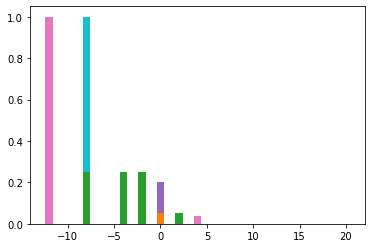

In [28]:
### Robustness checks: focus on big negative mean estimates
sim_bins_data = SCE_bins
print(str(sum(IndSCE_pk["IncMean"] <= 0)) + " abnormals")
ct = 0
figure = plt.plot()
for id in IndSCE_pk.index[IndSCE_pk["IncMean"] < -8]:
    print(id)
    print(IndSCE_pk["IncMean"][id])
    sim_probs_data = np.flip(
        np.array([IndSCE["Q24_bin" + str(n)][id] / 100 for n in range(1, 11)])
    )
    plt.bar(sim_bins_data[1:], sim_probs_data)
    print(sim_probs_data)
    stats_est = SynDensityStat(SCE_bins, sim_probs_data)
    print(stats_est["mean"])